In [1]:
!pip install seaborn
import msoffcrypto
import pandas as pd
import io
import seaborn as sns
import matplotlib.pyplot as plt


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


In [2]:
file_path = 'strain_baza.xlsx'  
password = 'strain'  

decrypted = io.BytesIO()
with open(file_path, 'rb') as file:
    office_file = msoffcrypto.OfficeFile(file)
    office_file.load_key(password=password)
    office_file.decrypt(decrypted)

decrypted.seek(0)

df = pd.read_excel(decrypted, engine='openpyxl')

print(df.head())

       ID_OPI  patient ID  intrahospital death -0-no, 1 yes Date of birth  \
0  27408493.0     3931351                               NaN    2023-11-07   
1  26976667.0     3913669                               NaN    2023-07-26   
2  27610485.0     3939063                               NaN    2023-12-20   
3  27392875.0     3930745                               NaN    2023-11-03   
4  27368200.0     3929703                               NaN    2023-10-27   

   Exam no.  DM (0-no, 1-diet, 2-insulin)  GA    BW    BW (pc)  BW(Z Score)  \
0         1                           0.0  38  2.70  15.846512    -1.000786   
1         1                           0.0  30  1.66  74.195084     0.649371   
2         1                           0.0  29  1.50  77.593456     0.758535   
3         1                           1.0  39  3.62  67.978320     0.467093   
4         1                           0.0  33  2.15  57.413268     0.186906   

   ...   Ht     Hb   Rbc  CRP    Il6  NTProBNP  Trop Ths Album

In [3]:
columns_ver_1 = ['DM (0-no, 1-diet, 2-insulin)', 'GA', 'BW', 'BW (pc)', 'BW(Z Score)', 
"Apgar 1'", "Apgar 5'", 'P00.0', 'Ht ', 'Hb', 'Rbc', 'CRP ', 'Il6', 'LV A2C', 'LVA3C', 'LVA4C', 'LV GLS', 'LASr_ED', 'LAScd_ED',
'LASct_ED', 'LASr_AC', 'LAScd_AC', 'LASct_AC', 'RVFWSL', 'RV4CSL']

In [4]:
df_ver_1 = df[columns_ver_1]

In [5]:
df_ver_1.shape

(169, 25)

In [6]:
df_ver_1_cleaned = df_ver_1.dropna()

In [7]:
df_ver_1_cleaned.describe()

,"DM (0-no, 1-diet, 2-insulin)",GA,BW,BW (pc),BW(Z Score),Apgar 1',Apgar 5',Ht,Hb,Rbc,...,LVA4C,LV GLS,LASr_ED,LAScd_ED,LASct_ED,LASr_AC,LAScd_AC,LASct_AC,RVFWSL,RV4CSL
count,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,...,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000
mean,0.411765,32.529412,1.911765,35.444564,-0.530318,6.588235,8.058824,191.235294,14.211765,4.217059,...,-20.594118,-19.929412,38.070588,-22.294118,-15.776471,33.076471,-19.470588,-13.623529,-23.594118,-19.664706
std,0.795206,4.360585,0.908943,28.847549,0.954975,1.839117,1.088037,622.339800,3.486023,0.708967,...,4.822016,3.773719,7.411626,7.243054,4.509092,6.269921,6.525600,3.438119,5.766332,4.376920
min,0.000000,25.000000,0.520000,2.208953,-2.012388,3.000000,6.000000,24.700000,9.700000,3.120000,...,-30.500000,-26.600000,26.400000,-36.500000,-23.200000,22.600000,-30.700000,-19.200000,-32.100000,-26.900000
25%,0.000000,29.000000,1.140000,6.008529,-1.554058,5.000000,7.000000,33.100000,11.200000,3.800000,...,-21.900000,-23.400000,34.800000,-25.900000,-17.300000,29.900000,-23.100000,-14.700000,-28.600000,-23.100000
50%,0.000000,33.000000,2.240000,29.626074,-0.535186,7.000000,8.000000,38.000000,13.600000,4.090000,...,-19.500000,-19.300000,37.300000,-23.700000,-15.100000,33.100000,-19.700000,-13.500000,-24.300000,-19.800000
75%,0.000000,36.000000,2.600000,63.329656,0.340597,8.000000,9.000000,50.400000,17.700000,4.750000,...,-17.200000,-17.200000,42.500000,-17.600000,-14.000000,37.700000,-15.900000,-12.400000,-17.400000,-15.300000
max,2.000000,39.000000,3.160000,79.308619,0.817176,10.000000,10.000000,2606.000000,19.900000,5.280000,...,-14.400000,-13.100000,53.700000,-9.600000,-7.500000,45.200000,-8.200000,-7.100000,-15.300000,-13.800000


In [8]:
print(df_ver_1[df_ver_1.isna().any(axis=1)])

     DM (0-no, 1-diet, 2-insulin)  GA    BW    BW (pc)  BW(Z Score)  Apgar 1'  \
0                             0.0  38  2.70  15.846512    -1.000786        10   
1                             0.0  30  1.66  74.195084     0.649371         6   
2                             0.0  29  1.50  77.593456     0.758535         6   
3                             1.0  39  3.62  67.978320     0.467093        10   
4                             0.0  33  2.15  57.413268     0.186906         7   
..                            ...  ..   ...        ...          ...       ...   
164                           NaN  30  1.10  14.742290    -1.047550         7   
165                           NaN  30  1.10  14.742290    -1.047550         7   
166                           NaN  30  1.05  11.525206    -1.199061         7   
167                           NaN  30  1.14  17.713422    -0.926342         7   
168                           NaN  30  1.11  15.451768    -1.017248         7   

     Apgar 5' P00.0   Ht   

In [9]:
df_ver_1.head()

,"DM (0-no, 1-diet, 2-insulin)",GA,BW,BW (pc),BW(Z Score),Apgar 1',Apgar 5',P00.0,Ht,Hb,...,LVA4C,LV GLS,LASr_ED,LAScd_ED,LASct_ED,LASr_AC,LAScd_AC,LASct_AC,RVFWSL,RV4CSL
0,0.0,38,2.70,15.846512,-1.000786,10,10,NaN,43.9,15.6,...,-20.1,-18.2,34.6,-22.8,-11.7,30.7,-20.3,-10.4,-17.6,-14.7
1,0.0,30,1.66,74.195084,0.649371,6,8,NaN,38.8,13.2,...,-23.5,-23.2,71.2,-46.5,-24.7,56.8,-37.1,-19.7,-33.0,-28.3
2,0.0,29,1.50,77.593456,0.758535,6,7,NaN,38.1,13.2,...,-21.3,-23.0,39.7,-23.1,-16.7,35.3,-20.5,-14.8,-23.8,-27.8
3,1.0,39,3.62,67.978320,0.467093,10,10,NaN,41.1,14.9,...,-15.9,-15.9,42.1,-32.7,-9.4,38.8,-30.1,-8.7,-15.0,-12.4
4,0.0,33,2.15,57.413268,0.186906,7,8,NaN,48.9,17.5,...,-18.7,-20.8,35.6,-13.1,-22.5,28.5,-10.5,-18.1,-24.1,-18.0


In [10]:
df_ver_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169 entries, 0 to 168
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   DM (0-no, 1-diet, 2-insulin)  157 non-null    float64
 1   GA                            169 non-null    int64  
 2   BW                            169 non-null    float64
 3   BW (pc)                       169 non-null    float64
 4   BW(Z Score)                   169 non-null    float64
 5   Apgar 1'                      169 non-null    int64  
 6   Apgar 5'                      169 non-null    int64  
 7   P00.0                         30 non-null     object 
 8   Ht                            161 non-null    float64
 9   Hb                            161 non-null    float64
 10  Rbc                           161 non-null    float64
 11  CRP                           145 non-null    object 
 12  Il6                           100 non-null    object 
 13  LV A2

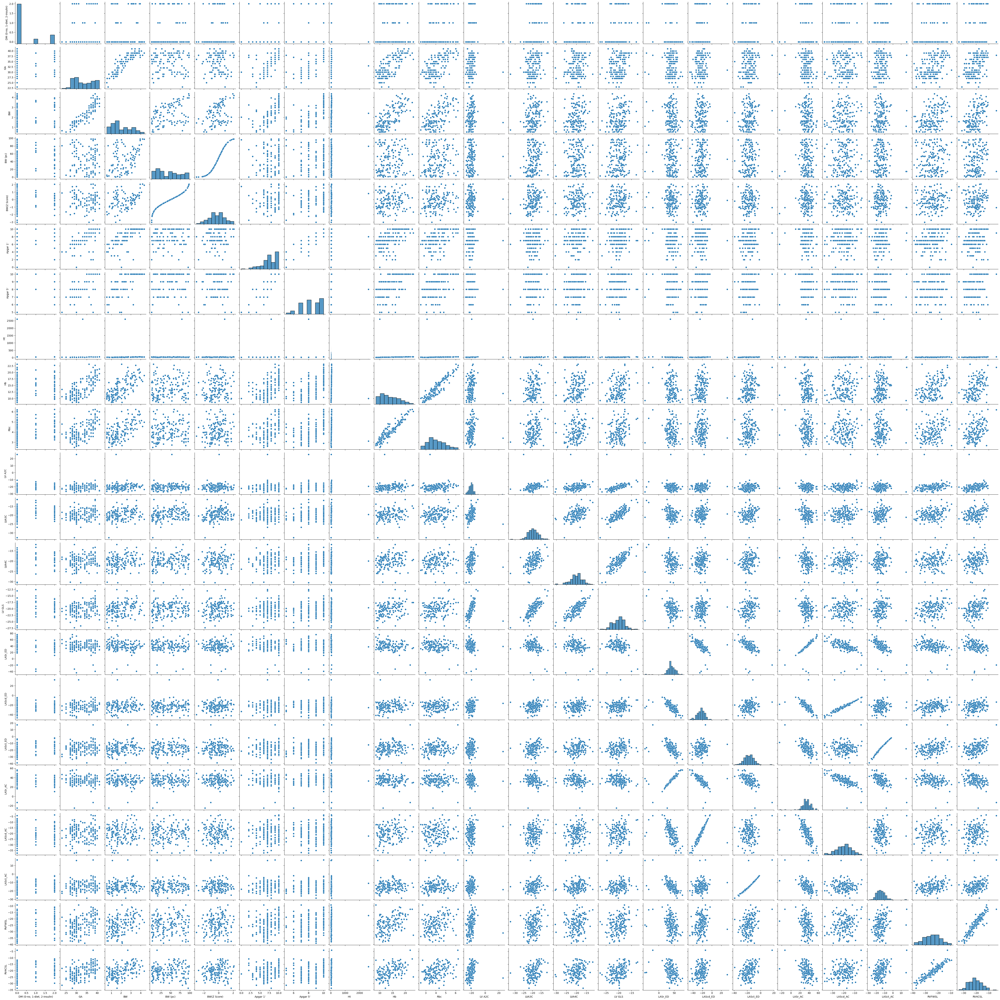

In [11]:
sns.pairplot(df_ver_1)
plt.show()

In [12]:
df_ver_1['P00.0'].fillna(0, inplace=True)
df_ver_1['P00.0'] = df_ver_1['P00.0'].replace({'T': 1})
df_ver_1['P00.0'] = df_ver_1['P00.0'].astype(int)

/tmp/ipykernel_7629/3473398366.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_ver_1['P00.0'].fillna(0, inplace=True)
/tmp/ipykernel_7629/3473398366.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ver_1['P00.0'].fillna(0, inplace=True)
/tmp/ipykernel_7629/3473398366.py:2: FutureWarning: Downcasting behavior in `replace` is deprec

In [13]:
df_ver_1['CRP '] = df_ver_1['CRP '].replace({'<5': 1})
df_ver_1['CRP '] = df_ver_1['CRP '].astype(float)
df_ver_1['Il6'] = df_ver_1['Il6'].replace({'<1,5': 1})
df_ver_1['Il6'] = df_ver_1['Il6'].astype(float)

/tmp/ipykernel_7629/1156661344.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_ver_1['CRP '] = df_ver_1['CRP '].replace({'<5': 1})
/tmp/ipykernel_7629/1156661344.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ver_1['CRP '] = df_ver_1['CRP '].replace({'<5': 1})
/tmp/ipykernel_7629/1156661344.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

In [14]:
df_ver_1.head()

,"DM (0-no, 1-diet, 2-insulin)",GA,BW,BW (pc),BW(Z Score),Apgar 1',Apgar 5',P00.0,Ht,Hb,...,LVA4C,LV GLS,LASr_ED,LAScd_ED,LASct_ED,LASr_AC,LAScd_AC,LASct_AC,RVFWSL,RV4CSL
0,0.0,38,2.70,15.846512,-1.000786,10,10,0,43.9,15.6,...,-20.1,-18.2,34.6,-22.8,-11.7,30.7,-20.3,-10.4,-17.6,-14.7
1,0.0,30,1.66,74.195084,0.649371,6,8,0,38.8,13.2,...,-23.5,-23.2,71.2,-46.5,-24.7,56.8,-37.1,-19.7,-33.0,-28.3
2,0.0,29,1.50,77.593456,0.758535,6,7,0,38.1,13.2,...,-21.3,-23.0,39.7,-23.1,-16.7,35.3,-20.5,-14.8,-23.8,-27.8
3,1.0,39,3.62,67.978320,0.467093,10,10,0,41.1,14.9,...,-15.9,-15.9,42.1,-32.7,-9.4,38.8,-30.1,-8.7,-15.0,-12.4
4,0.0,33,2.15,57.413268,0.186906,7,8,0,48.9,17.5,...,-18.7,-20.8,35.6,-13.1,-22.5,28.5,-10.5,-18.1,-24.1,-18.0


In [15]:
df_no_nan = df_ver_1.dropna()

In [16]:
df_no_nan.head()

,"DM (0-no, 1-diet, 2-insulin)",GA,BW,BW (pc),BW(Z Score),Apgar 1',Apgar 5',P00.0,Ht,Hb,...,LVA4C,LV GLS,LASr_ED,LAScd_ED,LASct_ED,LASr_AC,LAScd_AC,LASct_AC,RVFWSL,RV4CSL
1,0.0,30,1.66,74.195084,0.649371,6,8,0,38.8,13.2,...,-23.5,-23.2,71.2,-46.5,-24.7,56.8,-37.1,-19.7,-33.0,-28.3
2,0.0,29,1.50,77.593456,0.758535,6,7,0,38.1,13.2,...,-21.3,-23.0,39.7,-23.1,-16.7,35.3,-20.5,-14.8,-23.8,-27.8
3,1.0,39,3.62,67.978320,0.467093,10,10,0,41.1,14.9,...,-15.9,-15.9,42.1,-32.7,-9.4,38.8,-30.1,-8.7,-15.0,-12.4
4,0.0,33,2.15,57.413268,0.186906,7,8,0,48.9,17.5,...,-18.7,-20.8,35.6,-13.1,-22.5,28.5,-10.5,-18.1,-24.1,-18.0
5,1.0,39,3.57,64.356958,0.368017,10,10,0,45.6,17.4,...,-18.8,-17.5,37.6,-9.8,-27.8,30.3,-7.9,-22.4,-25.9,-22.2


In [17]:
df_no_nan.shape

(89, 25)

In [18]:
y = df_no_nan[['LV A2C', 'LVA3C', 'LVA4C', 'LV GLS', 'LASr_ED', 'LAScd_ED',
'LASct_ED', 'LASr_AC', 'LAScd_AC', 'LASct_AC', 'RVFWSL', 'RV4CSL']]
X = df_no_nan.drop(columns=['LV A2C', 'LVA3C', 'LVA4C', 'LV GLS', 'LASr_ED', 'LAScd_ED',
'LASct_ED', 'LASr_AC', 'LAScd_AC', 'LASct_AC', 'RVFWSL', 'RV4CSL'])

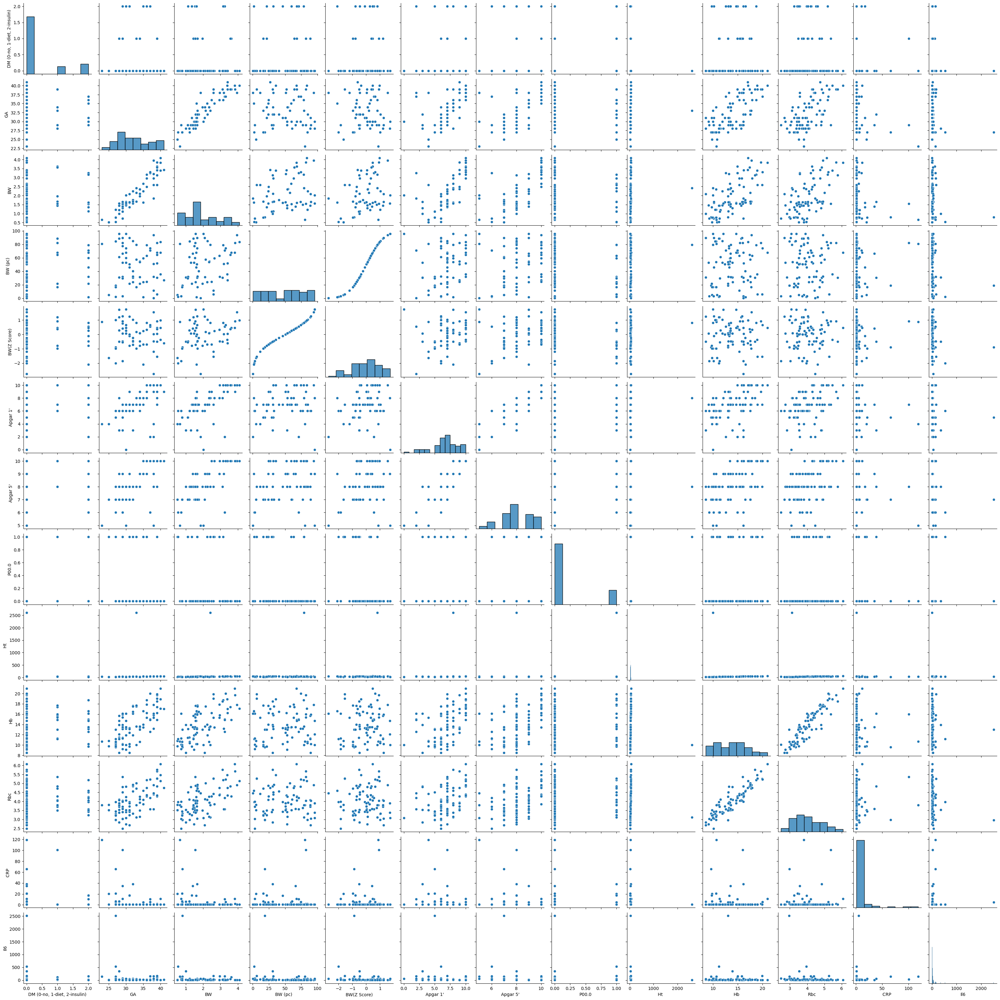

In [19]:
sns.pairplot(X)
plt.savefig("pairplot_scen1.png")
plt.show()

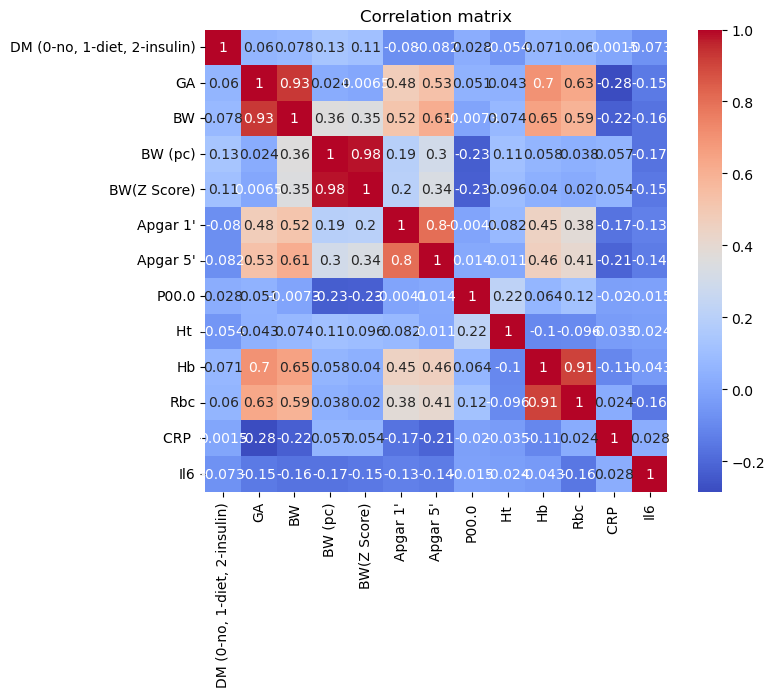

In [20]:
correlation_matrix = X.corr()

# Wykres macierzy korelacji
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', square=True)
plt.title('Correlation matrix')
plt.savefig("matrix_scen1.png")
plt.show()

In [21]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Index: 89 entries, 1 to 155
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   DM (0-no, 1-diet, 2-insulin)  89 non-null     float64
 1   GA                            89 non-null     int64  
 2   BW                            89 non-null     float64
 3   BW (pc)                       89 non-null     float64
 4   BW(Z Score)                   89 non-null     float64
 5   Apgar 1'                      89 non-null     int64  
 6   Apgar 5'                      89 non-null     int64  
 7   P00.0                         89 non-null     int64  
 8   Ht                            89 non-null     float64
 9   Hb                            89 non-null     float64
 10  Rbc                           89 non-null     float64
 11  CRP                           89 non-null     float64
 12  Il6                           89 non-null     float64
dtypes: float64(

In [22]:
X[['CRP ','Il6']]

,CRP,Il6
1,1.0,8.94
2,1.0,7.90
3,1.0,114.00
4,1.0,3.97
5,1.0,42.20
...,...,...
150,1.0,23.40
152,34.8,9.19
153,1.0,17.10
154,1.0,5.24


In [23]:
y.info()

<class 'pandas.core.frame.DataFrame'>
Index: 89 entries, 1 to 155
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   LV A2C    89 non-null     float64
 1   LVA3C     89 non-null     float64
 2   LVA4C     89 non-null     float64
 3   LV GLS    89 non-null     float64
 4   LASr_ED   89 non-null     float64
 5   LAScd_ED  89 non-null     float64
 6   LASct_ED  89 non-null     float64
 7   LASr_AC   89 non-null     float64
 8   LAScd_AC  89 non-null     float64
 9   LASct_AC  89 non-null     float64
 10  RVFWSL    89 non-null     float64
 11  RV4CSL    89 non-null     float64
dtypes: float64(12)
memory usage: 9.0 KB


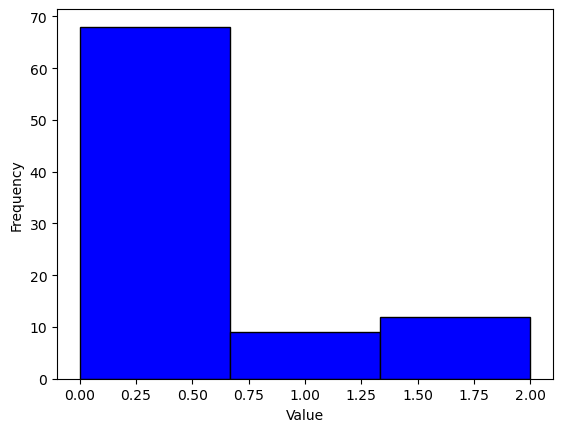

In [24]:
plt.hist(X['DM (0-no, 1-diet, 2-insulin)'], bins=3, color='blue', edgecolor='black')
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.show()

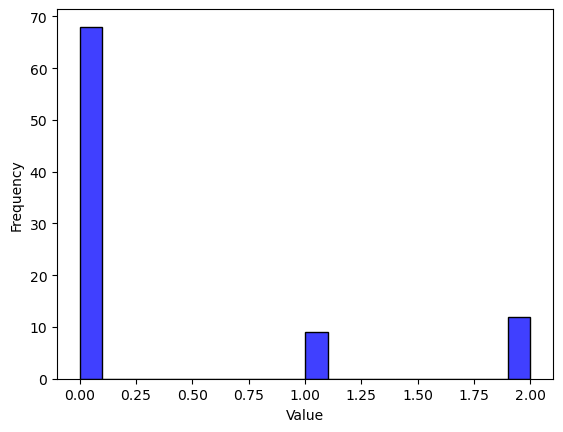

In [25]:
sns.histplot(data=X, x="DM (0-no, 1-diet, 2-insulin)", bins=20, kde=False, color='blue')
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.savefig("hist_scen1_cl.png")
plt.show()

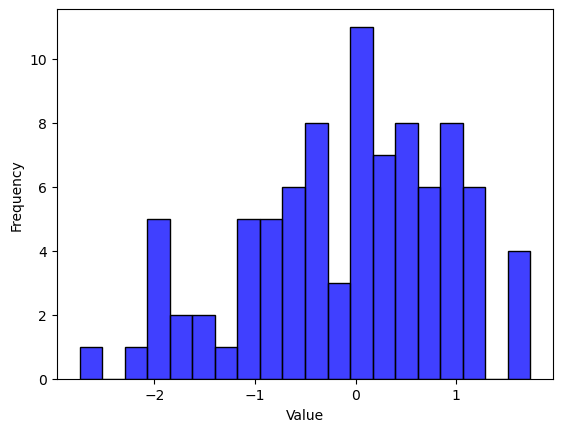

In [26]:
sns.histplot(data=X, x="BW(Z Score)", bins=20, kde=False, color='blue')
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.savefig("hist_scen1_reg.png")
plt.show()

### GradientBoost

Trenowanie modelu dla kolumny LV A2C
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.9363
Train - MSE: 0.4795, MAE: 0.5612, R^2: 0.9491
Validation - MSE: 8.1988, MAE: 2.0240, R^2: -0.1005
Test - MSE: 129.1196, MAE: 4.8386, R^2: -0.0203


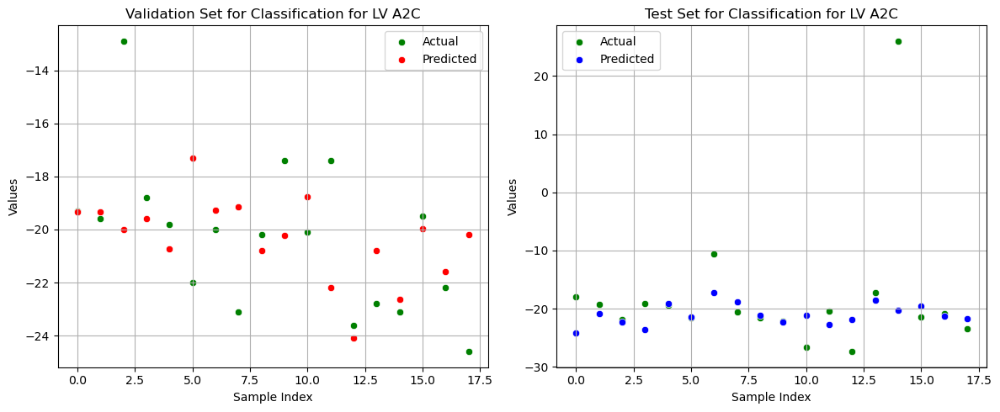

Trenowanie modelu dla kolumny LVA3C
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.2, 'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): 0.1370
Train - MSE: 0.0000, MAE: 0.0000, R^2: 1.0000
Validation - MSE: 9.8124, MAE: 2.6779, R^2: -0.5001
Test - MSE: 11.7074, MAE: 2.7752, R^2: -0.3317


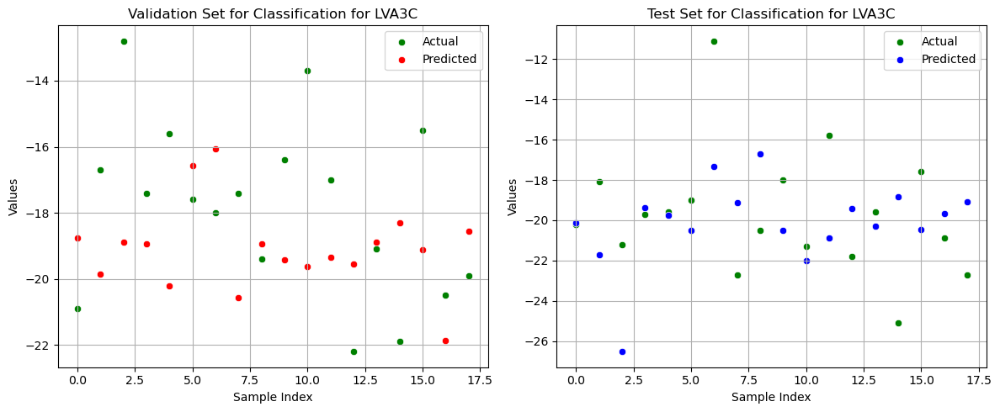

Trenowanie modelu dla kolumny LVA4C
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.2, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.6674
Train - MSE: 0.0000, MAE: 0.0000, R^2: 1.0000
Validation - MSE: 15.9007, MAE: 3.1809, R^2: -0.6014
Test - MSE: 21.5395, MAE: 4.0451, R^2: -1.3236


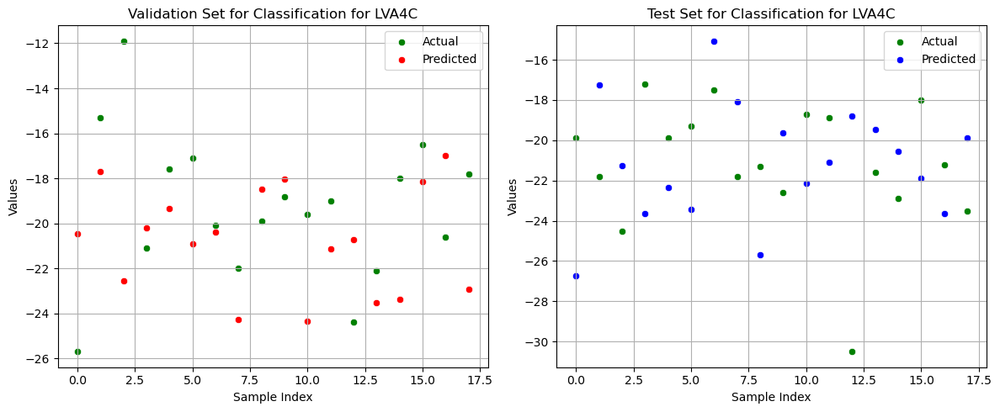

Trenowanie modelu dla kolumny LV GLS
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 3, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.3743
Train - MSE: 0.3505, MAE: 0.4719, R^2: 0.9449
Validation - MSE: 7.1835, MAE: 1.9791, R^2: -0.2539
Test - MSE: 7.4238, MAE: 2.0155, R^2: 0.0427


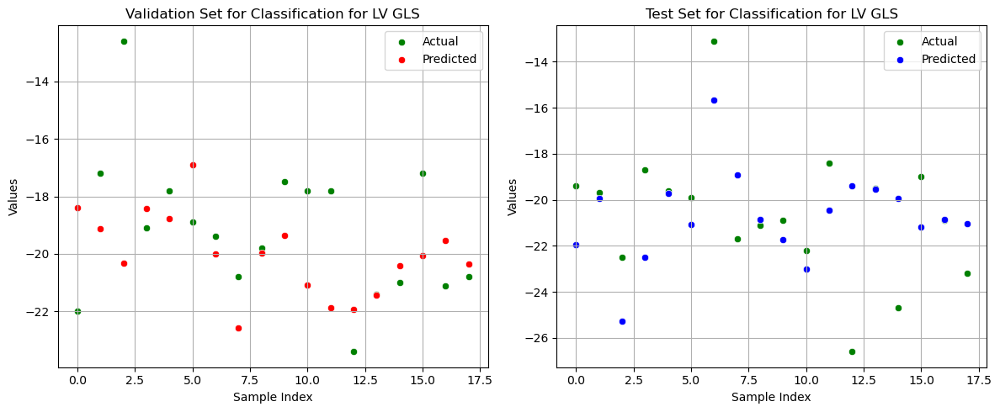

Trenowanie modelu dla kolumny LASr_ED
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.2, 'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -1.2444
Train - MSE: 0.0000, MAE: 0.0000, R^2: 1.0000
Validation - MSE: 345.3243, MAE: 12.0923, R^2: 0.1153
Test - MSE: 129.9804, MAE: 8.4010, R^2: -0.0583


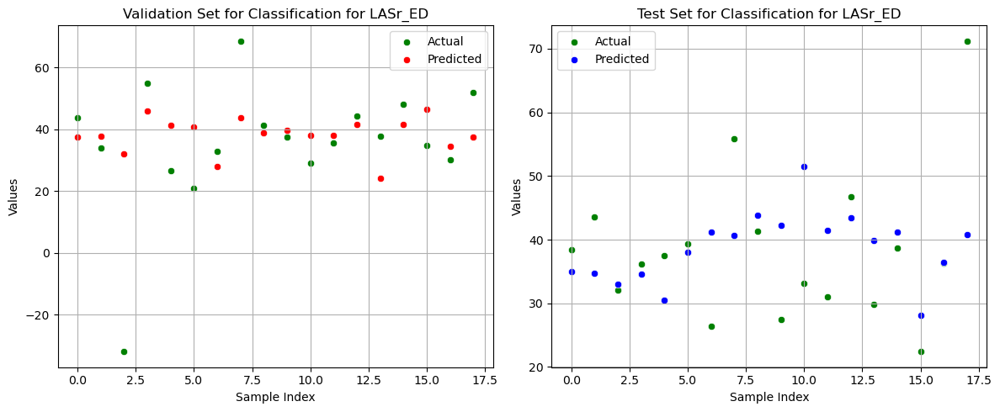

Trenowanie modelu dla kolumny LAScd_ED
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.6497
Train - MSE: 0.0559, MAE: 0.1942, R^2: 0.9994
Validation - MSE: 142.9945, MAE: 8.9527, R^2: -1.0115
Test - MSE: 103.0121, MAE: 7.9338, R^2: -0.4318


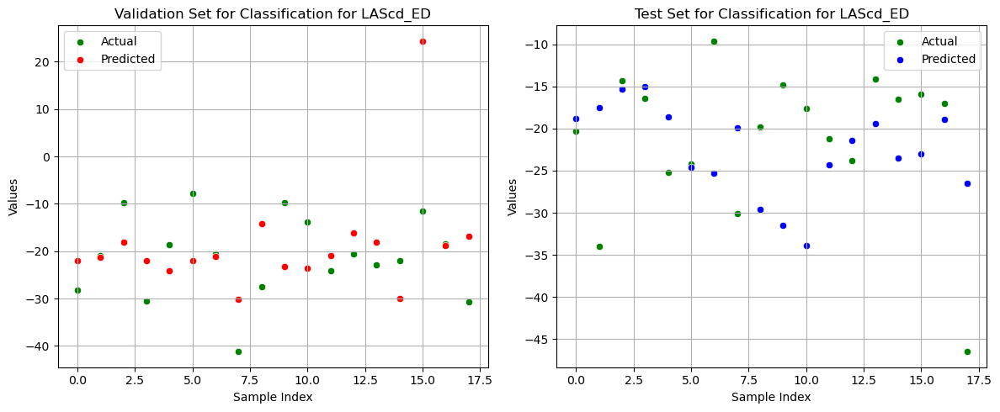

Trenowanie modelu dla kolumny LASct_ED
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -1.5094
Train - MSE: 1.7314, MAE: 1.0735, R^2: 0.9514
Validation - MSE: 52.6828, MAE: 5.9800, R^2: -0.3929
Test - MSE: 37.1245, MAE: 4.7811, R^2: -0.3320


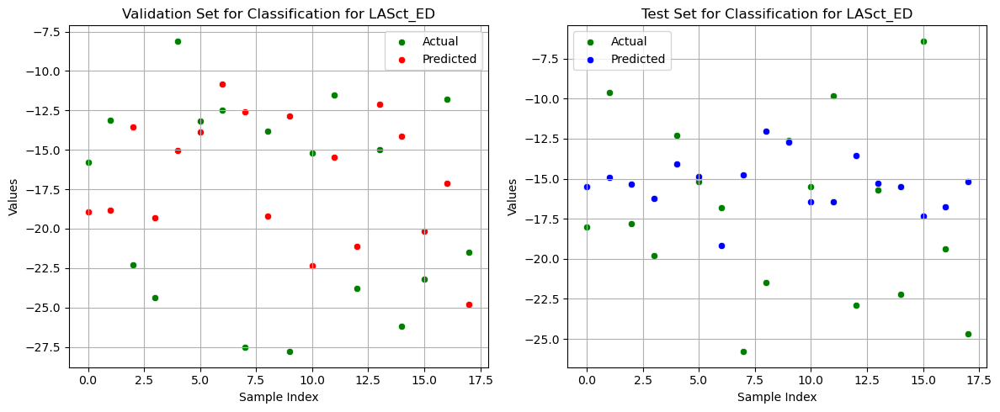

Trenowanie modelu dla kolumny LASr_AC
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -3.3508
Train - MSE: 5.3745, MAE: 1.8693, R^2: 0.9431
Validation - MSE: 209.9132, MAE: 11.7869, R^2: -1.9851
Test - MSE: 93.8141, MAE: 6.9852, R^2: -0.3977


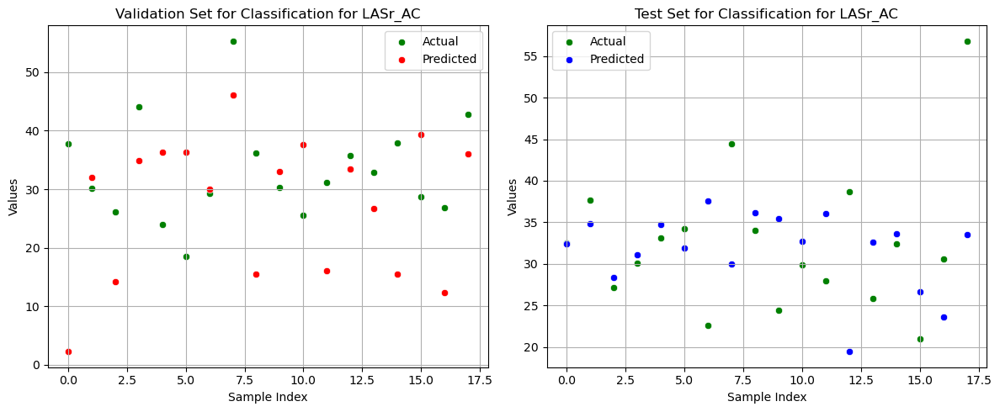

Trenowanie modelu dla kolumny LAScd_AC
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.8849
Train - MSE: 0.0418, MAE: 0.1656, R^2: 0.9988
Validation - MSE: 63.8456, MAE: 6.6238, R^2: -0.3501
Test - MSE: 67.9860, MAE: 6.1633, R^2: -0.4985


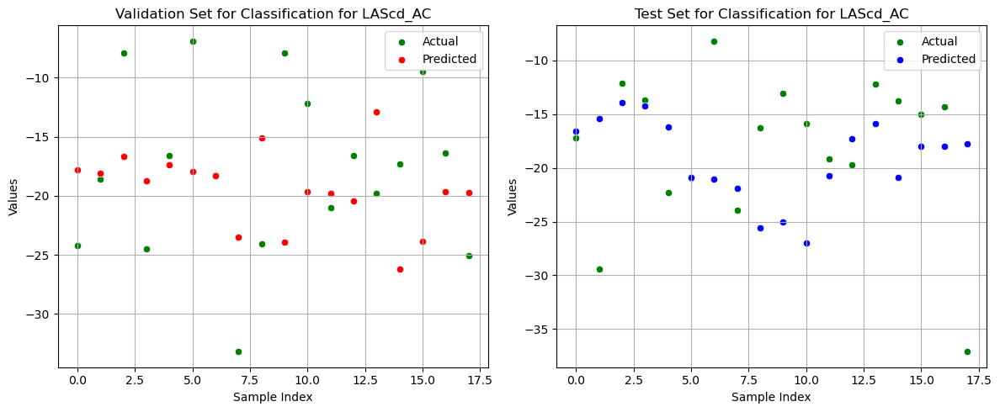

Trenowanie modelu dla kolumny LASct_AC
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 3, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -1.4831
Train - MSE: 1.0690, MAE: 0.8219, R^2: 0.9464
Validation - MSE: 29.3472, MAE: 4.3273, R^2: -0.4296
Test - MSE: 21.9450, MAE: 3.6850, R^2: -0.3800


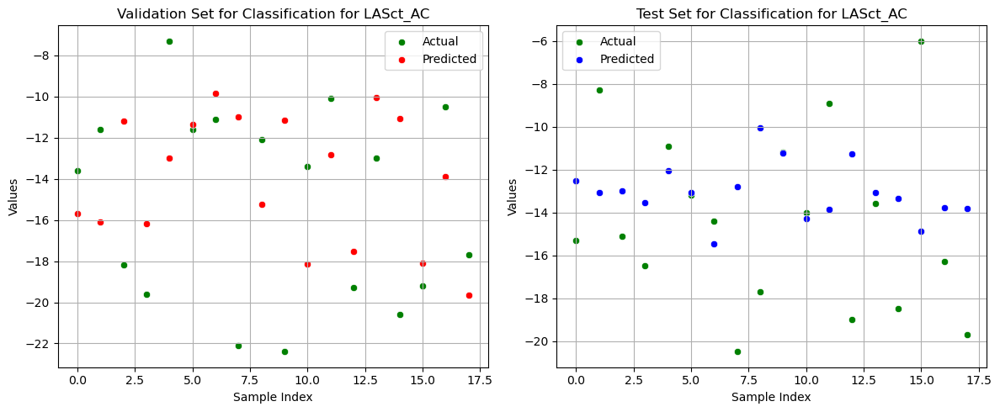

Trenowanie modelu dla kolumny RVFWSL
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.005, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.1856
Train - MSE: 0.6086, MAE: 0.6122, R^2: 0.9756
Validation - MSE: 47.0266, MAE: 5.7588, R^2: 0.1183
Test - MSE: 39.3056, MAE: 5.1329, R^2: -0.1799


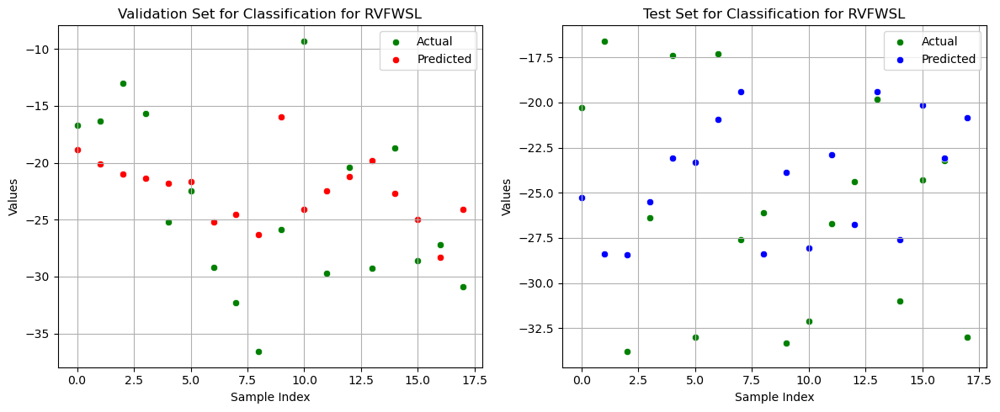

Trenowanie modelu dla kolumny RV4CSL
Best Parameters: {'criterion': 'friedman_mse', 'learning_rate': 0.01, 'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 1200}
Cross-Validation R^2 (Train): -0.4300
Train - MSE: 0.0555, MAE: 0.1679, R^2: 0.9969
Validation - MSE: 27.3388, MAE: 4.3255, R^2: 0.0982
Test - MSE: 21.1173, MAE: 3.6690, R^2: 0.0321


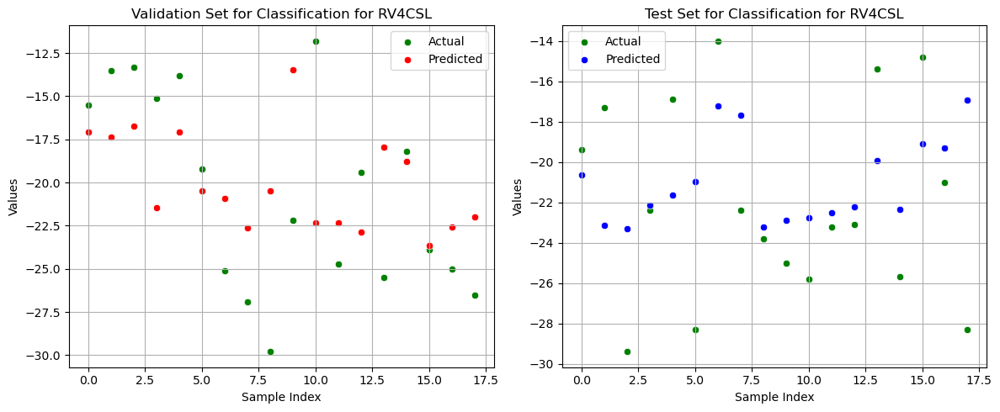

In [27]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
import matplotlib.pyplot as plt
import seaborn as sns

# Podział na zbiory uczący, walidacyjny i testowy
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Parametry do GridSearch
param_grid = {
    'n_estimators': [1200],
    'learning_rate': [0.005, 0.01, 0.05, 0.2],
    'min_samples_split': [2, 3, 4],
    'min_samples_leaf': [1, 2, 3],
    'max_depth': [3, 4, 5],
    'criterion': ['friedman_mse']
}

# Funkcja oceny modelu
def evaluate_regression_model(X, y, model, param_grid):
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, n_jobs=-1, scoring='neg_mean_squared_error')
    grid_search.fit(X, y)
    
    best_model = grid_search.best_estimator_
    
    # Cross-validation na zbiorze uczącym
    scores = cross_val_score(best_model, X, y, cv=5, scoring='r2')
    y_pred = best_model.predict(X)
    
    mse = mean_squared_error(y, y_pred)
    mae = mean_absolute_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    
    return best_model, grid_search.best_params_, np.mean(scores), mse, mae, r2

# Trenujemy model dla każdej kolumny w y
for y_col in y.columns:  # y is a DataFrame, so iterate over its columns
    print(f"Trenowanie modelu dla kolumny {y_col}")
    
    y_train_col = y_train[y_col]
    y_val_col = y_val[y_col]
    y_test_col = y_test[y_col]
    
    # GradientBoostingRegressor with cross-validation and parameter tuning
    model = GradientBoostingRegressor(random_state=42)
    # model = RandomForestRegressor(random_state=42)
    best_model, best_params, cv_score, mse_train, mae_train, r2_train = evaluate_regression_model(X_train, y_train_col, model, param_grid)
    
    # Predykcje na zbiorze walidacyjnym
    y_val_pred = best_model.predict(X_val)
    mse_val = mean_squared_error(y_val_col, y_val_pred)
    mae_val = mean_absolute_error(y_val_col, y_val_pred)
    r2_val = r2_score(y_val_col, y_val_pred)
    
    # Predykcje na zbiorze testowym
    y_test_pred = best_model.predict(X_test)
    mse_test = mean_squared_error(y_test_col, y_test_pred)
    mae_test = mean_absolute_error(y_test_col, y_test_pred)
    r2_test = r2_score(y_test_col, y_test_pred)
    
    # Wyświetlanie wyników
    print(f"Best Parameters: {best_params}")
    print(f"Cross-Validation R^2 (Train): {cv_score:.4f}")
    print(f"Train - MSE: {mse_train:.4f}, MAE: {mae_train:.4f}, R^2: {r2_train:.4f}")
    print(f"Validation - MSE: {mse_val:.4f}, MAE: {mae_val:.4f}, R^2: {r2_val:.4f}")
    print(f"Test - MSE: {mse_test:.4f}, MAE: {mae_test:.4f}, R^2: {r2_test:.4f}")

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val_col, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val_pred, color='red', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Validation Set for Classification for {y_col}')
    plt.legend()
    plt.grid()

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test_col, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test_pred, color='blue', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Test Set for Classification for {y_col}')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    plt.show()

### MAE

Trenowanie modelu dla kolumny LV A2C z 5-krotną walidacją krzyżową
Fold 1/5


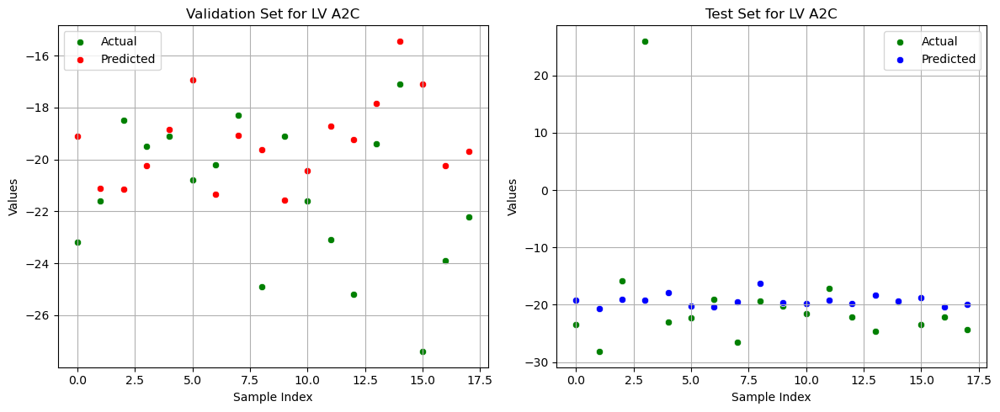

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 2.9385, MAPE (Val): 12.87%
MAE (Test): 5.7304, MAPE (Test): 23.74%

Fold 2/5


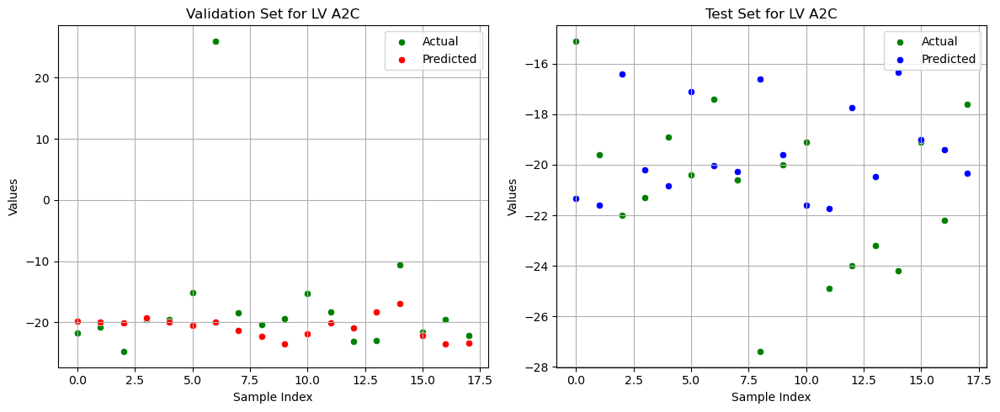

Best parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 5.3101, MAPE (Val): 25.75%
MAE (Test): 3.4740, MAPE (Test): 16.21%

Fold 3/5


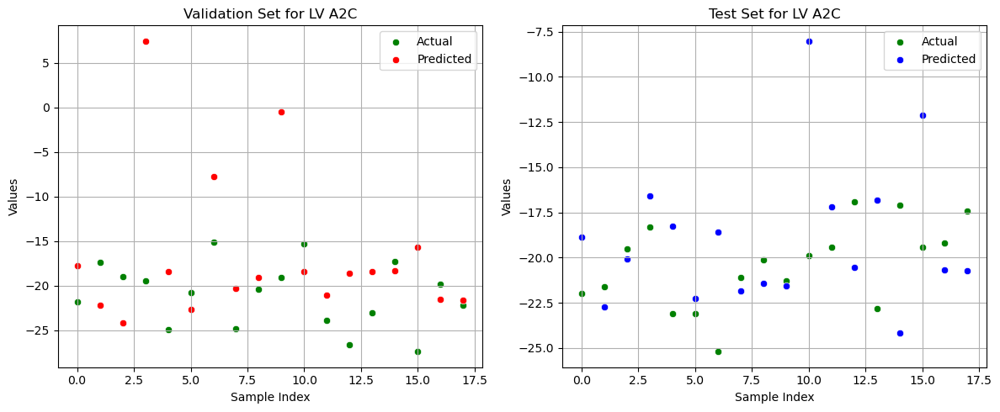

Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 6.3736, MAPE (Val): 31.09%
MAE (Test): 3.5590, MAPE (Test): 17.70%

Fold 4/5


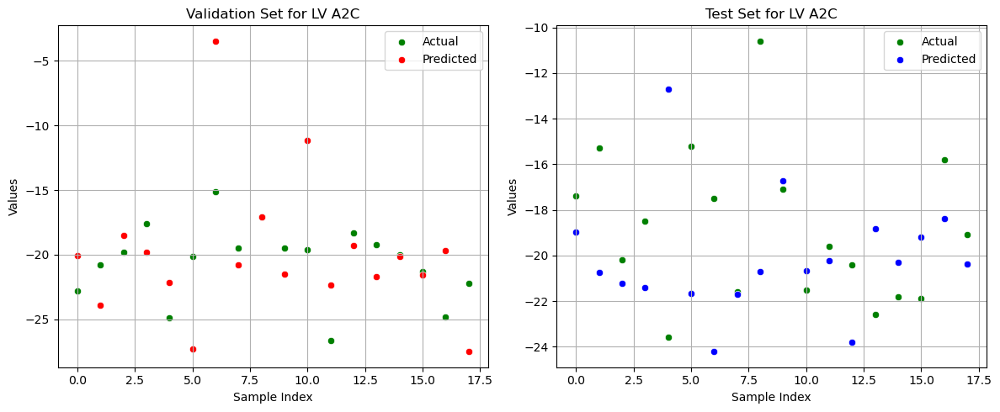

Best parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 3.3962, MAPE (Val): 17.24%
MAE (Test): 3.4633, MAPE (Test): 20.74%

Fold 5/5


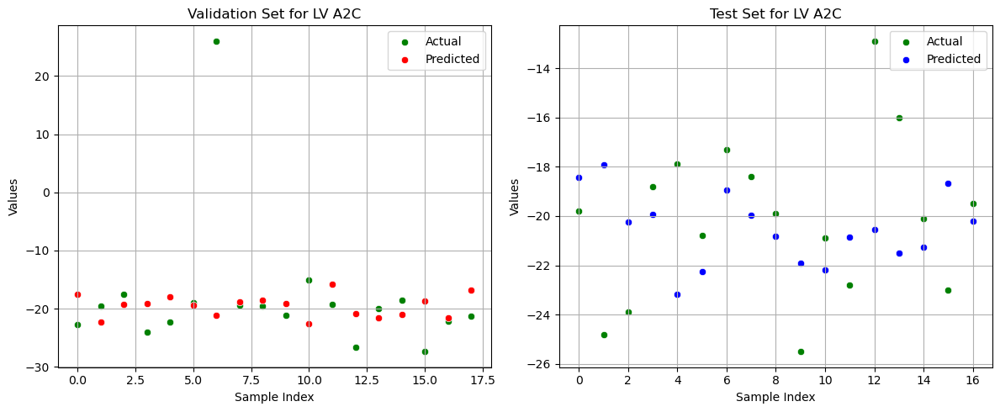

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 5.8150, MAPE (Val): 25.23%
MAE (Test): 2.9426, MAPE (Test): 15.62%

Średnie wyniki dla walidacji:
MAE: 4.7667, MAPE: 22.44%
Średnie wyniki dla testu:
MAE: 3.8339, MAPE: 18.80%
Trenowanie modelu dla kolumny LVA3C z 5-krotną walidacją krzyżową
Fold 1/5


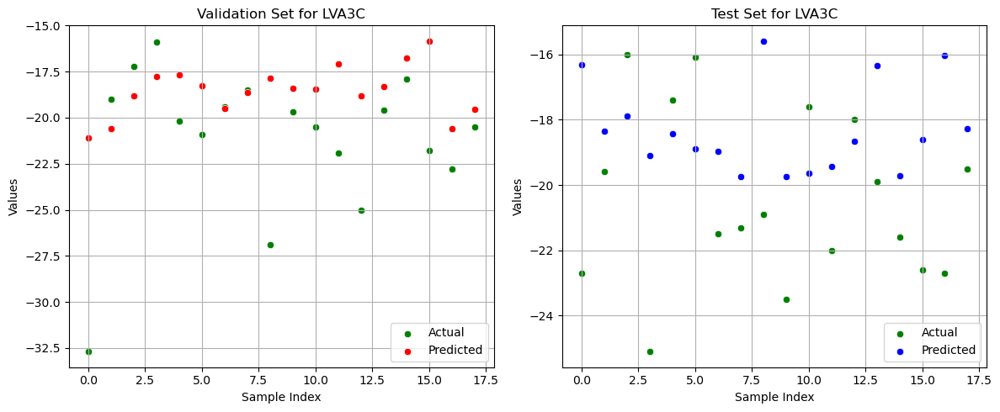

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 3.1694, MAPE (Val): 13.50%
MAE (Test): 3.0601, MAPE (Test): 14.49%

Fold 2/5


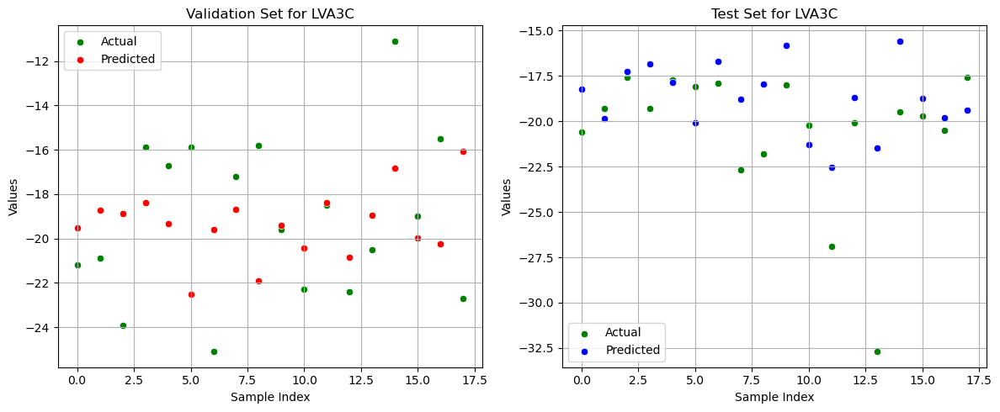

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 3.1709, MAPE (Val): 17.93%
MAE (Test): 2.4721, MAPE (Test): 10.91%

Fold 3/5


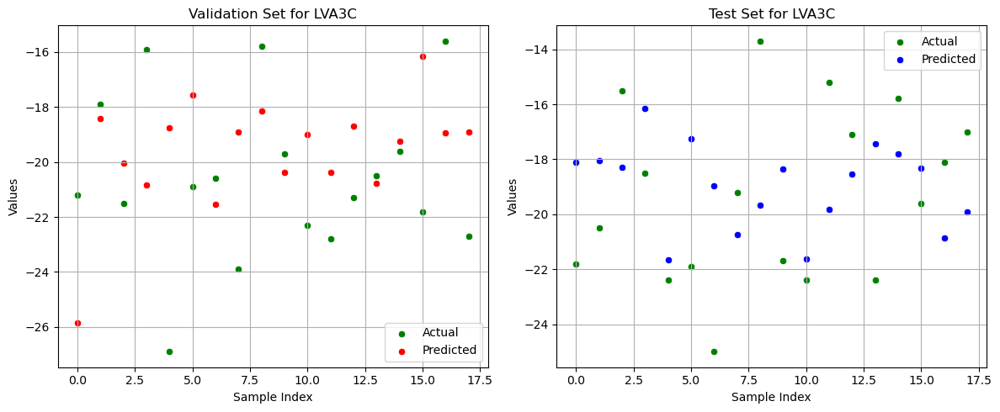

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 2.9837, MAPE (Val): 14.30%
MAE (Test): 3.0185, MAPE (Test): 16.19%

Fold 4/5


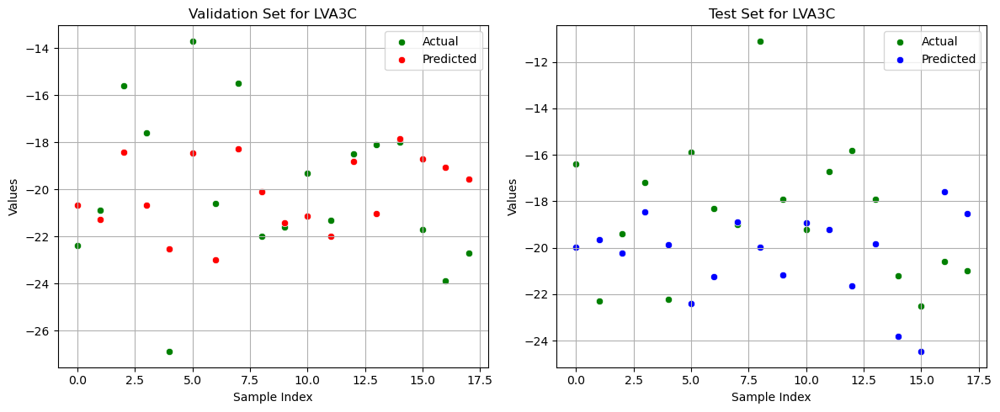

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 2.2890, MAPE (Val): 11.89%
MAE (Test): 2.9435, MAPE (Test): 17.96%

Fold 5/5


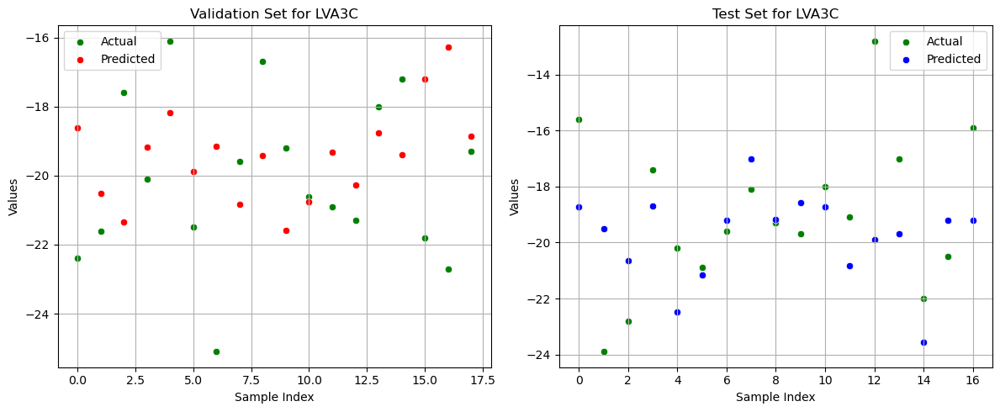

Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 2.3714, MAPE (Val): 11.59%
MAE (Test): 2.0362, MAPE (Test): 11.80%

Średnie wyniki dla walidacji:
MAE: 2.7969, MAPE: 13.84%
Średnie wyniki dla testu:
MAE: 2.7061, MAPE: 14.27%
Trenowanie modelu dla kolumny LVA4C z 5-krotną walidacją krzyżową
Fold 1/5


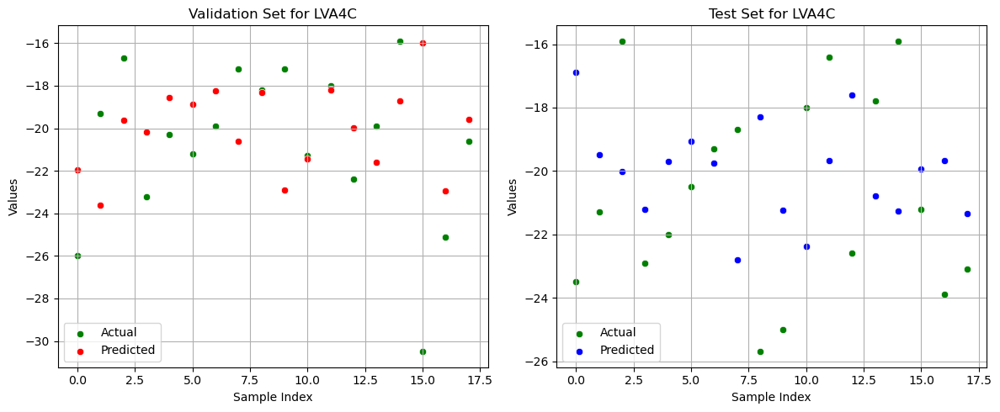

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 3.0110, MAPE (Val): 13.87%
MAE (Test): 3.4408, MAPE (Test): 16.87%

Fold 2/5


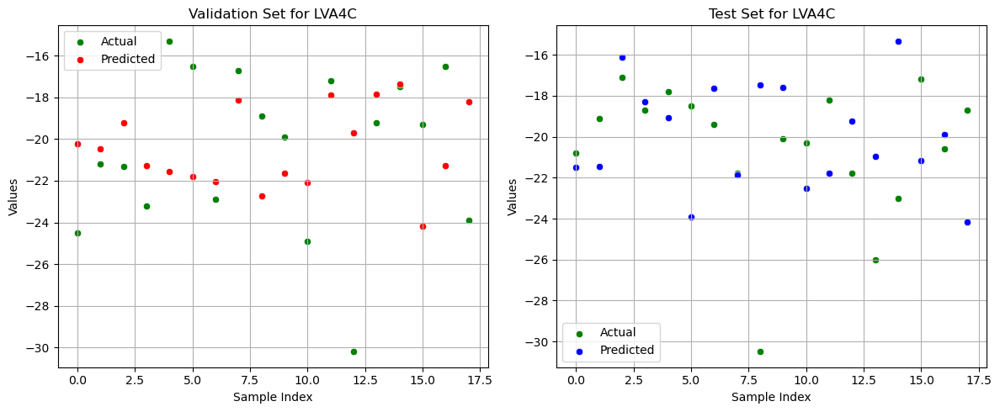

Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 1000, 'subsample': 0.8}
MAE (Val): 3.2901, MAPE (Val): 16.06%
MAE (Test): 3.3173, MAPE (Test): 15.30%

Fold 3/5


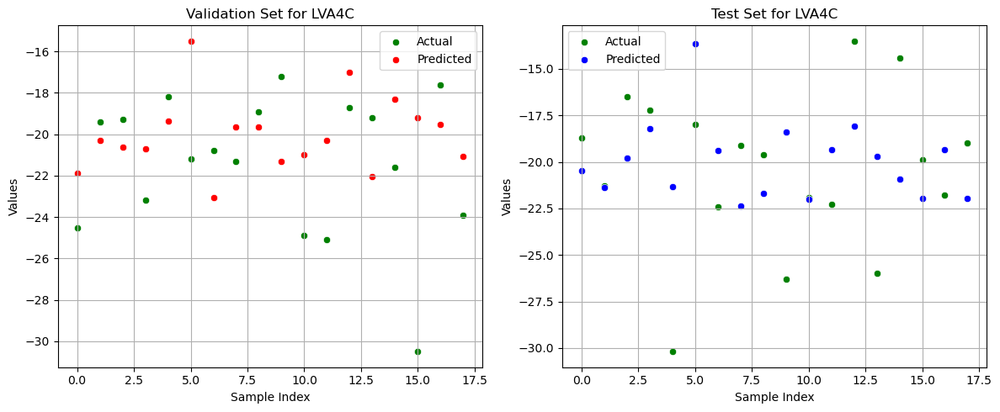

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 3.0870, MAPE (Val): 13.69%
MAE (Test): 3.5311, MAPE (Test): 17.48%

Fold 4/5


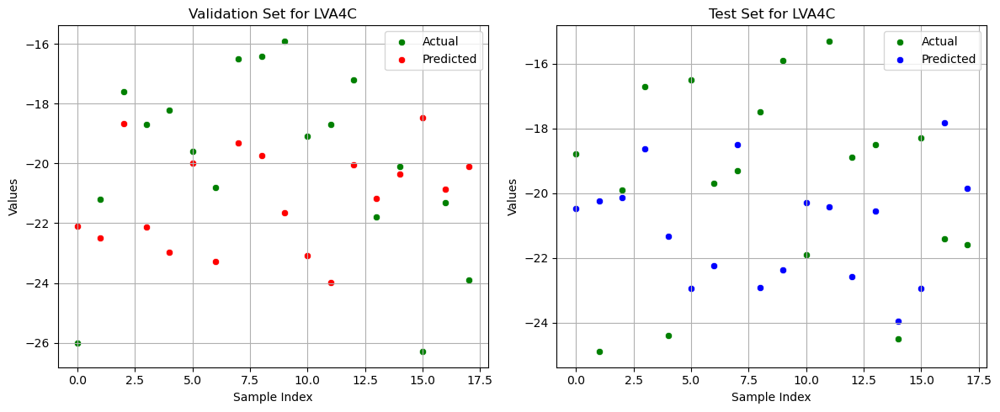

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 3.0162, MAPE (Val): 15.37%
MAE (Test): 3.1223, MAPE (Test): 16.91%

Fold 5/5


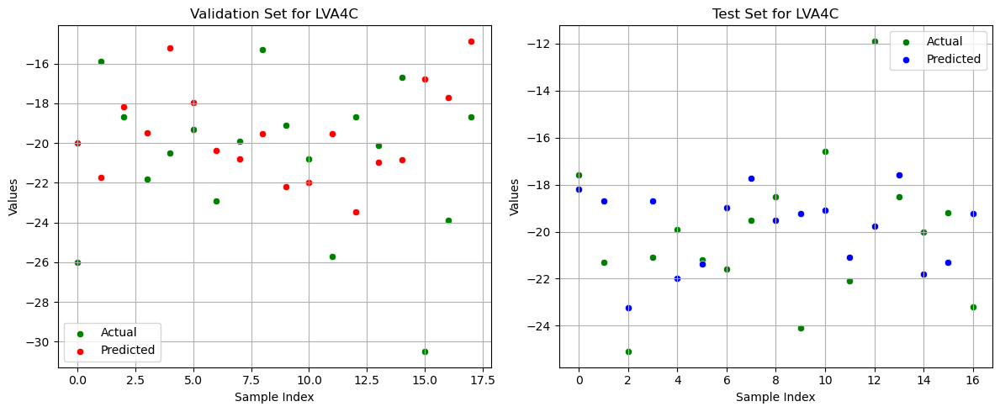

Best parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 2000, 'subsample': 0.5}
MAE (Val): 4.0506, MAPE (Val): 18.93%
MAE (Test): 2.3652, MAPE (Test): 12.98%

Średnie wyniki dla walidacji:
MAE: 3.2910, MAPE: 15.59%
Średnie wyniki dla testu:
MAE: 3.1553, MAPE: 15.91%
Trenowanie modelu dla kolumny LV GLS z 5-krotną walidacją krzyżową
Fold 1/5


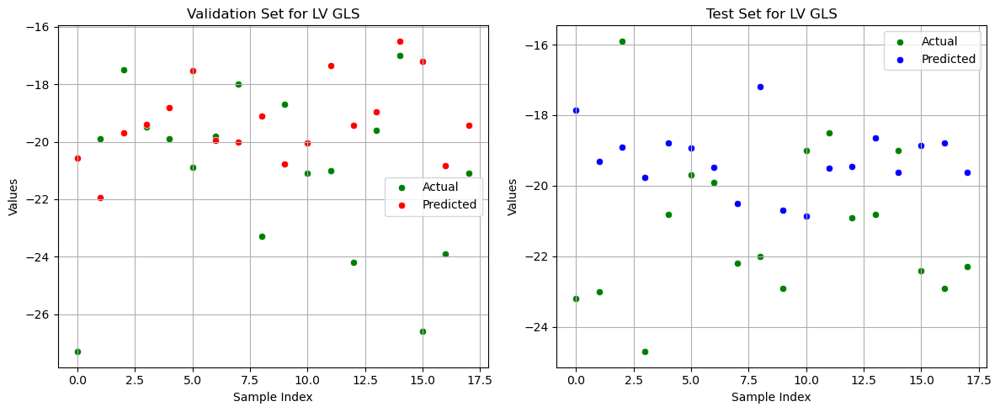

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 2.7063, MAPE (Val): 11.94%
MAE (Test): 2.5750, MAPE (Test): 11.92%

Fold 2/5


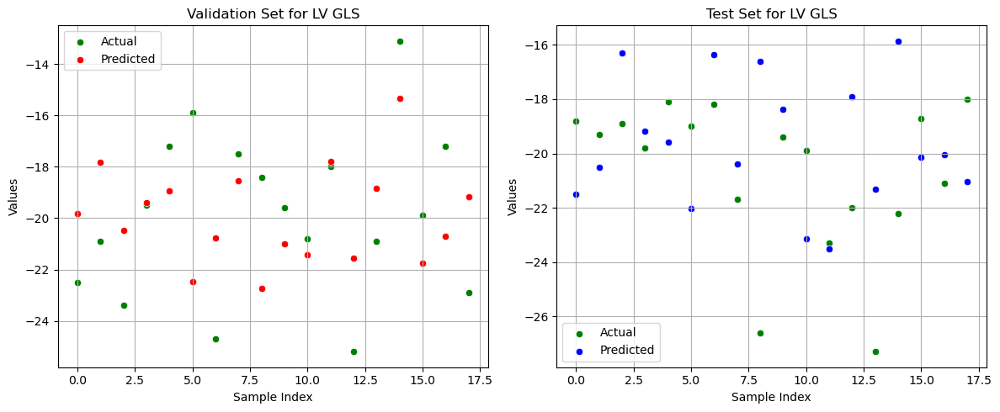

Best parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 2.5388, MAPE (Val): 13.08%
MAE (Test): 2.8432, MAPE (Test): 13.13%

Fold 3/5


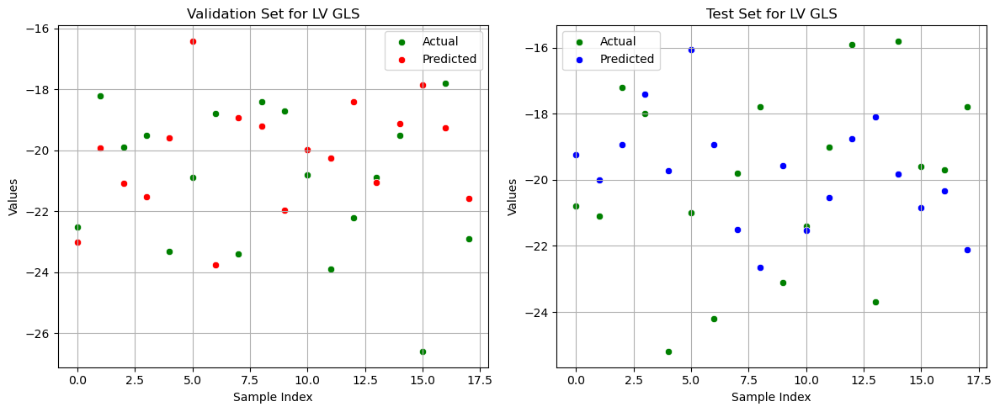

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 2.6320, MAPE (Val): 12.12%
MAE (Test): 2.8422, MAPE (Test): 14.12%

Fold 4/5


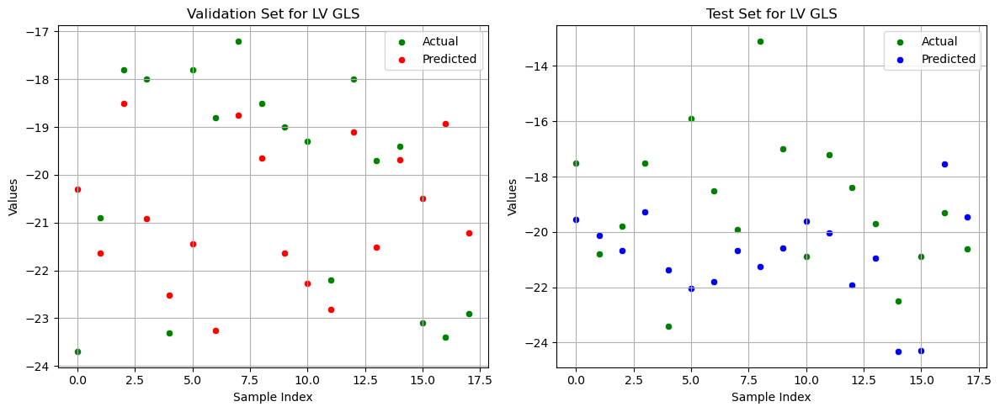

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 2.0849, MAPE (Val): 10.41%
MAE (Test): 2.5730, MAPE (Test): 14.93%

Fold 5/5


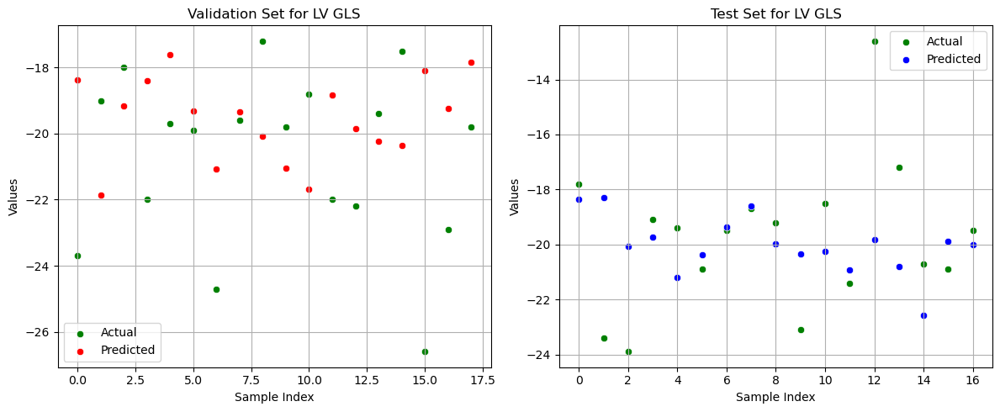

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 2.7677, MAPE (Val): 12.86%
MAE (Test): 1.9216, MAPE (Test): 10.57%

Średnie wyniki dla walidacji:
MAE: 2.5459, MAPE: 12.08%
Średnie wyniki dla testu:
MAE: 2.5510, MAPE: 12.93%
Trenowanie modelu dla kolumny LASr_ED z 5-krotną walidacją krzyżową
Fold 1/5


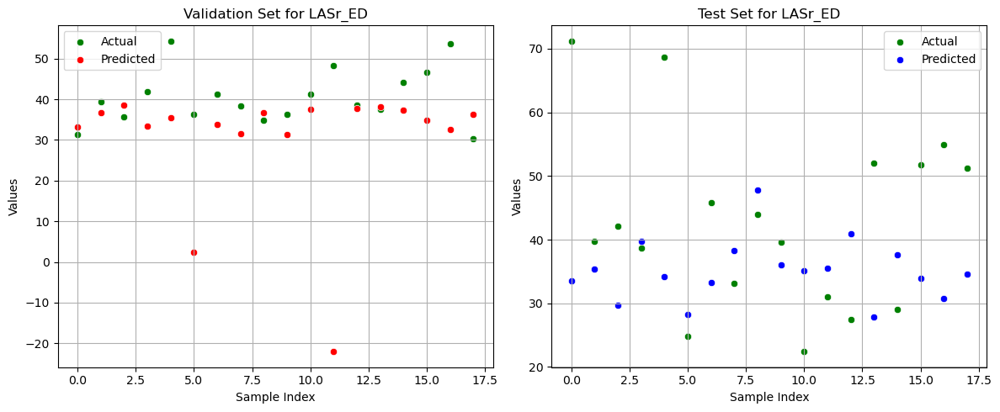

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 11.7132, MAPE (Val): 26.81%
MAE (Test): 13.3600, MAPE (Test): 29.35%

Fold 2/5


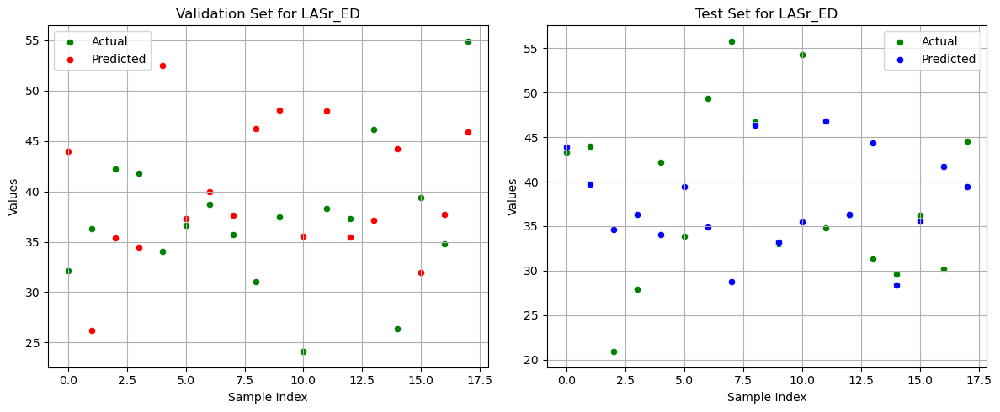

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 8.5247, MAPE (Val): 24.95%
MAE (Test): 8.0600, MAPE (Test): 21.56%

Fold 3/5


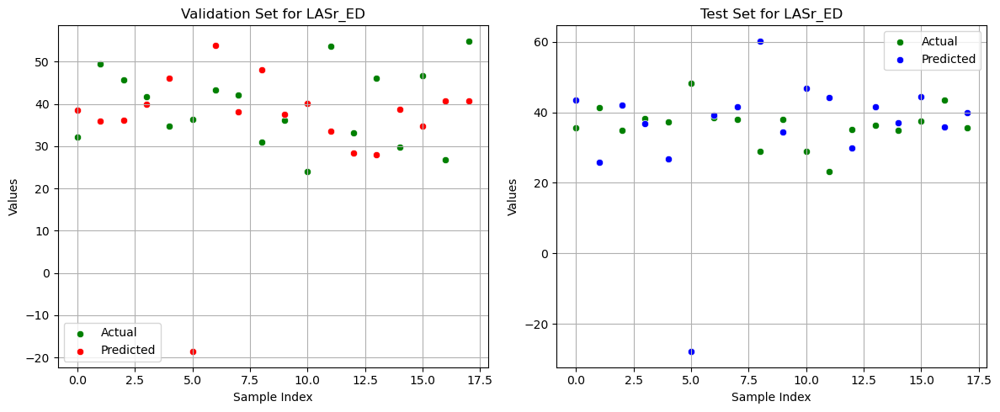

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 13.2689, MAPE (Val): 35.62%
MAE (Test): 12.6798, MAPE (Test): 35.24%

Fold 4/5


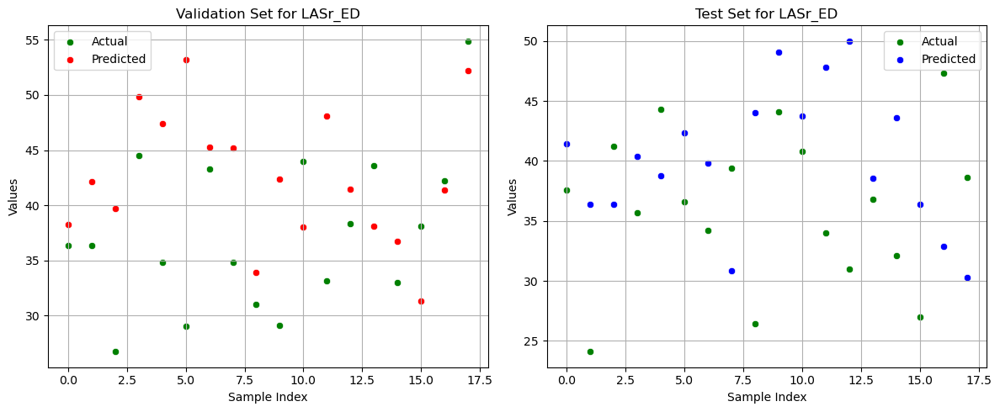

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 7.5099, MAPE (Val): 22.61%
MAE (Test): 8.6035, MAPE (Test): 25.95%

Fold 5/5


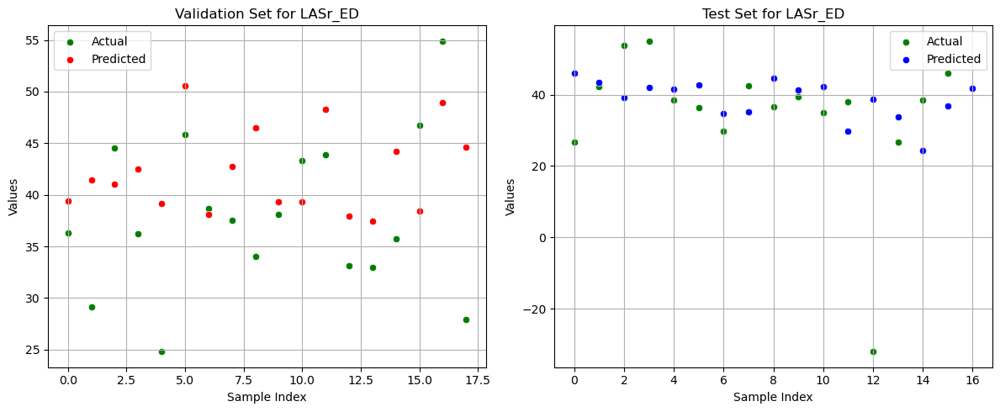

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 6.7300, MAPE (Val): 19.99%
MAE (Test): 11.5476, MAPE (Test): 32.85%

Średnie wyniki dla walidacji:
MAE: 9.5493, MAPE: 26.00%
Średnie wyniki dla testu:
MAE: 10.8502, MAPE: 28.99%
Trenowanie modelu dla kolumny LAScd_ED z 5-krotną walidacją krzyżową
Fold 1/5


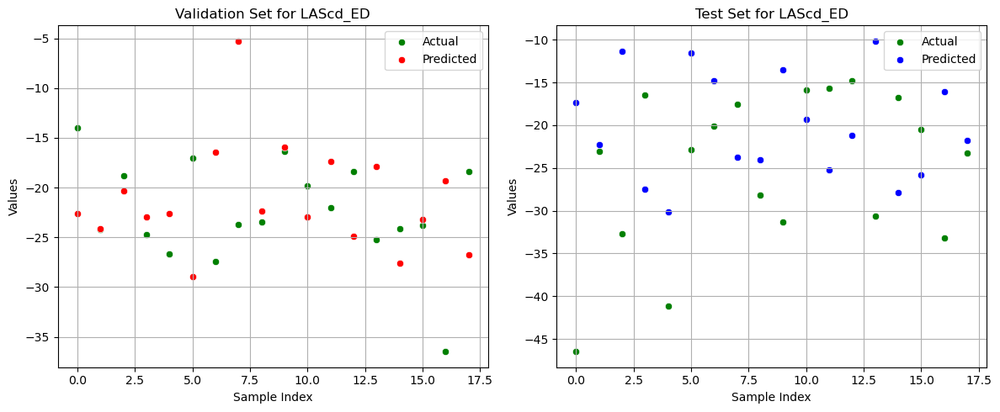

Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 6.1234, MAPE (Val): 27.72%
MAE (Test): 10.7229, MAPE (Test): 41.66%

Fold 2/5


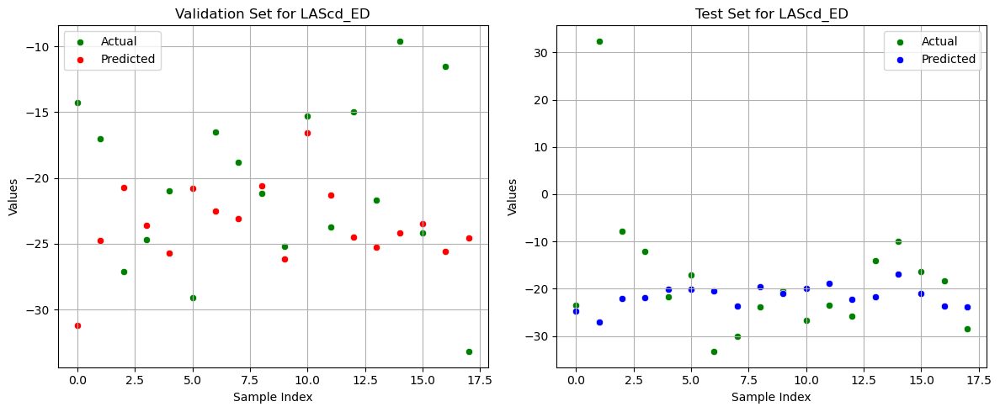

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 6.2173, MAPE (Val): 39.49%
MAE (Test): 8.7664, MAPE (Test): 45.30%

Fold 3/5


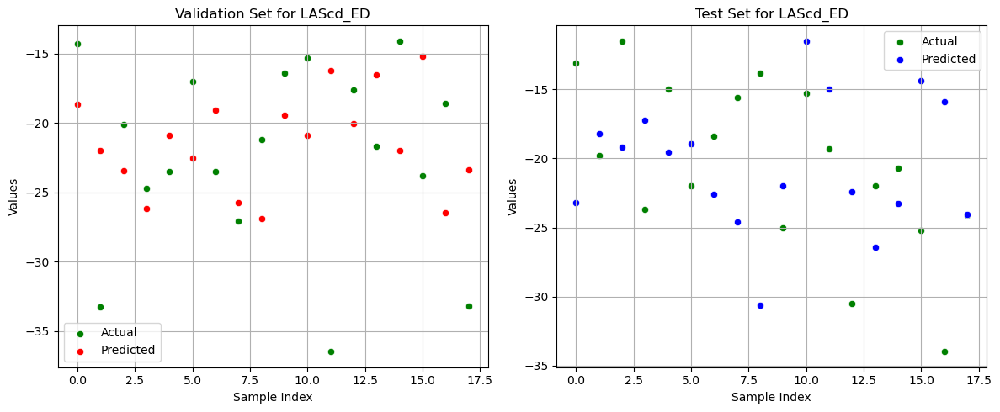

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 6.1586, MAPE (Val): 27.45%
MAE (Test): 6.5866, MAPE (Test): 35.55%

Fold 4/5


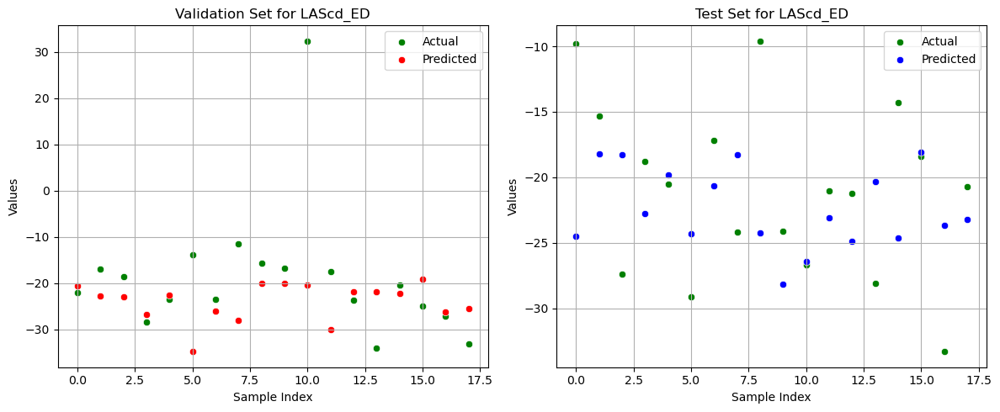

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 8.7503, MAPE (Val): 42.50%
MAE (Test): 5.5950, MAPE (Test): 34.83%

Fold 5/5


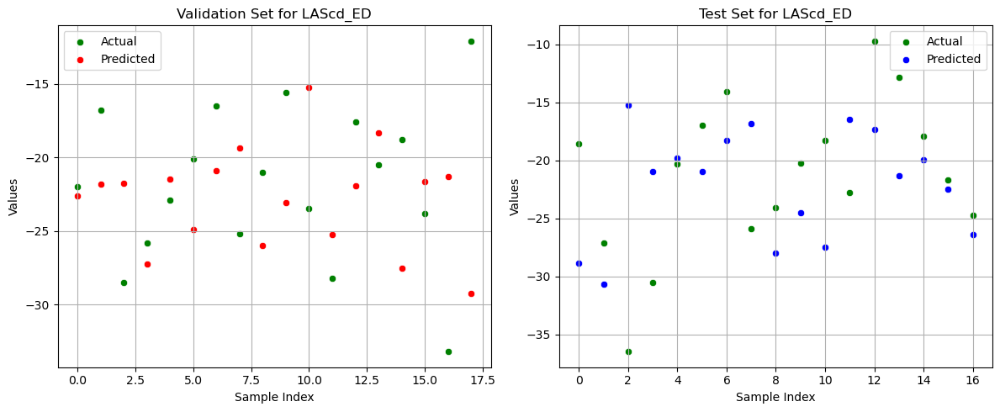

Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 5.5789, MAPE (Val): 29.31%
MAE (Test): 6.2752, MAPE (Test): 31.22%

Średnie wyniki dla walidacji:
MAE: 6.5657, MAPE: 33.29%
Średnie wyniki dla testu:
MAE: 7.5892, MAPE: 37.71%
Trenowanie modelu dla kolumny LASct_ED z 5-krotną walidacją krzyżową
Fold 1/5


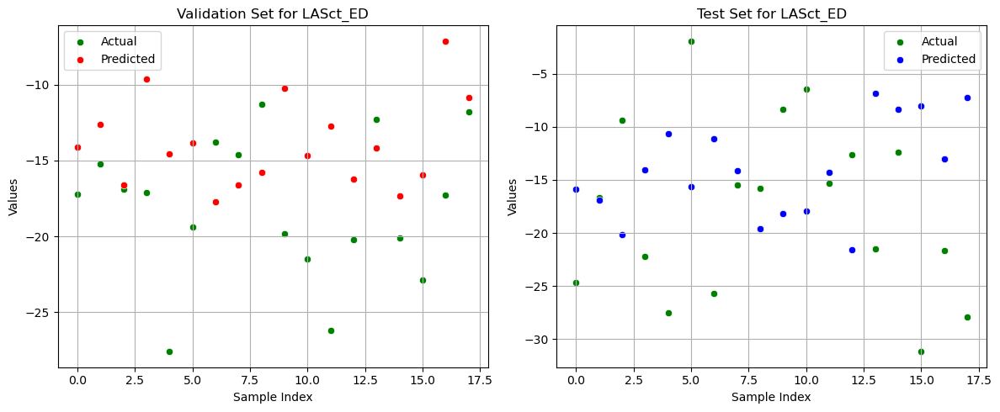

Best parameters: {'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 5.4979, MAPE (Val): 28.62%
MAE (Test): 10.0495, MAPE (Test): 95.96%

Fold 2/5


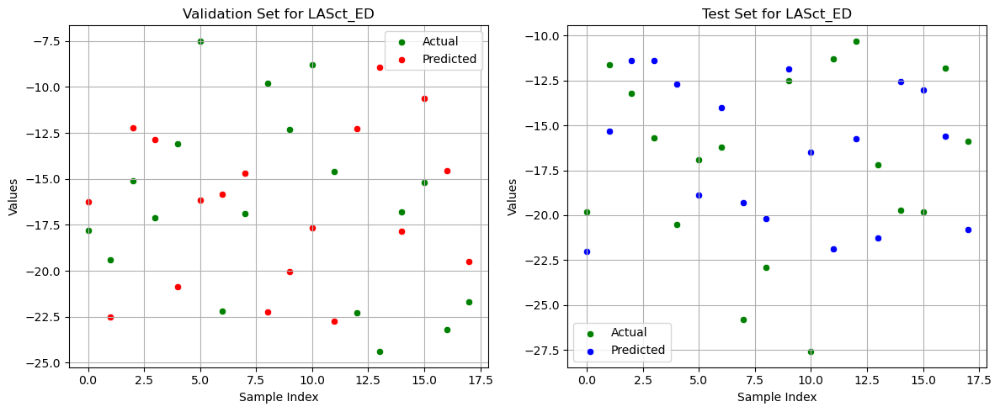

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 6.4410, MAPE (Val): 45.75%
MAE (Test): 4.8718, MAPE (Test): 29.64%

Fold 3/5


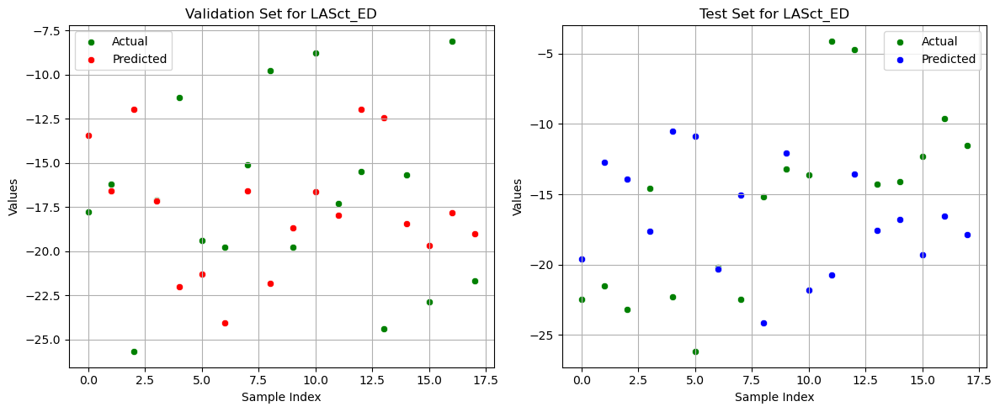

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 5.1317, MAPE (Val): 37.41%
MAE (Test): 7.1453, MAPE (Test): 67.09%

Fold 4/5


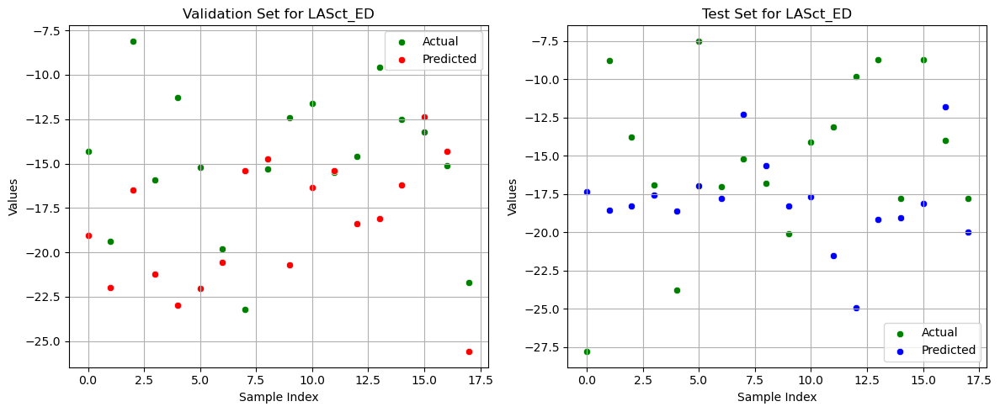

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 4.6297, MAPE (Val): 36.40%
MAE (Test): 5.5102, MAPE (Test): 48.83%

Fold 5/5


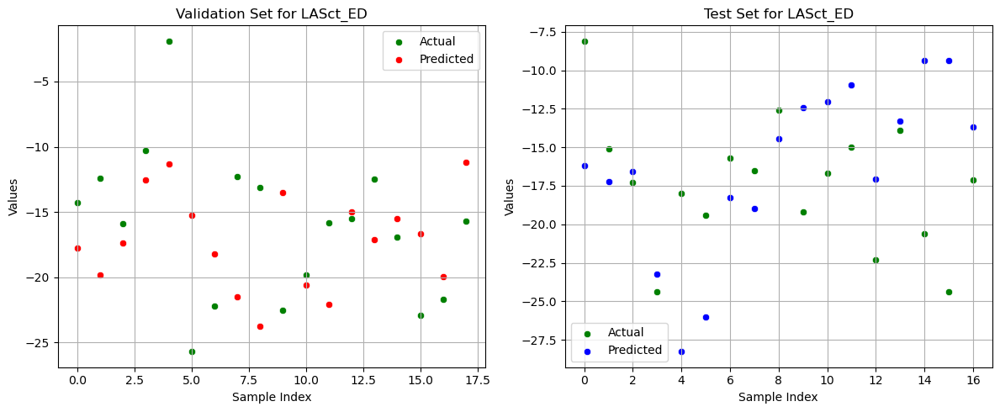

Best parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'subsample': 0.6}
MAE (Val): 5.1927, MAPE (Val): 56.74%
MAE (Test): 5.1162, MAPE (Test): 30.28%

Średnie wyniki dla walidacji:
MAE: 5.3786, MAPE: 40.98%
Średnie wyniki dla testu:
MAE: 6.5386, MAPE: 54.36%
Trenowanie modelu dla kolumny LASr_AC z 5-krotną walidacją krzyżową
Fold 1/5


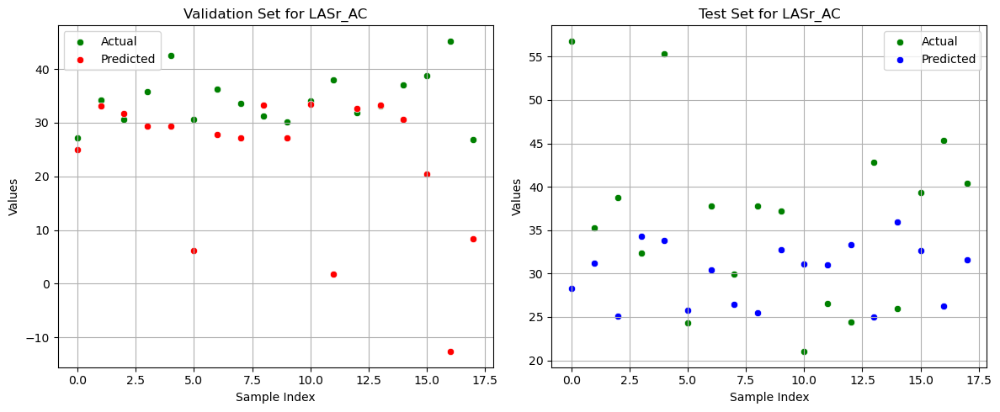

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 11.4775, MAPE (Val): 31.26%
MAE (Test): 10.2464, MAPE (Test): 26.97%

Fold 2/5


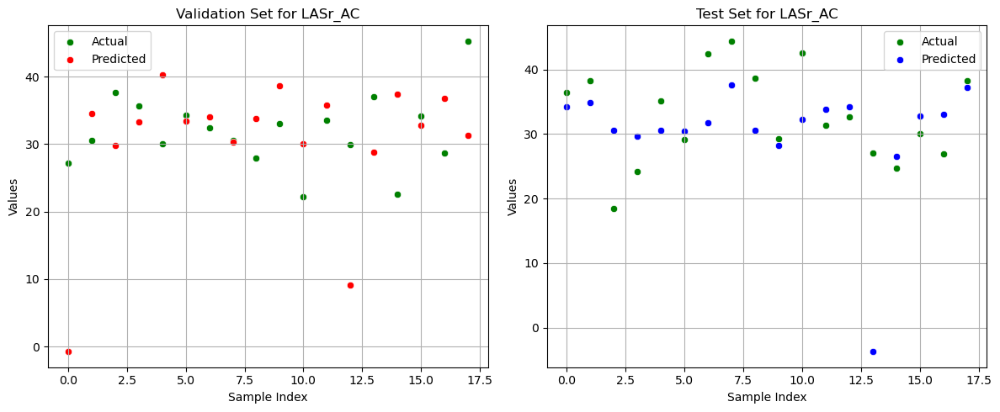

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 8.0069, MAPE (Val): 27.02%
MAE (Test): 6.2464, MAPE (Test): 20.99%

Fold 3/5


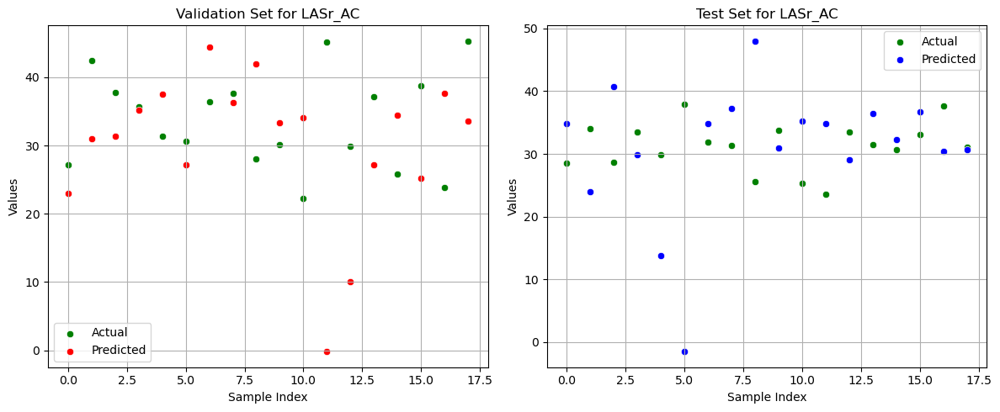

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 10.7436, MAPE (Val): 32.05%
MAE (Test): 9.1555, MAPE (Test): 29.89%

Fold 4/5


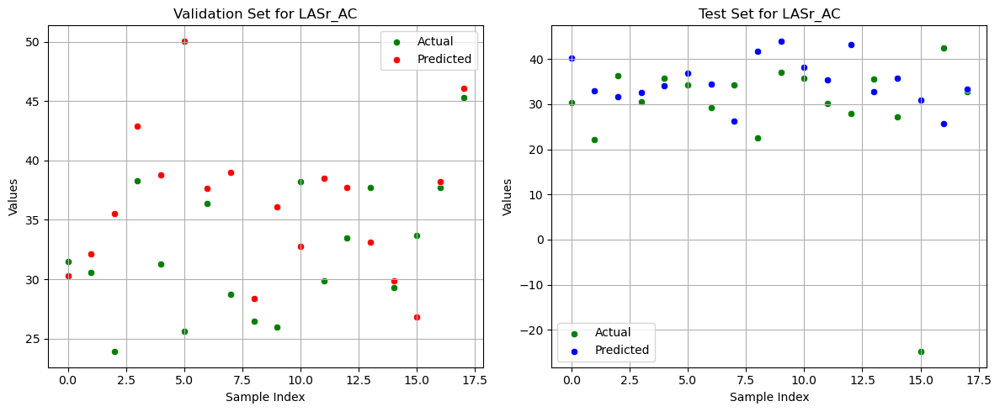

Best parameters: {'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 5.9023, MAPE (Val): 20.45%
MAE (Test): 9.8686, MAPE (Test): 35.52%

Fold 5/5


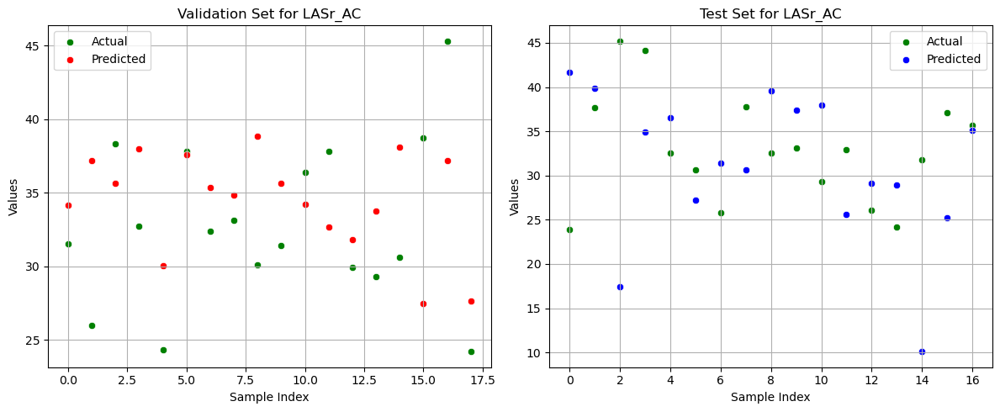

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 4.9636, MAPE (Val): 15.68%
MAE (Test): 8.6024, MAPE (Test): 26.22%

Średnie wyniki dla walidacji:
MAE: 8.2188, MAPE: 25.29%
Średnie wyniki dla testu:
MAE: 8.8238, MAPE: 27.92%
Trenowanie modelu dla kolumny LAScd_AC z 5-krotną walidacją krzyżową
Fold 1/5


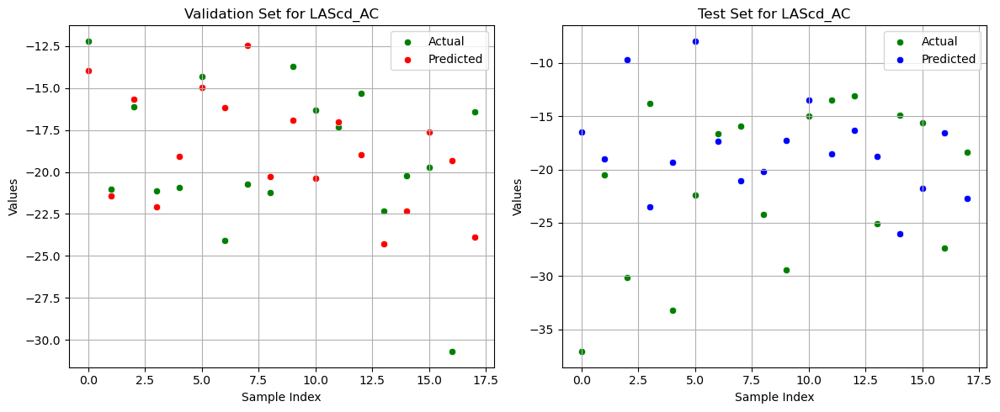

Best parameters: {'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 3.3005, MAPE (Val): 16.70%
MAE (Test): 8.3971, MAPE (Test): 37.58%

Fold 2/5


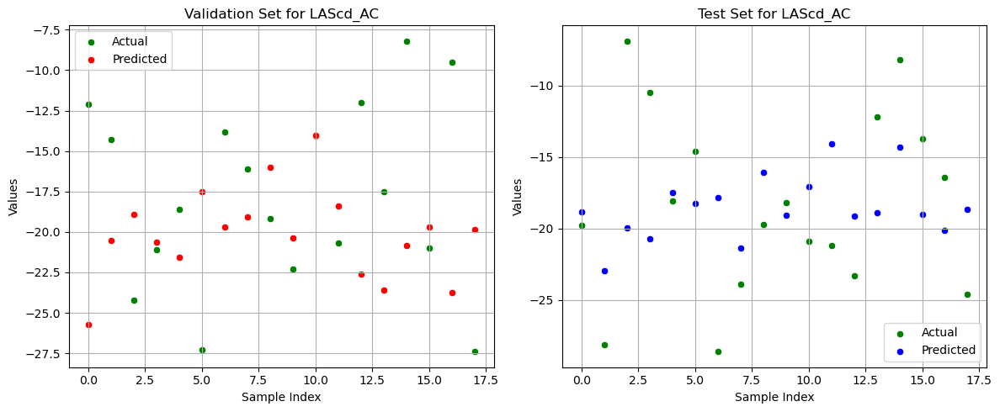

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 5.9479, MAPE (Val): 43.91%
MAE (Test): 5.2407, MAPE (Test): 38.59%

Fold 3/5


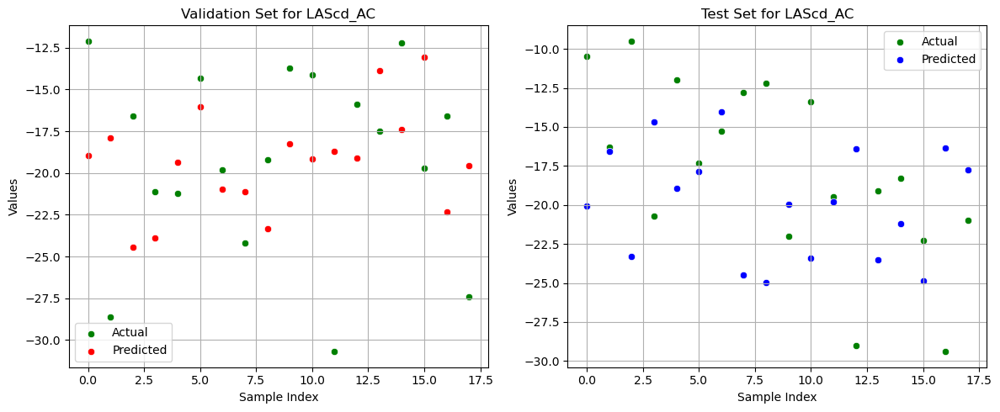

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 5.2203, MAPE (Val): 27.99%
MAE (Test): 6.3349, MAPE (Test): 42.89%

Fold 4/5


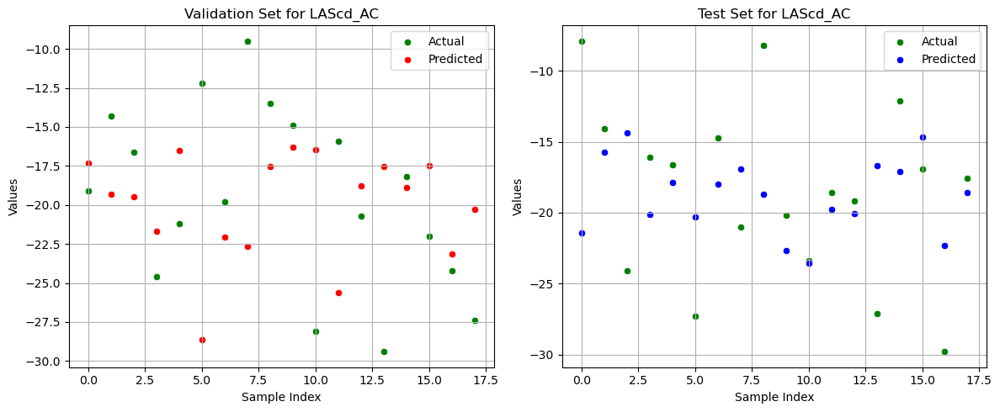

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 5.7263, MAPE (Val): 34.80%
MAE (Test): 4.7628, MAPE (Test): 33.23%

Fold 5/5


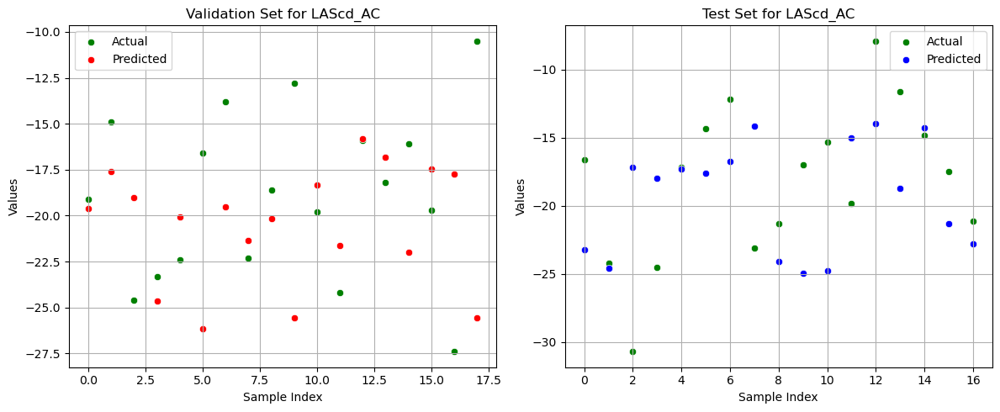

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 4.5208, MAPE (Val): 29.10%
MAE (Test): 5.1758, MAPE (Test): 31.09%

Średnie wyniki dla walidacji:
MAE: 4.9431, MAPE: 30.50%
Średnie wyniki dla testu:
MAE: 5.9823, MAPE: 36.67%
Trenowanie modelu dla kolumny LASct_AC z 5-krotną walidacją krzyżową
Fold 1/5


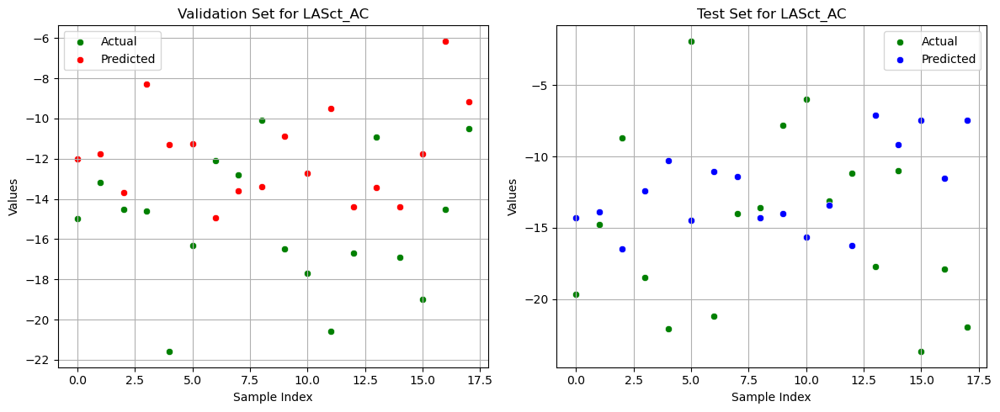

Best parameters: {'learning_rate': 0.05, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 4.4352, MAPE (Val): 27.63%
MAE (Test): 7.1622, MAPE (Test): 82.19%

Fold 2/5


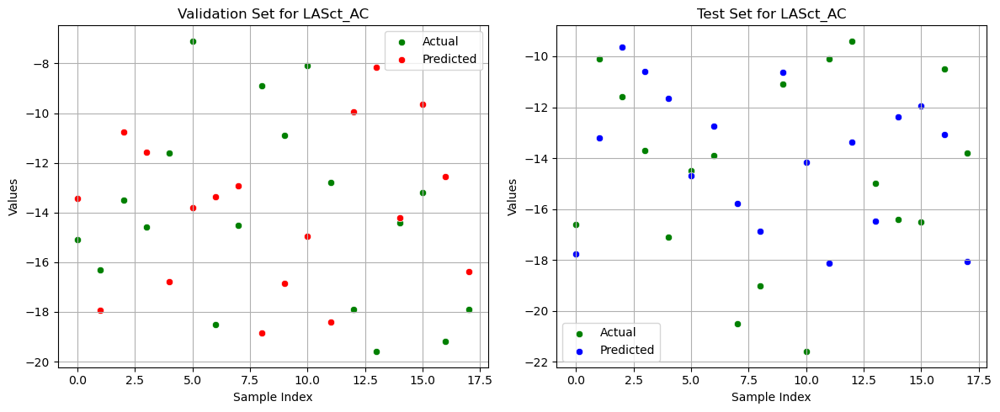

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 4.8529, MAPE (Val): 39.39%
MAE (Test): 3.3231, MAPE (Test): 23.95%

Fold 3/5


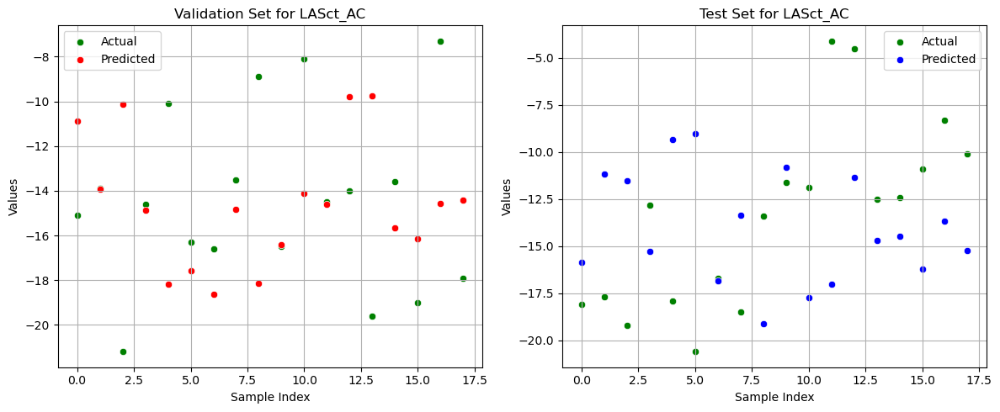

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 4.0836, MAPE (Val): 33.42%
MAE (Test): 5.3616, MAPE (Test): 55.83%

Fold 4/5


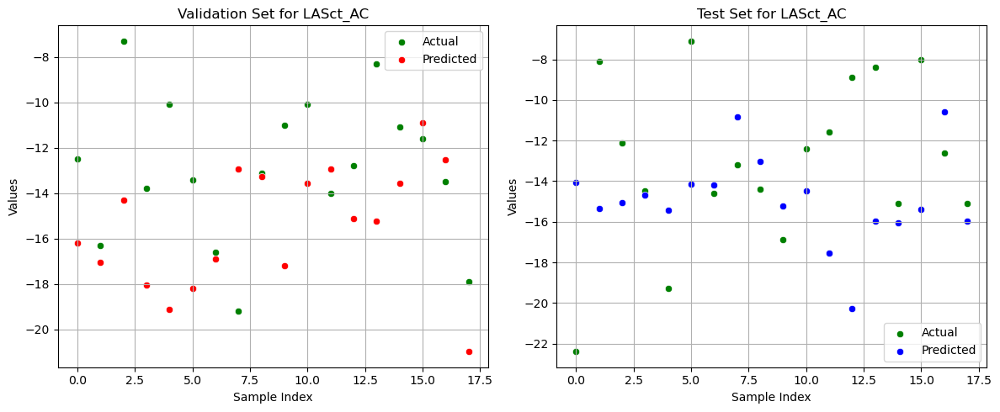

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 3.5183, MAPE (Val): 31.85%
MAE (Test): 4.0908, MAPE (Test): 39.88%

Fold 5/5


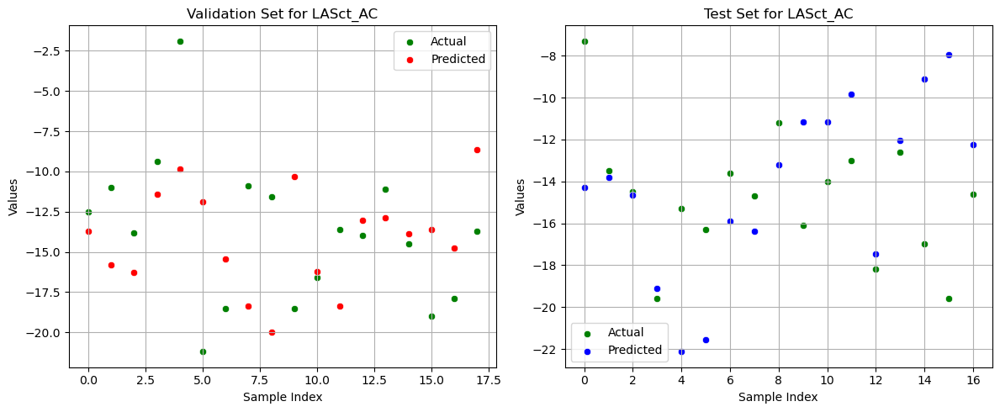

Best parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'subsample': 0.6}
MAE (Val): 4.2773, MAPE (Val): 50.26%
MAE (Test): 3.5374, MAPE (Test): 25.32%

Średnie wyniki dla walidacji:
MAE: 4.2335, MAPE: 36.51%
Średnie wyniki dla testu:
MAE: 4.6950, MAPE: 45.43%
Trenowanie modelu dla kolumny RVFWSL z 5-krotną walidacją krzyżową
Fold 1/5


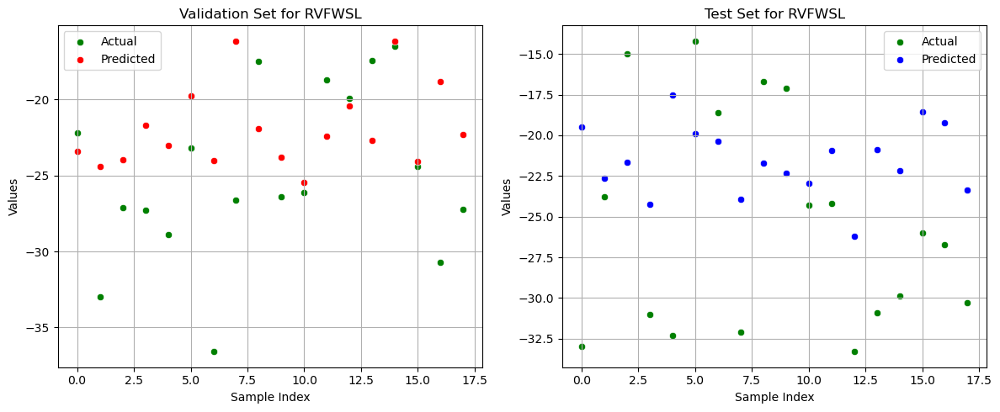

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 4.7521, MAPE (Val): 17.94%
MAE (Test): 6.6675, MAPE (Test): 26.19%

Fold 2/5


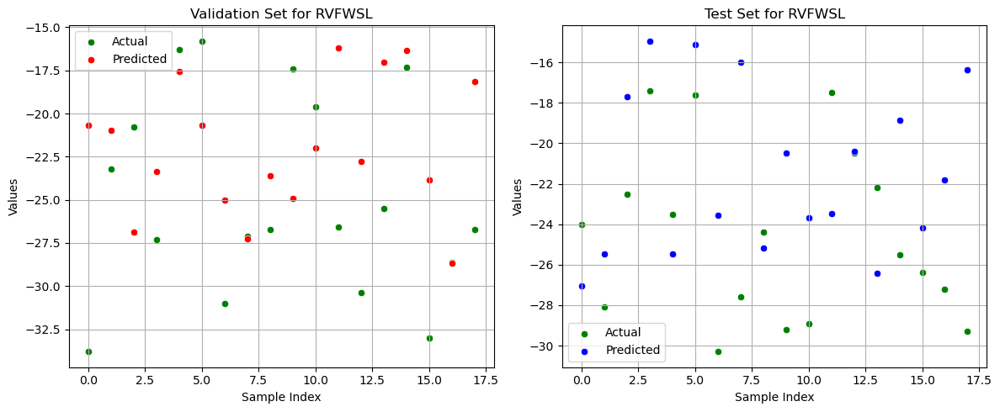

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 5.3308, MAPE (Val): 21.15%
MAE (Test): 4.8831, MAPE (Test): 19.29%

Fold 3/5


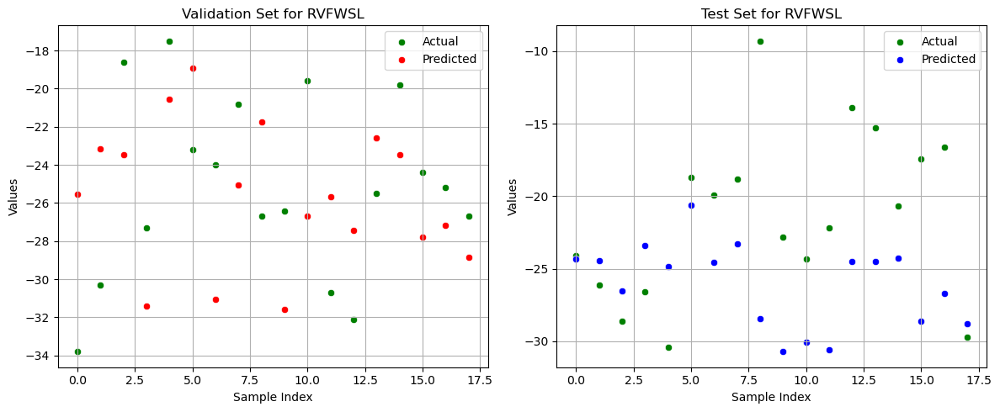

Best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 2000, 'subsample': 0.6}
MAE (Val): 4.6650, MAPE (Val): 18.87%
MAE (Test): 6.1445, MAPE (Test): 38.13%

Fold 4/5


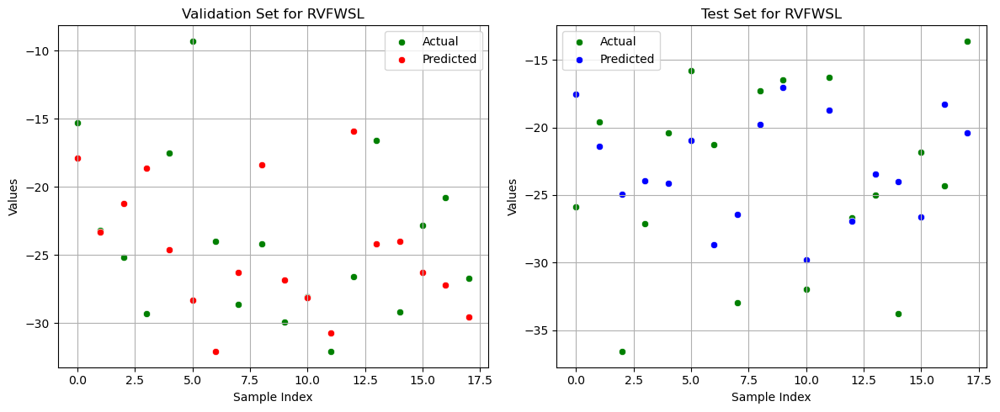

Best parameters: {'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 5.5846, MAPE (Val): 30.91%
MAE (Test): 4.6953, MAPE (Test): 20.11%

Fold 5/5


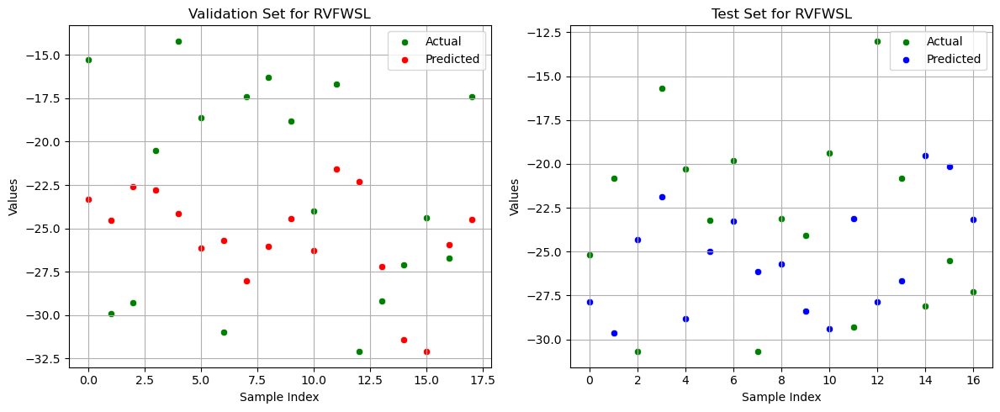

Best parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 6.1109, MAPE (Val): 30.57%
MAE (Test): 6.1291, MAPE (Test): 29.75%

Średnie wyniki dla walidacji:
MAE: 5.2887, MAPE: 23.89%
Średnie wyniki dla testu:
MAE: 5.7039, MAPE: 26.70%
Trenowanie modelu dla kolumny RV4CSL z 5-krotną walidacją krzyżową
Fold 1/5


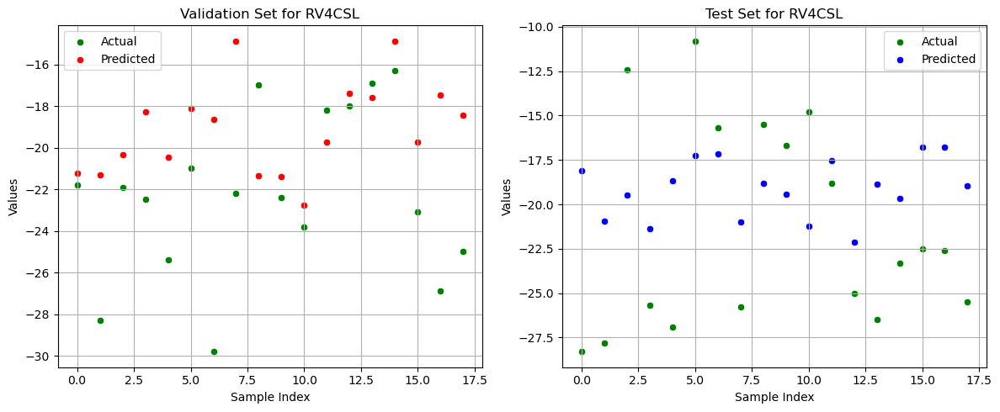

Best parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.6}
MAE (Val): 3.8680, MAPE (Val): 16.20%
MAE (Test): 5.3030, MAPE (Test): 26.33%

Fold 2/5


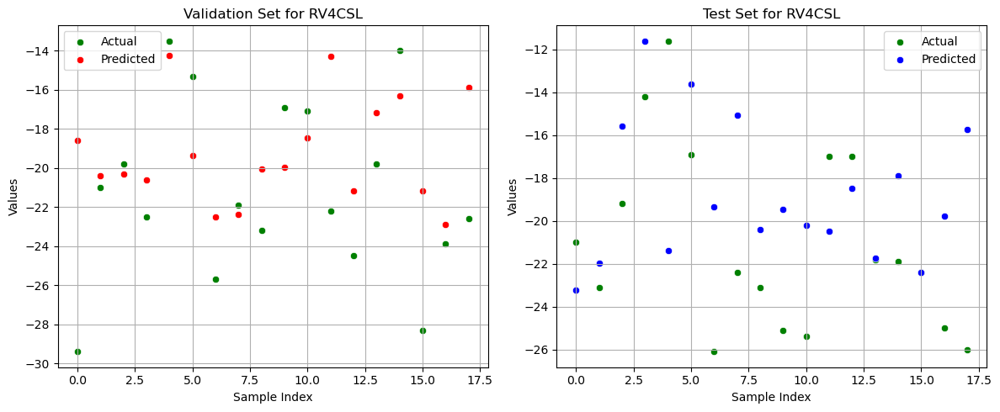

Best parameters: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.5}
MAE (Val): 3.3861, MAPE (Val): 15.29%
MAE (Test): 4.1573, MAPE (Test): 21.00%

Fold 3/5


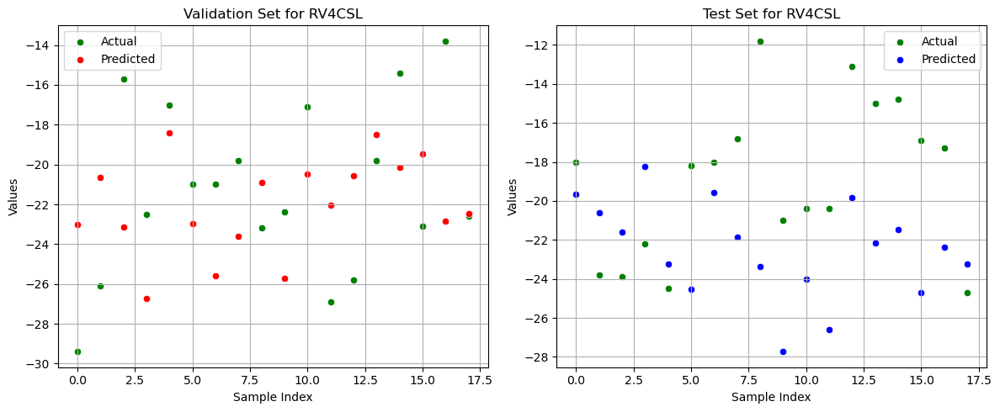

Best parameters: {'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 4.0662, MAPE (Val): 20.53%
MAE (Test): 4.9089, MAPE (Test): 29.60%

Fold 4/5


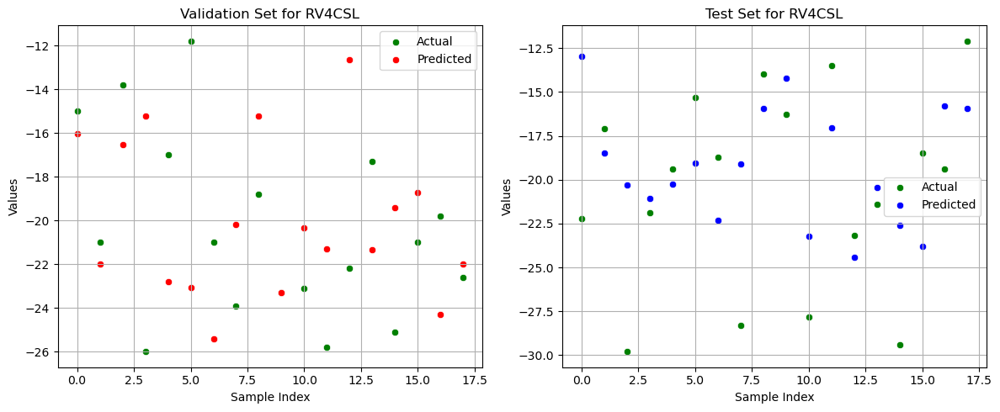

Best parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 2000, 'subsample': 0.6}
MAE (Val): 4.3463, MAPE (Val): 22.93%
MAE (Test): 4.0130, MAPE (Test): 19.30%

Fold 5/5


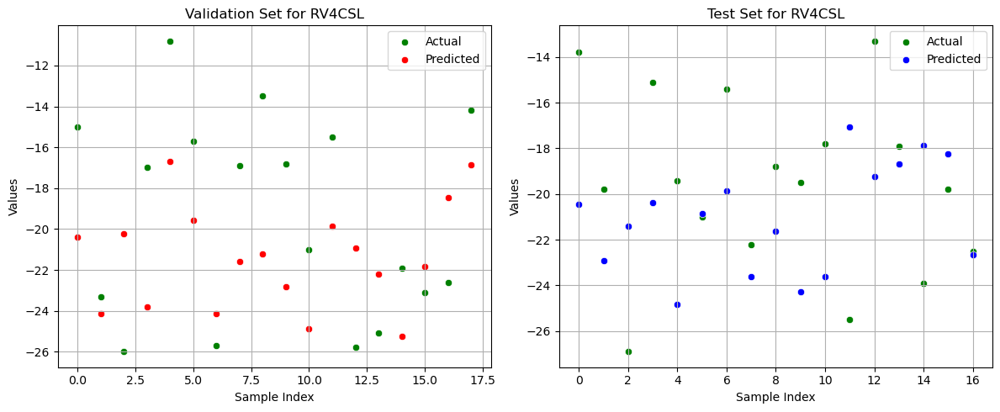

Best parameters: {'learning_rate': 0.01, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.8}
MAE (Val): 4.2243, MAPE (Val): 24.61%
MAE (Test): 4.0208, MAPE (Test): 21.86%

Średnie wyniki dla walidacji:
MAE: 3.9782, MAPE: 19.91%
Średnie wyniki dla testu:
MAE: 4.4806, MAPE: 23.61%


In [33]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Funkcja do obliczenia MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred) / np.abs(y_true)) * 100

# Funkcja oceny modelu regresji z użyciem MAE
def evaluate_regression_model(X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y_col):
    # Przeprowadzamy GridSearchCV w celu znalezienia najlepszych parametrów
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)
    
    # Używamy najlepszego modelu z GridSearchCV
    best_model = grid_search.best_estimator_
    
    # Ocena modelu na zbiorze treningowym
    y_train_pred = best_model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_train_pred)  # MAE dla treningu
    r2_train = r2_score(y_train, y_train_pred)

    # Ocena modelu na zbiorze walidacyjnym
    y_val_pred = best_model.predict(X_val)
    mae_val = mean_absolute_error(y_val, y_val_pred)  # MAE dla walidacji
    mape_val = mean_absolute_percentage_error(y_val, y_val_pred)
    r2_val = r2_score(y_val, y_val_pred)

    # Ocena modelu na zbiorze testowym
    y_test_pred = best_model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_test_pred)  # MAE dla testu
    mape_test = mean_absolute_percentage_error(y_test, y_test_pred)
    r2_test = r2_score(y_test, y_test_pred)

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val_pred, color='red', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Validation Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test_pred, color='blue', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Test Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    plt.show()
    
    return grid_search.best_params_, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test

# Cross-validation z 5-krotnym podziałem dla regresji
def cross_validate_regression(X, y, model, param_grid, cv=5):
    X = X.values  # Konwersja do tablicy NumPy
    kf = KFold(n_splits=cv, shuffle=True, random_state=43)
    
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X)  # Skalowanie całego zbioru przed podziałem
    
    fold = 1
    val_results = []  # Lista do przechowywania wyników walidacyjnych
    test_results = []  # Lista do przechowywania wyników testowych
    
    for train_idx, test_idx in kf.split(X_scaled):
        print(f"Fold {fold}/{cv}")
        X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
        
        # Dalszy podział zbioru treningowego na train/val (60/20)
        X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=43)  # 25% z 60% na walidację
        
        best_params, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test = evaluate_regression_model(
            X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y.name)
        
        val_results.append((mae_val, mape_val, r2_val))
        test_results.append((mae_test, mape_test, r2_test))
        
        print(f"Best parameters: {best_params}")
        print(f"MAE (Val): {mae_val:.4f}, MAPE (Val): {mape_val:.2f}%")
        print(f"MAE (Test): {mae_test:.4f}, MAPE (Test): {mape_test:.2f}%\n")
        
        fold += 1
    
    # Obliczanie średnich wartości dla walidacji i testu
    val_mae_mean = np.mean([result[0] for result in val_results])
    val_mape_mean = np.mean([result[1] for result in val_results])
    
    test_mae_mean = np.mean([result[0] for result in test_results])
    test_mape_mean = np.mean([result[1] for result in test_results])
    
    print("Średnie wyniki dla walidacji:")
    print(f"MAE: {val_mae_mean:.4f}, MAPE: {val_mape_mean:.2f}%")
    print("Średnie wyniki dla testu:")
    print(f"MAE: {test_mae_mean:.4f}, MAPE: {test_mape_mean:.2f}%")


param_grid = {
    'n_estimators': [500, 1000, 2000],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 4, 5],
    'subsample': [0.5, 0.6, 0.8],
}

# Trenowanie modelu dla każdej kolumny z 5-krotną walidacją krzyżową
for y_col in y.columns:
    print(f"Trenowanie modelu dla kolumny {y_col} z 5-krotną walidacją krzyżową")
    model = GradientBoostingRegressor(random_state=43)
    cross_validate_regression(X, y[y_col], model, param_grid, cv=5)


### RadomForest

Trenowanie modelu dla kolumny LV A2C z 5-krotną walidacją krzyżową
Fold 1/5


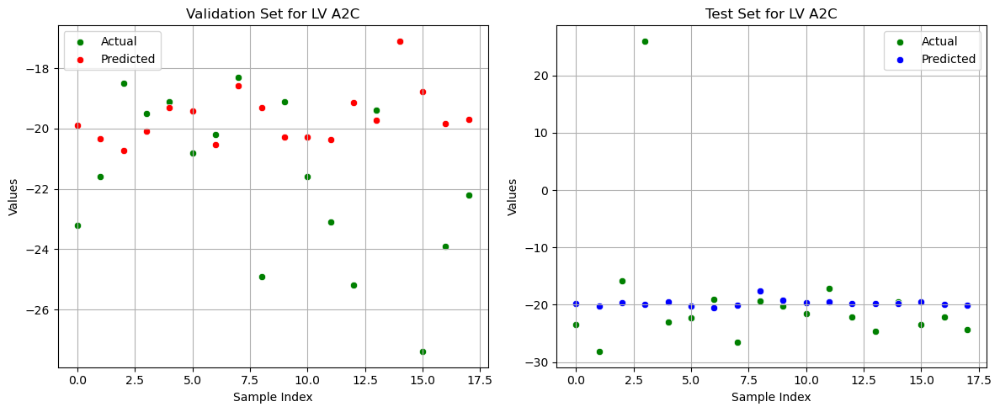

Best parameters: {'max_depth': 2, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 2.3328, MAPE (Val): 9.90%
MAE (Test): 5.5637, MAPE (Test): 23.08%

Fold 2/5


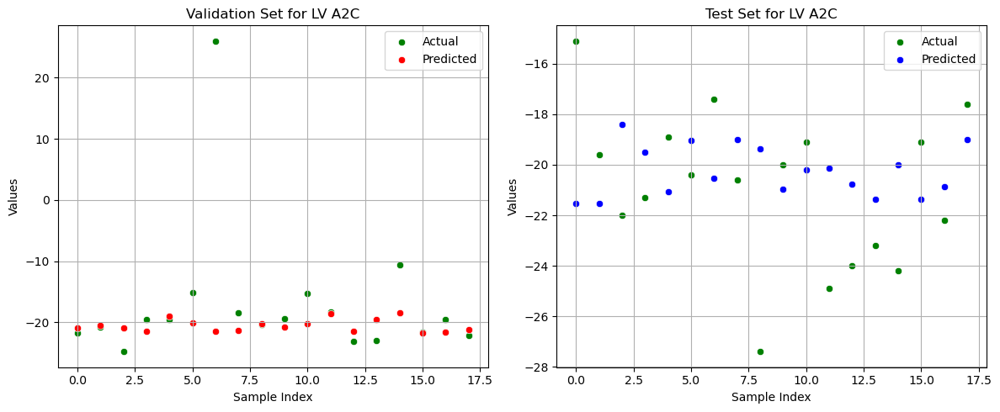

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 1800}
MAE (Val): 4.7722, MAPE (Val): 23.25%
MAE (Test): 2.8443, MAPE (Test): 13.61%

Fold 3/5


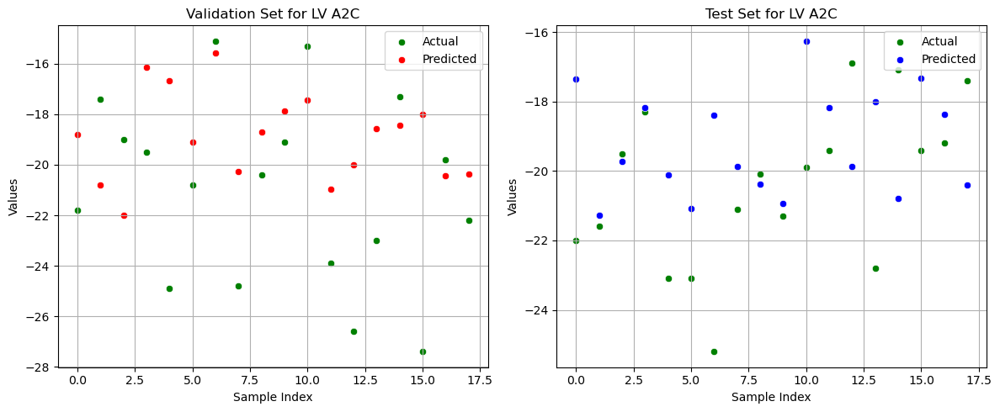

Best parameters: {'max_depth': 3, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 3.3200, MAPE (Val): 14.80%
MAE (Test): 2.2931, MAPE (Test): 11.07%

Fold 4/5


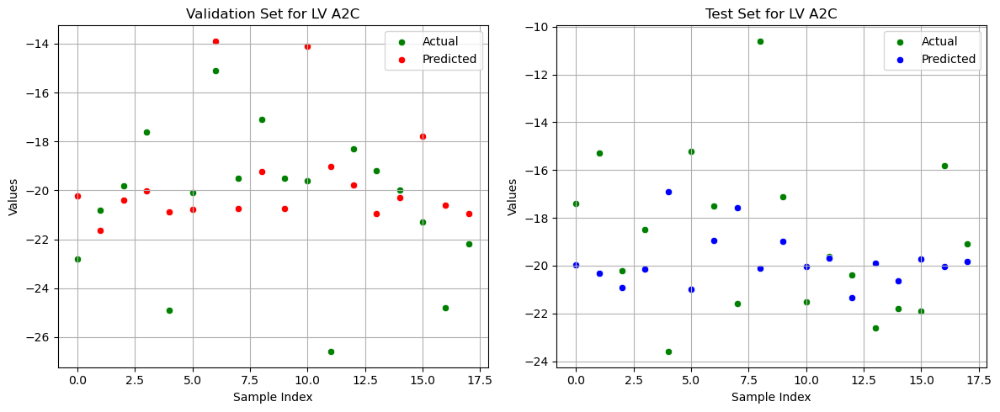

Best parameters: {'max_depth': 2, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 2400}
MAE (Val): 2.3648, MAPE (Val): 11.07%
MAE (Test): 2.9339, MAPE (Test): 17.99%

Fold 5/5


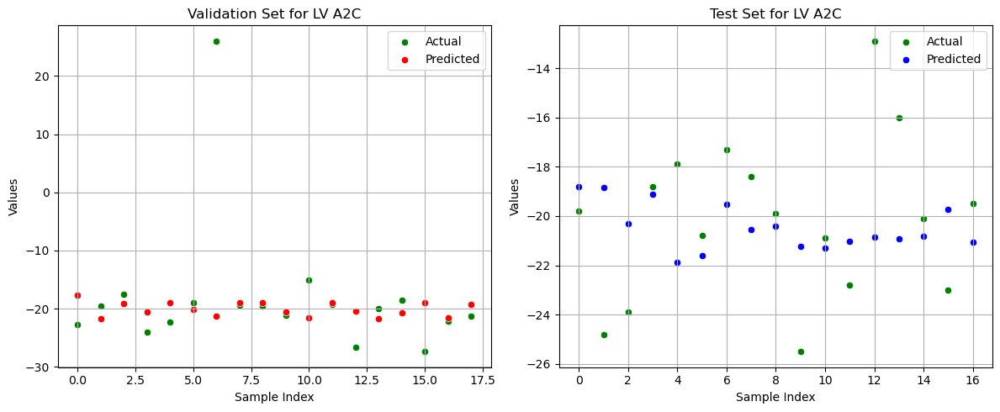

Best parameters: {'max_depth': 2, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 5.2187, MAPE (Val): 22.26%
MAE (Test): 2.6669, MAPE (Test): 14.31%

Średnie wyniki dla walidacji:
MAE: 3.6017, MAPE: 16.26%
Średnie wyniki dla testu:
MAE: 3.2604, MAPE: 16.01%
Trenowanie modelu dla kolumny LVA3C z 5-krotną walidacją krzyżową
Fold 1/5


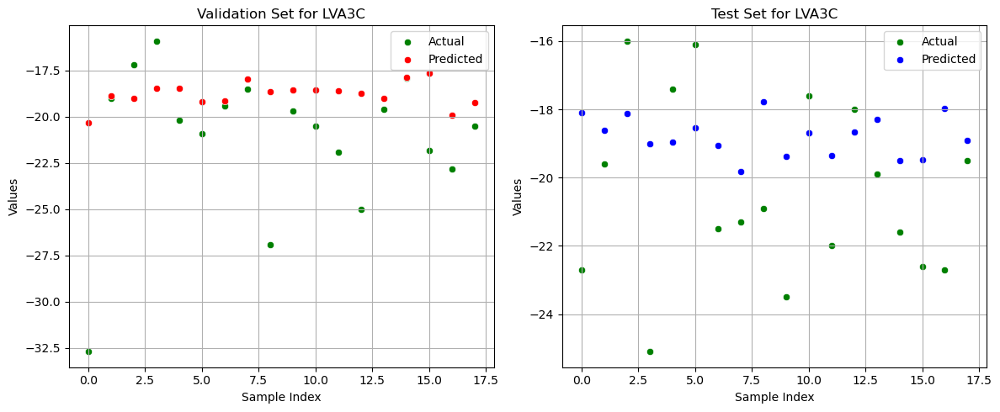

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 2.8394, MAPE (Val): 11.89%
MAE (Test): 2.5276, MAPE (Test): 11.95%

Fold 2/5


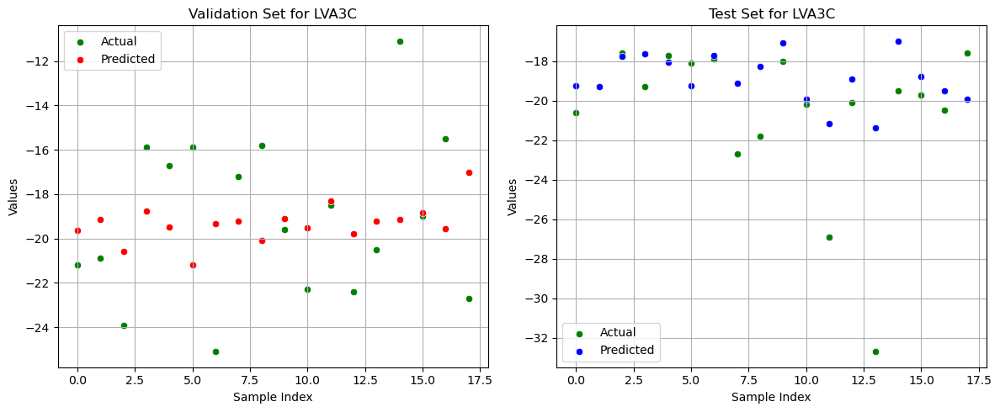

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 3.0555, MAPE (Val): 17.67%
MAE (Test): 2.1233, MAPE (Test): 8.98%

Fold 3/5


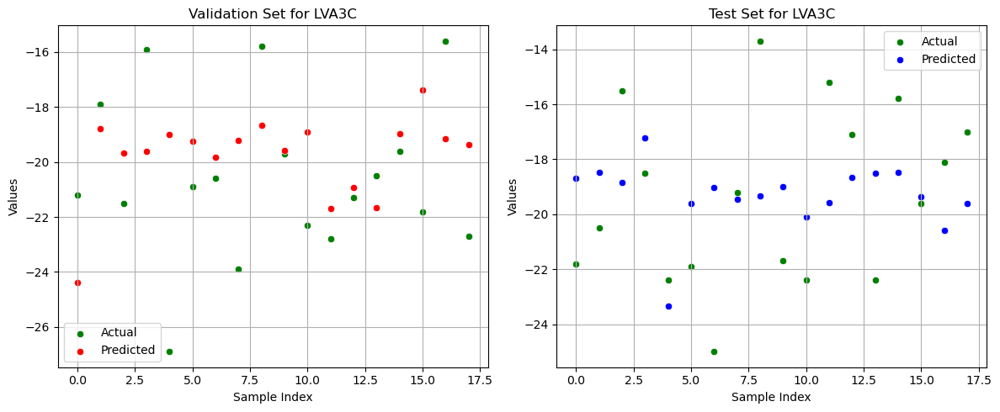

Best parameters: {'max_depth': 3, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 2.5350, MAPE (Val): 12.22%
MAE (Test): 2.6478, MAPE (Test): 14.38%

Fold 4/5


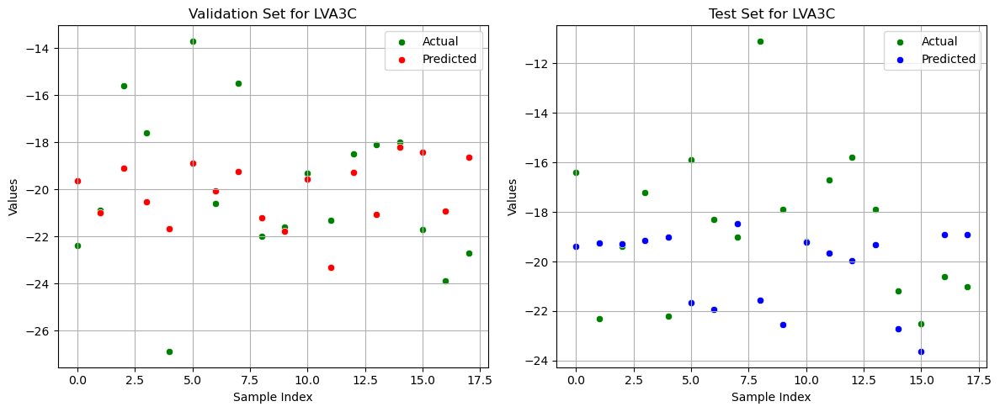

Best parameters: {'max_depth': 2, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 2.3083, MAPE (Val): 12.15%
MAE (Test): 2.8505, MAPE (Test): 17.76%

Fold 5/5


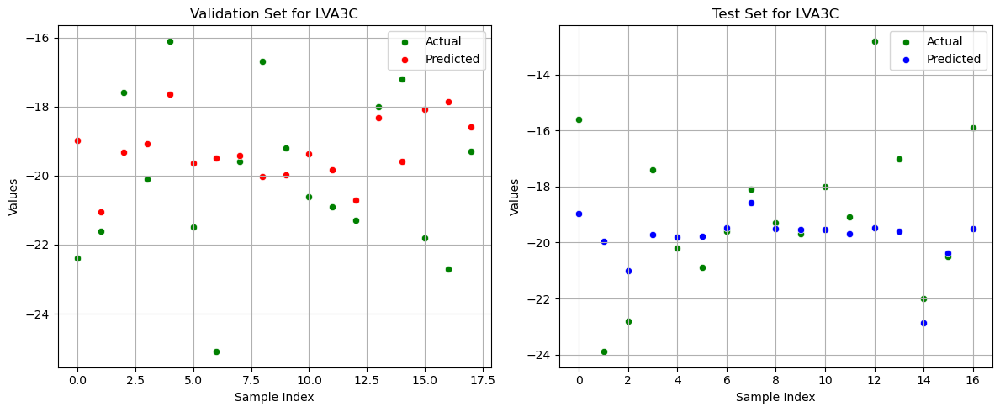

Best parameters: {'max_depth': 3, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 1.9371, MAPE (Val): 9.43%
MAE (Test): 1.7594, MAPE (Test): 10.47%

Średnie wyniki dla walidacji:
MAE: 2.5351, MAPE: 12.67%
Średnie wyniki dla testu:
MAE: 2.3817, MAPE: 12.71%
Trenowanie modelu dla kolumny LVA4C z 5-krotną walidacją krzyżową
Fold 1/5


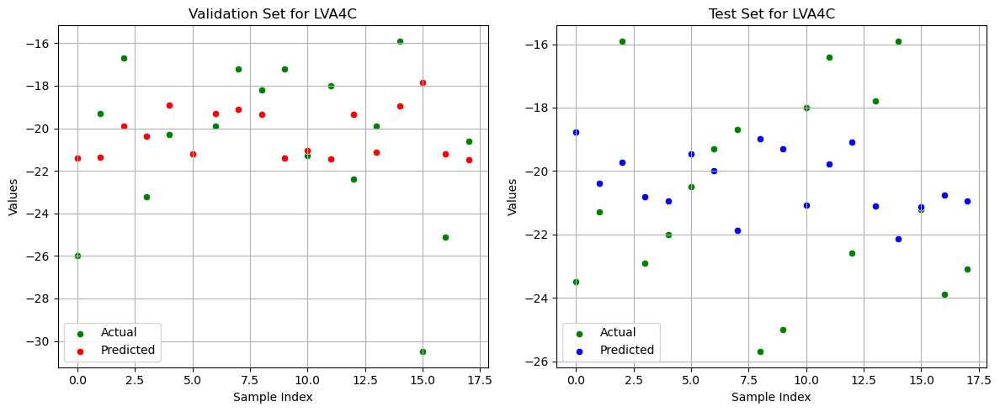

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 2.7977, MAPE (Val): 12.88%
MAE (Test): 3.0446, MAPE (Test): 15.04%

Fold 2/5


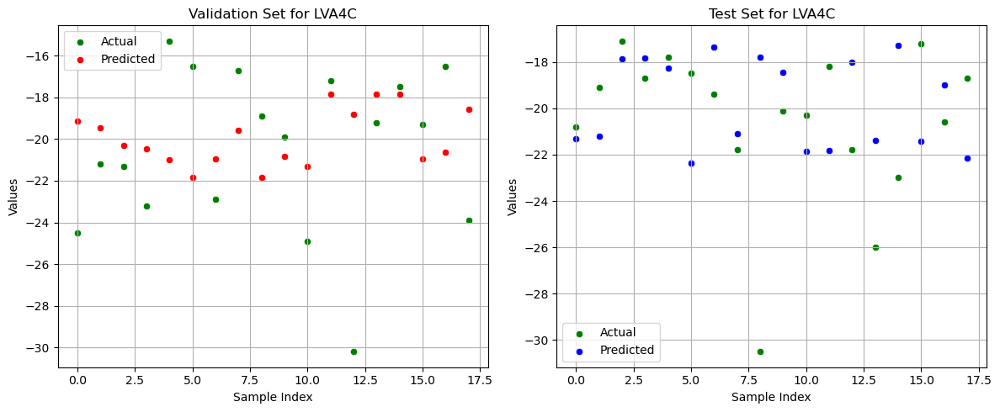

Best parameters: {'max_depth': 3, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 3.2744, MAPE (Val): 15.70%
MAE (Test): 3.0138, MAPE (Test): 13.78%

Fold 3/5


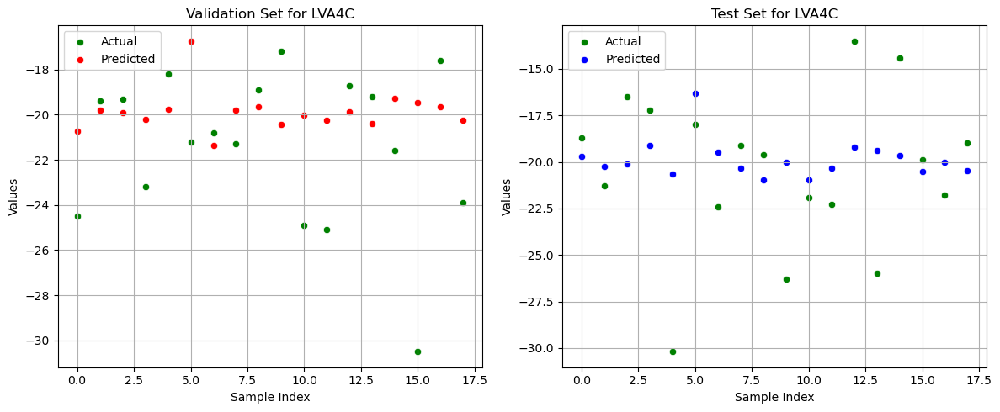

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 2000}
MAE (Val): 2.8302, MAPE (Val): 12.26%
MAE (Test): 3.0547, MAPE (Test): 15.05%

Fold 4/5


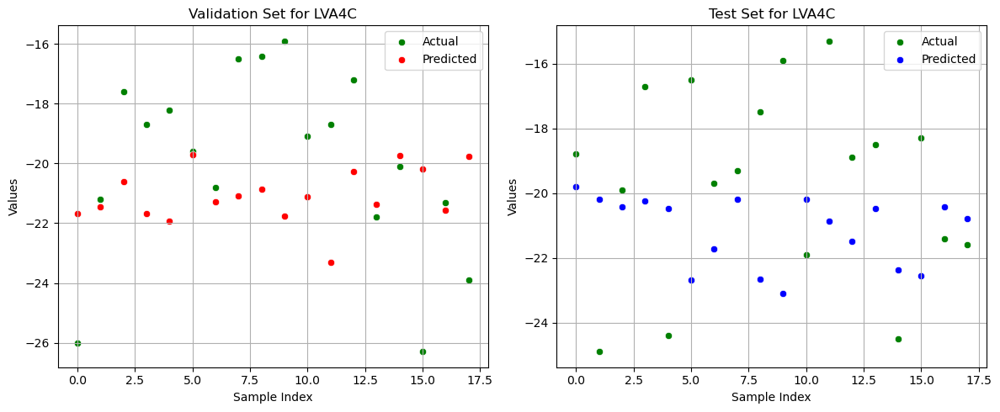

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 2.8197, MAPE (Val): 14.69%
MAE (Test): 3.0653, MAPE (Test): 16.68%

Fold 5/5


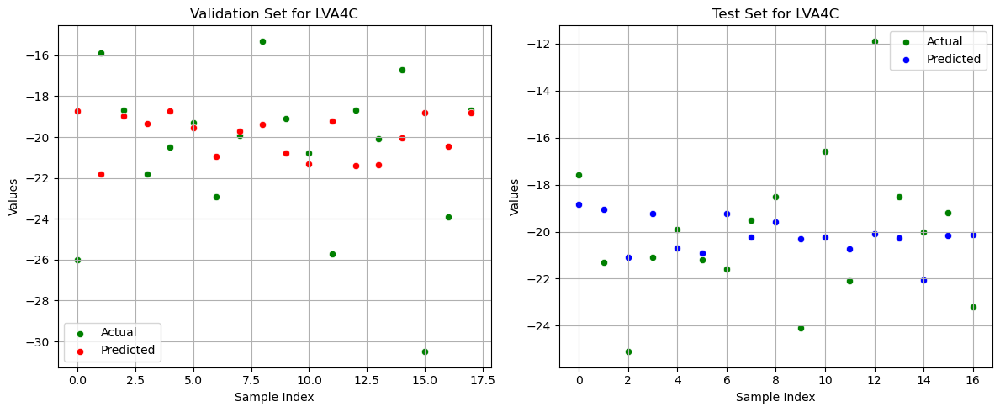

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 3.0799, MAPE (Val): 14.15%
MAE (Test): 2.3186, MAPE (Test): 12.87%

Średnie wyniki dla walidacji:
MAE: 2.9604, MAPE: 13.94%
Średnie wyniki dla testu:
MAE: 2.8994, MAPE: 14.68%
Trenowanie modelu dla kolumny LV GLS z 5-krotną walidacją krzyżową
Fold 1/5


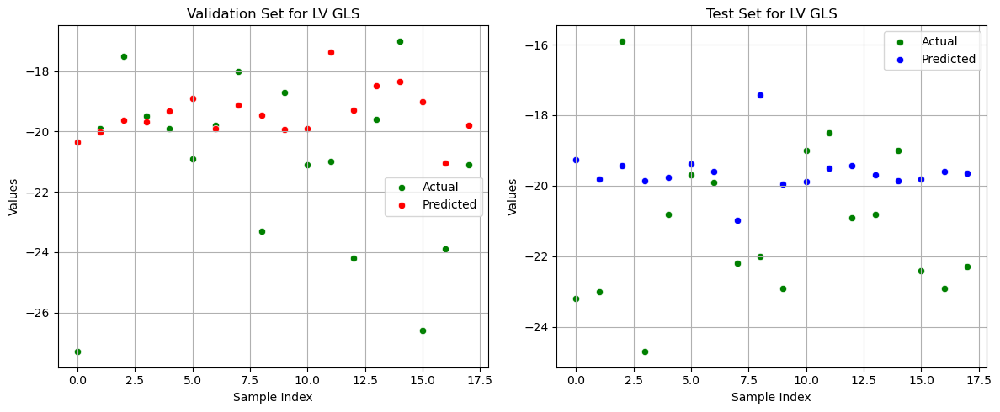

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 2.3416, MAPE (Val): 10.26%
MAE (Test): 2.2123, MAPE (Test): 10.28%

Fold 2/5


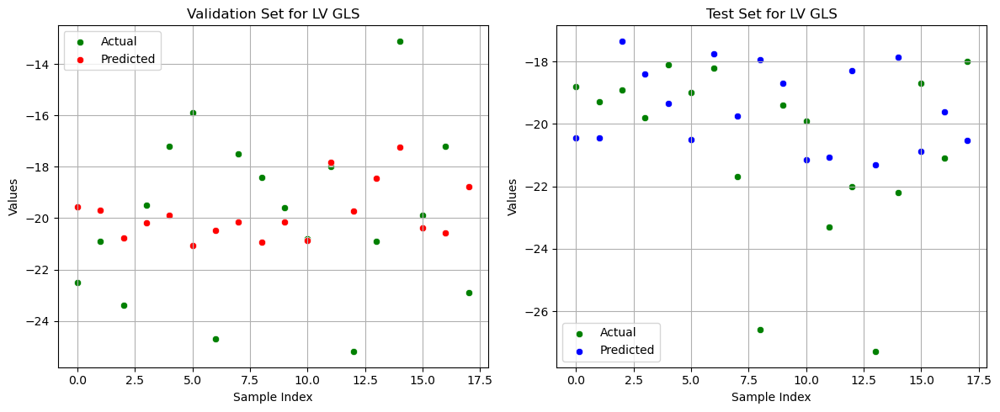

Best parameters: {'max_depth': 2, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 2.5304, MAPE (Val): 13.16%
MAE (Test): 2.4443, MAPE (Test): 11.08%

Fold 3/5


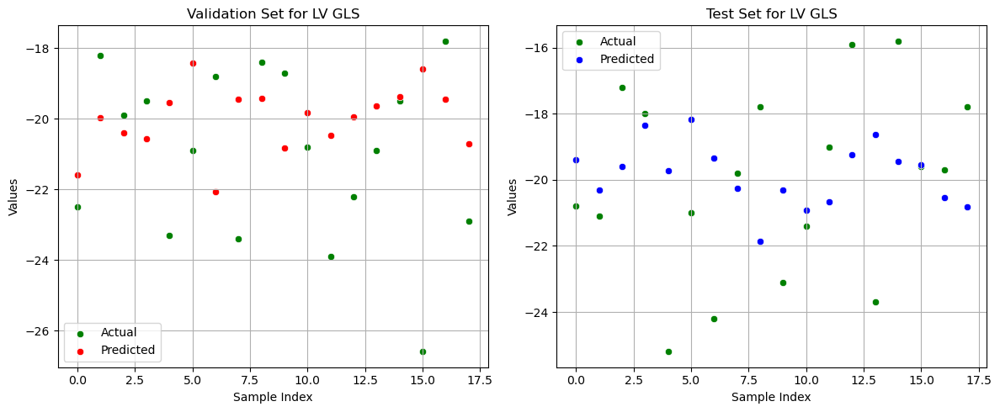

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 2200}
MAE (Val): 2.2626, MAPE (Val): 10.31%
MAE (Test): 2.4174, MAPE (Test): 12.04%

Fold 4/5


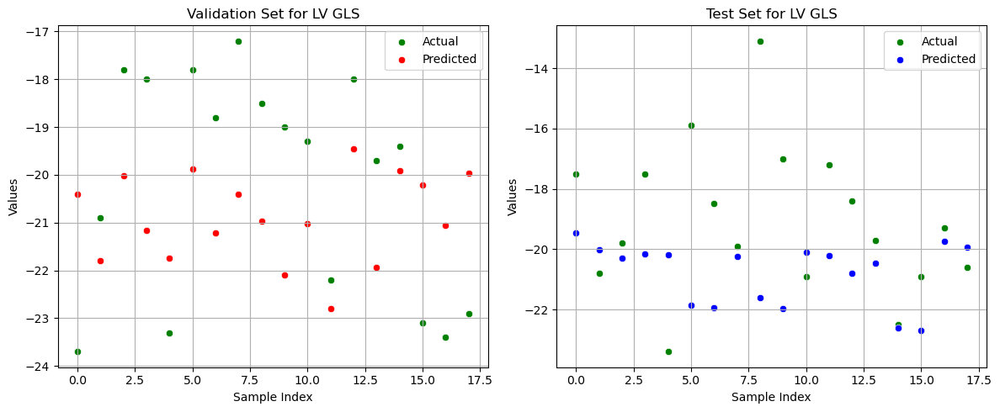

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 2.1696, MAPE (Val): 10.92%
MAE (Test): 2.3517, MAPE (Test): 13.96%

Fold 5/5


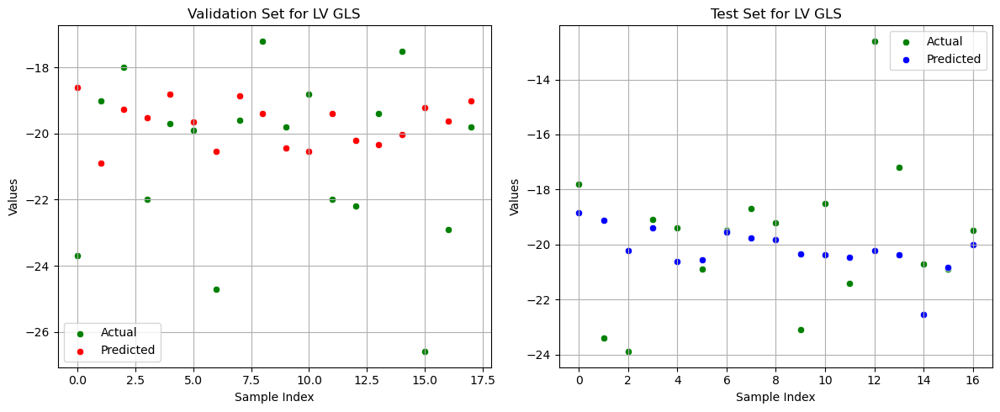

Best parameters: {'max_depth': 2, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 2400}
MAE (Val): 2.2733, MAPE (Val): 10.44%
MAE (Test): 1.8458, MAPE (Test): 10.32%

Średnie wyniki dla walidacji:
MAE: 2.3155, MAPE: 11.02%
Średnie wyniki dla testu:
MAE: 2.2543, MAPE: 11.54%
Trenowanie modelu dla kolumny LASr_ED z 5-krotną walidacją krzyżową
Fold 1/5


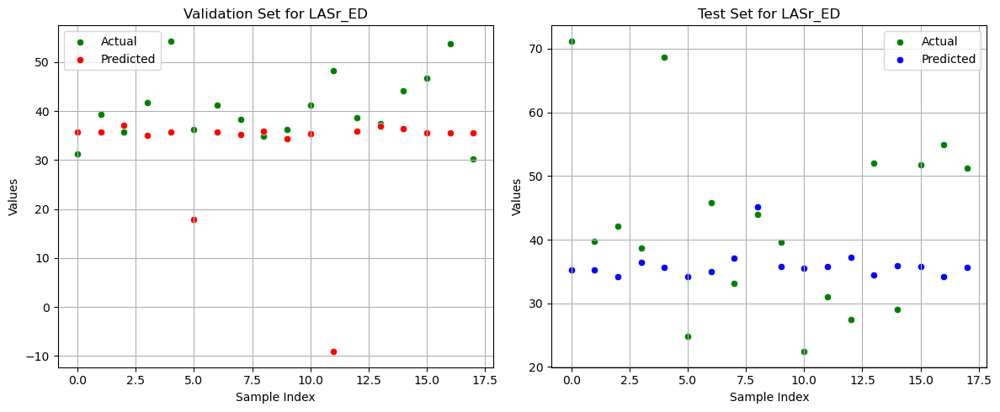

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 9.6522, MAPE (Val): 21.83%
MAE (Test): 12.0682, MAPE (Test): 27.05%

Fold 2/5


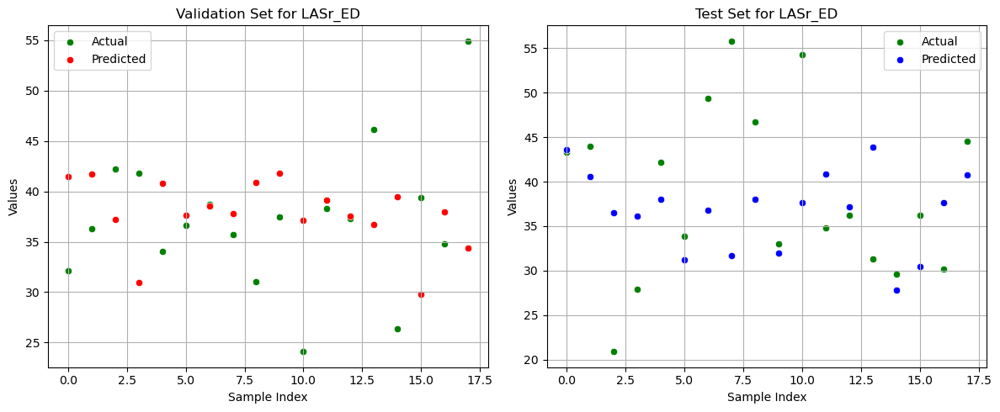

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 6.9303, MAPE (Val): 19.55%
MAE (Test): 7.5471, MAPE (Test): 20.39%

Fold 3/5


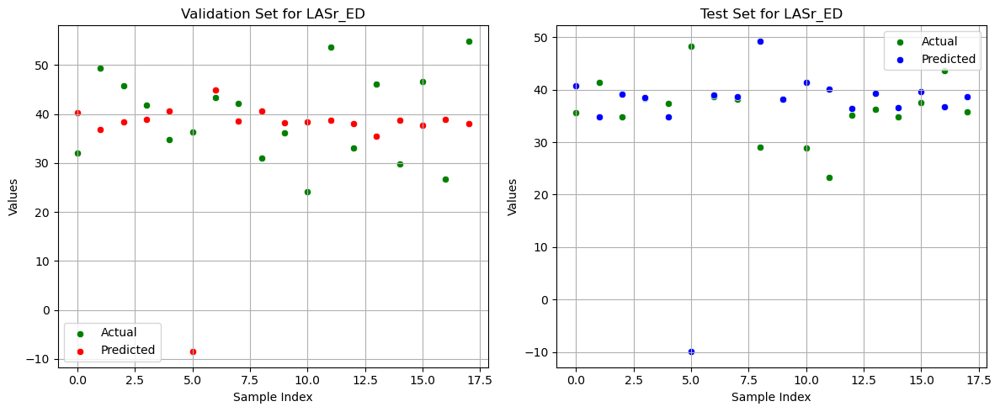

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 2000}
MAE (Val): 10.5840, MAPE (Val): 28.56%
MAE (Test): 8.0475, MAPE (Test): 22.41%

Fold 4/5


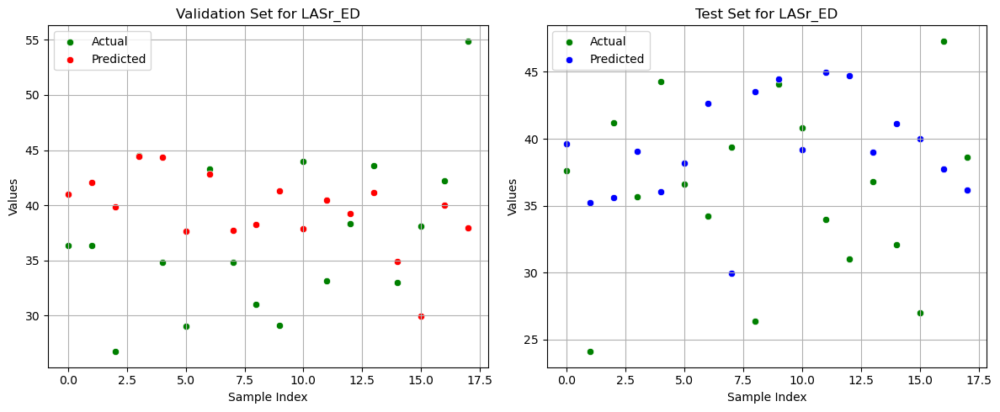

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 6.1547, MAPE (Val): 17.65%
MAE (Test): 7.2135, MAPE (Test): 22.28%

Fold 5/5


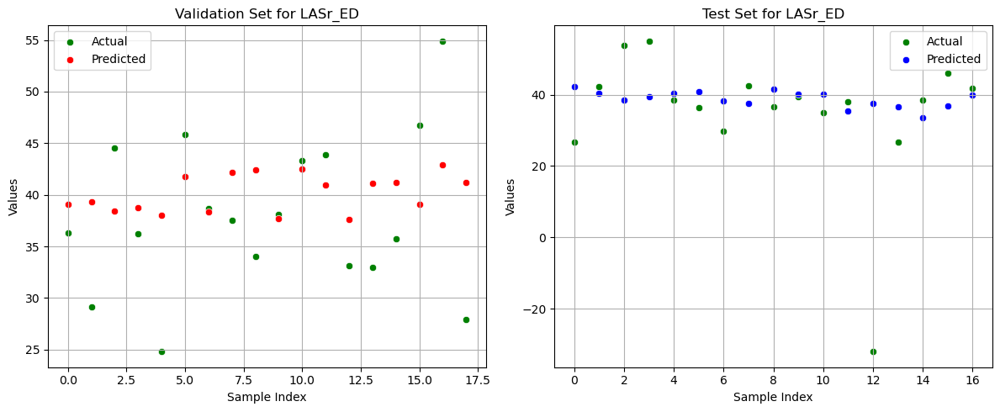

Best parameters: {'max_depth': 2, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 5.9713, MAPE (Val): 17.37%
MAE (Test): 10.3754, MAPE (Test): 29.64%

Średnie wyniki dla walidacji:
MAE: 7.8585, MAPE: 20.99%
Średnie wyniki dla testu:
MAE: 9.0504, MAPE: 24.35%
Trenowanie modelu dla kolumny LAScd_ED z 5-krotną walidacją krzyżową
Fold 1/5


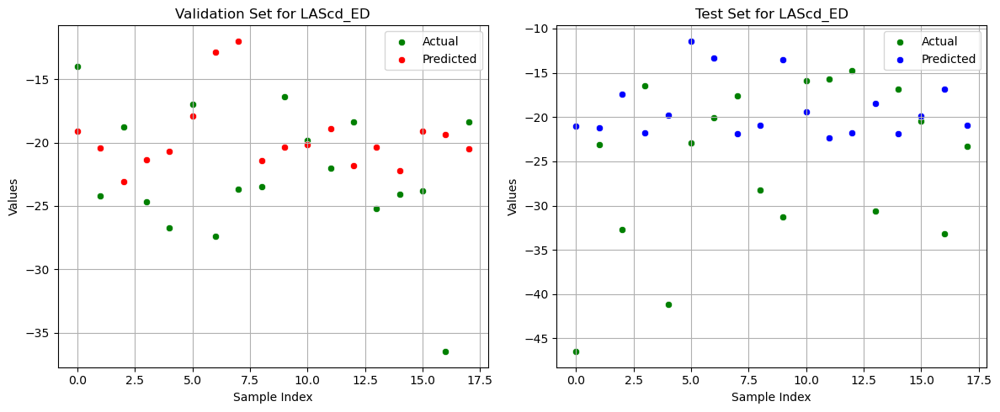

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2200}
MAE (Val): 5.1752, MAPE (Val): 21.71%
MAE (Test): 9.4781, MAPE (Test): 34.90%

Fold 2/5


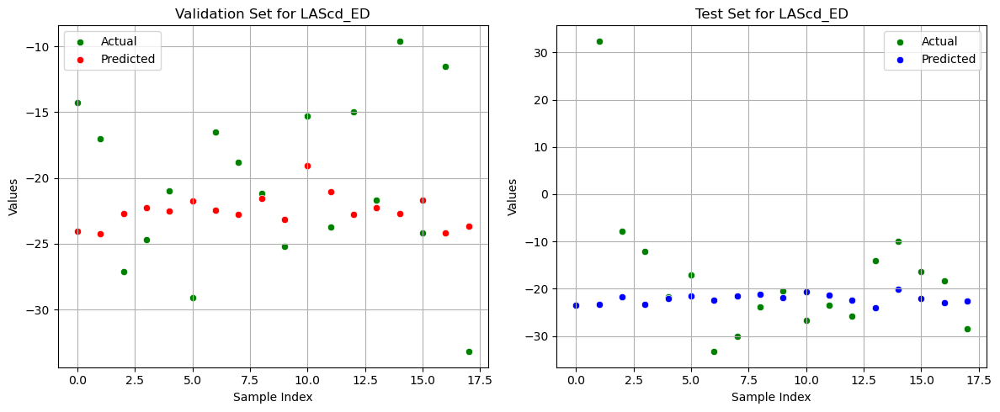

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 5.4202, MAPE (Val): 34.02%
MAE (Test): 8.7328, MAPE (Test): 47.24%

Fold 3/5


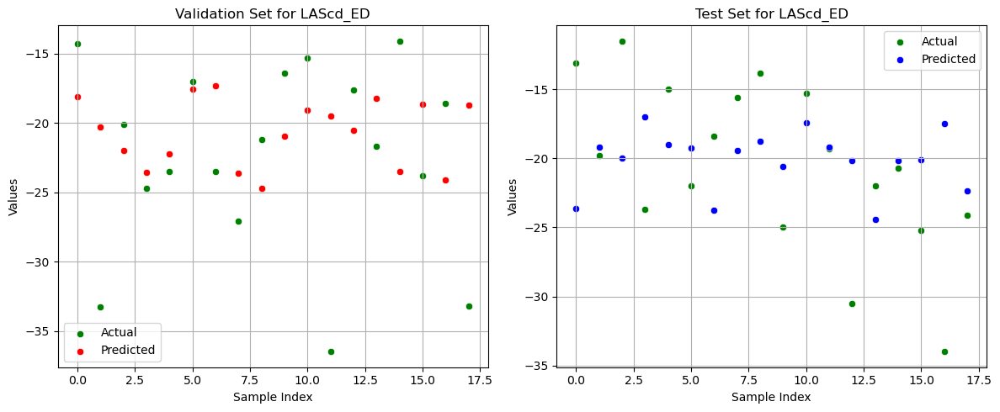

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 5.6112, MAPE (Val): 24.26%
MAE (Test): 5.0302, MAPE (Test): 26.11%

Fold 4/5


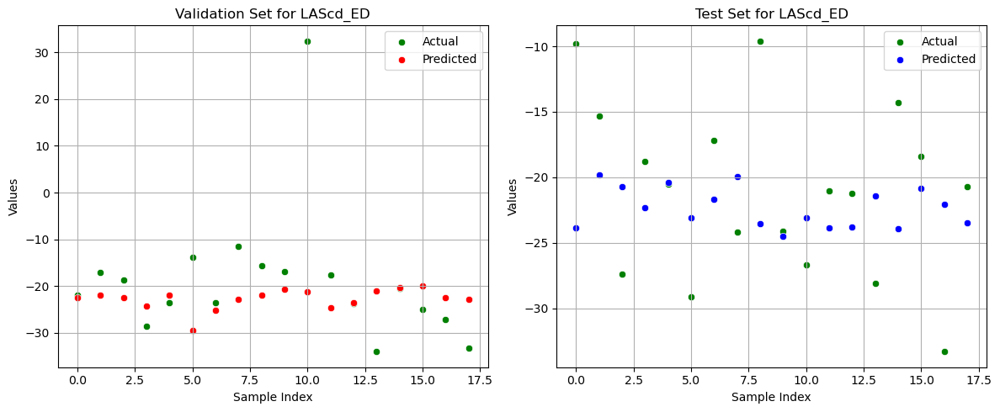

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 1600}
MAE (Val): 8.2237, MAPE (Val): 37.17%
MAE (Test): 5.5469, MAPE (Test): 34.38%

Fold 5/5


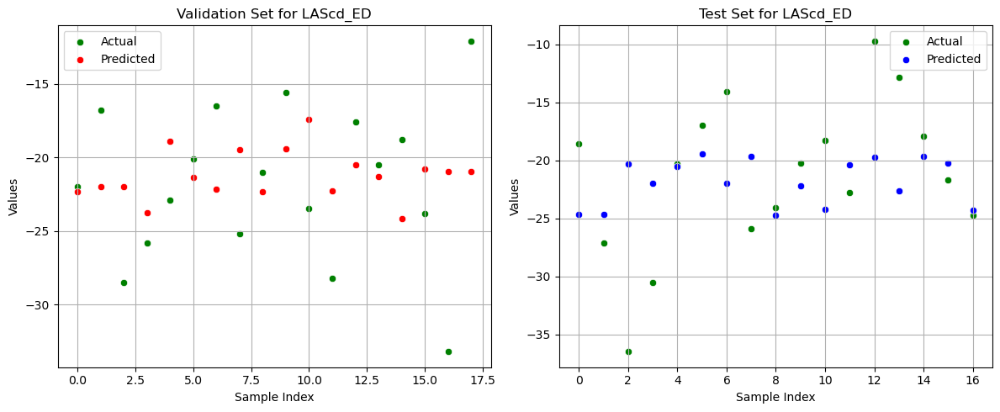

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 4.5016, MAPE (Val): 21.84%
MAE (Test): 4.9674, MAPE (Test): 27.25%

Średnie wyniki dla walidacji:
MAE: 5.7864, MAPE: 27.80%
Średnie wyniki dla testu:
MAE: 6.7511, MAPE: 33.97%
Trenowanie modelu dla kolumny LASct_ED z 5-krotną walidacją krzyżową
Fold 1/5


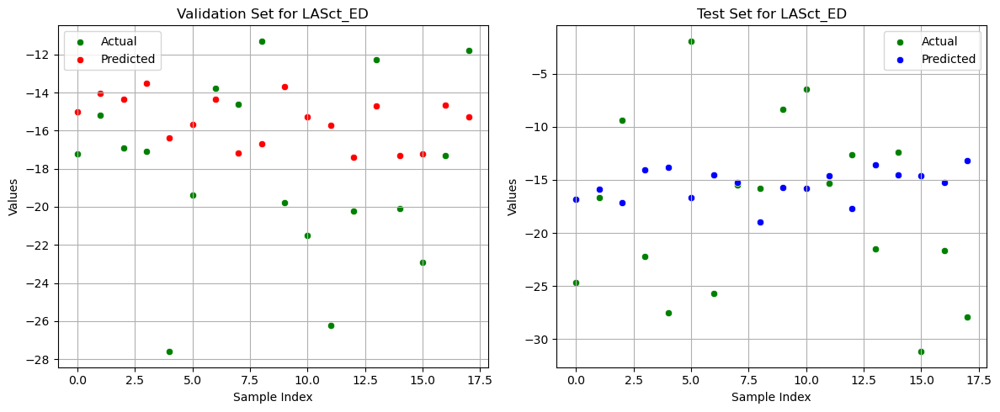

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2200}
MAE (Val): 4.1928, MAPE (Val): 22.32%
MAE (Test): 7.6816, MAPE (Test): 84.50%

Fold 2/5


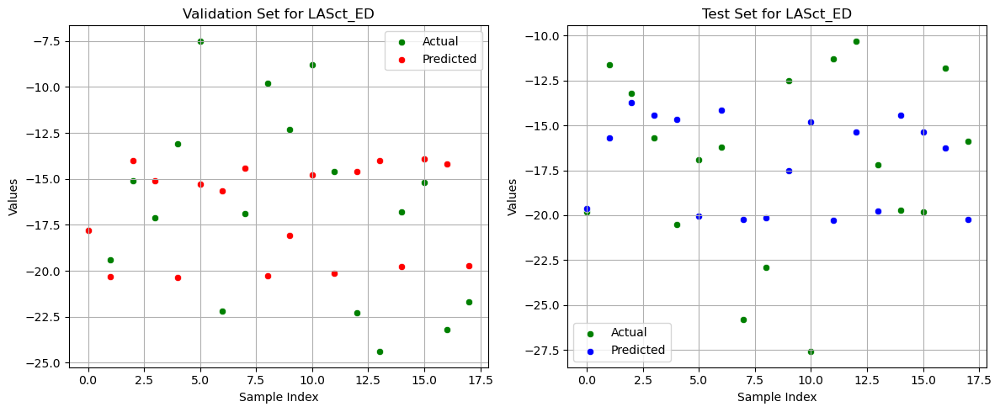

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 4.9526, MAPE (Val): 35.43%
MAE (Test): 4.3556, MAPE (Test): 27.00%

Fold 3/5


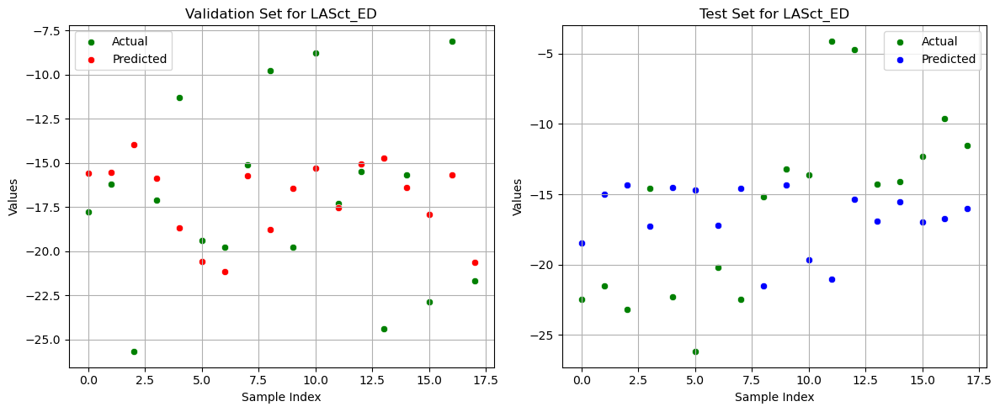

Best parameters: {'max_depth': 2, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 3.8813, MAPE (Val): 27.93%
MAE (Test): 6.3158, MAPE (Test): 63.77%

Fold 4/5


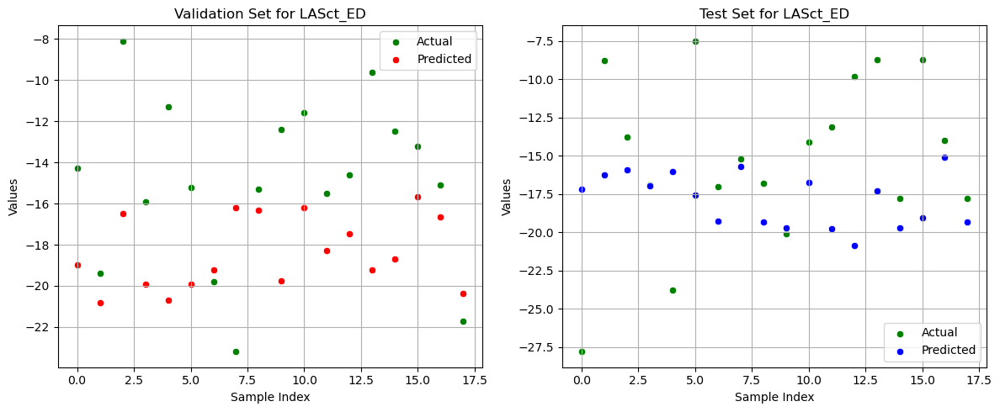

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 4.4514, MAPE (Val): 35.85%
MAE (Test): 4.8639, MAPE (Test): 42.56%

Fold 5/5


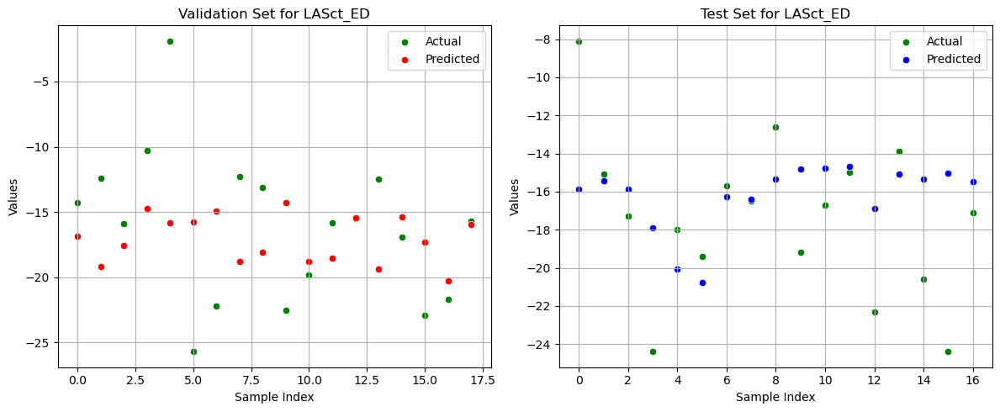

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 4.7605, MAPE (Val): 65.37%
MAE (Test): 3.0763, MAPE (Test): 18.82%

Średnie wyniki dla walidacji:
MAE: 4.4477, MAPE: 37.38%
Średnie wyniki dla testu:
MAE: 5.2586, MAPE: 47.33%
Trenowanie modelu dla kolumny LASr_AC z 5-krotną walidacją krzyżową
Fold 1/5


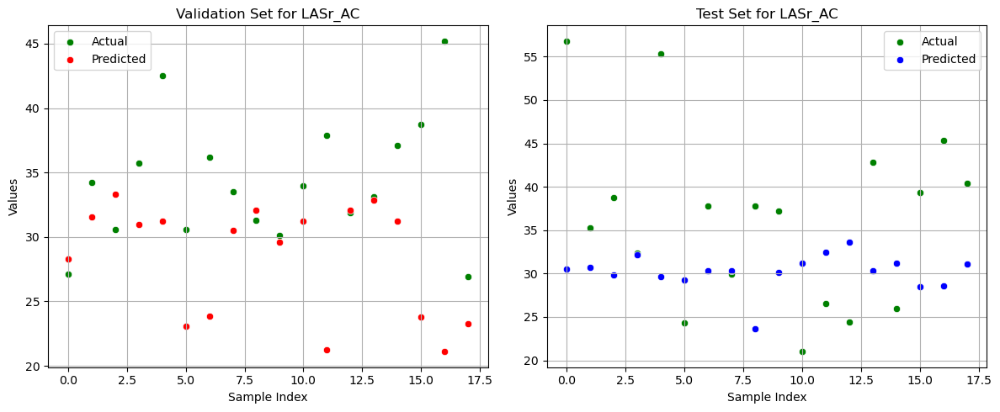

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 6.3929, MAPE (Val): 17.07%
MAE (Test): 9.9688, MAPE (Test): 26.24%

Fold 2/5


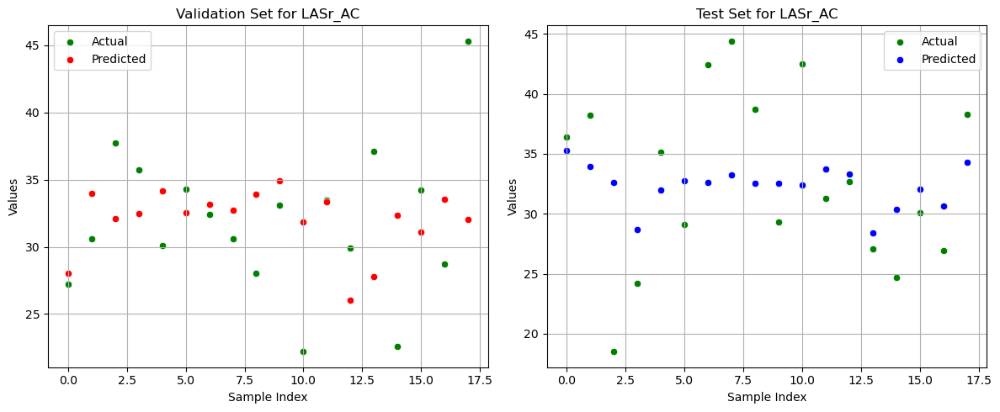

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 4.6334, MAPE (Val): 15.16%
MAE (Test): 5.0570, MAPE (Test): 16.56%

Fold 3/5


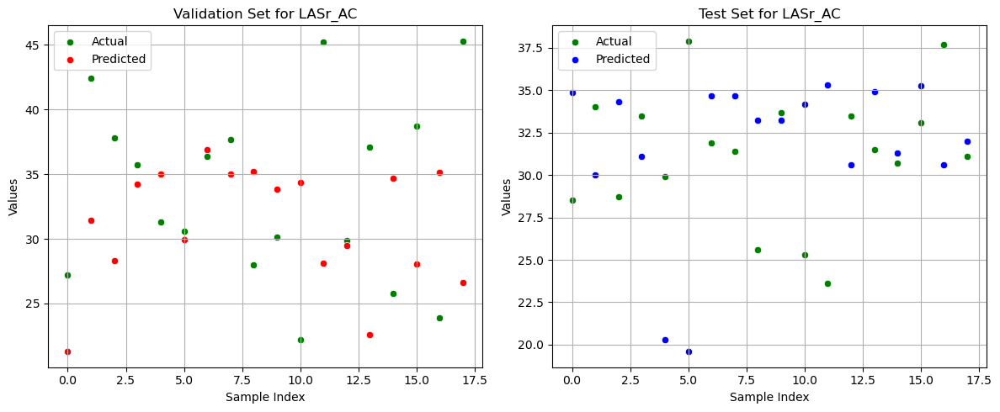

Best parameters: {'max_depth': 2, 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 7.7803, MAPE (Val): 23.40%
MAE (Test): 5.4474, MAPE (Test): 18.10%

Fold 4/5


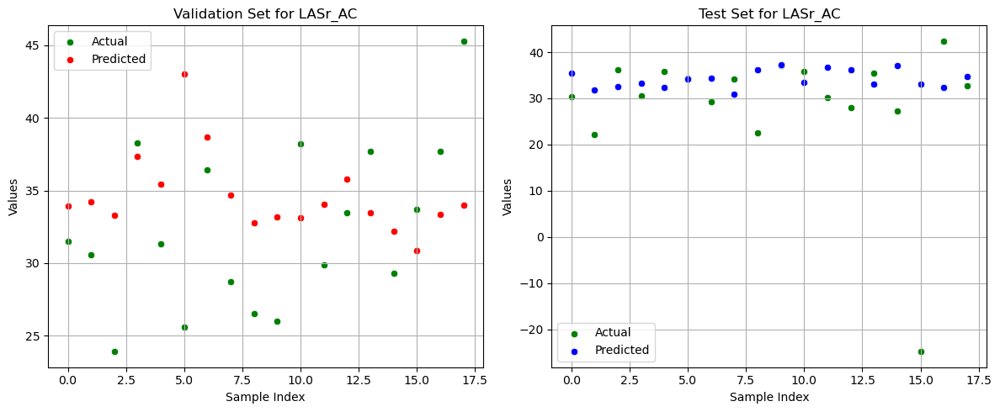

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 1800}
MAE (Val): 5.3813, MAPE (Val): 17.84%
MAE (Test): 8.1214, MAPE (Test): 30.05%

Fold 5/5


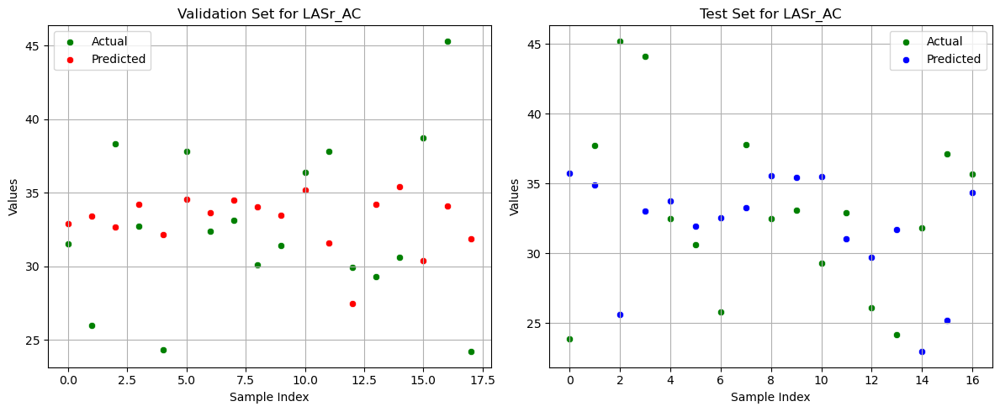

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 4.5844, MAPE (Val): 14.41%
MAE (Test): 6.2193, MAPE (Test): 19.01%

Średnie wyniki dla walidacji:
MAE: 5.7544, MAPE: 17.57%
Średnie wyniki dla testu:
MAE: 6.9628, MAPE: 21.99%
Trenowanie modelu dla kolumny LAScd_AC z 5-krotną walidacją krzyżową
Fold 1/5


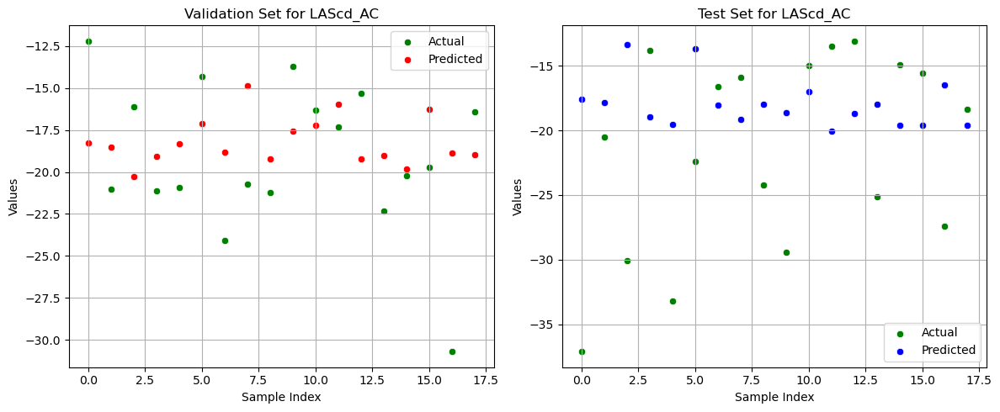

Best parameters: {'max_depth': 2, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 3.5973, MAPE (Val): 19.09%
MAE (Test): 7.2331, MAPE (Test): 31.48%

Fold 2/5


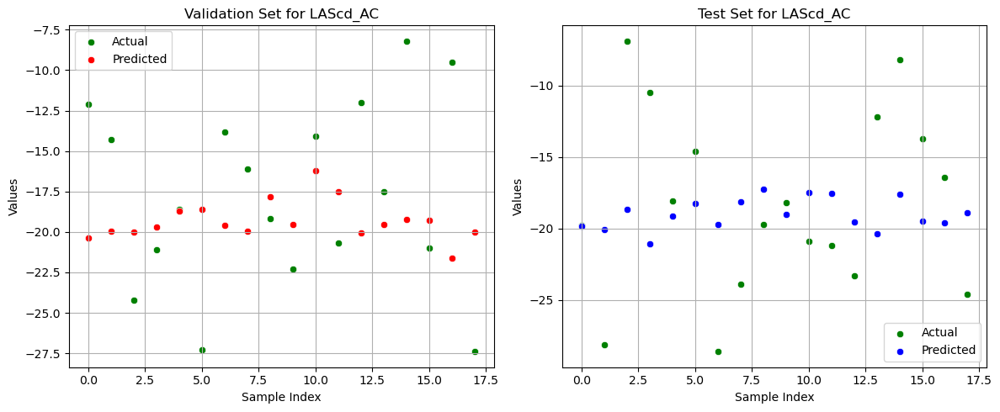

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 4.9877, MAPE (Val): 36.45%
MAE (Test): 5.3386, MAPE (Test): 39.95%

Fold 3/5


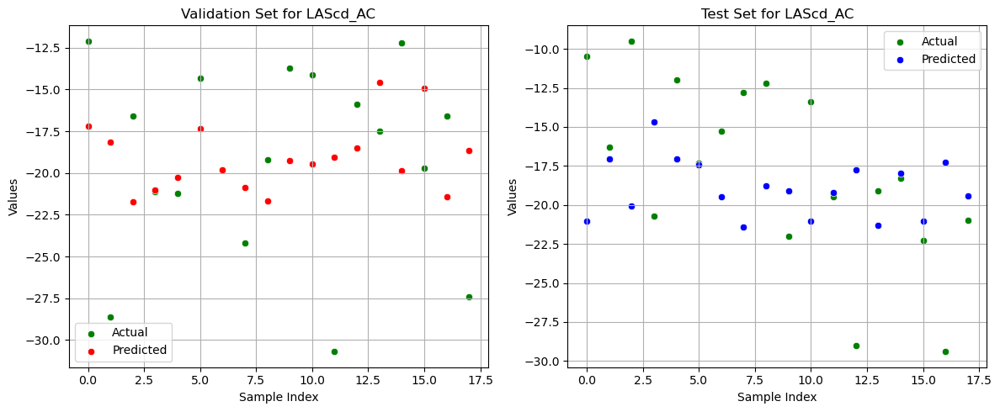

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 4.7047, MAPE (Val): 25.57%
MAE (Test): 5.1058, MAPE (Test): 34.12%

Fold 4/5


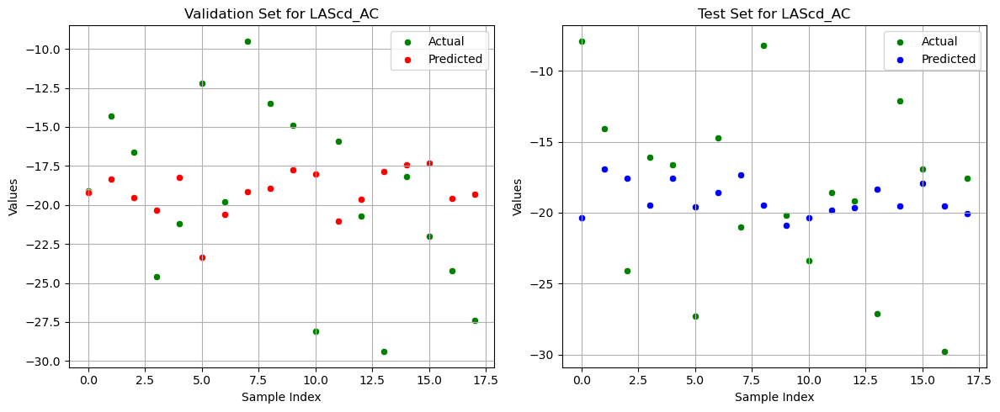

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 2400}
MAE (Val): 5.0047, MAPE (Val): 28.91%
MAE (Test): 4.8855, MAPE (Test): 34.13%

Fold 5/5


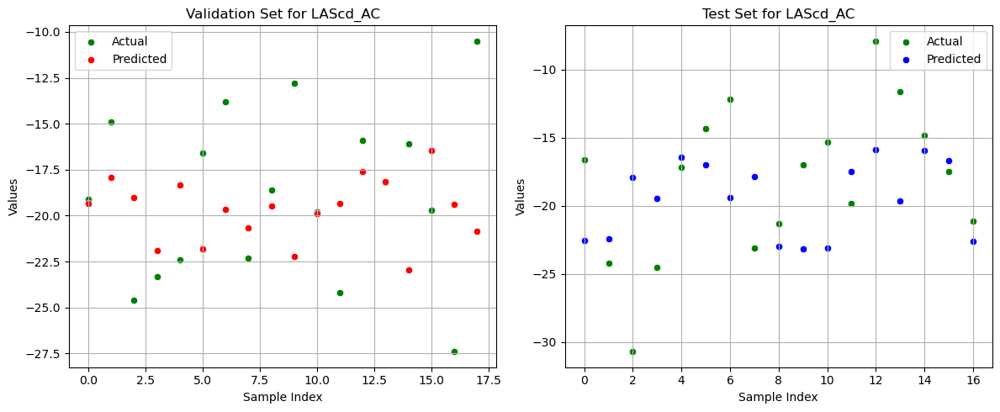

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 4.0239, MAPE (Val): 24.78%
MAE (Test): 4.6357, MAPE (Test): 29.78%

Średnie wyniki dla walidacji:
MAE: 4.4637, MAPE: 26.96%
Średnie wyniki dla testu:
MAE: 5.4397, MAPE: 33.89%
Trenowanie modelu dla kolumny LASct_AC z 5-krotną walidacją krzyżową
Fold 1/5


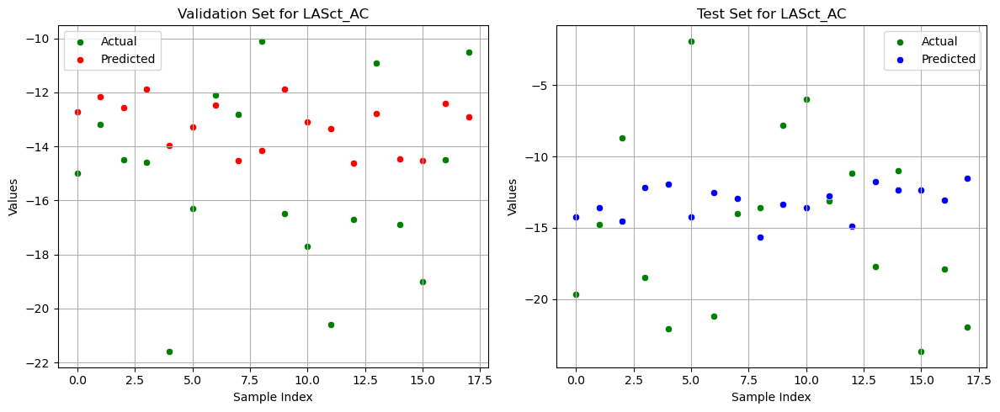

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2200}
MAE (Val): 3.1454, MAPE (Val): 19.99%
MAE (Test): 5.7916, MAPE (Test): 72.16%

Fold 2/5


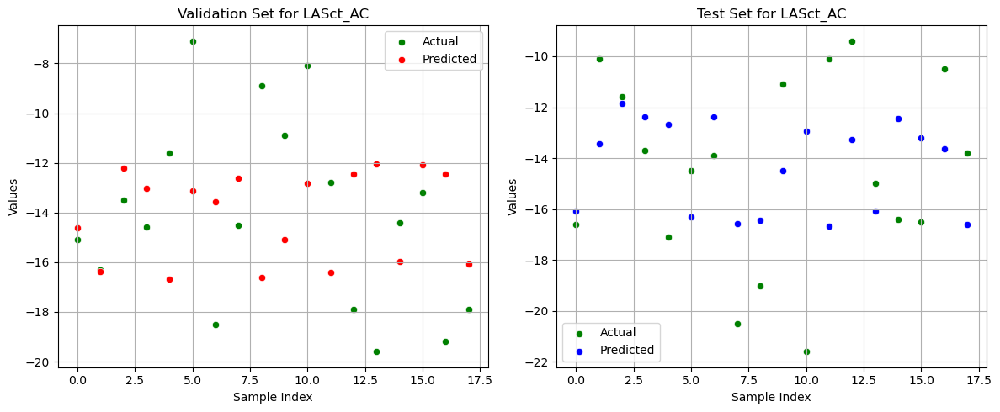

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 3.6562, MAPE (Val): 29.86%
MAE (Test): 3.1356, MAPE (Test): 22.68%

Fold 3/5


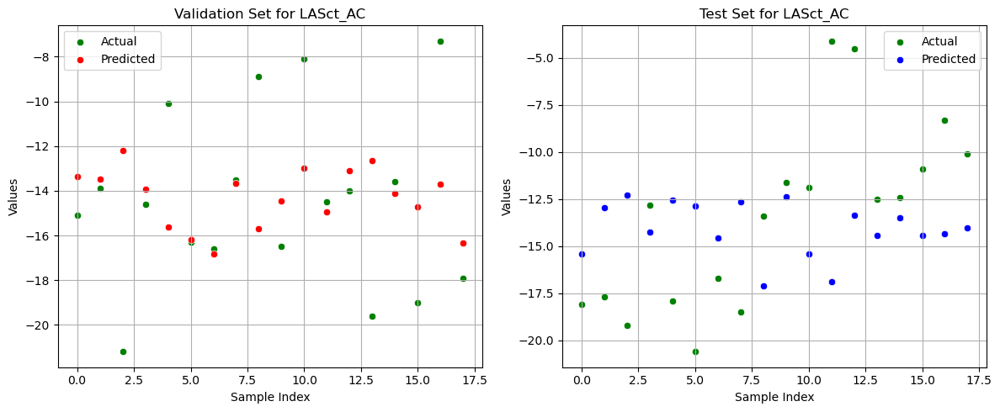

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 2.9317, MAPE (Val): 24.30%
MAE (Test): 4.6086, MAPE (Test): 52.30%

Fold 4/5


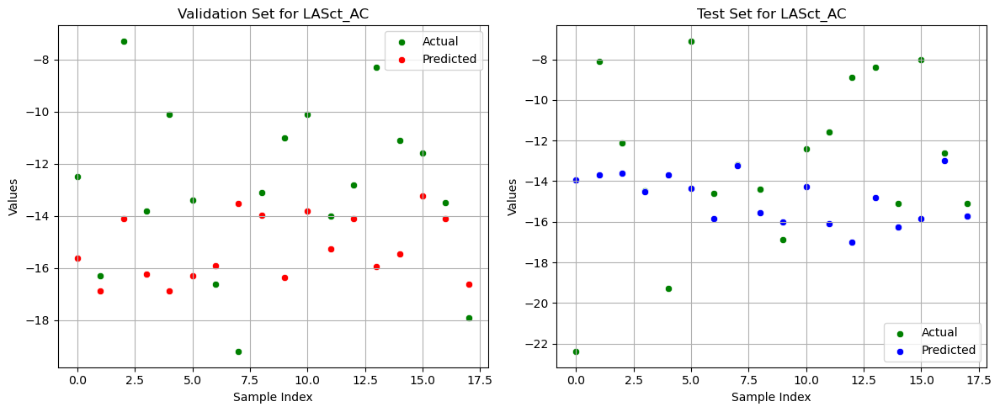

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 3.1653, MAPE (Val): 29.44%
MAE (Test): 3.4824, MAPE (Test): 33.73%

Fold 5/5


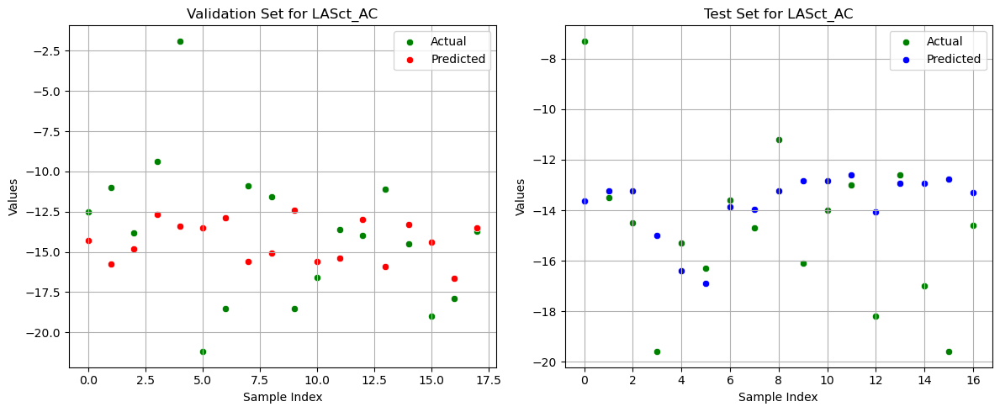

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 3.6538, MAPE (Val): 54.94%
MAE (Test): 2.2773, MAPE (Test): 16.57%

Średnie wyniki dla walidacji:
MAE: 3.3105, MAPE: 31.71%
Średnie wyniki dla testu:
MAE: 3.8591, MAPE: 39.49%
Trenowanie modelu dla kolumny RVFWSL z 5-krotną walidacją krzyżową
Fold 1/5


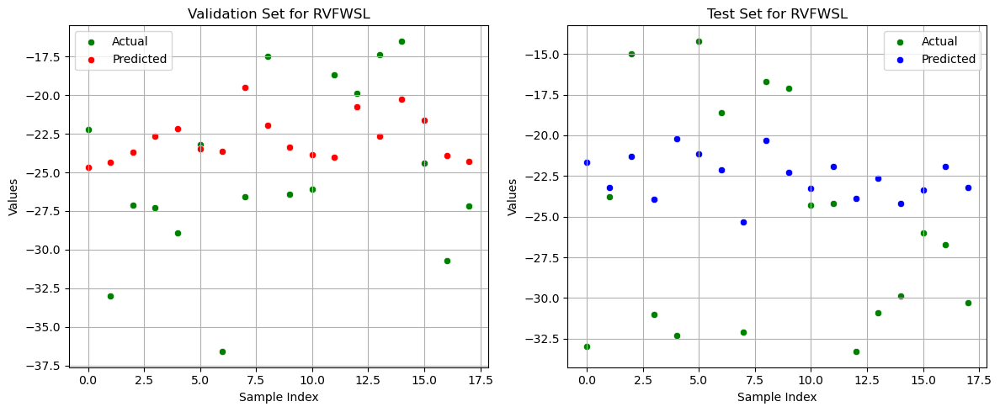

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 2200}
MAE (Val): 4.6416, MAPE (Val): 18.26%
MAE (Test): 5.8119, MAPE (Test): 23.29%

Fold 2/5


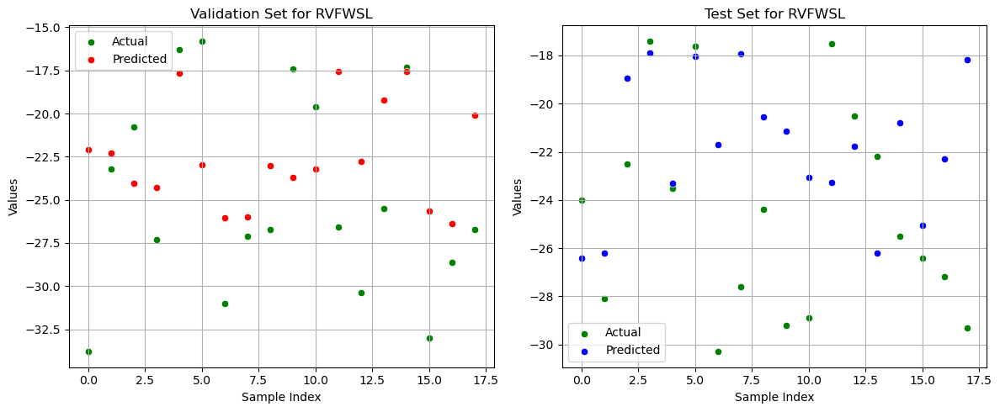

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 2400}
MAE (Val): 4.8023, MAPE (Val): 19.30%
MAE (Test): 4.3368, MAPE (Test): 16.79%

Fold 3/5


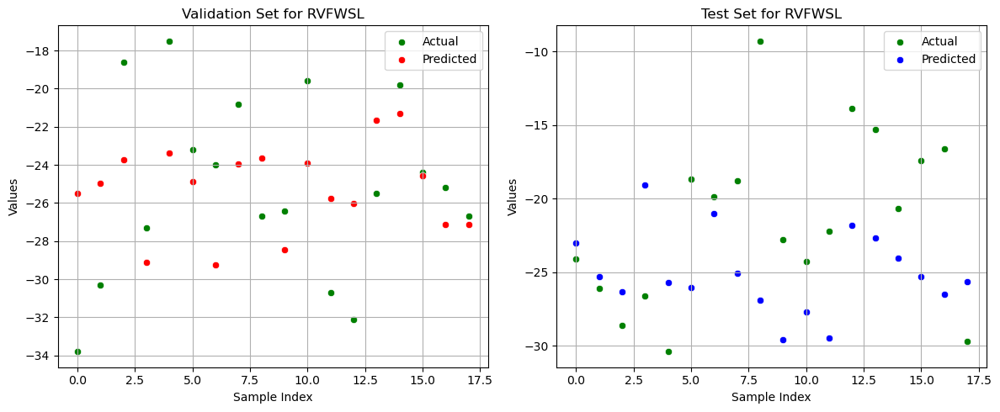

Best parameters: {'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 1800}
MAE (Val): 3.5979, MAPE (Val): 14.59%
MAE (Test): 5.9266, MAPE (Test): 35.74%

Fold 4/5


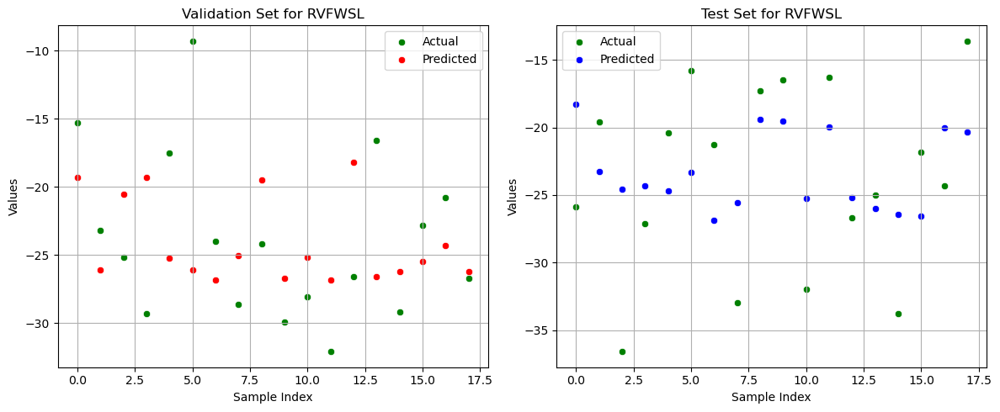

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 2200}
MAE (Val): 5.3689, MAPE (Val): 29.45%
MAE (Test): 5.1174, MAPE (Test): 22.39%

Fold 5/5


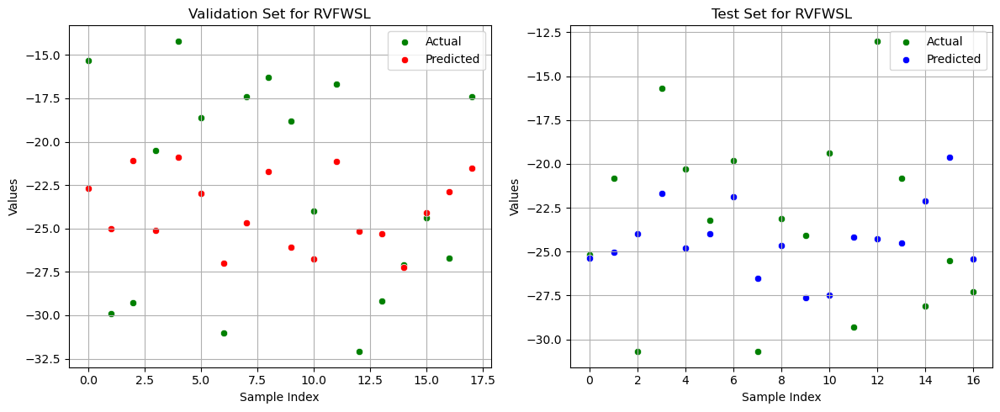

Best parameters: {'max_depth': 2, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1800}
MAE (Val): 4.8132, MAPE (Val): 23.65%
MAE (Test): 4.4468, MAPE (Test): 21.56%

Średnie wyniki dla walidacji:
MAE: 4.6448, MAPE: 21.05%
Średnie wyniki dla testu:
MAE: 5.1279, MAPE: 23.96%
Trenowanie modelu dla kolumny RV4CSL z 5-krotną walidacją krzyżową
Fold 1/5


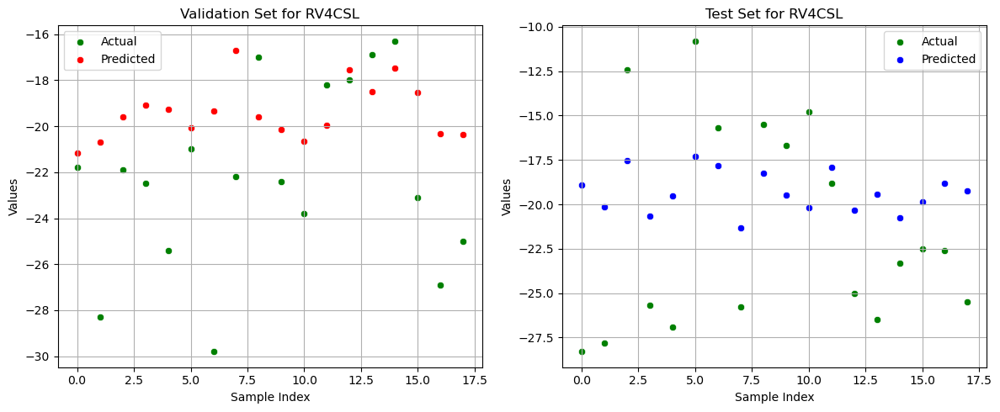

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 2000}
MAE (Val): 3.6509, MAPE (Val): 15.22%
MAE (Test): 4.8056, MAPE (Test): 23.62%

Fold 2/5


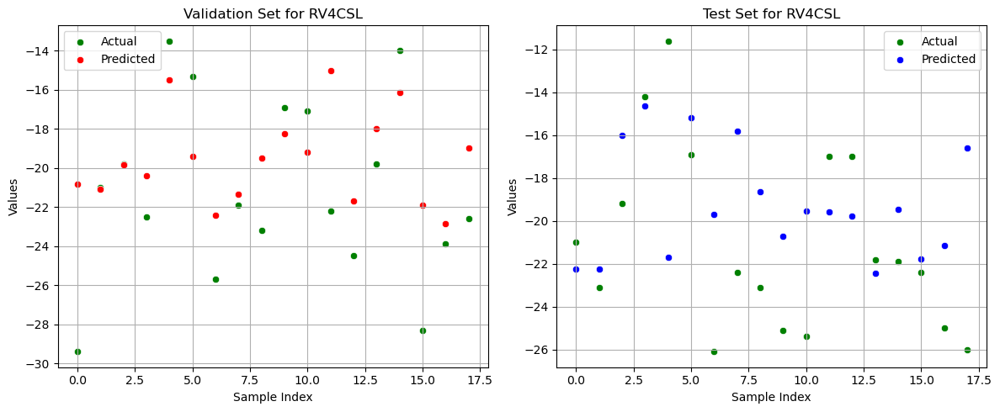

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 3, 'n_estimators': 2400}
MAE (Val): 2.9361, MAPE (Val): 13.51%
MAE (Test): 3.7548, MAPE (Test): 18.90%

Fold 3/5


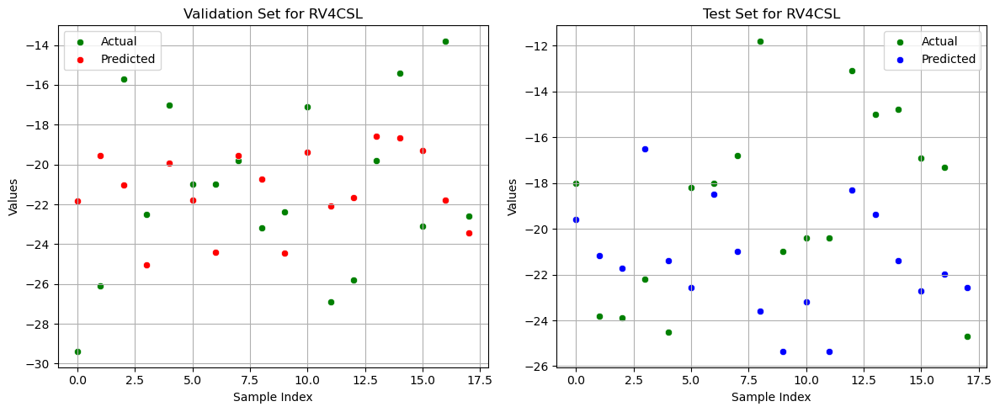

Best parameters: {'max_depth': 4, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 2400}
MAE (Val): 3.4548, MAPE (Val): 17.05%
MAE (Test): 4.2733, MAPE (Test): 25.61%

Fold 4/5


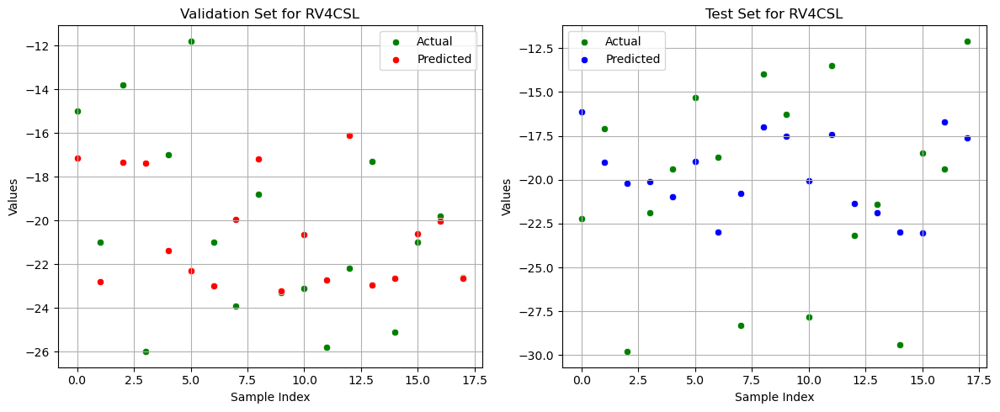

Best parameters: {'max_depth': 2, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 2200}
MAE (Val): 3.2736, MAPE (Val): 18.14%
MAE (Test): 4.0998, MAPE (Test): 20.14%

Fold 5/5


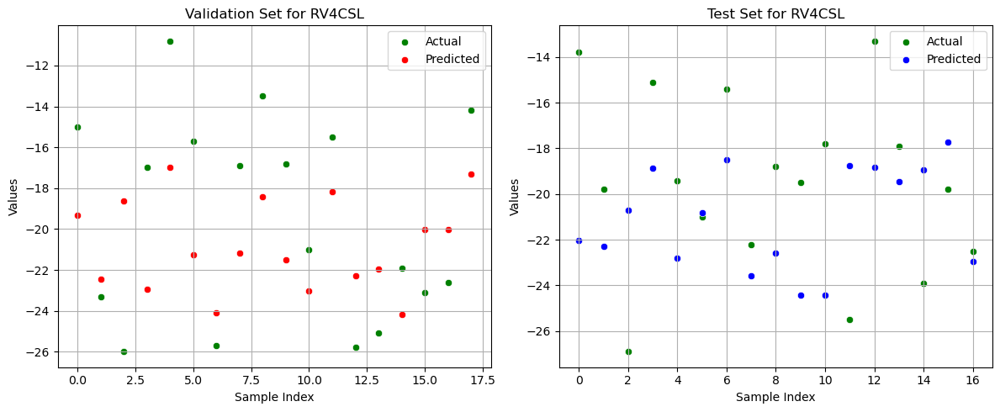

Best parameters: {'max_depth': 3, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 1600}
MAE (Val): 3.7872, MAPE (Val): 21.92%
MAE (Test): 3.8477, MAPE (Test): 21.03%

Średnie wyniki dla walidacji:
MAE: 3.4205, MAPE: 17.17%
Średnie wyniki dla testu:
MAE: 4.1562, MAPE: 21.86%


In [32]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Funkcja do obliczenia MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred) / np.abs(y_true)) * 100

# Funkcja oceny modelu regresji z użyciem MAE
def evaluate_regression_model(X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y_col):
    # Przeprowadzamy GridSearchCV w celu znalezienia najlepszych parametrów
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)
    
    # Używamy najlepszego modelu z GridSearchCV
    best_model = grid_search.best_estimator_
    
    # Ocena modelu na zbiorze treningowym
    y_train_pred = best_model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_train_pred)  # MAE dla treningu
    r2_train = r2_score(y_train, y_train_pred)

    # Ocena modelu na zbiorze walidacyjnym
    y_val_pred = best_model.predict(X_val)
    mae_val = mean_absolute_error(y_val, y_val_pred)  # MAE dla walidacji
    mape_val = mean_absolute_percentage_error(y_val, y_val_pred)
    r2_val = r2_score(y_val, y_val_pred)

    # Ocena modelu na zbiorze testowym
    y_test_pred = best_model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_test_pred)  # MAE dla testu
    mape_test = mean_absolute_percentage_error(y_test, y_test_pred)
    r2_test = r2_score(y_test, y_test_pred)

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val_pred, color='red', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Validation Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test_pred, color='blue', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Test Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    plt.show()
    
    return grid_search.best_params_, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test

# Cross-validation z 5-krotnym podziałem dla regresji
def cross_validate_regression(X, y, model, param_grid, cv=5):
    X = X.values  # Konwersja do tablicy NumPy
    kf = KFold(n_splits=cv, shuffle=True, random_state=43)
    
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X)  # Skalowanie całego zbioru przed podziałem
    
    fold = 1
    val_results = []  # Lista do przechowywania wyników walidacyjnych
    test_results = []  # Lista do przechowywania wyników testowych
    
    for train_idx, test_idx in kf.split(X_scaled):
        print(f"Fold {fold}/{cv}")
        X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
        
        # Dalszy podział zbioru treningowego na train/val (60/20)
        X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=43)  # 25% z 60% na walidację
        
        best_params, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test = evaluate_regression_model(
            X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y.name)
        
        val_results.append((mae_val, mape_val, r2_val))
        test_results.append((mae_test, mape_test, r2_test))
        
        print(f"Best parameters: {best_params}")
        print(f"MAE (Val): {mae_val:.4f}, MAPE (Val): {mape_val:.2f}%")
        print(f"MAE (Test): {mae_test:.4f}, MAPE (Test): {mape_test:.2f}%\n")
        
        fold += 1
    
    # Obliczanie średnich wartości dla walidacji i testu
    val_mae_mean = np.mean([result[0] for result in val_results])
    val_mape_mean = np.mean([result[1] for result in val_results])
    
    test_mae_mean = np.mean([result[0] for result in test_results])
    test_mape_mean = np.mean([result[1] for result in test_results])
    
    print("Średnie wyniki dla walidacji:")
    print(f"MAE: {val_mae_mean:.4f}, MAPE: {val_mape_mean:.2f}%")
    print("Średnie wyniki dla testu:")
    print(f"MAE: {test_mae_mean:.4f}, MAPE: {test_mape_mean:.2f}%")


param_grid = {
    'n_estimators': [1600, 1800, 2000, 2200, 2400],
    'min_samples_split': [2, 3, 4, 5],
    'min_samples_leaf': [1, 2, 3, 4],
    'max_depth': [2, 3, 4]
}

# Trenowanie modelu dla każdej kolumny z 5-krotną walidacją krzyżową
for y_col in y.columns:
    print(f"Trenowanie modelu dla kolumny {y_col} z 5-krotną walidacją krzyżową")
    model = RandomForestRegressor(random_state=43)
    cross_validate_regression(X, y[y_col], model, param_grid, cv=5)


### KNN

Trenowanie modelu dla kolumny LV A2C z 5-krotną walidacją krzyżową
Fold 1/5


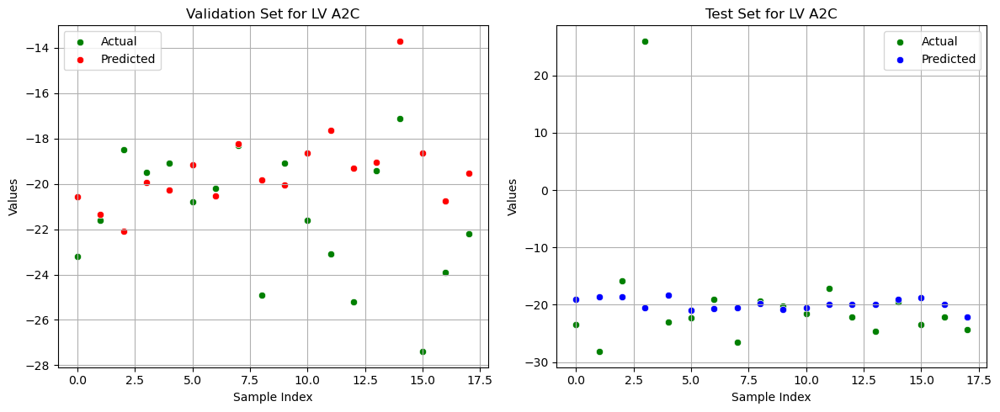

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'distance'}
MAE (Val): 2.7087, MAPE (Val): 11.94%
MAE (Test): 5.4735, MAPE (Test): 22.48%

Fold 2/5


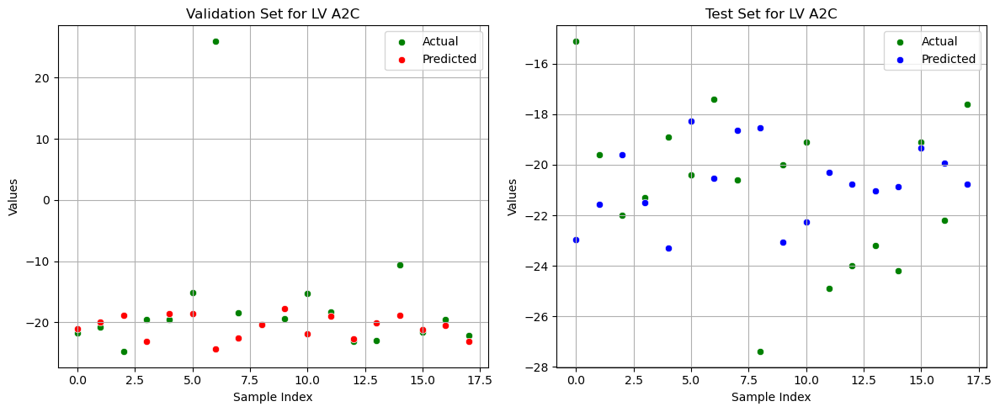

Best parameters: {'algorithm': 'auto', 'n_neighbors': 4, 'p': 2, 'weights': 'uniform'}
MAE (Val): 5.1486, MAPE (Val): 25.08%
MAE (Test): 3.2361, MAPE (Test): 15.80%

Fold 3/5


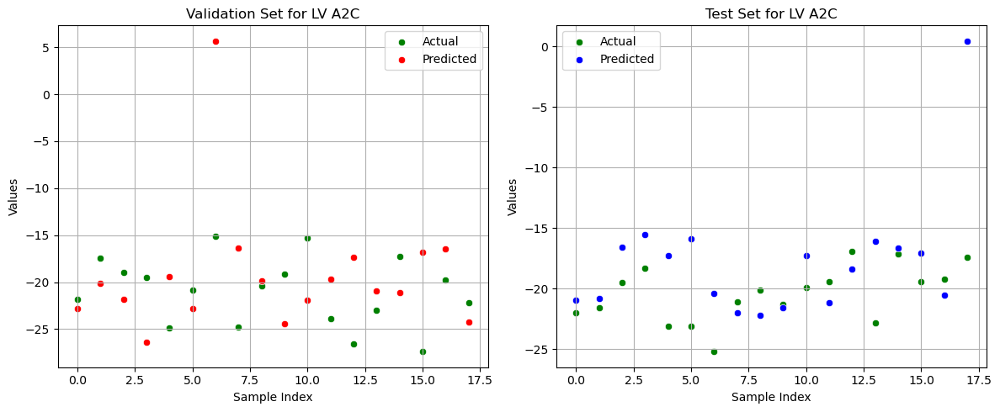

Best parameters: {'algorithm': 'auto', 'n_neighbors': 2, 'p': 2, 'weights': 'distance'}
MAE (Val): 5.4363, MAPE (Val): 27.52%
MAE (Test): 3.5186, MAPE (Test): 17.52%

Fold 4/5


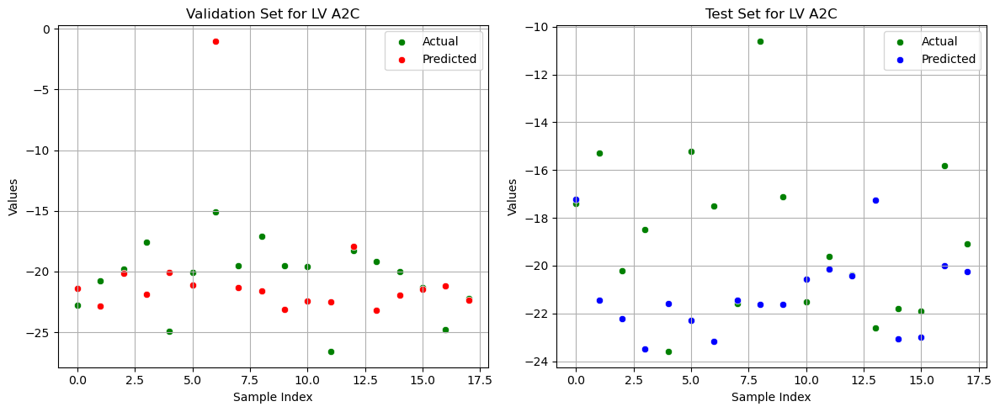

Best parameters: {'algorithm': 'brute', 'n_neighbors': 3, 'p': 2, 'weights': 'distance'}
MAE (Val): 3.0581, MAPE (Val): 16.22%
MAE (Test): 3.2395, MAPE (Test): 20.60%

Fold 5/5


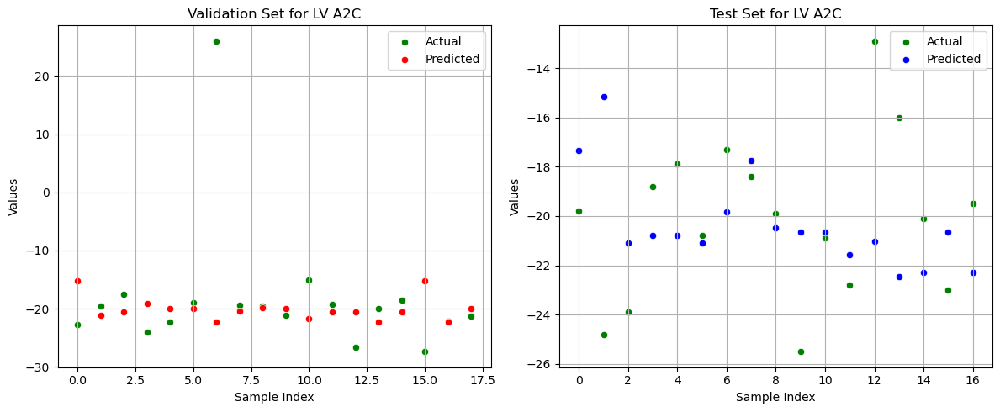

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 5.7144, MAPE (Val): 24.36%
MAE (Test): 3.0647, MAPE (Test): 16.28%

Średnie wyniki dla walidacji:
MAE: 4.4132, MAPE: 21.03%
Średnie wyniki dla testu:
MAE: 3.7065, MAPE: 18.54%
Trenowanie modelu dla kolumny LVA3C z 5-krotną walidacją krzyżową
Fold 1/5


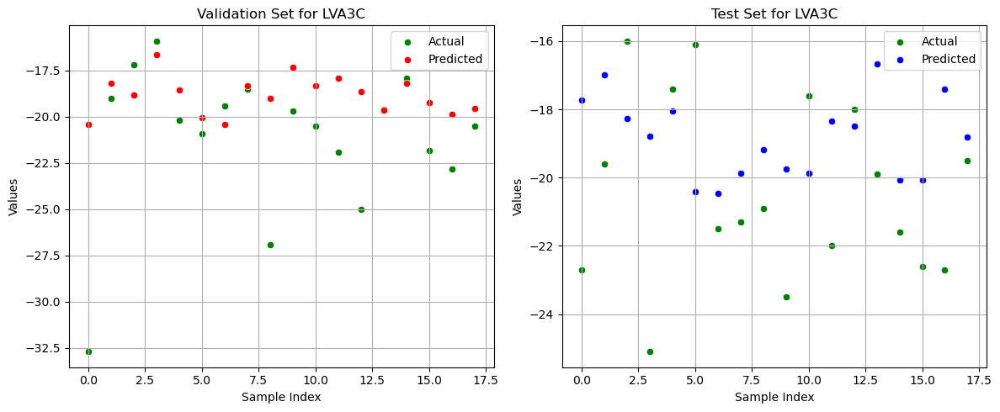

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.7011, MAPE (Val): 11.14%
MAE (Test): 2.7078, MAPE (Test): 13.02%

Fold 2/5


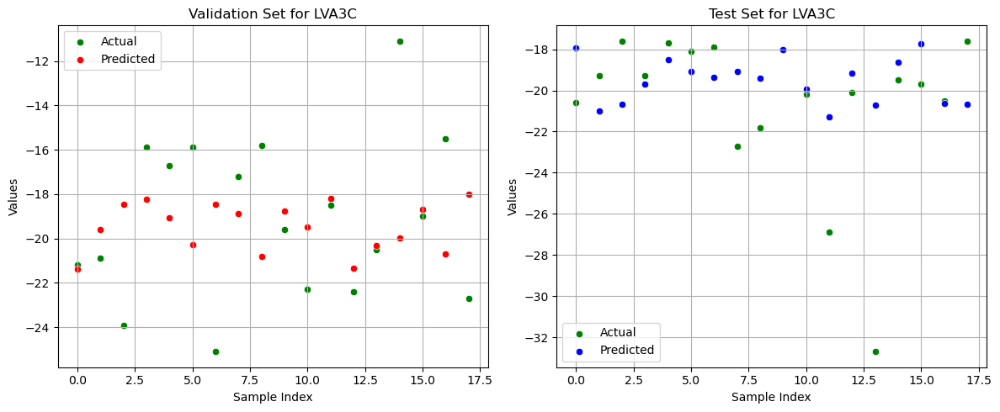

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.9711, MAPE (Val): 17.41%
MAE (Test): 2.3244, MAPE (Test): 10.10%

Fold 3/5


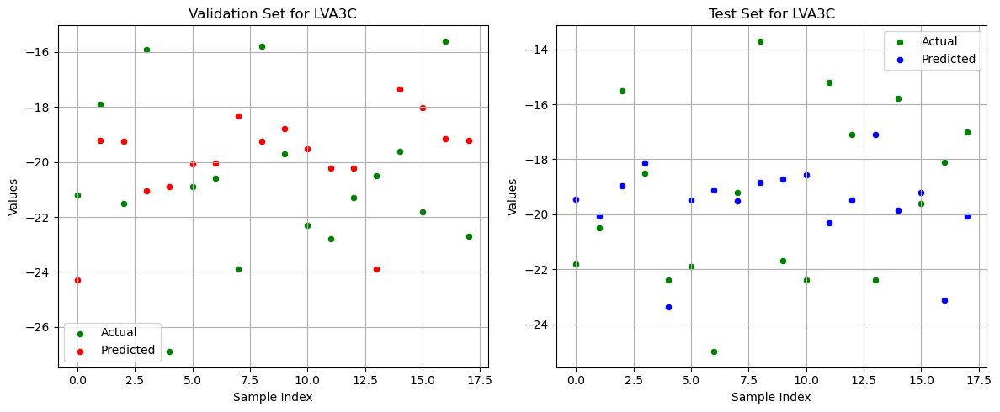

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.8889, MAPE (Val): 14.21%
MAE (Test): 2.9733, MAPE (Test): 16.17%

Fold 4/5


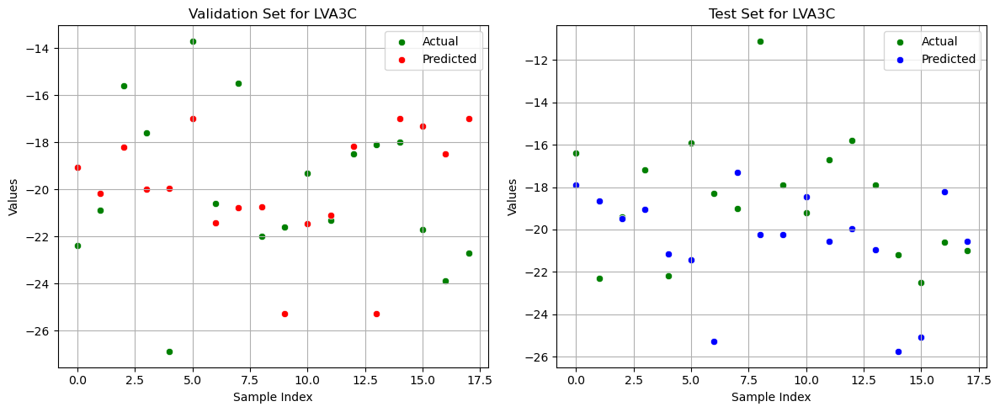

Best parameters: {'algorithm': 'auto', 'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.1500, MAPE (Val): 15.91%
MAE (Test): 3.0870, MAPE (Test): 18.64%

Fold 5/5


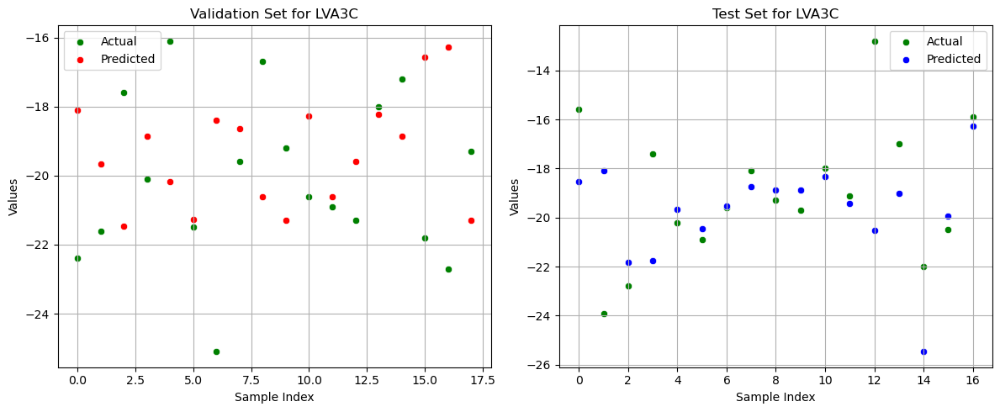

Best parameters: {'algorithm': 'auto', 'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.7333, MAPE (Val): 13.50%
MAE (Test): 1.8706, MAPE (Test): 10.83%

Średnie wyniki dla walidacji:
MAE: 2.8889, MAPE: 14.43%
Średnie wyniki dla testu:
MAE: 2.5926, MAPE: 13.75%
Trenowanie modelu dla kolumny LVA4C z 5-krotną walidacją krzyżową
Fold 1/5


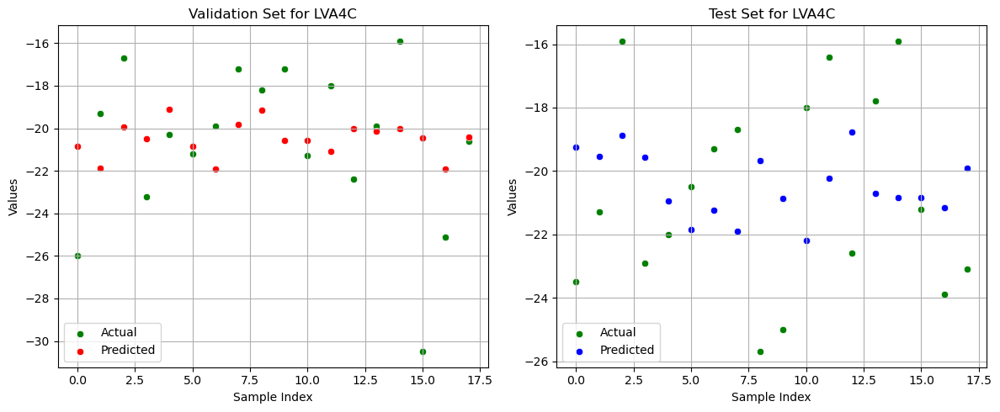

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.6756, MAPE (Val): 12.60%
MAE (Test): 3.1100, MAPE (Test): 15.33%

Fold 2/5


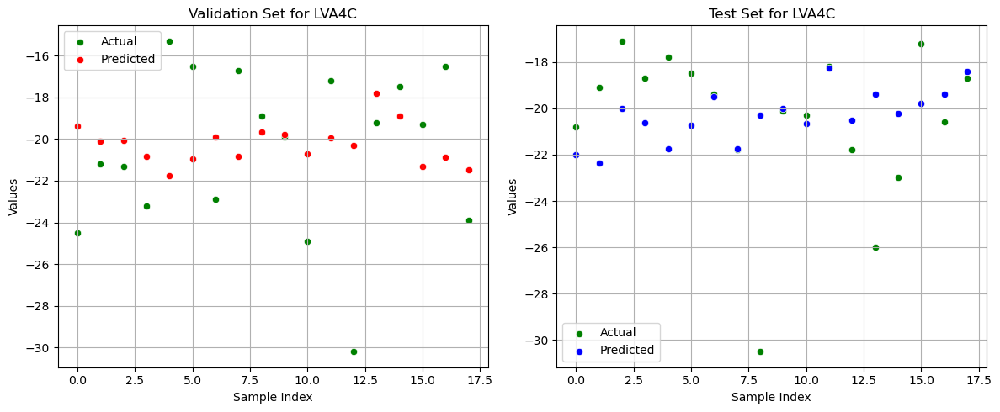

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 3.1744, MAPE (Val): 15.64%
MAE (Test): 2.2844, MAPE (Test): 10.39%

Fold 3/5


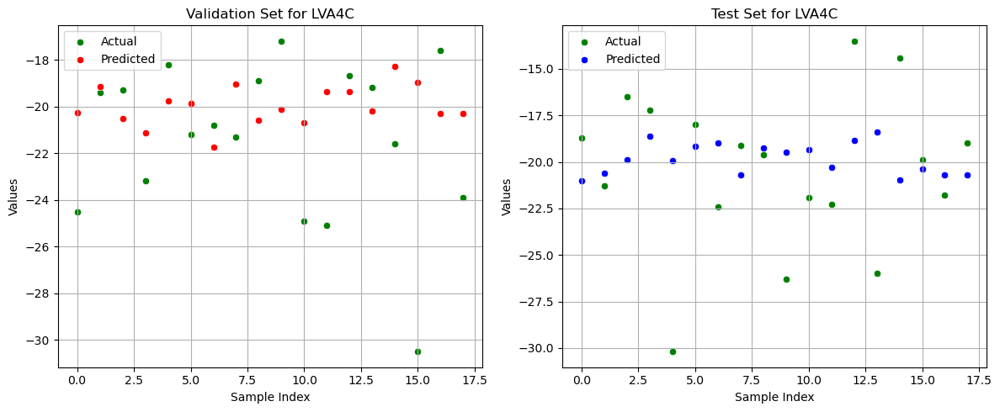

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.8489, MAPE (Val): 12.34%
MAE (Test): 3.2622, MAPE (Test): 15.96%

Fold 4/5


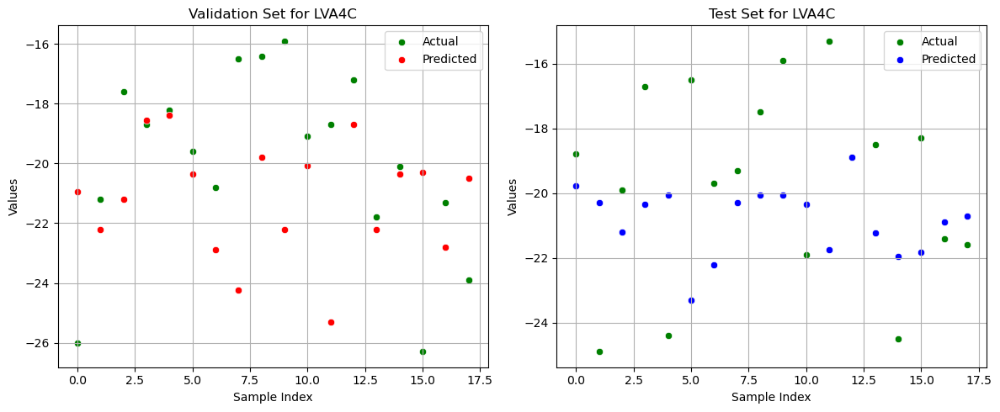

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 2.8300, MAPE (Val): 14.67%
MAE (Test): 2.7822, MAPE (Test): 14.99%

Fold 5/5


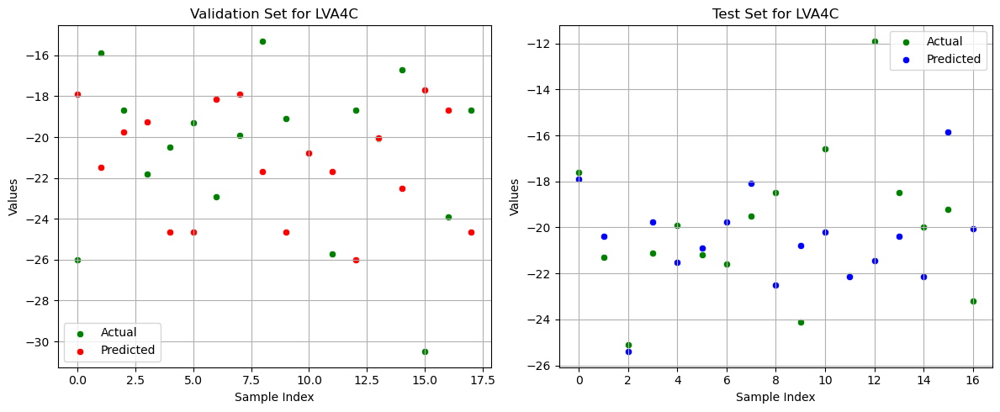

Best parameters: {'algorithm': 'auto', 'n_neighbors': 2, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.8111, MAPE (Val): 23.25%
MAE (Test): 2.2971, MAPE (Test): 13.43%

Średnie wyniki dla walidacji:
MAE: 3.2680, MAPE: 15.70%
Średnie wyniki dla testu:
MAE: 2.7472, MAPE: 14.02%
Trenowanie modelu dla kolumny LV GLS z 5-krotną walidacją krzyżową
Fold 1/5


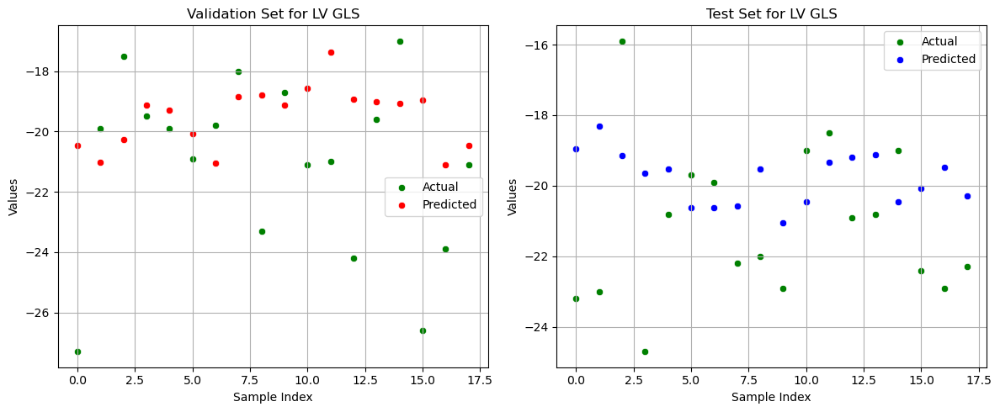

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 2.4856, MAPE (Val): 10.99%
MAE (Test): 2.2778, MAPE (Test): 10.62%

Fold 2/5


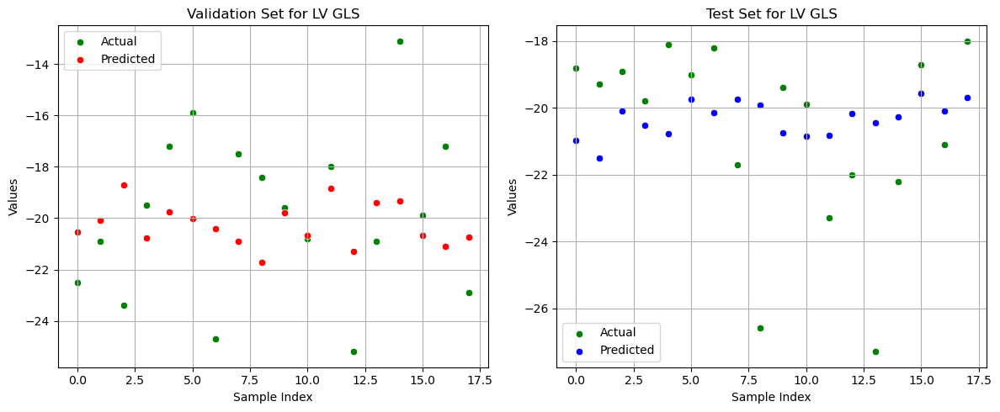

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.5567, MAPE (Val): 13.73%
MAE (Test): 2.1811, MAPE (Test): 9.99%

Fold 3/5


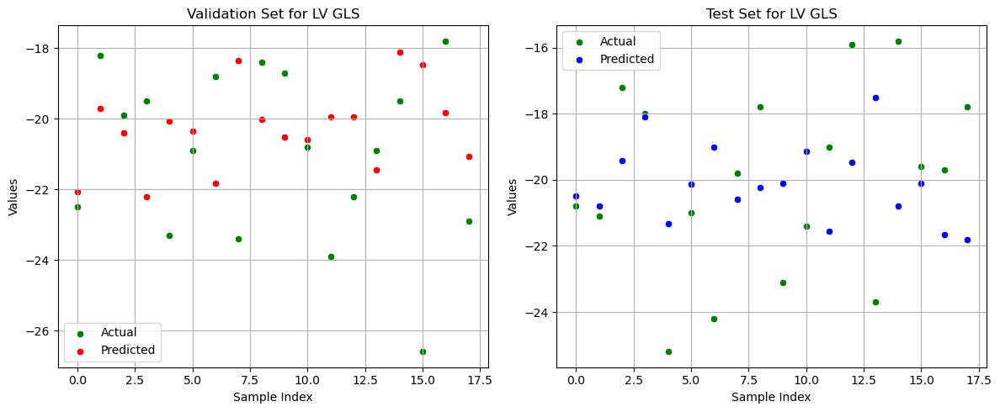

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.2689, MAPE (Val): 10.39%
MAE (Test): 2.5078, MAPE (Test): 12.62%

Fold 4/5


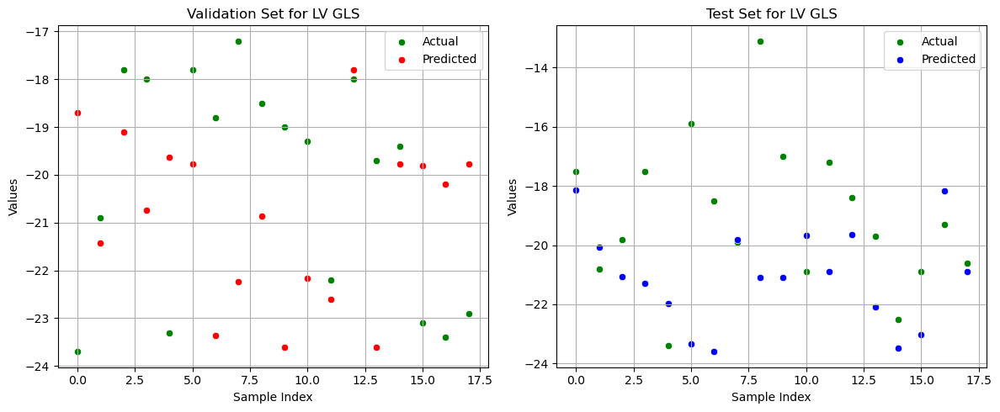

Best parameters: {'algorithm': 'auto', 'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.7296, MAPE (Val): 13.59%
MAE (Test): 2.5389, MAPE (Test): 14.97%

Fold 5/5


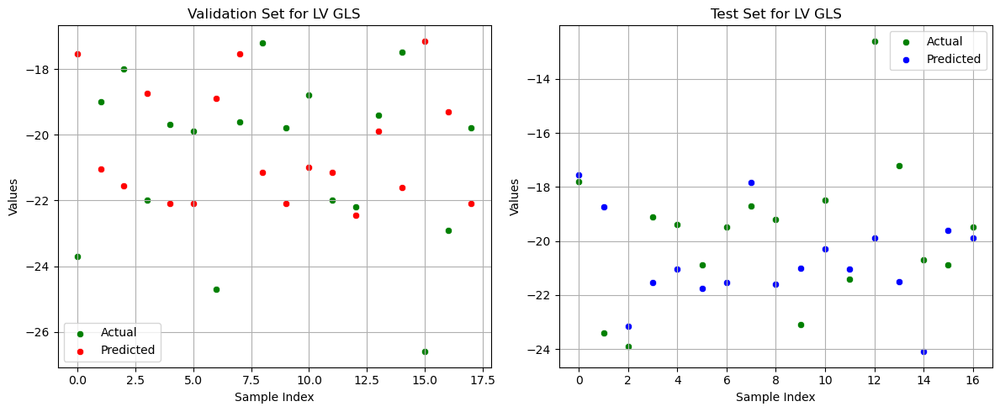

Best parameters: {'algorithm': 'auto', 'n_neighbors': 2, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.1639, MAPE (Val): 14.92%
MAE (Test): 2.1676, MAPE (Test): 12.09%

Średnie wyniki dla walidacji:
MAE: 2.6409, MAPE: 12.72%
Średnie wyniki dla testu:
MAE: 2.3346, MAPE: 12.06%
Trenowanie modelu dla kolumny LASr_ED z 5-krotną walidacją krzyżową
Fold 1/5


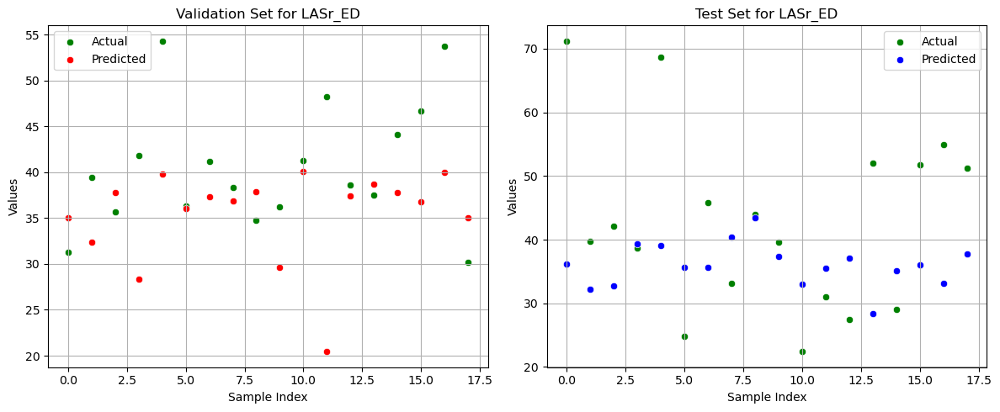

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 6.7900, MAPE (Val): 15.52%
MAE (Test): 12.1333, MAPE (Test): 27.18%

Fold 2/5


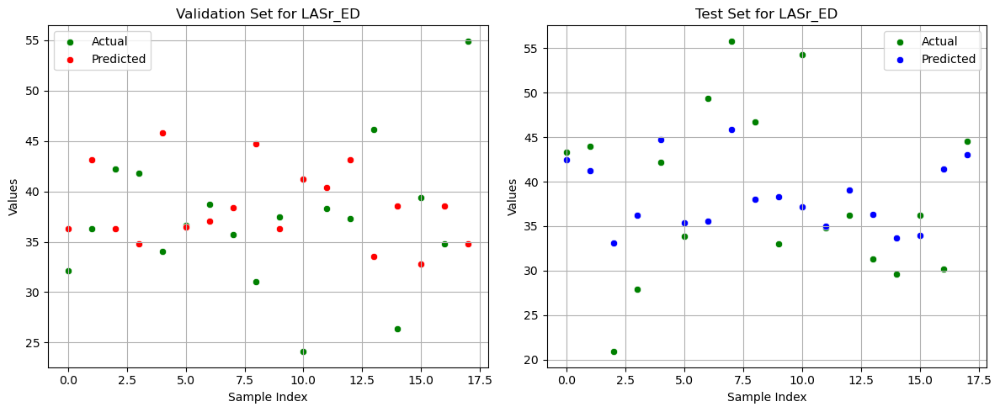

Best parameters: {'algorithm': 'auto', 'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}
MAE (Val): 7.5315, MAPE (Val): 21.50%
MAE (Test): 6.1241, MAPE (Test): 16.90%

Fold 3/5


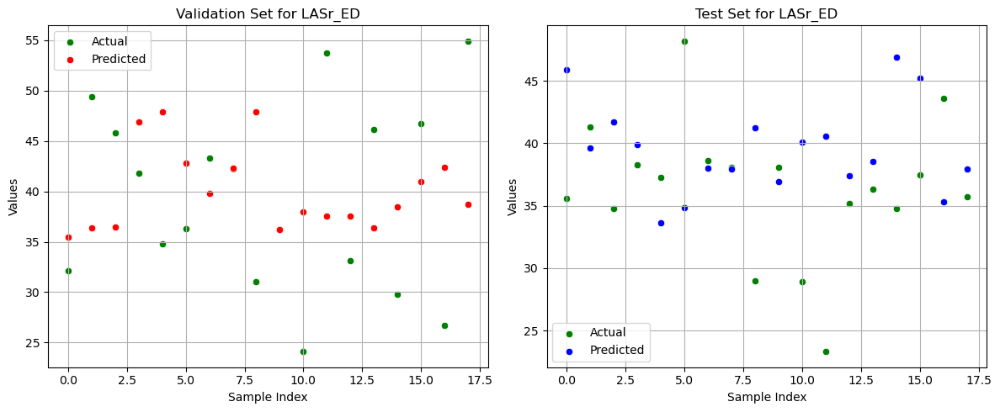

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 8.9578, MAPE (Val): 24.40%
MAE (Test): 6.3833, MAPE (Test): 19.31%

Fold 4/5


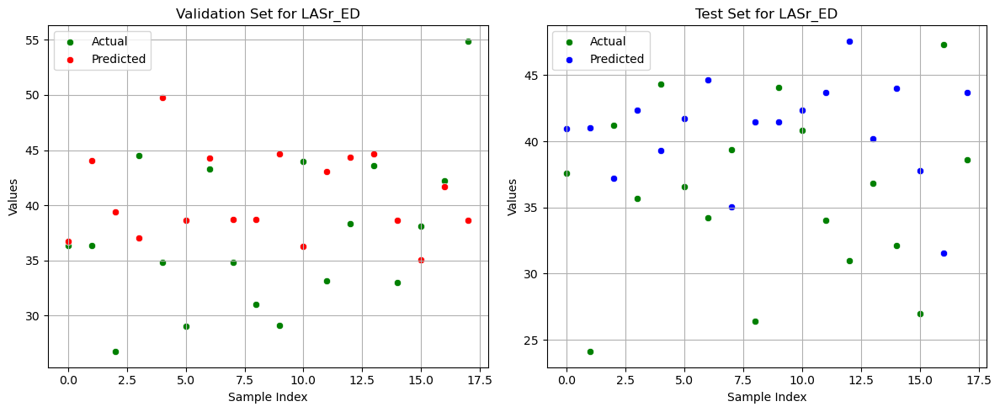

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 7.2900, MAPE (Val): 20.91%
MAE (Test): 8.2356, MAPE (Test): 25.32%

Fold 5/5


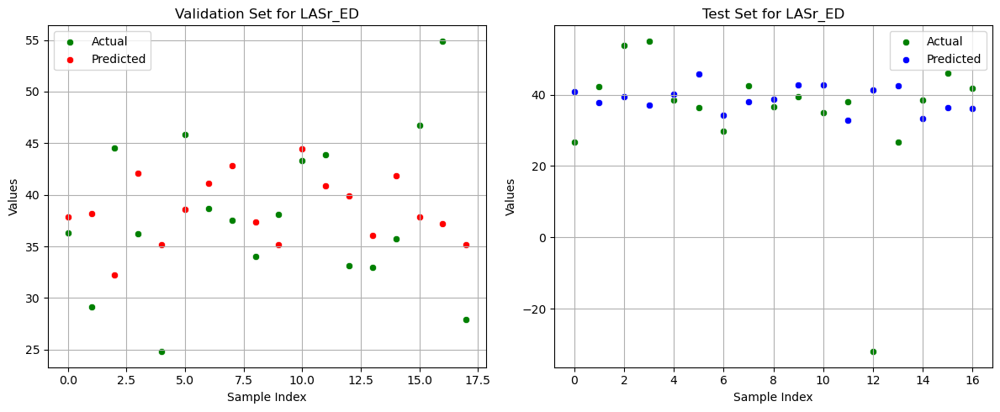

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 6.3522, MAPE (Val): 17.15%
MAE (Test): 11.6824, MAPE (Test): 33.18%

Średnie wyniki dla walidacji:
MAE: 7.3843, MAPE: 19.90%
Średnie wyniki dla testu:
MAE: 8.9117, MAPE: 24.38%
Trenowanie modelu dla kolumny LAScd_ED z 5-krotną walidacją krzyżową
Fold 1/5


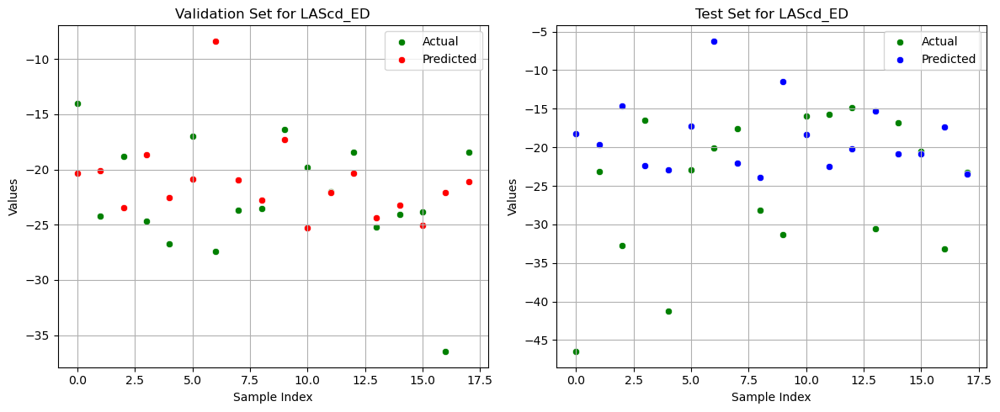

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.4600, MAPE (Val): 19.17%
MAE (Test): 9.5733, MAPE (Test): 34.86%

Fold 2/5


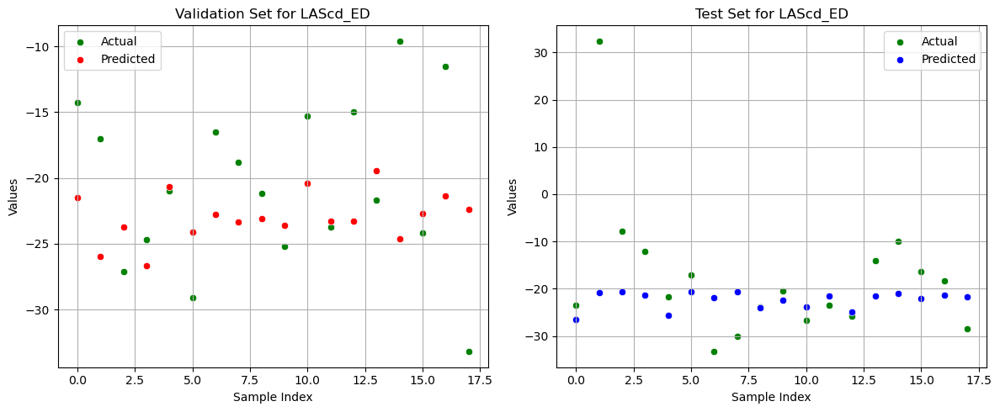

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 5.2389, MAPE (Val): 33.38%
MAE (Test): 8.2411, MAPE (Test): 44.14%

Fold 3/5


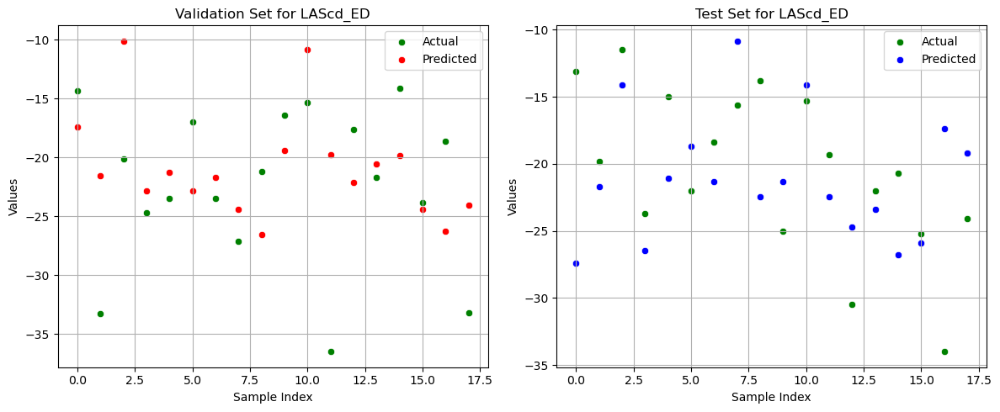

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 5.4244, MAPE (Val): 24.27%
MAE (Test): 5.0511, MAPE (Test): 26.88%

Fold 4/5


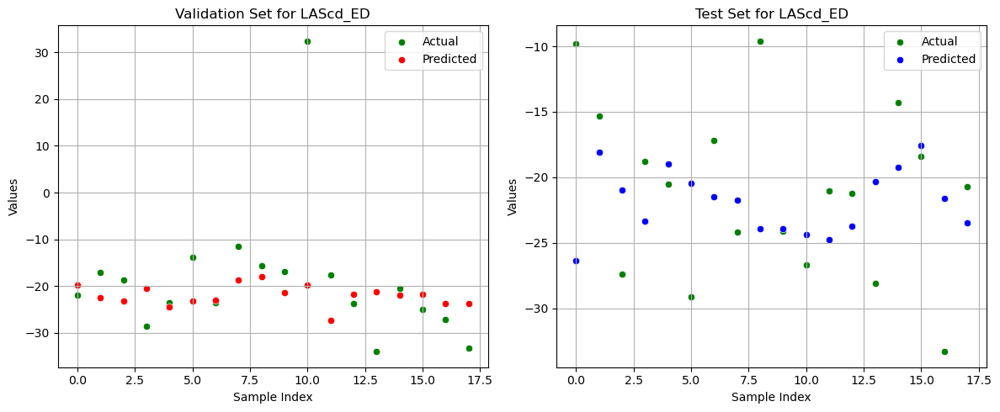

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'distance'}
MAE (Val): 7.7252, MAPE (Val): 33.05%
MAE (Test): 5.4703, MAPE (Test): 33.96%

Fold 5/5


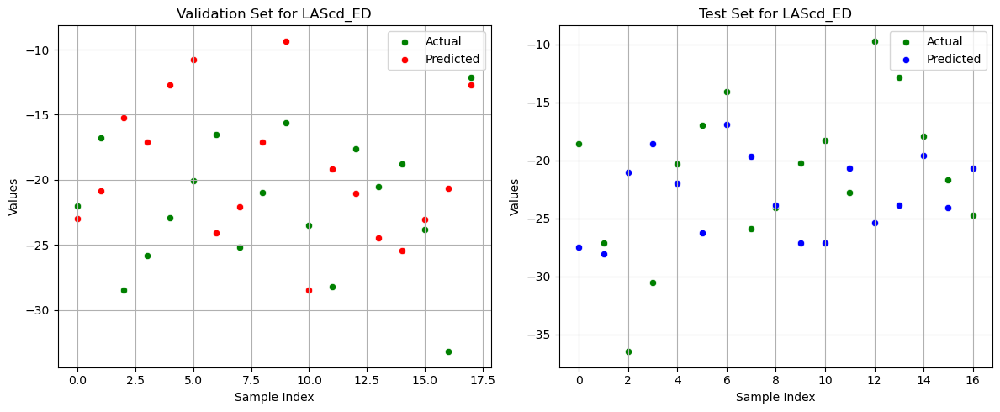

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 6.0678, MAPE (Val): 27.19%
MAE (Test): 6.4812, MAPE (Test): 36.29%

Średnie wyniki dla walidacji:
MAE: 5.7833, MAPE: 27.41%
Średnie wyniki dla testu:
MAE: 6.9634, MAPE: 35.22%
Trenowanie modelu dla kolumny LASct_ED z 5-krotną walidacją krzyżową
Fold 1/5


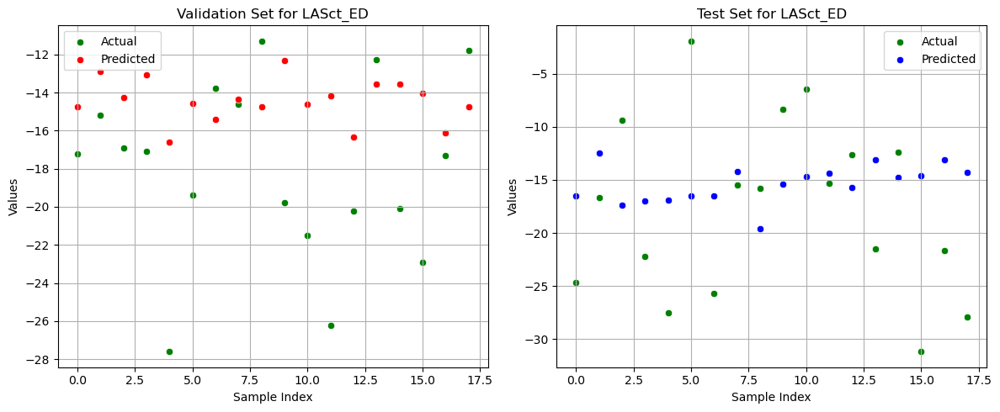

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 4.6422, MAPE (Val): 23.62%
MAE (Test): 7.4511, MAPE (Test): 82.59%

Fold 2/5


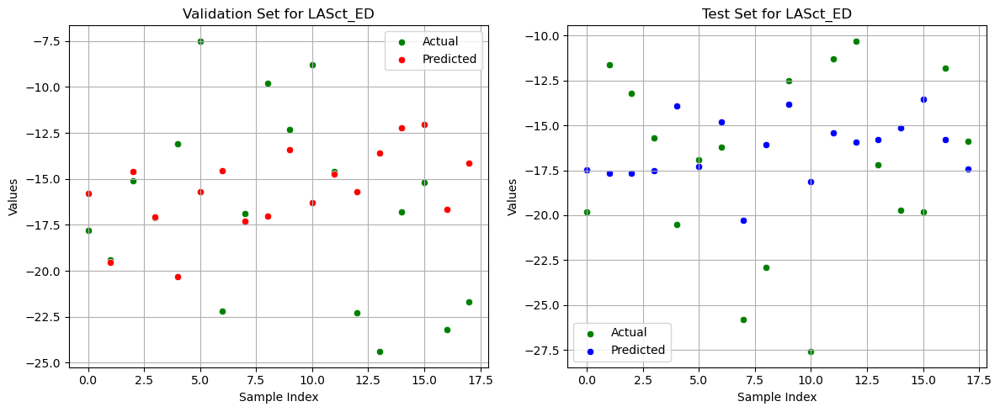

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 4.5178, MAPE (Val): 31.68%
MAE (Test): 4.0911, MAPE (Test): 24.77%

Fold 3/5


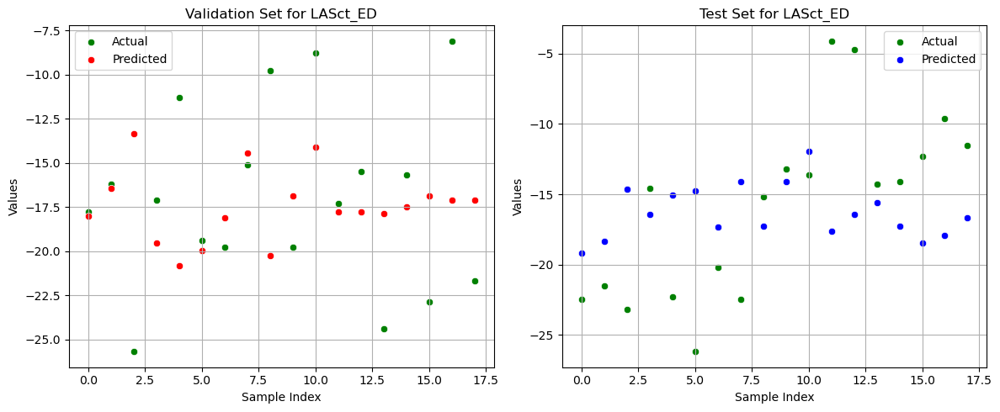

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.2822, MAPE (Val): 31.18%
MAE (Test): 5.6056, MAPE (Test): 57.39%

Fold 4/5


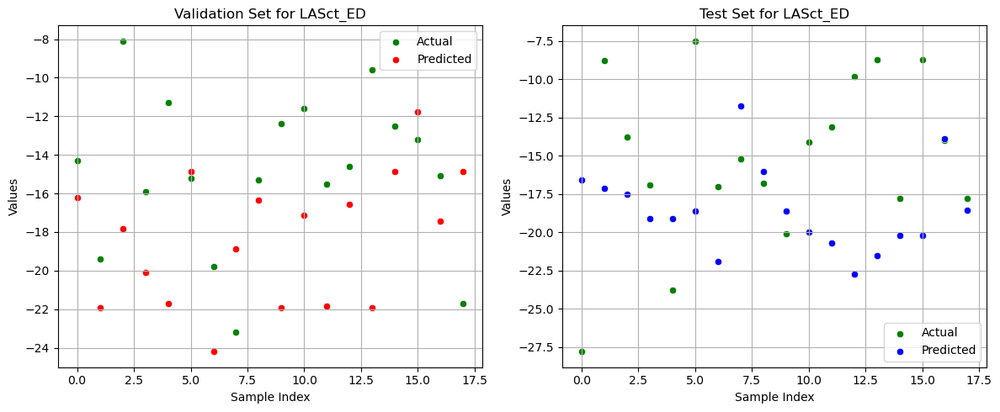

Best parameters: {'algorithm': 'auto', 'n_neighbors': 4, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.8625, MAPE (Val): 38.83%
MAE (Test): 5.8819, MAPE (Test): 52.01%

Fold 5/5


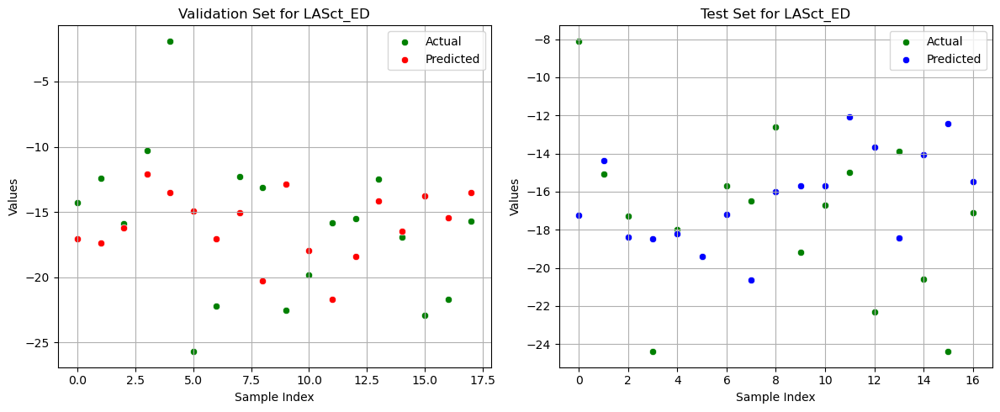

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.8444, MAPE (Val): 57.62%
MAE (Test): 3.9412, MAPE (Test): 24.55%

Średnie wyniki dla walidacji:
MAE: 4.6298, MAPE: 36.58%
Średnie wyniki dla testu:
MAE: 5.3942, MAPE: 48.26%
Trenowanie modelu dla kolumny LASr_AC z 5-krotną walidacją krzyżową
Fold 1/5


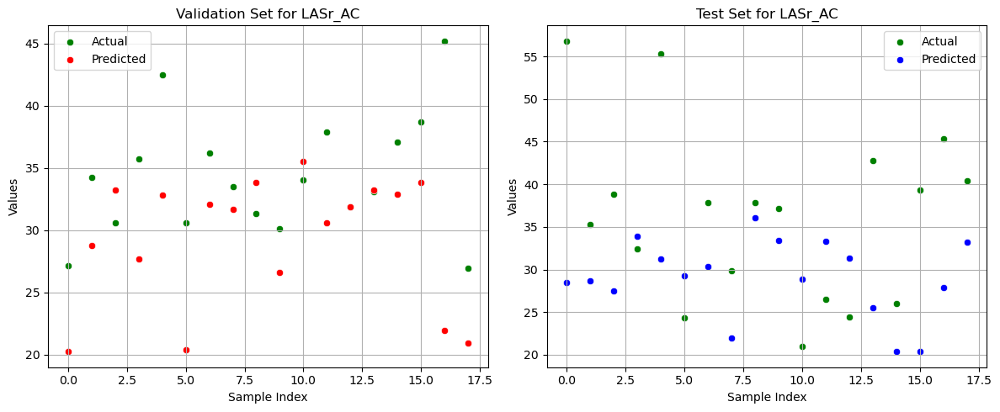

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 5.6789, MAPE (Val): 15.95%
MAE (Test): 10.3222, MAPE (Test): 26.98%

Fold 2/5


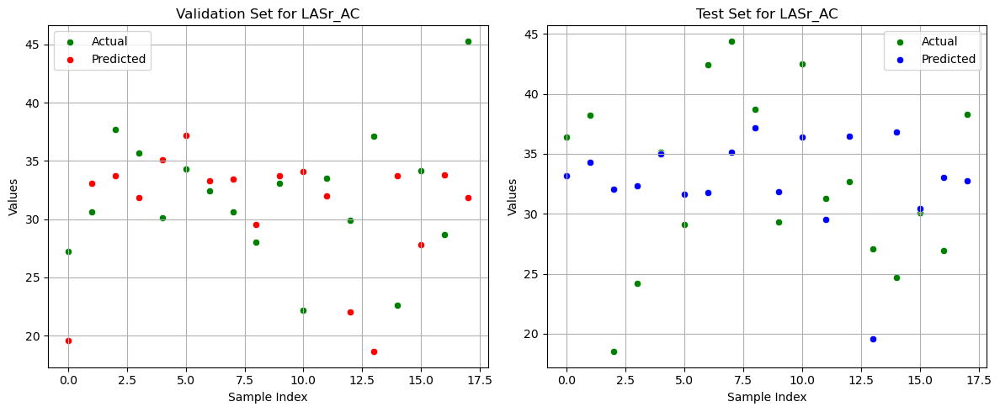

Best parameters: {'algorithm': 'auto', 'n_neighbors': 4, 'p': 2, 'weights': 'uniform'}
MAE (Val): 5.9722, MAPE (Val): 19.52%
MAE (Test): 5.4903, MAPE (Test): 18.93%

Fold 3/5


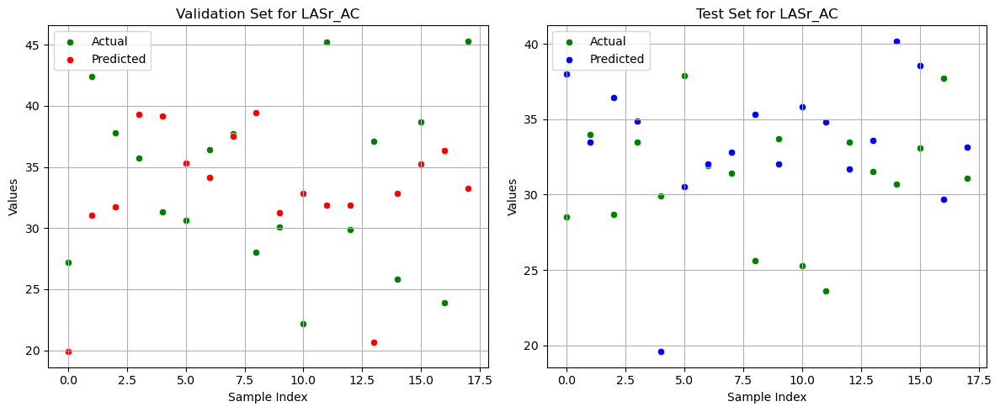

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 7.4122, MAPE (Val): 23.06%
MAE (Test): 5.5778, MAPE (Test): 19.12%

Fold 4/5


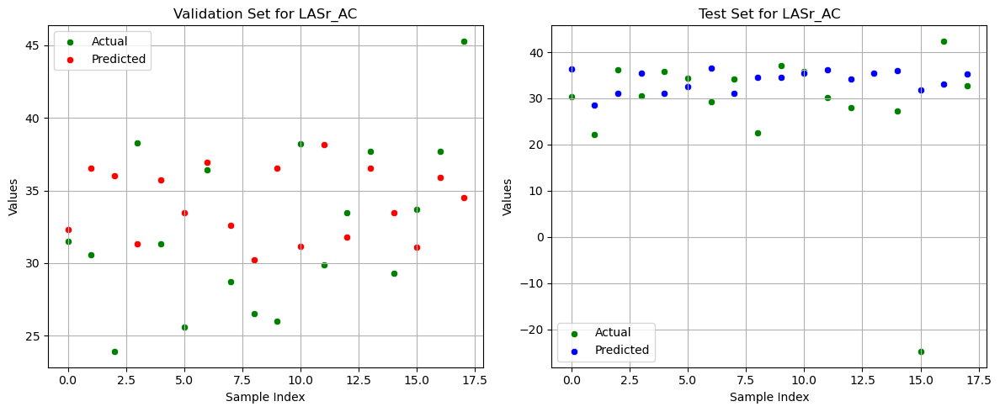

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 5.2478, MAPE (Val): 17.25%
MAE (Test): 7.9900, MAPE (Test): 29.16%

Fold 5/5


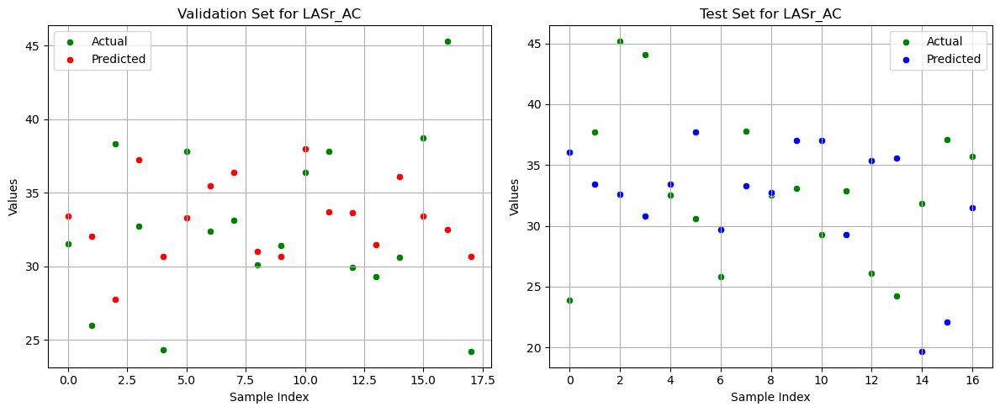

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 4.6411, MAPE (Val): 14.18%
MAE (Test): 7.4282, MAPE (Test): 23.31%

Średnie wyniki dla walidacji:
MAE: 5.7904, MAPE: 17.99%
Średnie wyniki dla testu:
MAE: 7.3617, MAPE: 23.50%
Trenowanie modelu dla kolumny LAScd_AC z 5-krotną walidacją krzyżową
Fold 1/5


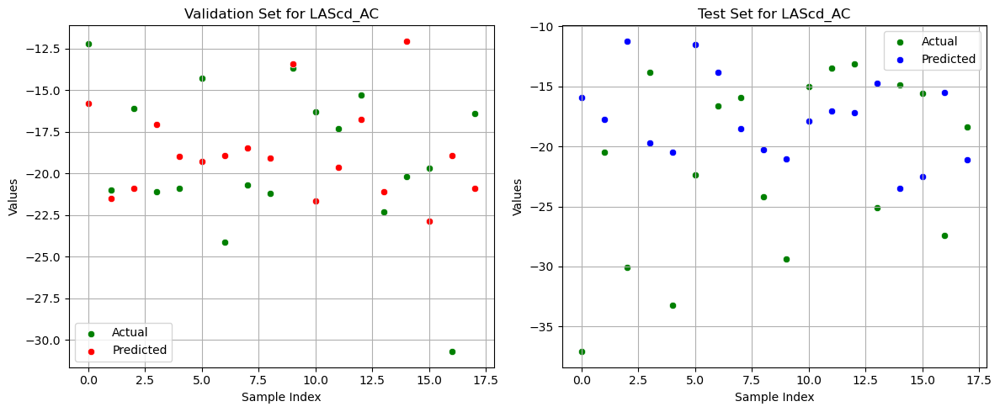

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
MAE (Val): 3.7537, MAPE (Val): 19.58%
MAE (Test): 7.8347, MAPE (Test): 34.39%

Fold 2/5


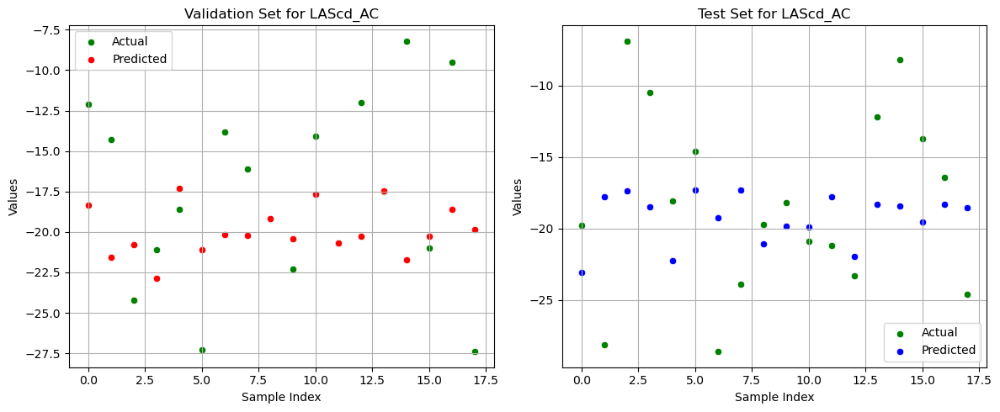

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.5178, MAPE (Val): 34.50%
MAE (Test): 5.2022, MAPE (Test): 37.67%

Fold 3/5


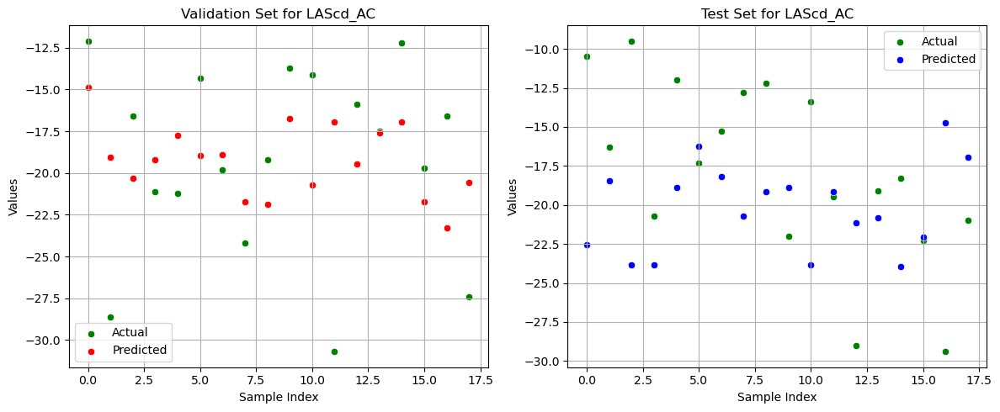

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 4.4144, MAPE (Val): 23.14%
MAE (Test): 5.8567, MAPE (Test): 40.34%

Fold 4/5


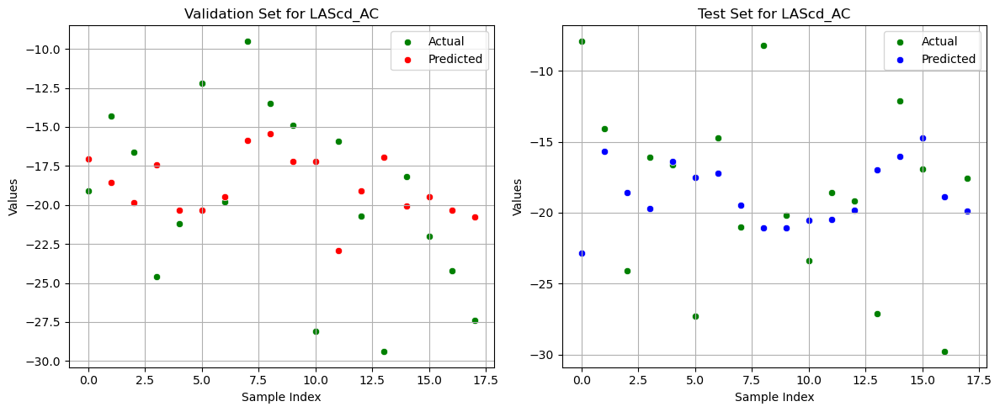

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'distance'}
MAE (Val): 4.6405, MAPE (Val): 25.20%
MAE (Test): 4.9016, MAPE (Test): 34.80%

Fold 5/5


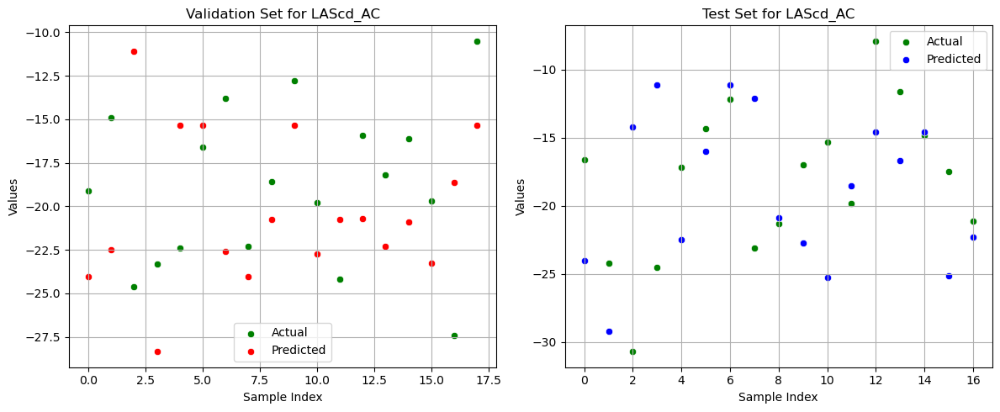

Best parameters: {'algorithm': 'auto', 'n_neighbors': 2, 'p': 1, 'weights': 'uniform'}
MAE (Val): 5.1056, MAPE (Val): 27.97%
MAE (Test): 5.8588, MAPE (Test): 32.89%

Średnie wyniki dla walidacji:
MAE: 4.4864, MAPE: 26.08%
Średnie wyniki dla testu:
MAE: 5.9308, MAPE: 36.02%
Trenowanie modelu dla kolumny LASct_AC z 5-krotną walidacją krzyżową
Fold 1/5


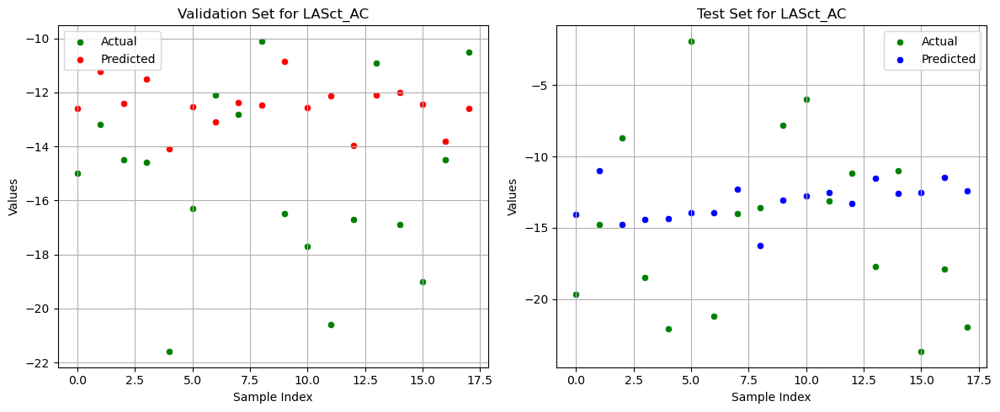

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 3.4467, MAPE (Val): 21.07%
MAE (Test): 5.5944, MAPE (Test): 70.03%

Fold 2/5


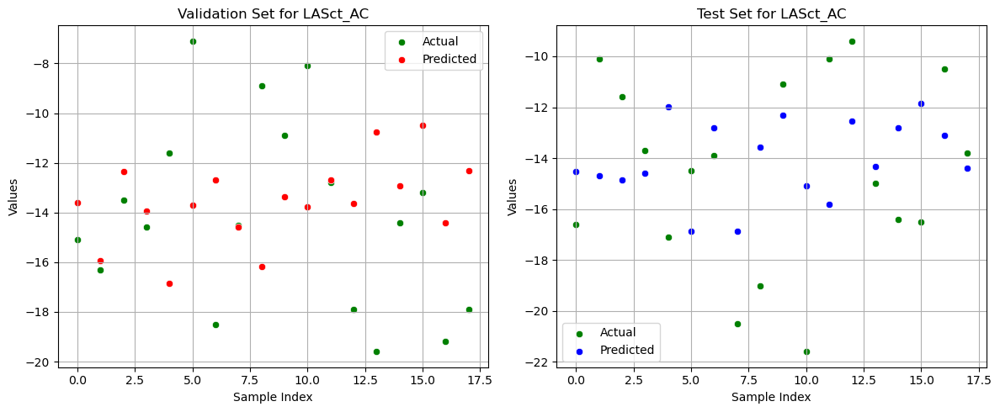

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.5911, MAPE (Val): 29.27%
MAE (Test): 3.1756, MAPE (Test): 22.66%

Fold 3/5


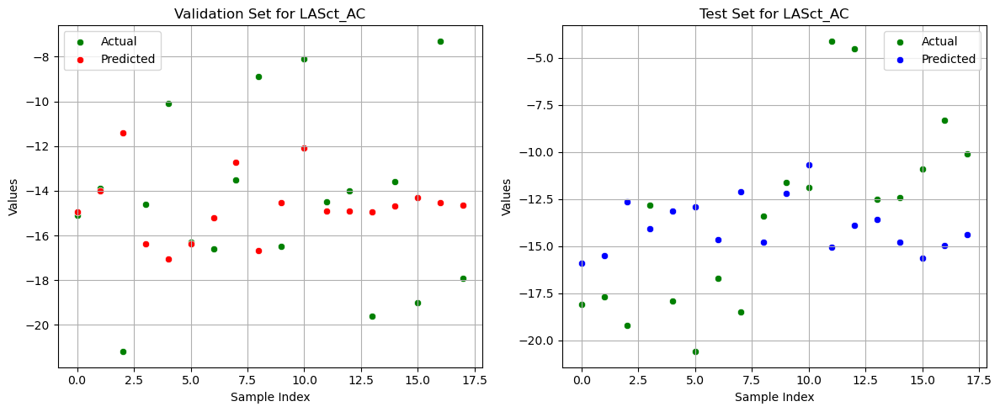

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.1667, MAPE (Val): 26.40%
MAE (Test): 4.2144, MAPE (Test): 48.63%

Fold 4/5


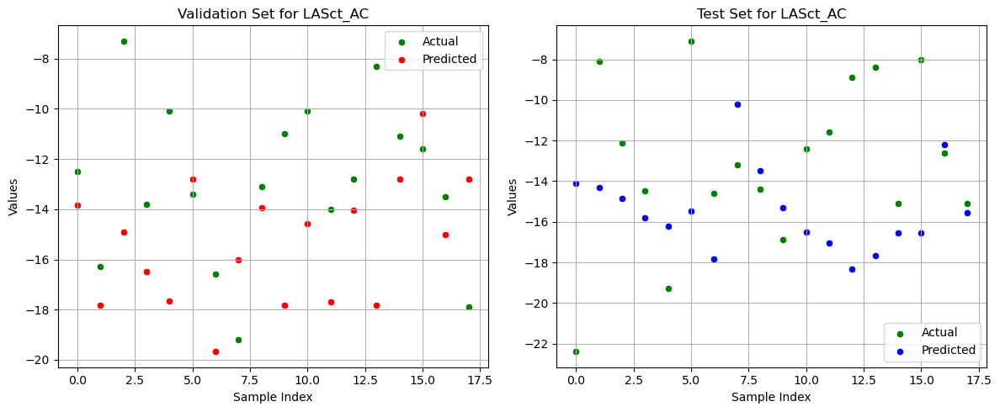

Best parameters: {'algorithm': 'auto', 'n_neighbors': 4, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.5472, MAPE (Val): 32.69%
MAE (Test): 4.3250, MAPE (Test): 42.15%

Fold 5/5


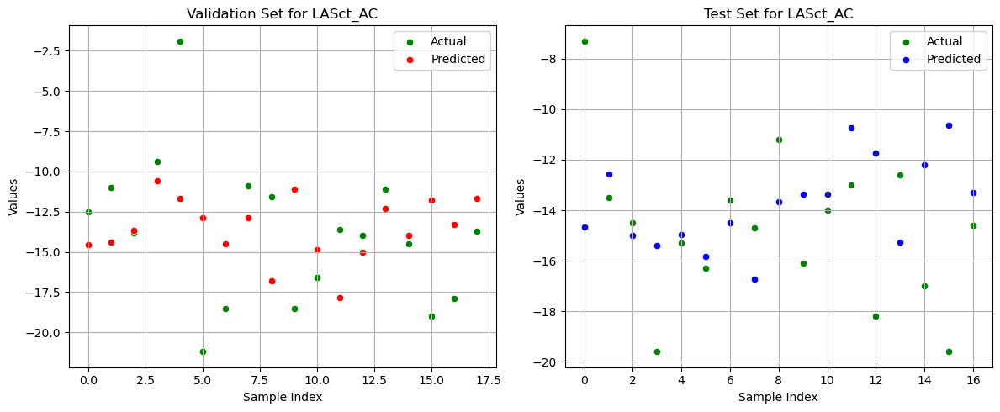

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.6700, MAPE (Val): 48.94%
MAE (Test): 2.8847, MAPE (Test): 21.10%

Średnie wyniki dla walidacji:
MAE: 3.4843, MAPE: 31.67%
Średnie wyniki dla testu:
MAE: 4.0388, MAPE: 40.92%
Trenowanie modelu dla kolumny RVFWSL z 5-krotną walidacją krzyżową
Fold 1/5


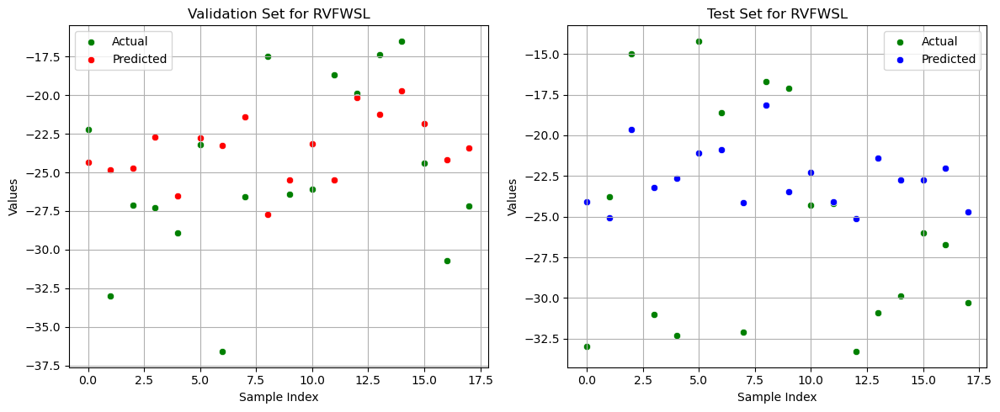

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 4.4278, MAPE (Val): 18.00%
MAE (Test): 5.4256, MAPE (Test): 21.45%

Fold 2/5


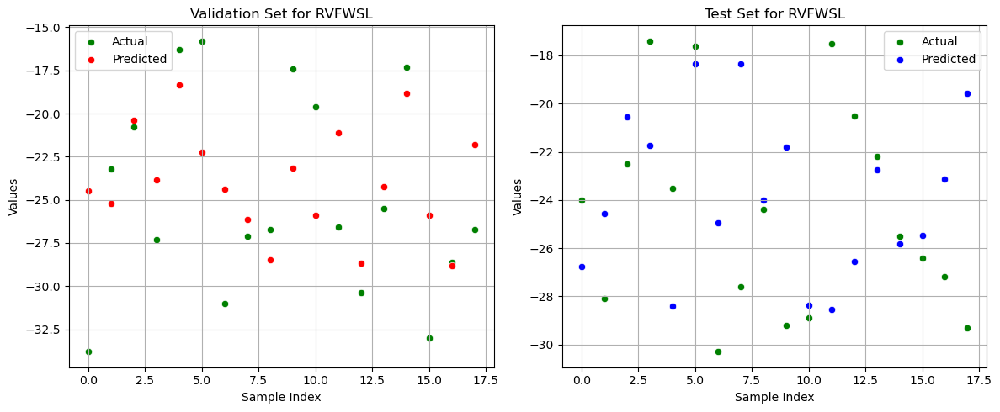

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 3.7311, MAPE (Val): 15.61%
MAE (Test): 4.1033, MAPE (Test): 17.26%

Fold 3/5


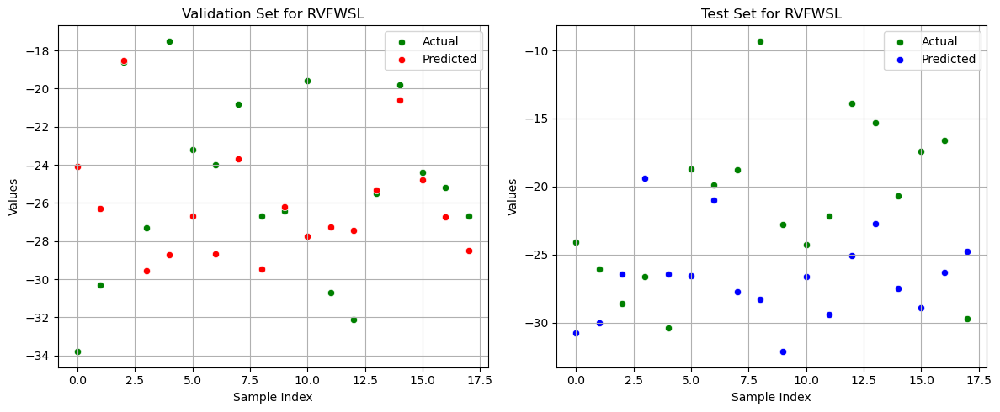

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
MAE (Val): 3.4617, MAPE (Val): 14.50%
MAE (Test): 7.2965, MAPE (Test): 43.12%

Fold 4/5


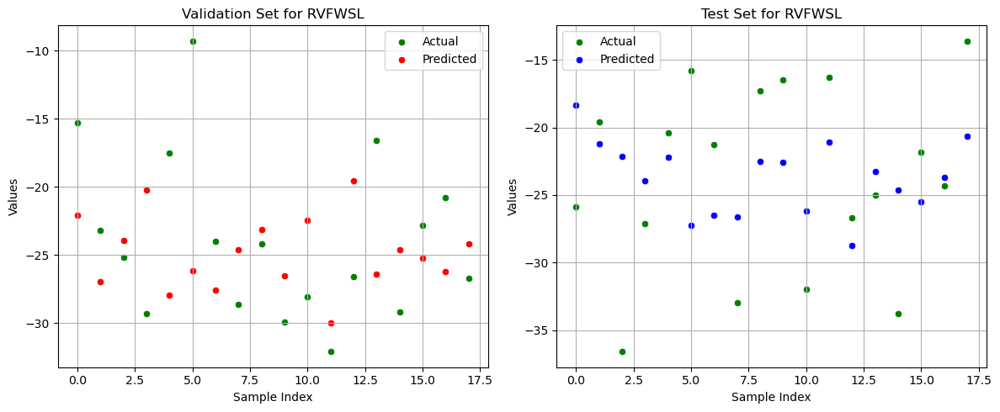

Best parameters: {'algorithm': 'brute', 'n_neighbors': 4, 'p': 2, 'weights': 'distance'}
MAE (Val): 5.5440, MAPE (Val): 30.90%
MAE (Test): 5.4309, MAPE (Test): 24.49%

Fold 5/5


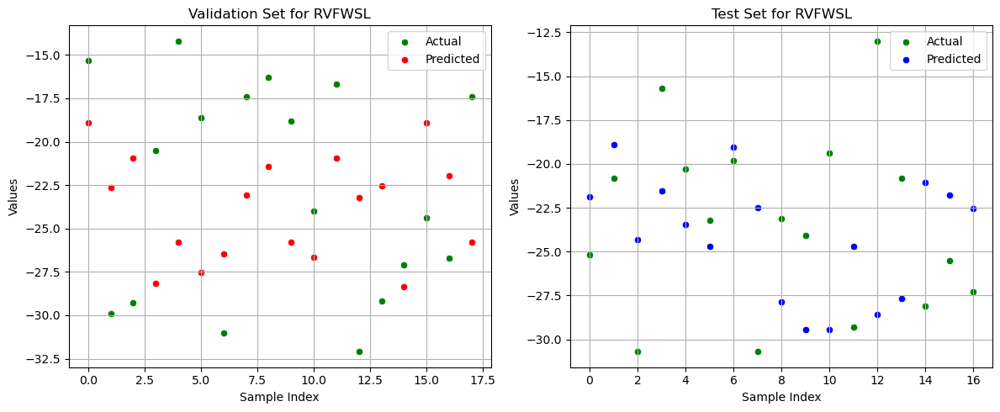

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 6.2333, MAPE (Val): 30.00%
MAE (Test): 5.5200, MAPE (Test): 26.66%

Średnie wyniki dla walidacji:
MAE: 4.6796, MAPE: 21.80%
Średnie wyniki dla testu:
MAE: 5.5553, MAPE: 26.60%
Trenowanie modelu dla kolumny RV4CSL z 5-krotną walidacją krzyżową
Fold 1/5


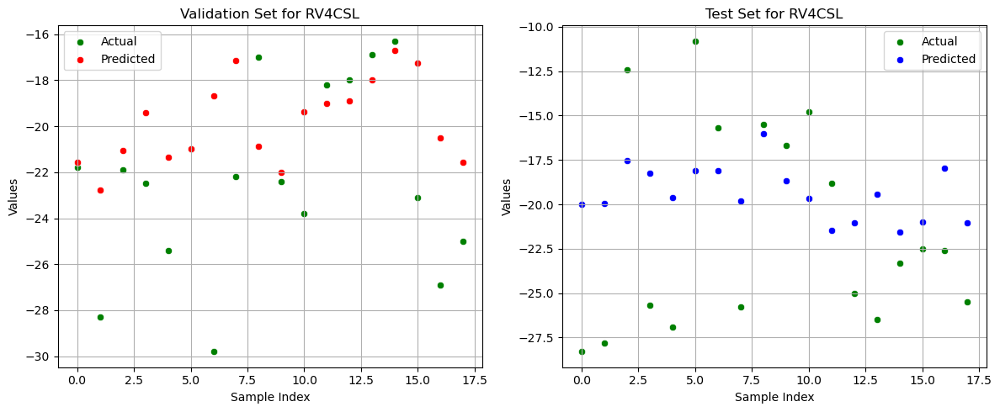

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 3.1956, MAPE (Val): 13.26%
MAE (Test): 4.7278, MAPE (Test): 23.23%

Fold 2/5


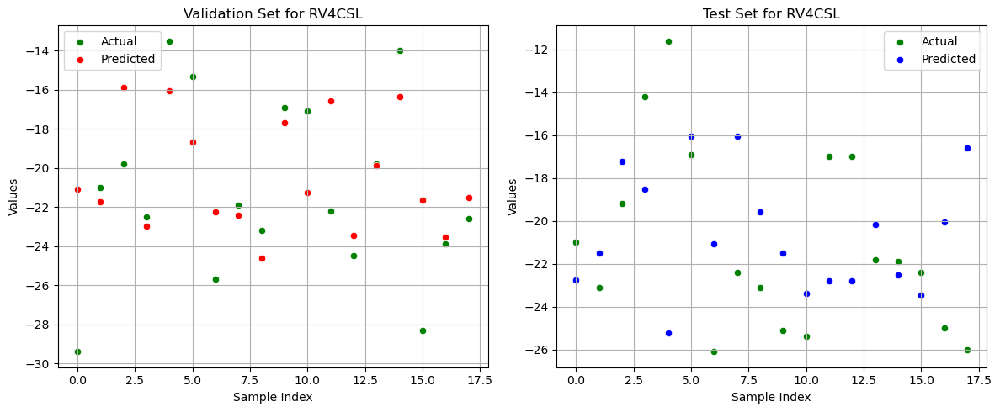

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}
MAE (Val): 2.6067, MAPE (Val): 12.35%
MAE (Test): 4.1033, MAPE (Test): 22.37%

Fold 3/5


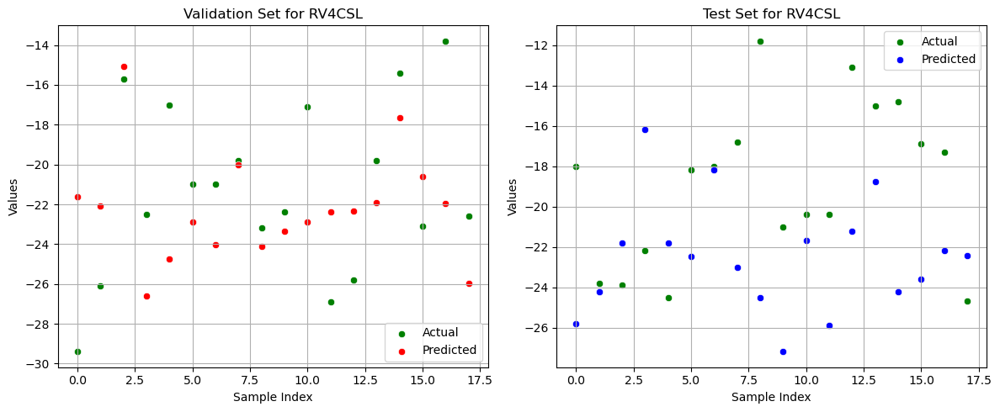

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 1, 'weights': 'distance'}
MAE (Val): 3.5241, MAPE (Val): 17.59%
MAE (Test): 5.0327, MAPE (Test): 30.67%

Fold 4/5


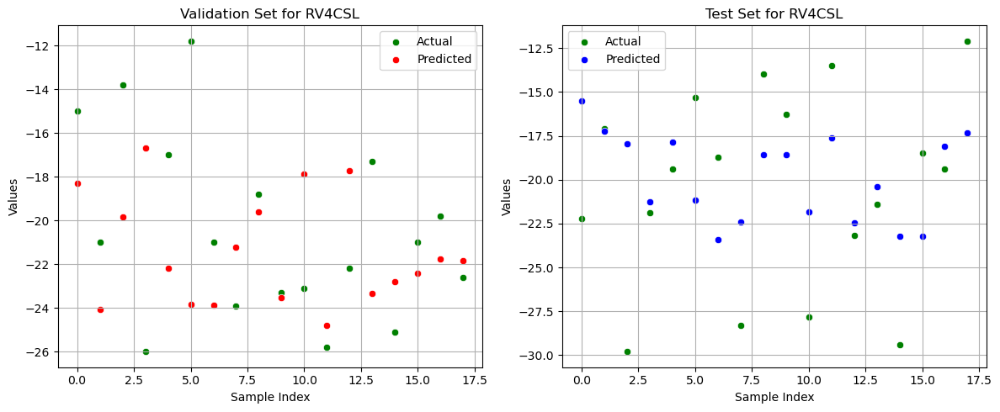

Best parameters: {'algorithm': 'brute', 'n_neighbors': 5, 'p': 2, 'weights': 'distance'}
MAE (Val): 3.8164, MAPE (Val): 21.64%
MAE (Test): 4.0780, MAPE (Test): 20.49%

Fold 5/5


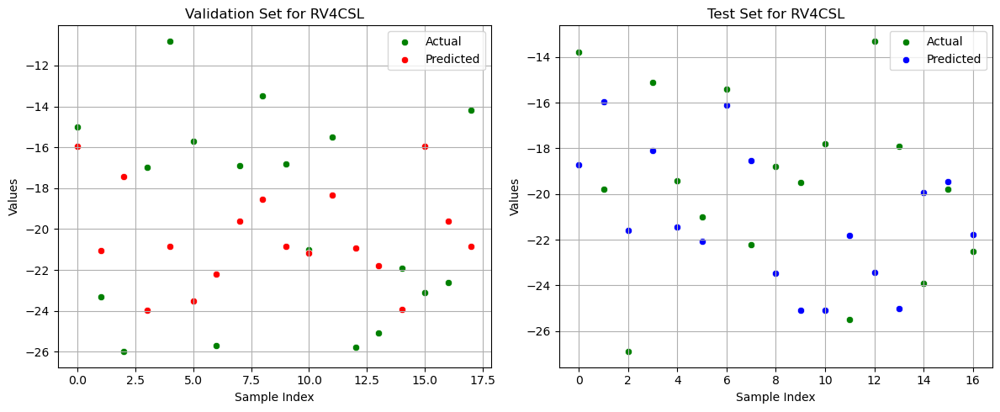

Best parameters: {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}
MAE (Val): 4.5500, MAPE (Val): 26.40%
MAE (Test): 4.0082, MAPE (Test): 22.24%

Średnie wyniki dla walidacji:
MAE: 3.5385, MAPE: 18.25%
Średnie wyniki dla testu:
MAE: 4.3900, MAPE: 23.80%


In [31]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Funkcja do obliczenia MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred) / np.abs(y_true)) * 100

# Funkcja oceny modelu regresji z użyciem MAE
def evaluate_regression_model(X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y_col):
    # Przeprowadzamy GridSearchCV w celu znalezienia najlepszych parametrów
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)
    
    # Używamy najlepszego modelu z GridSearchCV
    best_model = grid_search.best_estimator_
    
    # Ocena modelu na zbiorze treningowym
    y_train_pred = best_model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_train_pred)  # MAE dla treningu
    r2_train = r2_score(y_train, y_train_pred)

    # Ocena modelu na zbiorze walidacyjnym
    y_val_pred = best_model.predict(X_val)
    mae_val = mean_absolute_error(y_val, y_val_pred)  # MAE dla walidacji
    mape_val = mean_absolute_percentage_error(y_val, y_val_pred)
    r2_val = r2_score(y_val, y_val_pred)

    # Ocena modelu na zbiorze testowym
    y_test_pred = best_model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_test_pred)  # MAE dla testu
    mape_test = mean_absolute_percentage_error(y_test, y_test_pred)
    r2_test = r2_score(y_test, y_test_pred)

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val_pred, color='red', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Validation Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test_pred, color='blue', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Test Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    plt.show()
    
    return grid_search.best_params_, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test

# Cross-validation z 5-krotnym podziałem dla regresji
def cross_validate_regression(X, y, model, param_grid, cv=5):
    X = X.values  # Konwersja do tablicy NumPy
    kf = KFold(n_splits=cv, shuffle=True, random_state=43)
    
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X)  # Skalowanie całego zbioru przed podziałem
    
    fold = 1
    val_results = []  # Lista do przechowywania wyników walidacyjnych
    test_results = []  # Lista do przechowywania wyników testowych
    
    for train_idx, test_idx in kf.split(X_scaled):
        print(f"Fold {fold}/{cv}")
        X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
        
        # Dalszy podział zbioru treningowego na train/val (60/20)
        X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=43)  # 25% z 60% na walidację
        
        best_params, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test = evaluate_regression_model(
            X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y.name)
        
        val_results.append((mae_val, mape_val, r2_val))
        test_results.append((mae_test, mape_test, r2_test))
        
        print(f"Best parameters: {best_params}")
        print(f"MAE (Val): {mae_val:.4f}, MAPE (Val): {mape_val:.2f}%")
        print(f"MAE (Test): {mae_test:.4f}, MAPE (Test): {mape_test:.2f}%\n")
        
        fold += 1
    
    # Obliczanie średnich wartości dla walidacji i testu
    val_mae_mean = np.mean([result[0] for result in val_results])
    val_mape_mean = np.mean([result[1] for result in val_results])
    
    test_mae_mean = np.mean([result[0] for result in test_results])
    test_mape_mean = np.mean([result[1] for result in test_results])
    
    print("Średnie wyniki dla walidacji:")
    print(f"MAE: {val_mae_mean:.4f}, MAPE: {val_mape_mean:.2f}%")
    print("Średnie wyniki dla testu:")
    print(f"MAE: {test_mae_mean:.4f}, MAPE: {test_mape_mean:.2f}%")


param_grid = {
    'n_neighbors': [2, 3, 4, 5],  
    'weights': ['uniform', 'distance'],  
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'], 
    'p': [1, 2]  
}

# Trenowanie modelu dla każdej kolumny z 5-krotną walidacją krzyżową
for y_col in y.columns:
    print(f"Trenowanie modelu dla kolumny {y_col} z 5-krotną walidacją krzyżową")
    model = KNeighborsRegressor()
    cross_validate_regression(X, y[y_col], model, param_grid, cv=5)


### LinearRegression

Trenowanie modelu dla kolumny LV A2C z 5-krotną walidacją krzyżową
Fold 1/5


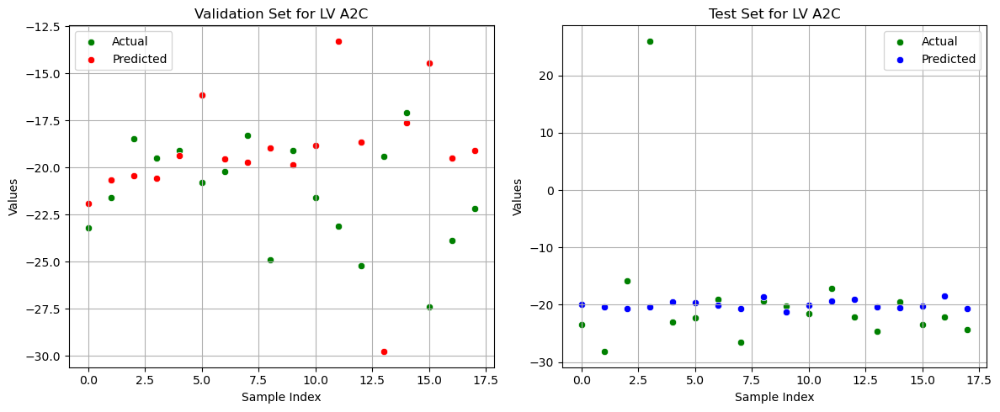

Best parameters: {}
MAE (Val): 3.8502, MAPE (Val): 16.97%
MAE (Test): 5.5895, MAPE (Test): 23.32%

Fold 2/5


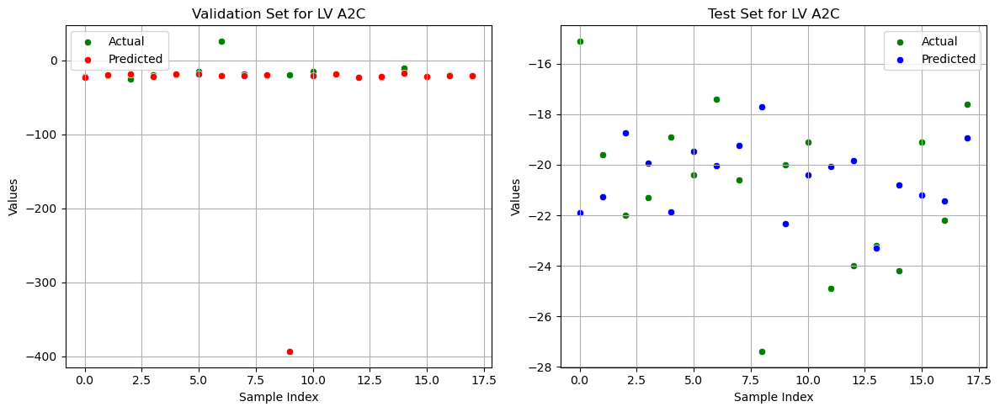

Best parameters: {}
MAE (Val): 25.3128, MAPE (Val): 128.88%
MAE (Test): 2.8352, MAPE (Test): 13.56%

Fold 3/5


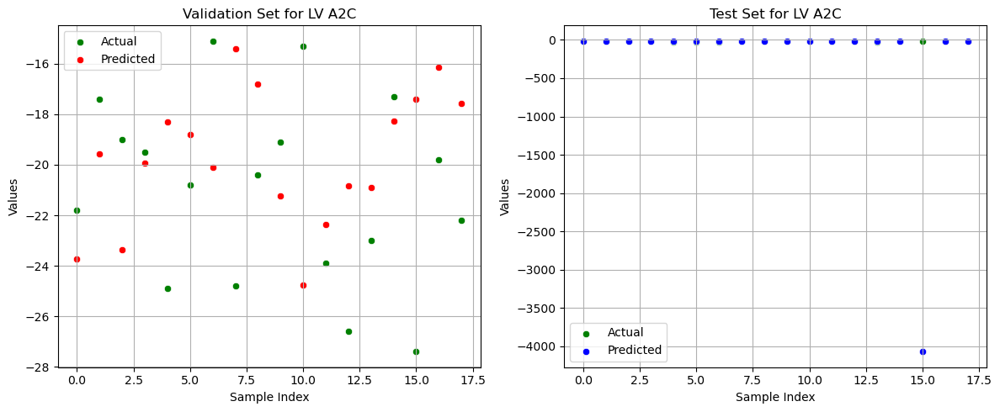

Best parameters: {}
MAE (Val): 4.2029, MAPE (Val): 20.14%
MAE (Test): 227.5768, MAPE (Test): 1171.92%

Fold 4/5


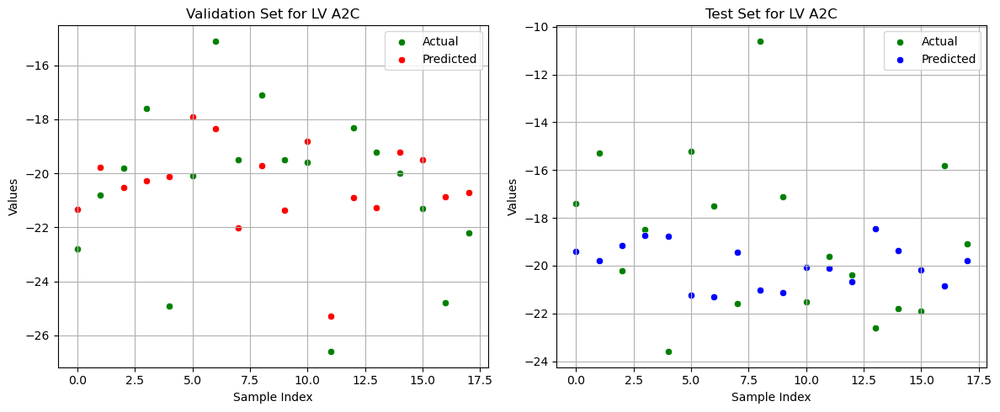

Best parameters: {}
MAE (Val): 2.1088, MAPE (Val): 10.49%
MAE (Test): 3.0725, MAPE (Test): 19.15%

Fold 5/5


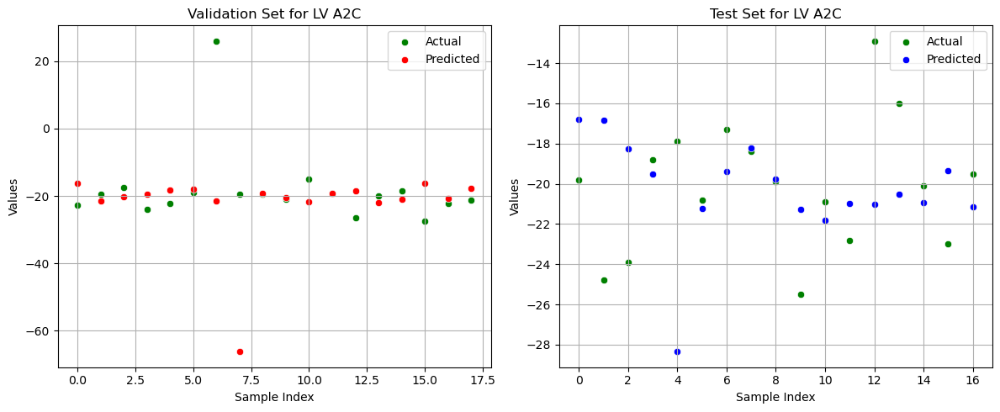

Best parameters: {}
MAE (Val): 8.4242, MAPE (Val): 38.22%
MAE (Test): 3.3134, MAPE (Test): 17.50%

Średnie wyniki dla walidacji:
MAE: 8.7798, MAPE: 42.94%
Średnie wyniki dla testu:
MAE: 48.4775, MAPE: 249.09%
Trenowanie modelu dla kolumny LVA3C z 5-krotną walidacją krzyżową
Fold 1/5


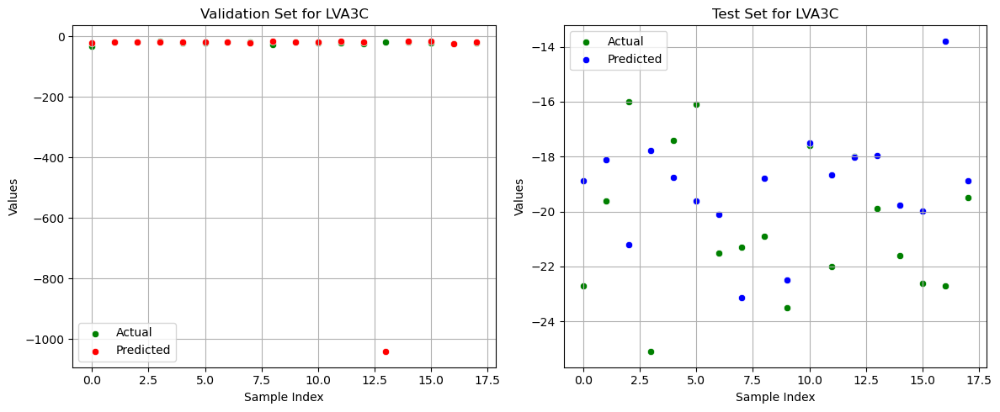

Best parameters: {}
MAE (Val): 60.4658, MAPE (Val): 305.69%
MAE (Test): 2.6911, MAPE (Test): 12.96%

Fold 2/5


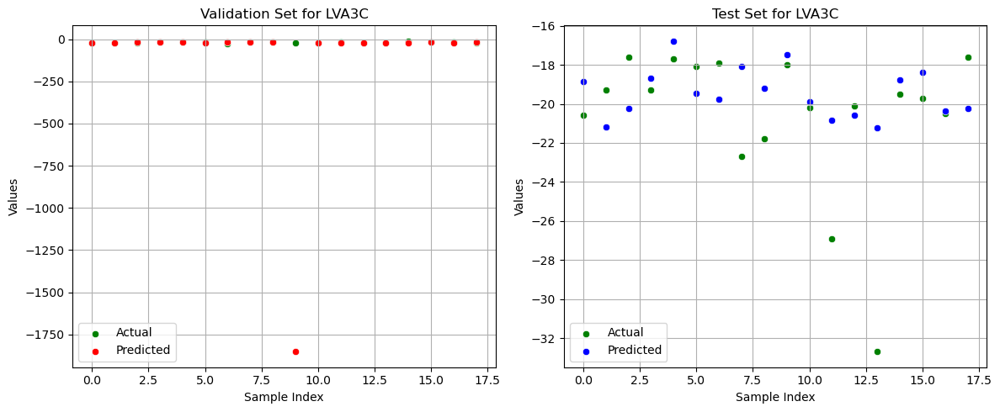

Best parameters: {}
MAE (Val): 104.8991, MAPE (Val): 537.45%
MAE (Test): 2.3320, MAPE (Test): 10.15%

Fold 3/5


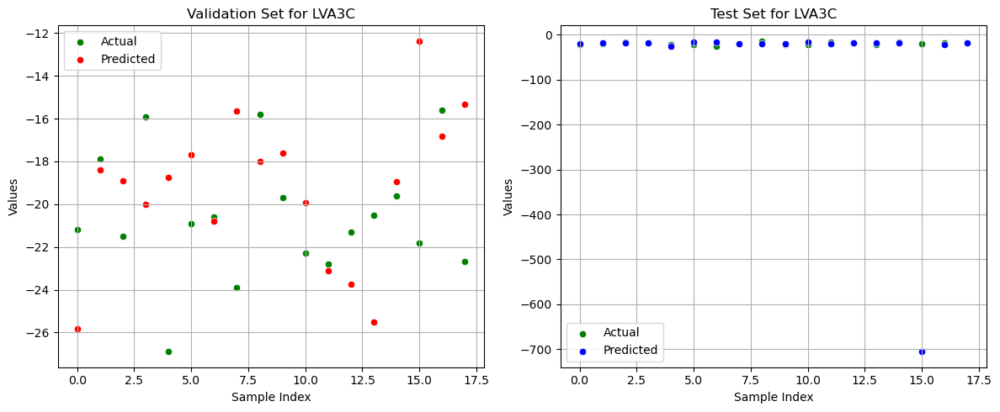

Best parameters: {}
MAE (Val): 3.5968, MAPE (Val): 16.83%
MAE (Test): 41.3362, MAPE (Test): 211.19%

Fold 4/5


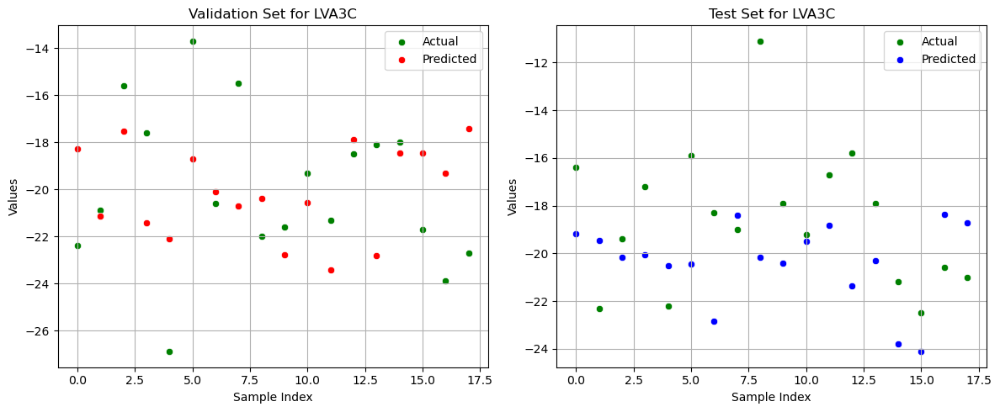

Best parameters: {}
MAE (Val): 2.8127, MAPE (Val): 14.57%
MAE (Test): 2.8501, MAPE (Test): 17.45%

Fold 5/5


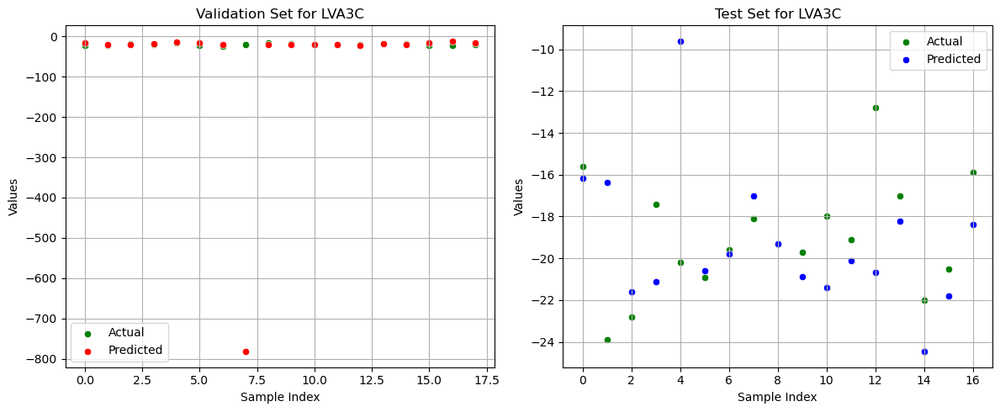

Best parameters: {}
MAE (Val): 45.4232, MAPE (Val): 230.89%
MAE (Test): 2.7158, MAPE (Test): 14.99%

Średnie wyniki dla walidacji:
MAE: 43.4395, MAPE: 221.09%
Średnie wyniki dla testu:
MAE: 10.3850, MAPE: 53.35%
Trenowanie modelu dla kolumny LVA4C z 5-krotną walidacją krzyżową
Fold 1/5


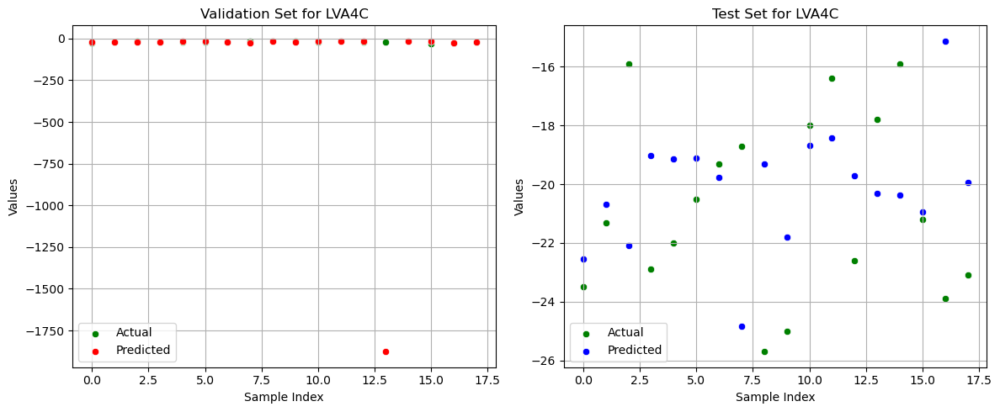

Best parameters: {}
MAE (Val): 106.5835, MAPE (Val): 534.17%
MAE (Test): 3.1592, MAPE (Test): 15.46%

Fold 2/5


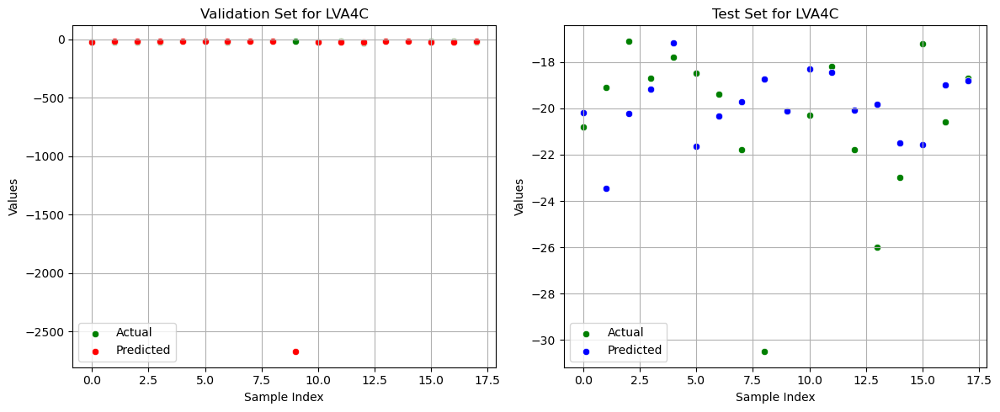

Best parameters: {}
MAE (Val): 150.9828, MAPE (Val): 758.28%
MAE (Test): 2.4938, MAPE (Test): 11.30%

Fold 3/5


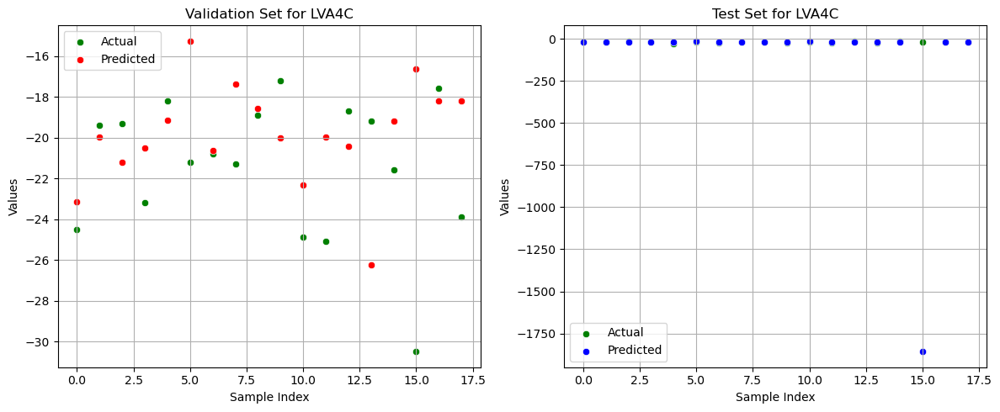

Best parameters: {}
MAE (Val): 3.3150, MAPE (Val): 14.50%
MAE (Test): 105.4377, MAPE (Test): 529.70%

Fold 4/5


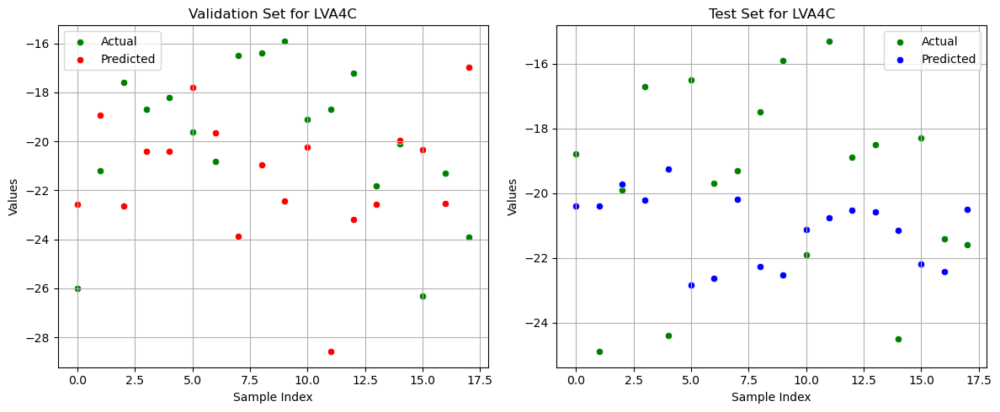

Best parameters: {}
MAE (Val): 3.7856, MAPE (Val): 19.86%
MAE (Test): 3.1028, MAPE (Test): 16.70%

Fold 5/5


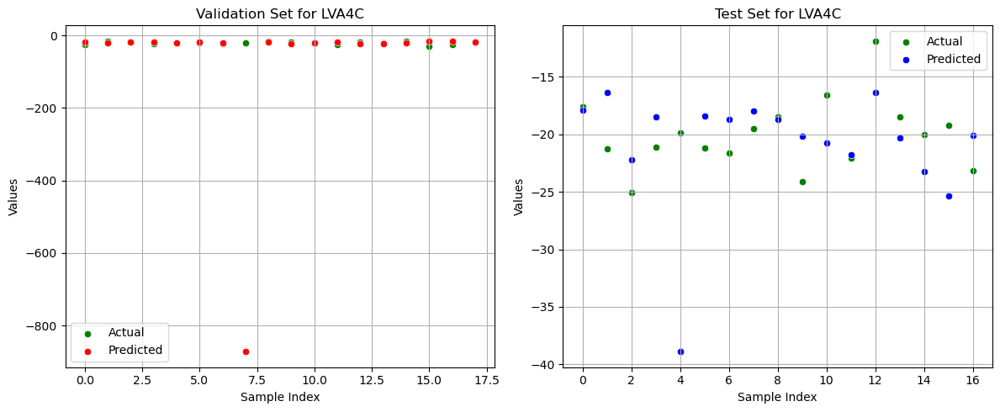

Best parameters: {}
MAE (Val): 50.9603, MAPE (Val): 254.05%
MAE (Test): 3.7824, MAPE (Test): 19.49%

Średnie wyniki dla walidacji:
MAE: 63.1254, MAPE: 316.17%
Średnie wyniki dla testu:
MAE: 23.5952, MAPE: 118.53%
Trenowanie modelu dla kolumny LV GLS z 5-krotną walidacją krzyżową
Fold 1/5


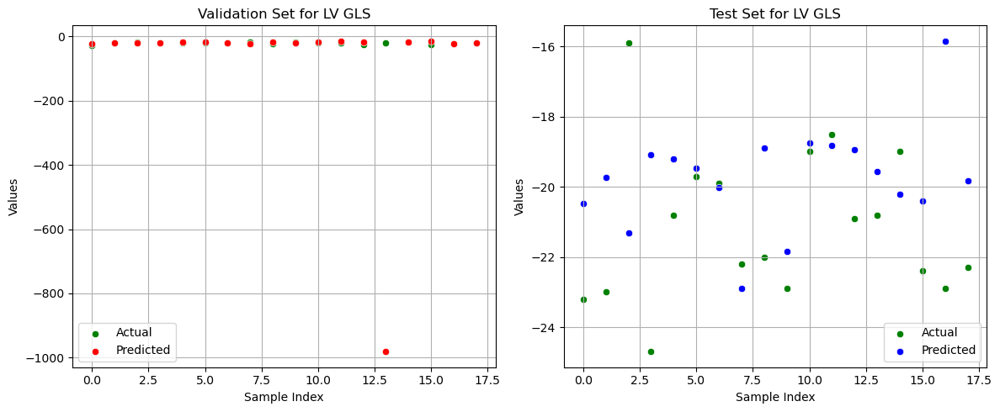

Best parameters: {}
MAE (Val): 56.5464, MAPE (Val): 286.39%
MAE (Test): 2.2405, MAPE (Test): 10.54%

Fold 2/5


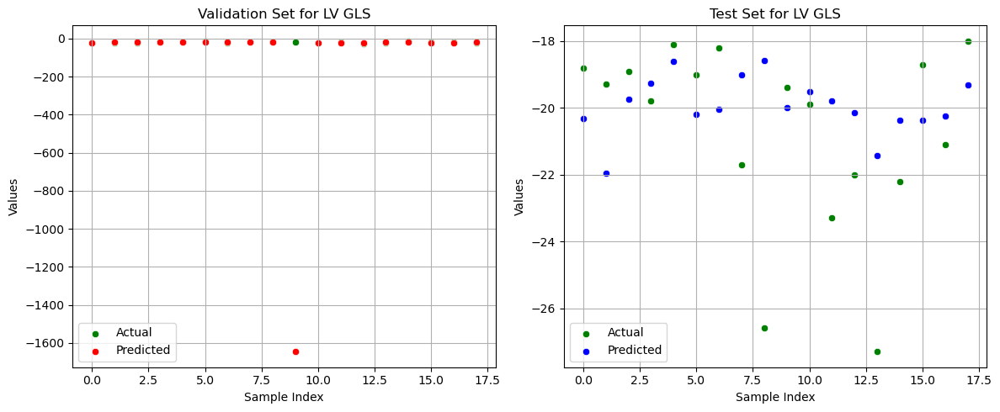

Best parameters: {}
MAE (Val): 92.8868, MAPE (Val): 474.31%
MAE (Test): 2.0940, MAPE (Test): 9.41%

Fold 3/5


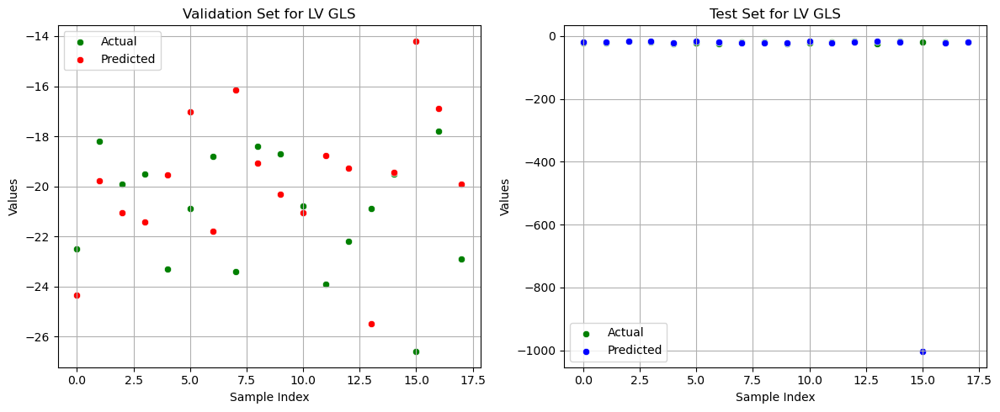

Best parameters: {}
MAE (Val): 3.1094, MAPE (Val): 13.86%
MAE (Test): 57.4573, MAPE (Test): 292.45%

Fold 4/5


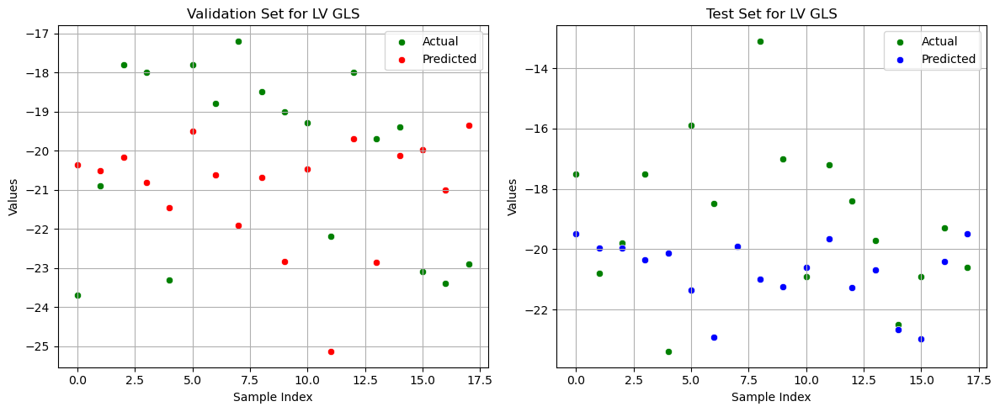

Best parameters: {}
MAE (Val): 2.4310, MAPE (Val): 12.17%
MAE (Test): 2.3485, MAPE (Test): 13.80%

Fold 5/5


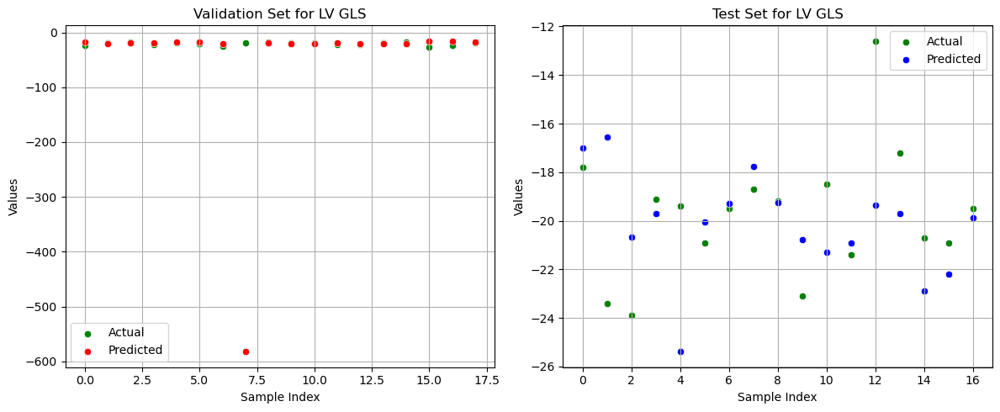

Best parameters: {}
MAE (Val): 34.3309, MAPE (Val): 173.53%
MAE (Test): 2.2476, MAPE (Test): 12.11%

Średnie wyniki dla walidacji:
MAE: 37.8609, MAPE: 192.05%
Średnie wyniki dla testu:
MAE: 13.2776, MAPE: 67.66%
Trenowanie modelu dla kolumny LASr_ED z 5-krotną walidacją krzyżową
Fold 1/5


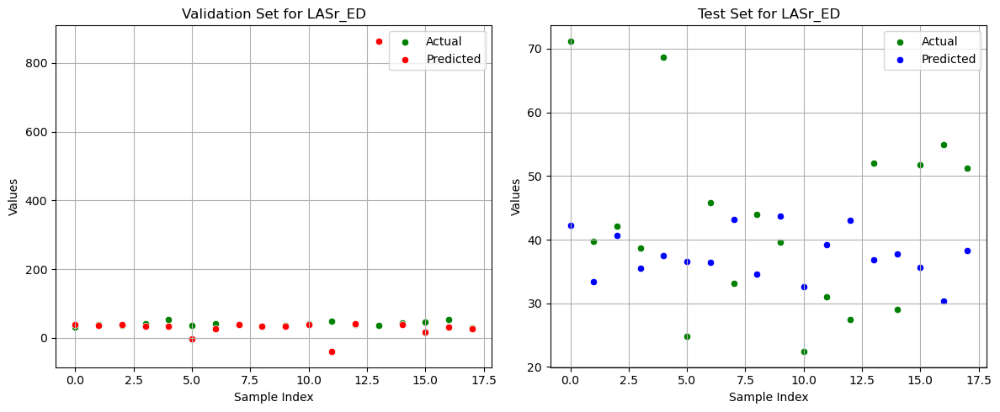

Best parameters: {}
MAE (Val): 59.9827, MAPE (Val): 154.29%
MAE (Test): 12.6130, MAPE (Test): 29.57%

Fold 2/5


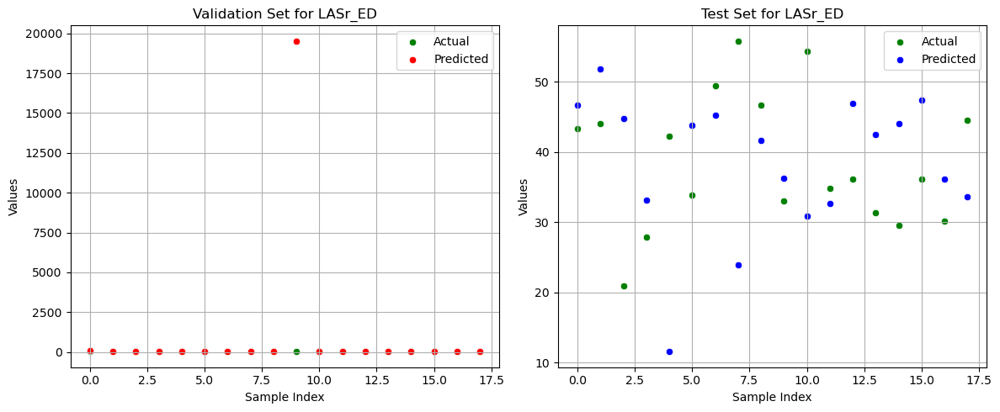

Best parameters: {}
MAE (Val): 1091.2652, MAPE (Val): 2912.28%
MAE (Test): 11.9521, MAPE (Test): 32.51%

Fold 3/5


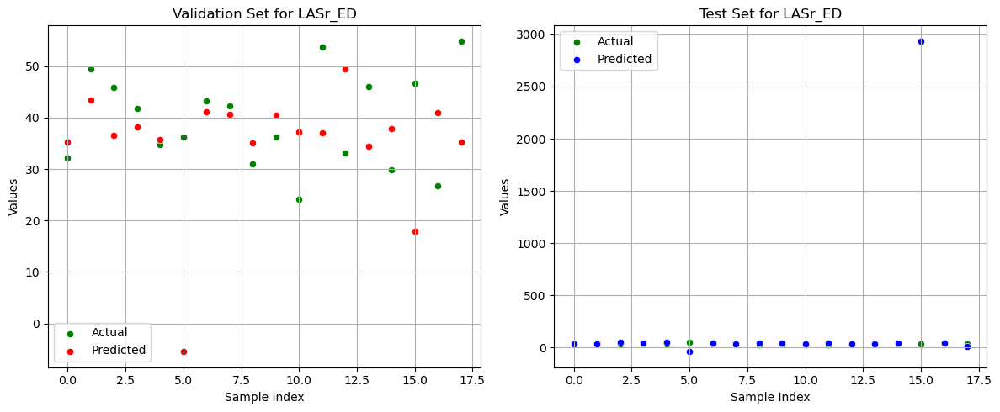

Best parameters: {}
MAE (Val): 11.4238, MAPE (Val): 30.07%
MAE (Test): 172.9881, MAPE (Test): 461.14%

Fold 4/5


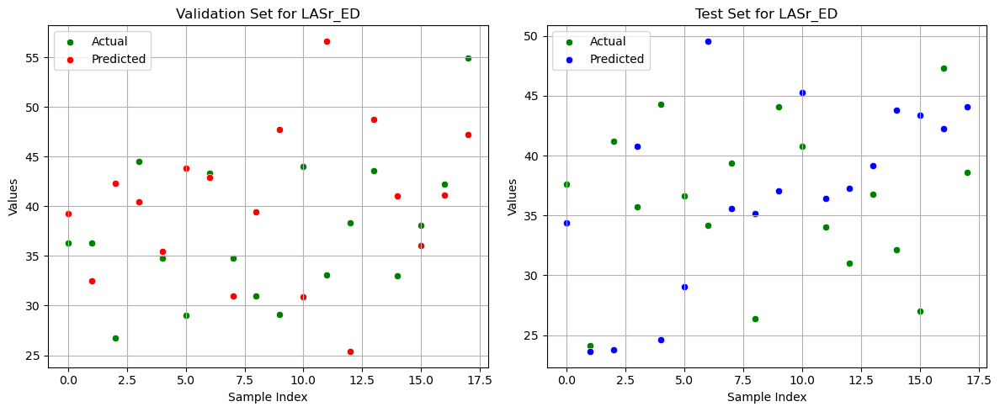

Best parameters: {}
MAE (Val): 8.1581, MAPE (Val): 24.19%
MAE (Test): 7.9214, MAPE (Test): 22.37%

Fold 5/5


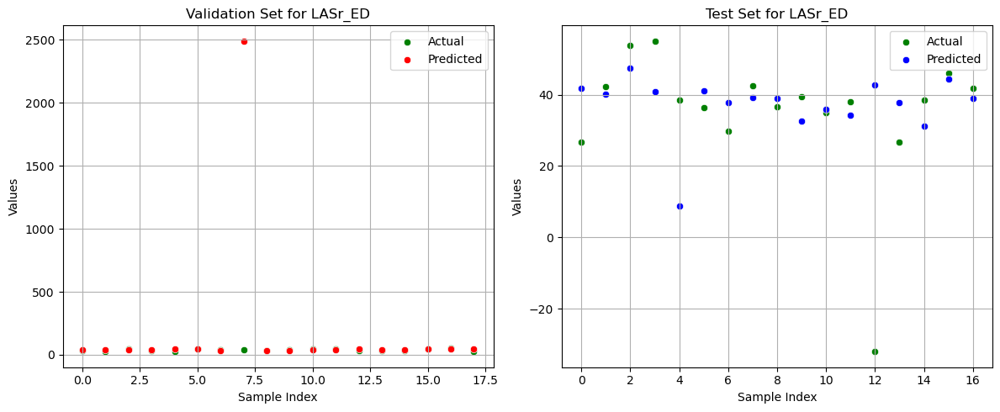

Best parameters: {}
MAE (Val): 141.7860, MAPE (Val): 380.50%
MAE (Test): 11.4401, MAPE (Test): 33.16%

Średnie wyniki dla walidacji:
MAE: 262.5231, MAPE: 700.27%
Średnie wyniki dla testu:
MAE: 43.3829, MAPE: 115.75%
Trenowanie modelu dla kolumny LAScd_ED z 5-krotną walidacją krzyżową
Fold 1/5


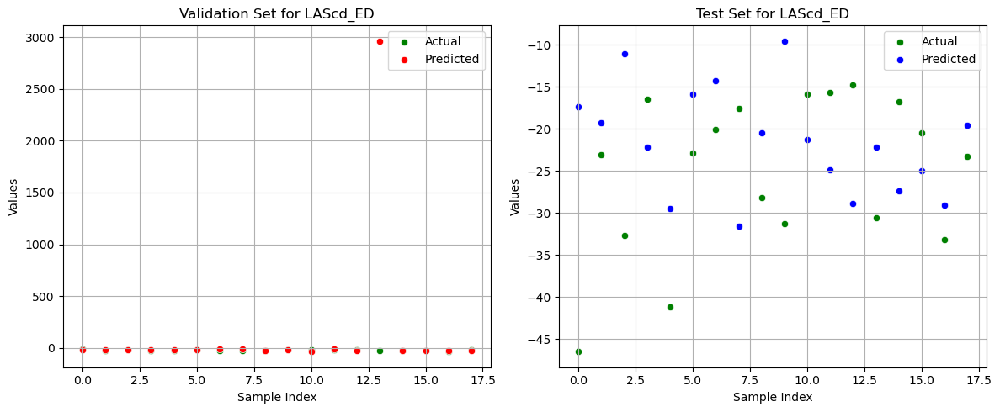

Best parameters: {}
MAE (Val): 172.3286, MAPE (Val): 686.91%
MAE (Test): 10.4463, MAPE (Test): 42.84%

Fold 2/5


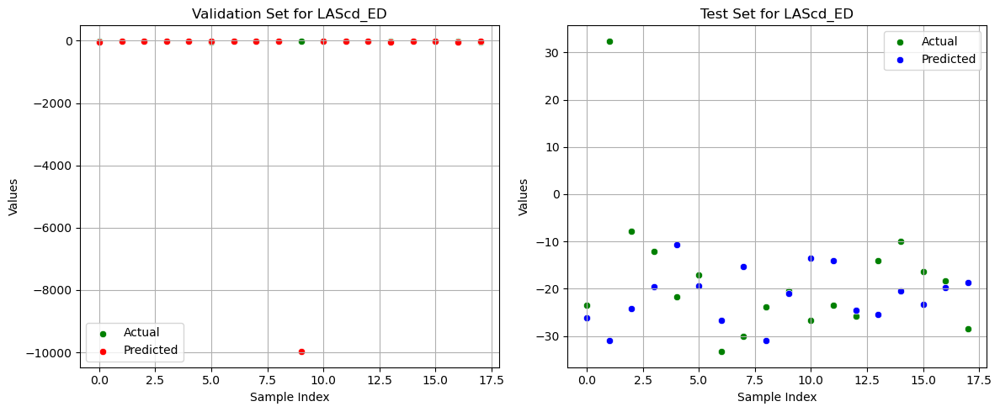

Best parameters: {}
MAE (Val): 561.3919, MAPE (Val): 2243.60%
MAE (Test): 10.8733, MAPE (Test): 56.03%

Fold 3/5


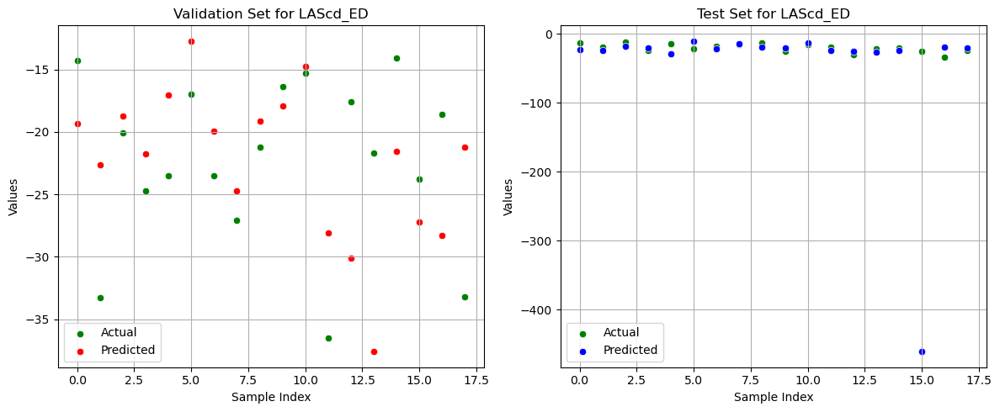

Best parameters: {}
MAE (Val): 6.1146, MAPE (Val): 28.17%
MAE (Test): 29.8949, MAPE (Test): 126.79%

Fold 4/5


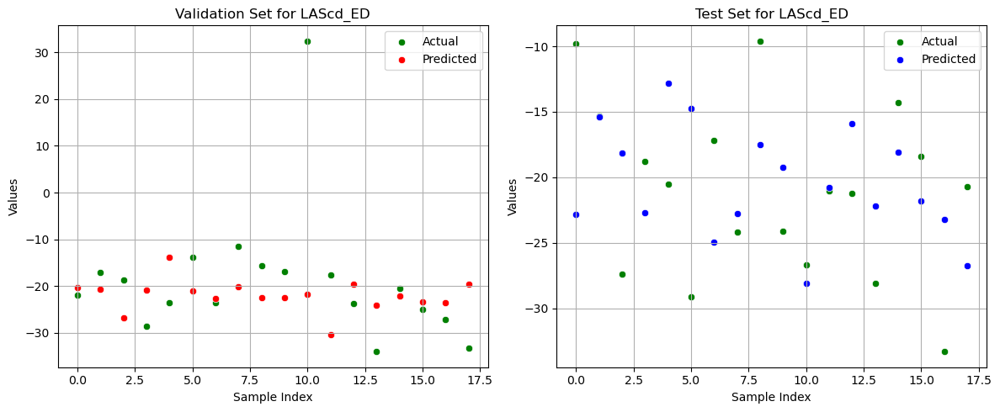

Best parameters: {}
MAE (Val): 8.9558, MAPE (Val): 39.06%
MAE (Test): 5.9144, MAPE (Test): 32.50%

Fold 5/5


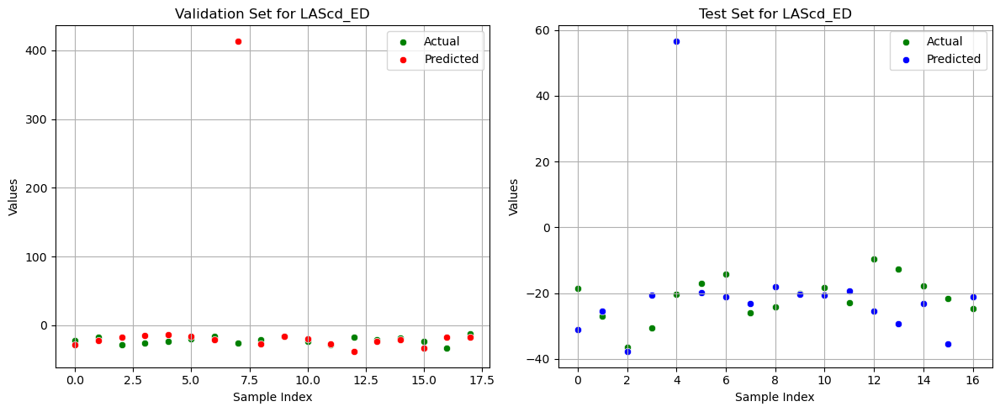

Best parameters: {}
MAE (Val): 31.1918, MAPE (Val): 128.28%
MAE (Test): 10.6760, MAPE (Test): 59.76%

Średnie wyniki dla walidacji:
MAE: 155.9966, MAPE: 625.21%
Średnie wyniki dla testu:
MAE: 13.5610, MAPE: 63.58%
Trenowanie modelu dla kolumny LASct_ED z 5-krotną walidacją krzyżową
Fold 1/5


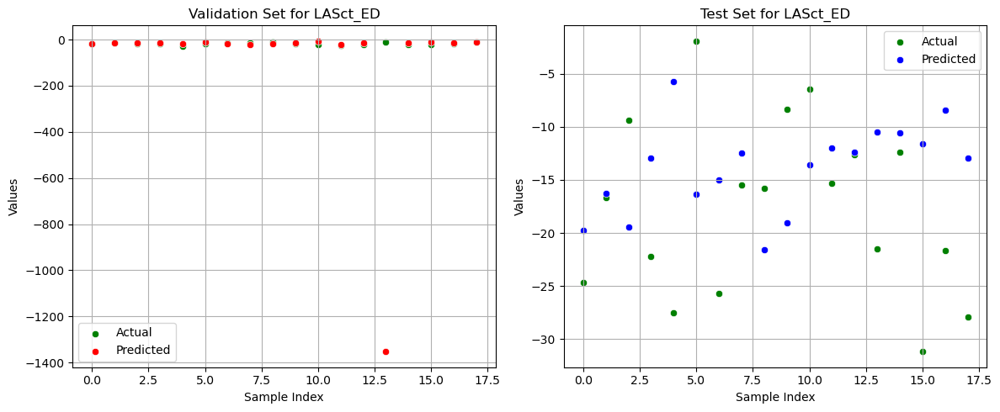

Best parameters: {}
MAE (Val): 79.6672, MAPE (Val): 632.33%
MAE (Test): 9.0296, MAPE (Test): 89.87%

Fold 2/5


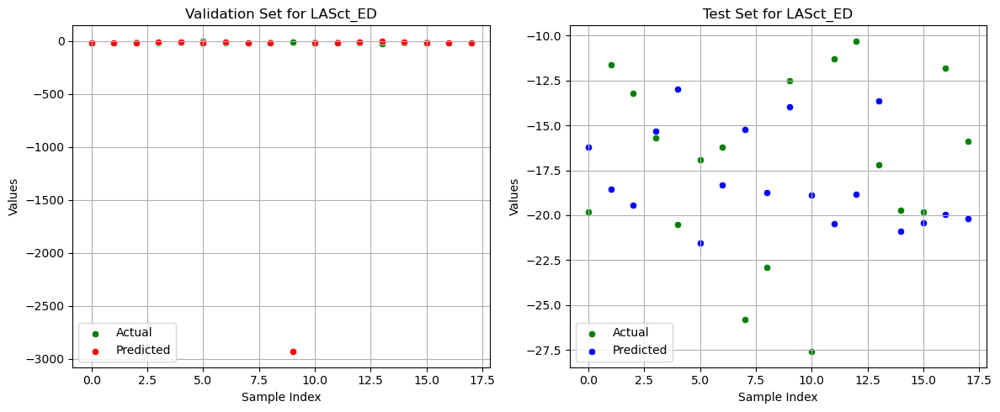

Best parameters: {}
MAE (Val): 167.5414, MAPE (Val): 1354.93%
MAE (Test): 5.1039, MAPE (Test): 33.18%

Fold 3/5


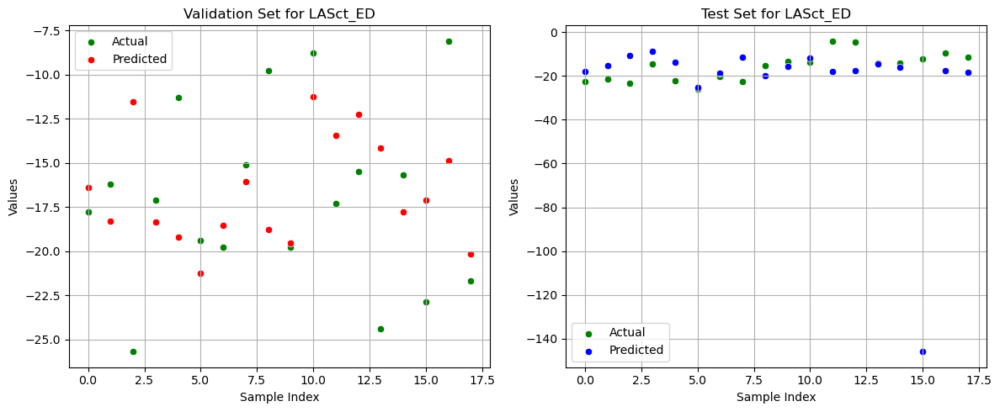

Best parameters: {}
MAE (Val): 4.2330, MAPE (Val): 28.40%
MAE (Test): 13.1835, MAPE (Test): 120.01%

Fold 4/5


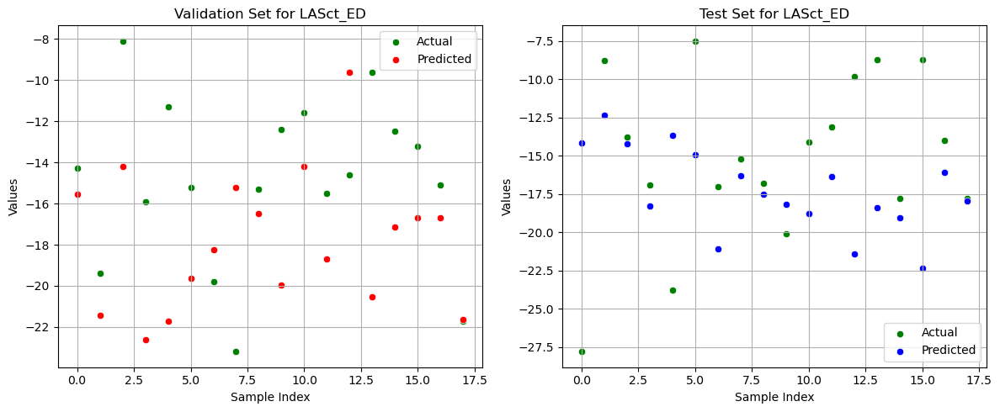

Best parameters: {}
MAE (Val): 4.4864, MAPE (Val): 35.26%
MAE (Test): 5.0450, MAPE (Test): 41.96%

Fold 5/5


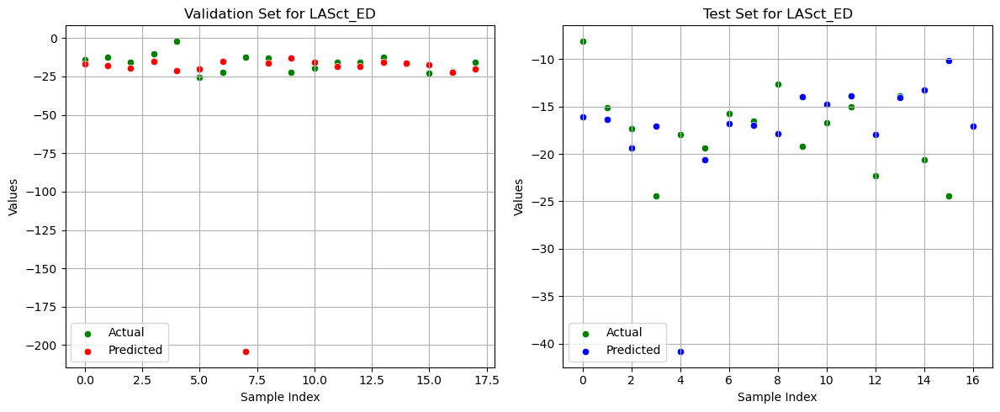

Best parameters: {}
MAE (Val): 15.3745, MAPE (Val): 164.22%
MAE (Test): 4.9372, MAPE (Test): 29.11%

Średnie wyniki dla walidacji:
MAE: 54.2605, MAPE: 443.03%
Średnie wyniki dla testu:
MAE: 7.4598, MAPE: 62.83%
Trenowanie modelu dla kolumny LASr_AC z 5-krotną walidacją krzyżową
Fold 1/5


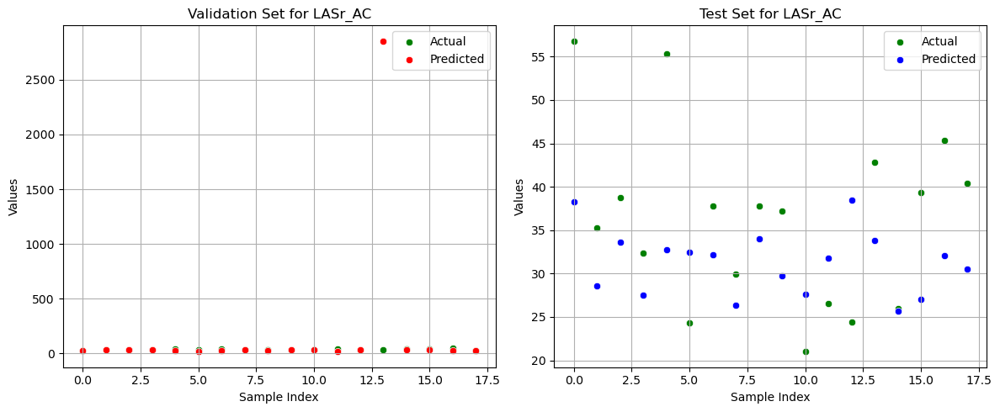

Best parameters: {}
MAE (Val): 162.9063, MAPE (Val): 490.37%
MAE (Test): 8.7302, MAPE (Test): 23.76%

Fold 2/5


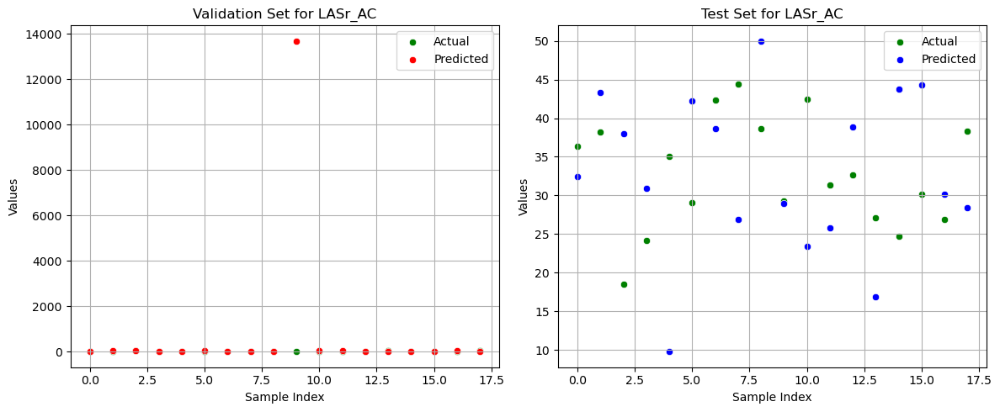

Best parameters: {}
MAE (Val): 768.2043, MAPE (Val): 2322.63%
MAE (Test): 10.7755, MAPE (Test): 35.25%

Fold 3/5


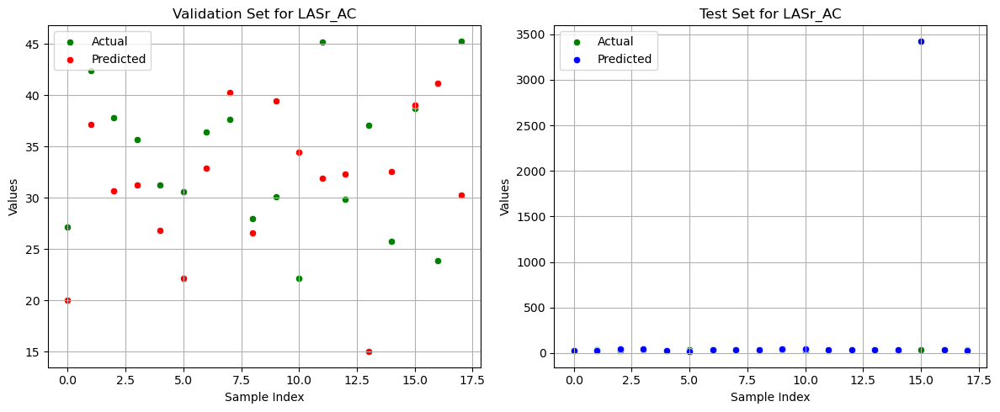

Best parameters: {}
MAE (Val): 7.9460, MAPE (Val): 24.93%
MAE (Test): 195.0200, MAPE (Test): 590.88%

Fold 4/5


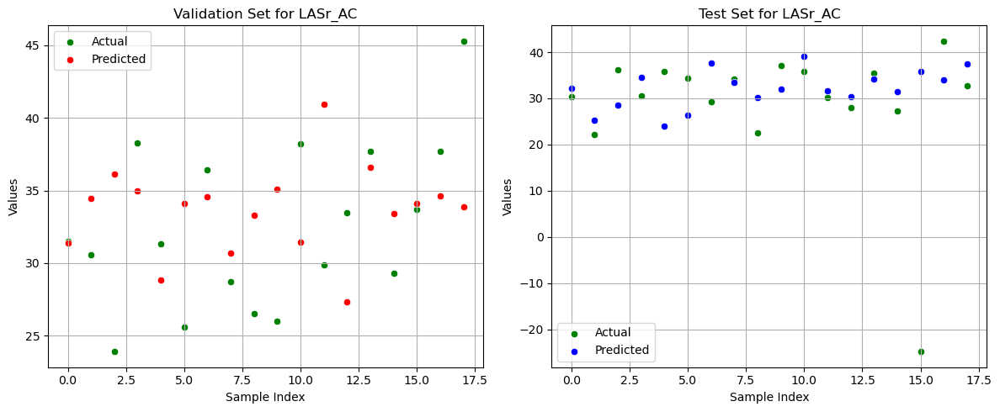

Best parameters: {}
MAE (Val): 5.2350, MAPE (Val): 17.27%
MAE (Test): 8.0557, MAPE (Test): 28.35%

Fold 5/5


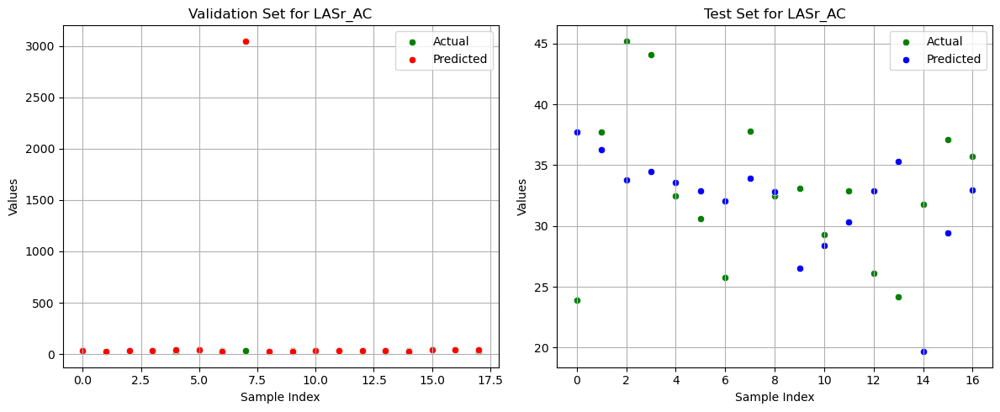

Best parameters: {}
MAE (Val): 172.1948, MAPE (Val): 522.09%
MAE (Test): 5.9124, MAPE (Test): 19.06%

Średnie wyniki dla walidacji:
MAE: 223.2973, MAPE: 675.46%
Średnie wyniki dla testu:
MAE: 45.6988, MAPE: 139.46%
Trenowanie modelu dla kolumny LAScd_AC z 5-krotną walidacją krzyżową
Fold 1/5


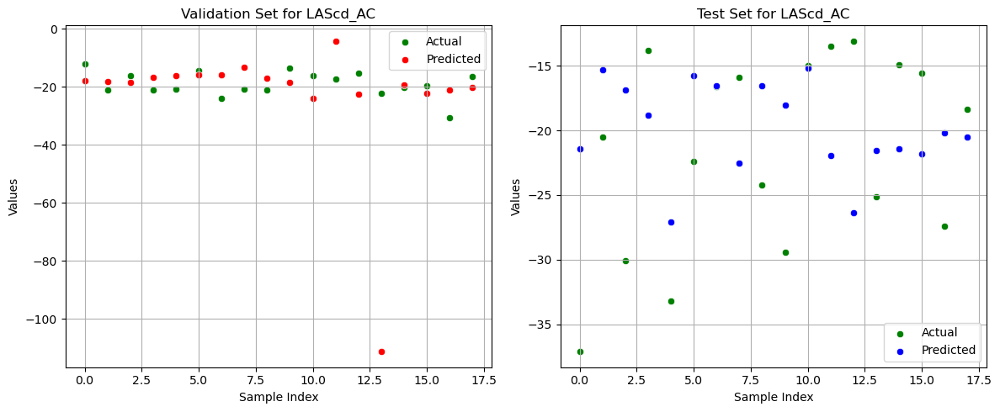

Best parameters: {}
MAE (Val): 10.0442, MAPE (Val): 49.92%
MAE (Test): 6.9411, MAPE (Test): 33.79%

Fold 2/5


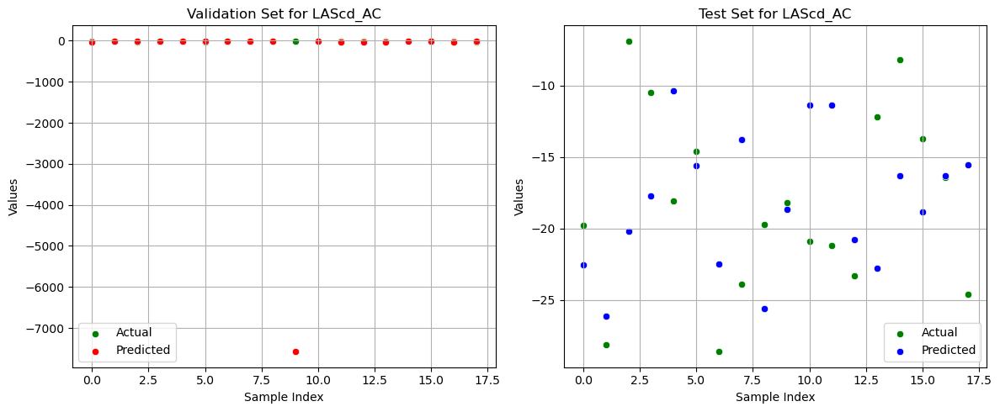

Best parameters: {}
MAE (Val): 427.3786, MAPE (Val): 1934.64%
MAE (Test): 6.1793, MAPE (Test): 43.91%

Fold 3/5


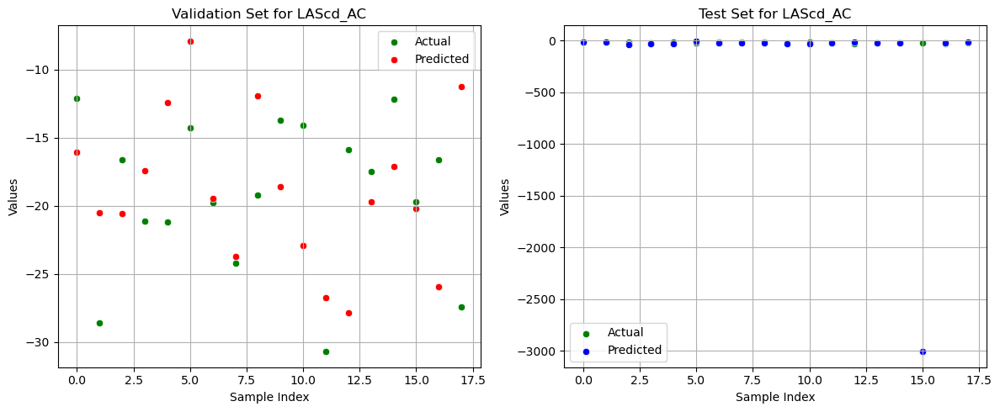

Best parameters: {}
MAE (Val): 5.8745, MAPE (Val): 32.63%
MAE (Test): 174.3002, MAPE (Test): 801.65%

Fold 4/5


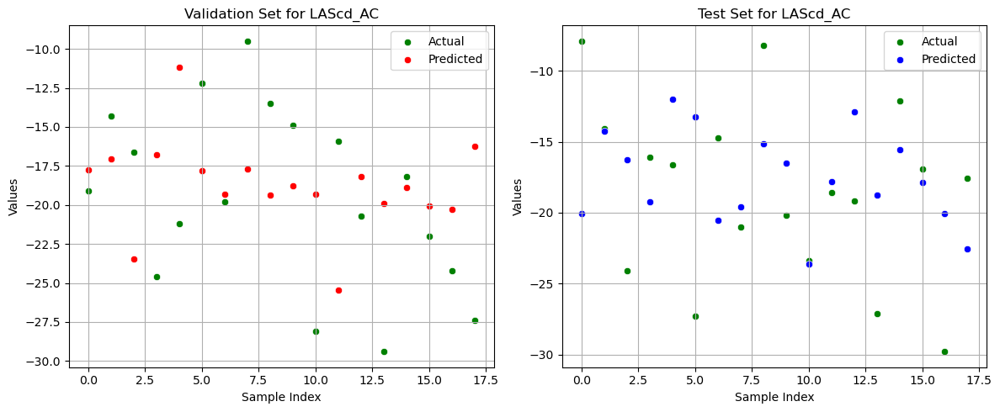

Best parameters: {}
MAE (Val): 5.6019, MAPE (Val): 30.87%
MAE (Test): 5.2533, MAPE (Test): 33.32%

Fold 5/5


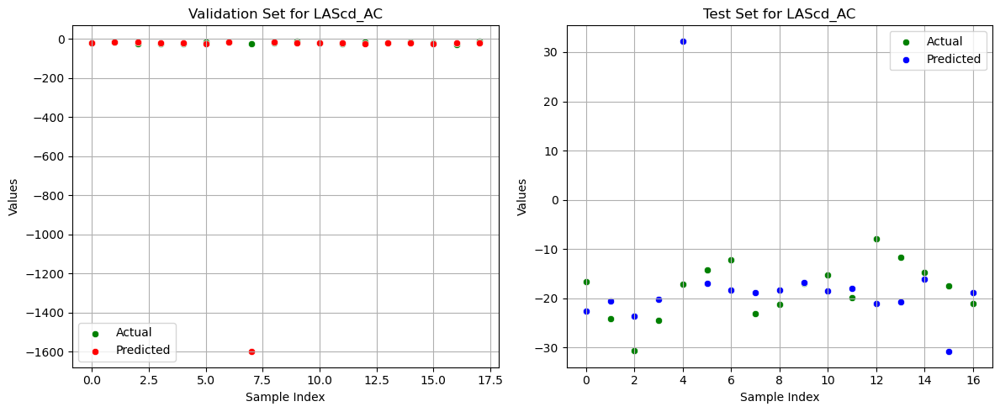

Best parameters: {}
MAE (Val): 91.7631, MAPE (Val): 417.77%
MAE (Test): 7.6968, MAPE (Test): 50.19%

Średnie wyniki dla walidacji:
MAE: 108.1325, MAPE: 493.17%
Średnie wyniki dla testu:
MAE: 40.0741, MAPE: 192.57%
Trenowanie modelu dla kolumny LASct_AC z 5-krotną walidacją krzyżową
Fold 1/5


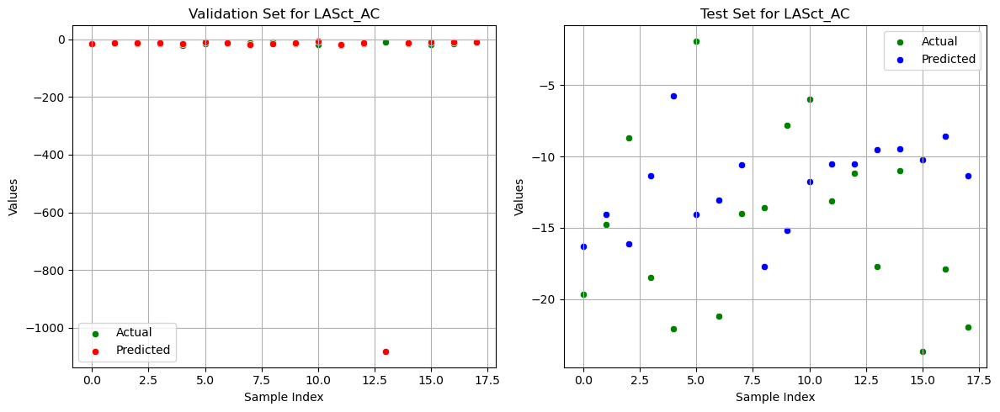

Best parameters: {}
MAE (Val): 63.3374, MAPE (Val): 569.71%
MAE (Test): 6.7980, MAPE (Test): 76.99%

Fold 2/5


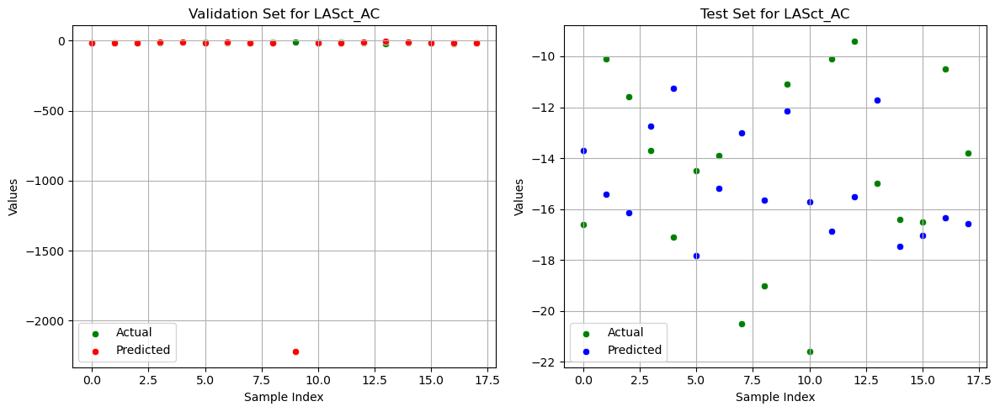

Best parameters: {}
MAE (Val): 126.8200, MAPE (Val): 1158.01%
MAE (Test): 3.7962, MAPE (Test): 28.50%

Fold 3/5


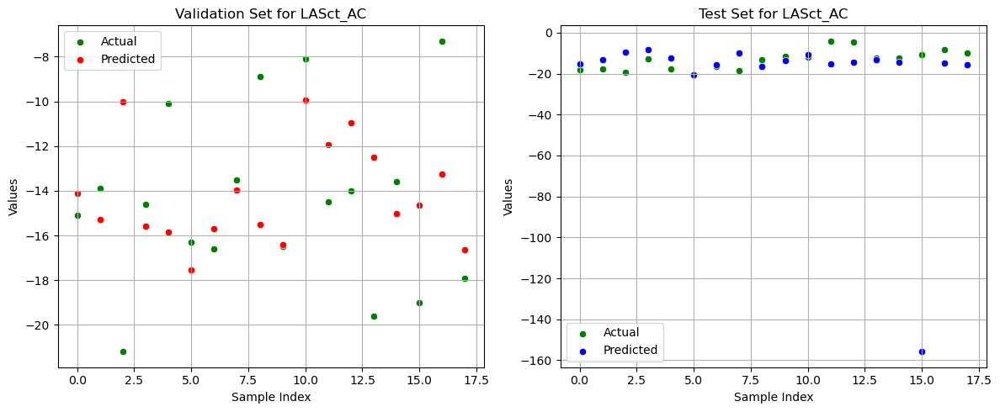

Best parameters: {}
MAE (Val): 3.1752, MAPE (Val): 24.70%
MAE (Test): 12.4247, MAPE (Test): 124.33%

Fold 4/5


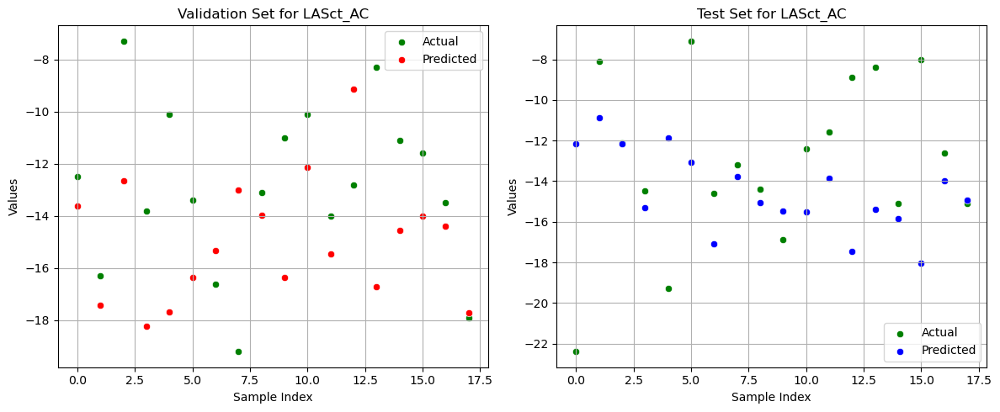

Best parameters: {}
MAE (Val): 3.2662, MAPE (Val): 29.66%
MAE (Test): 3.6468, MAPE (Test): 33.84%

Fold 5/5


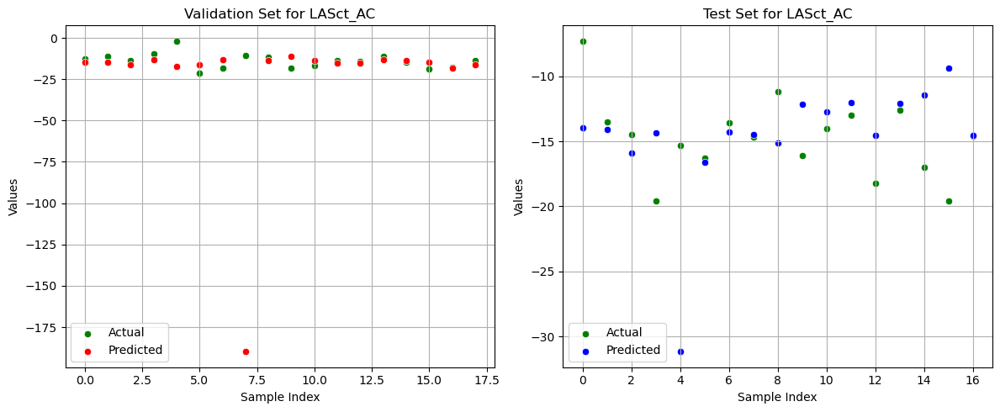

Best parameters: {}
MAE (Val): 13.4253, MAPE (Val): 153.68%
MAE (Test): 3.5900, MAPE (Test): 25.23%

Średnie wyniki dla walidacji:
MAE: 42.0048, MAPE: 387.16%
Średnie wyniki dla testu:
MAE: 6.0511, MAPE: 57.78%
Trenowanie modelu dla kolumny RVFWSL z 5-krotną walidacją krzyżową
Fold 1/5


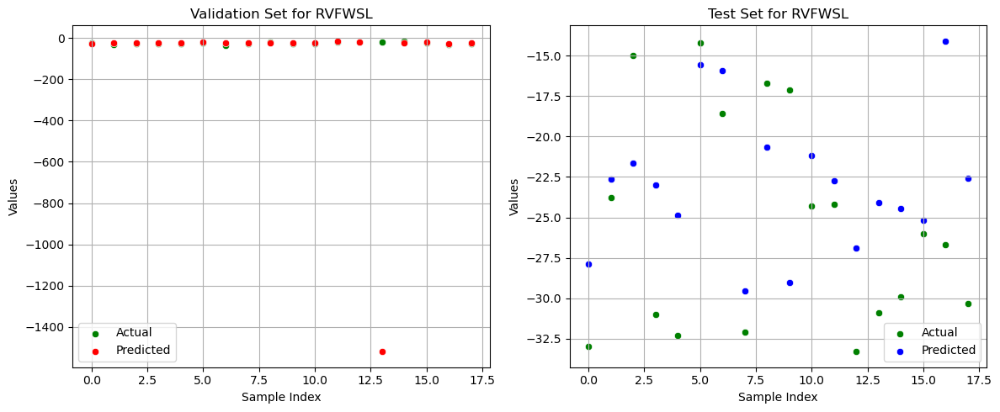

Best parameters: {}
MAE (Val): 88.2226, MAPE (Val): 498.16%
MAE (Test): 5.2928, MAPE (Test): 21.84%

Fold 2/5


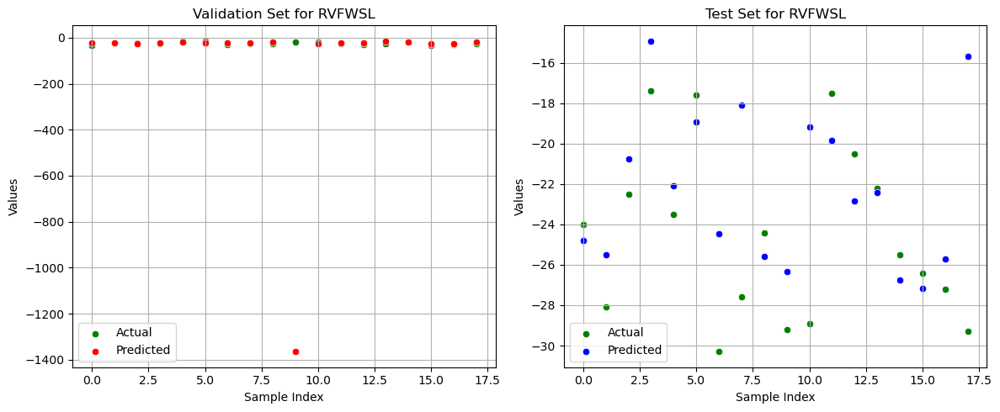

Best parameters: {}
MAE (Val): 80.0372, MAPE (Val): 450.64%
MAE (Test): 3.4152, MAPE (Test): 13.09%

Fold 3/5


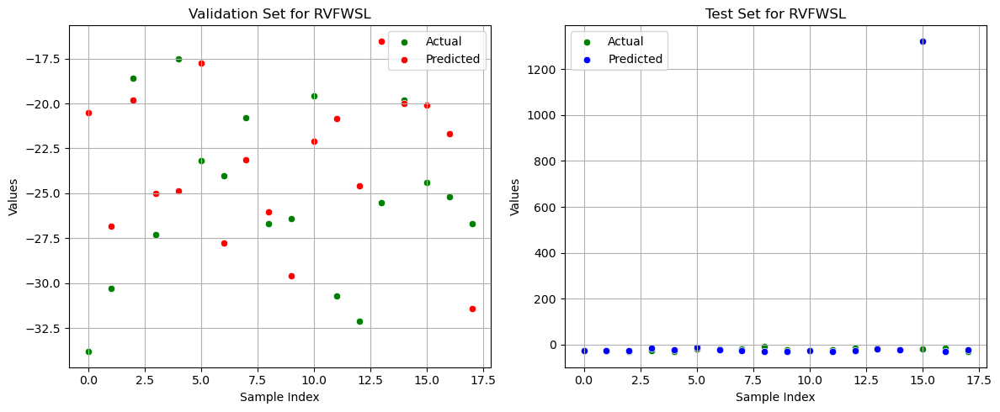

Best parameters: {}
MAE (Val): 4.7003, MAPE (Val): 18.14%
MAE (Test): 80.4250, MAPE (Test): 463.05%

Fold 4/5


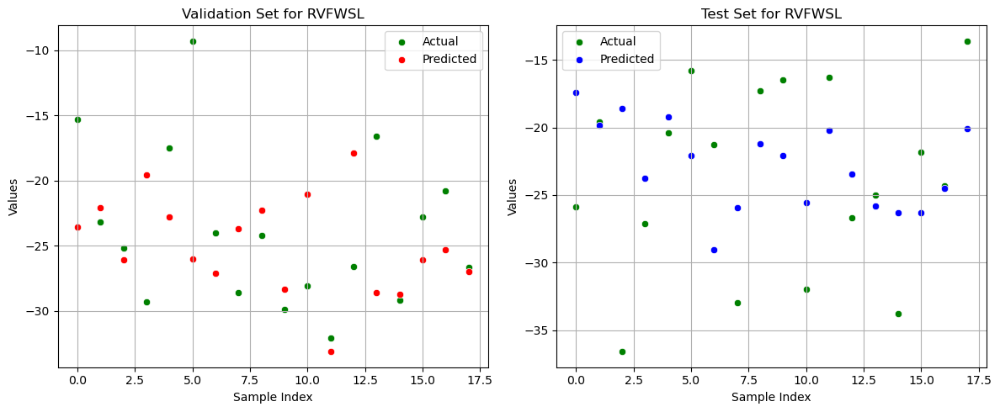

Best parameters: {}
MAE (Val): 5.0402, MAPE (Val): 28.92%
MAE (Test): 5.2684, MAPE (Test): 22.54%

Fold 5/5


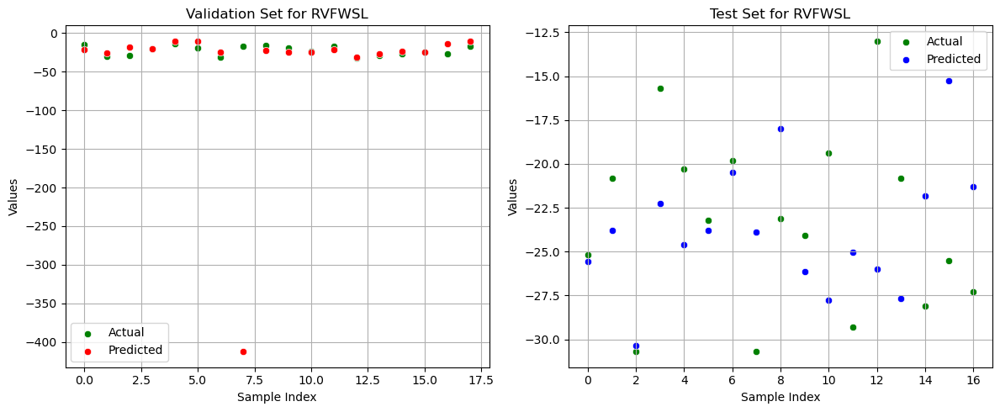

Best parameters: {}
MAE (Val): 26.5927, MAPE (Val): 147.98%
MAE (Test): 4.9901, MAPE (Test): 24.35%

Średnie wyniki dla walidacji:
MAE: 40.9186, MAPE: 228.77%
Średnie wyniki dla testu:
MAE: 19.8783, MAPE: 108.97%
Trenowanie modelu dla kolumny RV4CSL z 5-krotną walidacją krzyżową
Fold 1/5


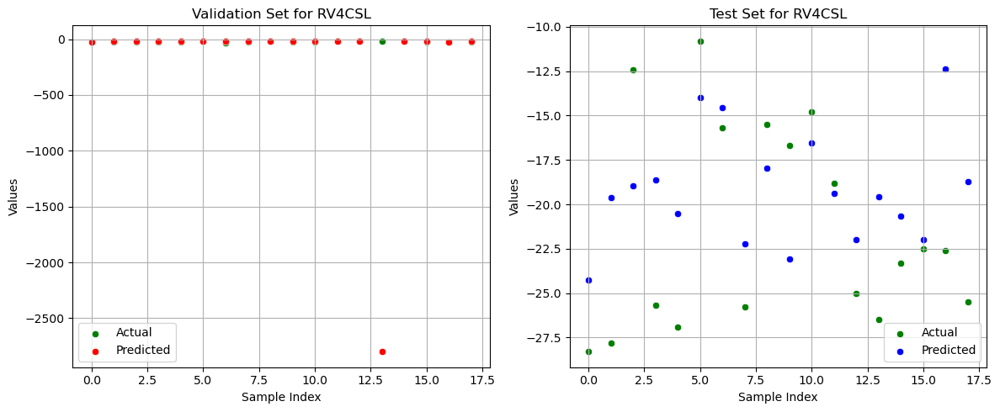

Best parameters: {}
MAE (Val): 158.1969, MAPE (Val): 929.64%
MAE (Test): 4.5280, MAPE (Test): 21.75%

Fold 2/5


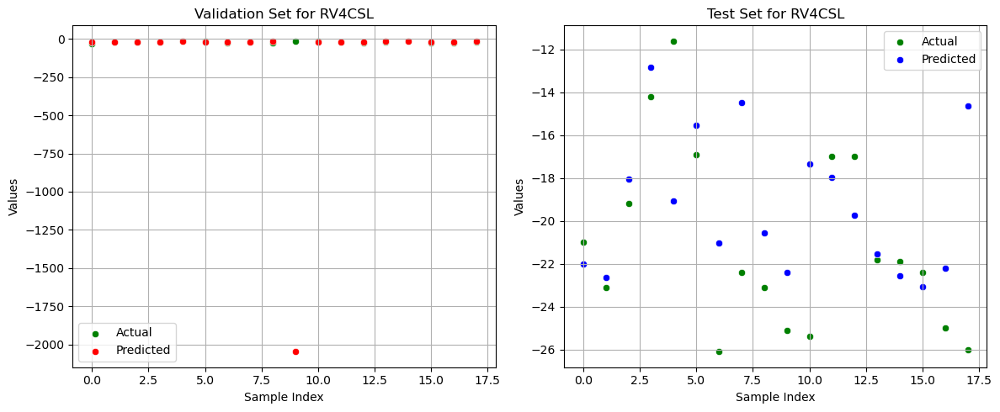

Best parameters: {}
MAE (Val): 116.2024, MAPE (Val): 682.82%
MAE (Test): 3.2589, MAPE (Test): 15.97%

Fold 3/5


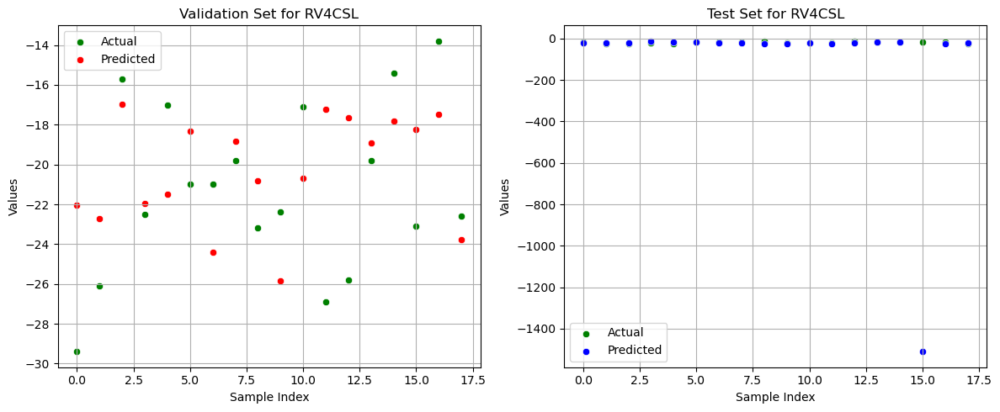

Best parameters: {}
MAE (Val): 3.5739, MAPE (Val): 16.44%
MAE (Test): 87.0356, MAPE (Test): 514.56%

Fold 4/5


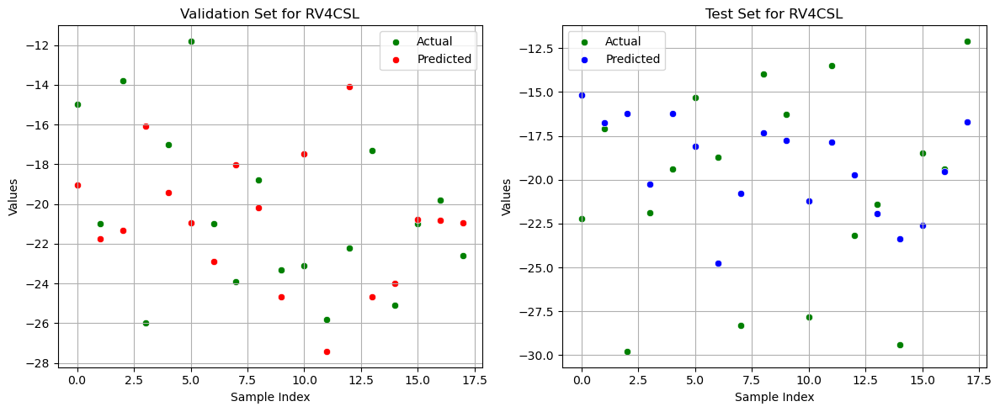

Best parameters: {}
MAE (Val): 3.9503, MAPE (Val): 21.65%
MAE (Test): 4.2669, MAPE (Test): 20.45%

Fold 5/5


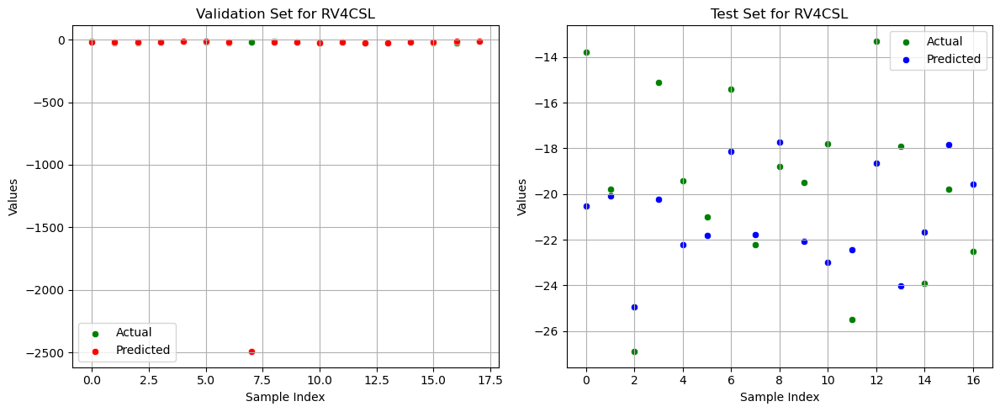

Best parameters: {}
MAE (Val): 140.6579, MAPE (Val): 830.06%
MAE (Test): 3.0212, MAPE (Test): 17.42%

Średnie wyniki dla walidacji:
MAE: 84.5163, MAPE: 496.12%
Średnie wyniki dla testu:
MAE: 20.4221, MAPE: 118.03%


In [35]:
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Funkcja do obliczenia MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs(y_true - y_pred) / np.abs(y_true)) * 100

# Funkcja oceny modelu regresji z użyciem MAE
def evaluate_regression_model(X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y_col):
    # Przeprowadzamy GridSearchCV w celu znalezienia najlepszych parametrów
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)
    
    # Używamy najlepszego modelu z GridSearchCV
    best_model = grid_search.best_estimator_
    
    # Ocena modelu na zbiorze treningowym
    y_train_pred = best_model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_train_pred)  # MAE dla treningu
    r2_train = r2_score(y_train, y_train_pred)

    # Ocena modelu na zbiorze walidacyjnym
    y_val_pred = best_model.predict(X_val)
    mae_val = mean_absolute_error(y_val, y_val_pred)  # MAE dla walidacji
    mape_val = mean_absolute_percentage_error(y_val, y_val_pred)
    r2_val = r2_score(y_val, y_val_pred)

    # Ocena modelu na zbiorze testowym
    y_test_pred = best_model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_test_pred)  # MAE dla testu
    mape_test = mean_absolute_percentage_error(y_test, y_test_pred)
    r2_test = r2_score(y_test, y_test_pred)

    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_val)), y=y_val_pred, color='red', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Validation Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.subplot(1, 2, 2)
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test, color='green', label='Actual')
    sns.scatterplot(x=np.arange(len(y_test)), y=y_test_pred, color='blue', label='Predicted')
    plt.xlabel('Sample Index')
    plt.ylabel('Values')
    plt.title(f'Test Set for {y_col}')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    plt.show()
    
    return grid_search.best_params_, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test

# Cross-validation z 5-krotnym podziałem dla regresji
def cross_validate_regression(X, y, model, param_grid, cv=5):
    X = X.values  # Konwersja do tablicy NumPy
    kf = KFold(n_splits=cv, shuffle=True, random_state=43)
    
    scaler = MinMaxScaler()
    X_scaled = scaler.fit_transform(X)  # Skalowanie całego zbioru przed podziałem
    
    fold = 1
    val_results = []  # Lista do przechowywania wyników walidacyjnych
    test_results = []  # Lista do przechowywania wyników testowych
    
    for train_idx, test_idx in kf.split(X_scaled):
        print(f"Fold {fold}/{cv}")
        X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
        
        # Dalszy podział zbioru treningowego na train/val (60/20)
        X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=43)  # 25% z 60% na walidację
        
        best_params, mae_train, r2_train, mae_val, r2_val, mae_test, r2_test, mape_val, mape_test = evaluate_regression_model(
            X_train, X_val, X_test, y_train, y_val, y_test, model, param_grid, y.name)
        
        val_results.append((mae_val, mape_val, r2_val))
        test_results.append((mae_test, mape_test, r2_test))
        
        print(f"Best parameters: {best_params}")
        print(f"MAE (Val): {mae_val:.4f}, MAPE (Val): {mape_val:.2f}%")
        print(f"MAE (Test): {mae_test:.4f}, MAPE (Test): {mape_test:.2f}%\n")
        
        fold += 1
    
    # Obliczanie średnich wartości dla walidacji i testu
    val_mae_mean = np.mean([result[0] for result in val_results])
    val_mape_mean = np.mean([result[1] for result in val_results])
    
    test_mae_mean = np.mean([result[0] for result in test_results])
    test_mape_mean = np.mean([result[1] for result in test_results])
    
    print("Średnie wyniki dla walidacji:")
    print(f"MAE: {val_mae_mean:.4f}, MAPE: {val_mape_mean:.2f}%")
    print("Średnie wyniki dla testu:")
    print(f"MAE: {test_mae_mean:.4f}, MAPE: {test_mape_mean:.2f}%")



param_grid = {
}

# Trenowanie modelu dla każdej kolumny z 5-krotną walidacją krzyżową
for y_col in y.columns:
    print(f"Trenowanie modelu dla kolumny {y_col} z 5-krotną walidacją krzyżową")
    model = LinearRegression()
    cross_validate_regression(X, y[y_col], model, param_grid, cv=5)



### MLP

Trenowanie modelu dla kolumny LV A2C
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.7613, MAPE: 37.00%
Test - MAE: 5.0665, MAPE: 21.47%



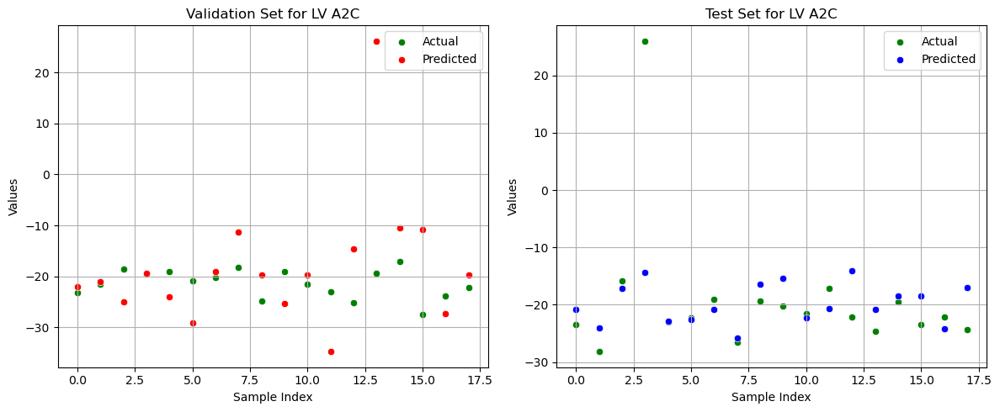

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.1261, MAPE: 44.31%
Test - MAE: 3.9713, MAPE: 19.04%



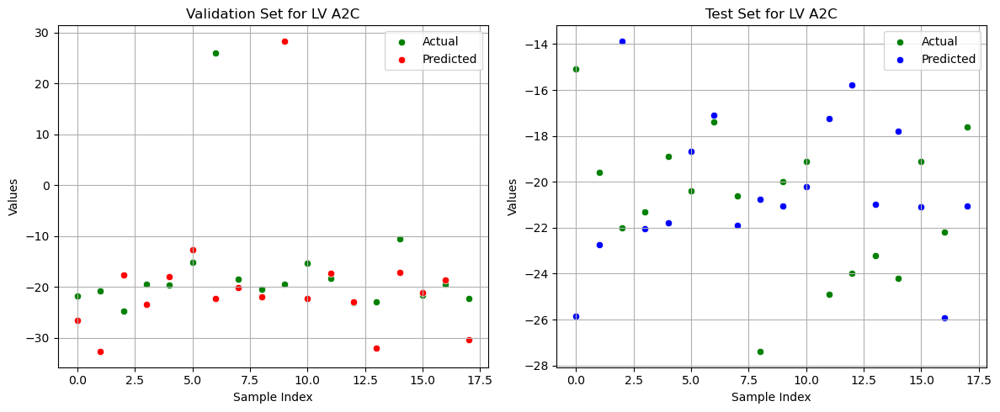

Fold 3/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.3945, MAPE: 44.64%
Test - MAE: 10.8468, MAPE: 51.74%



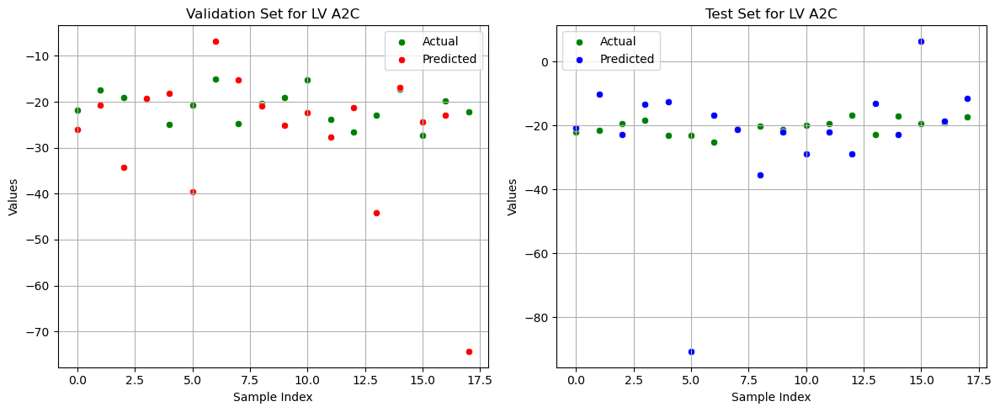

Fold 4/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.7161, MAPE: 38.19%
Test - MAE: 3.0746, MAPE: 17.27%



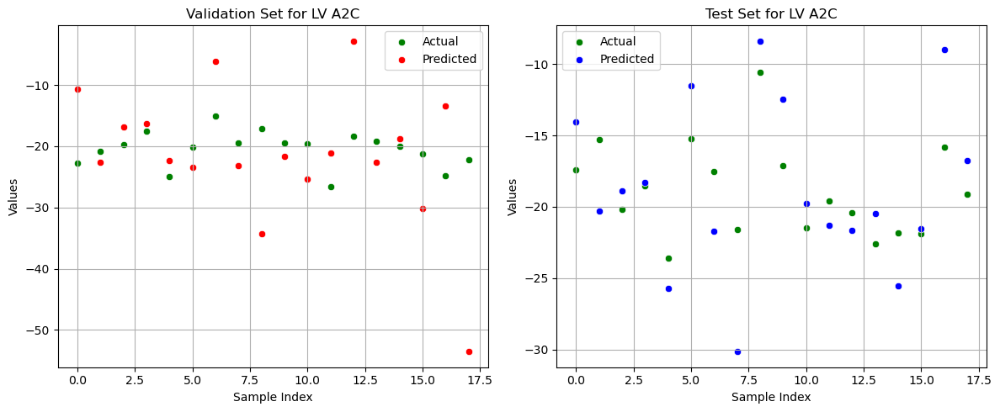

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 12.5363, MAPE: 56.70%
Test - MAE: 8.2628, MAPE: 43.55%



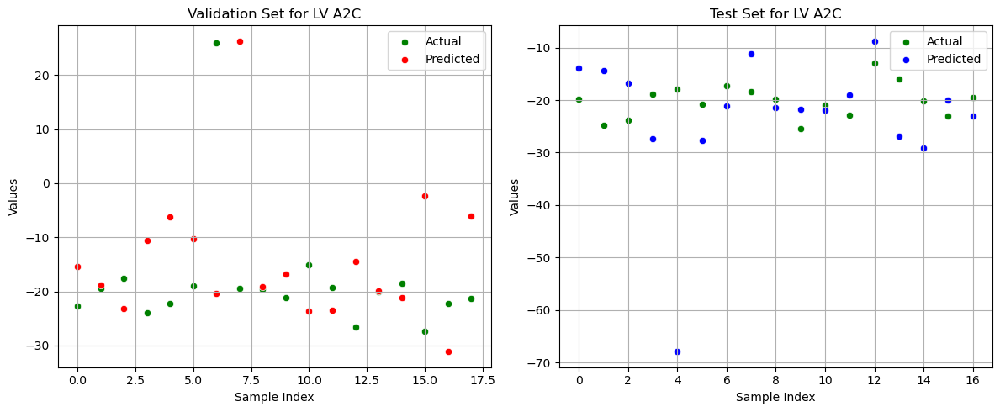

Średnie wyniki dla walidacji:
MAE: 9.3069, MAPE: 44.17%
Średnie wyniki dla testu:
MAE: 6.2444, MAPE: 30.62%
Trenowanie modelu dla kolumny LVA3C
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 6.5067, MAPE: 30.01%
Test - MAE: 3.0588, MAPE: 14.72%



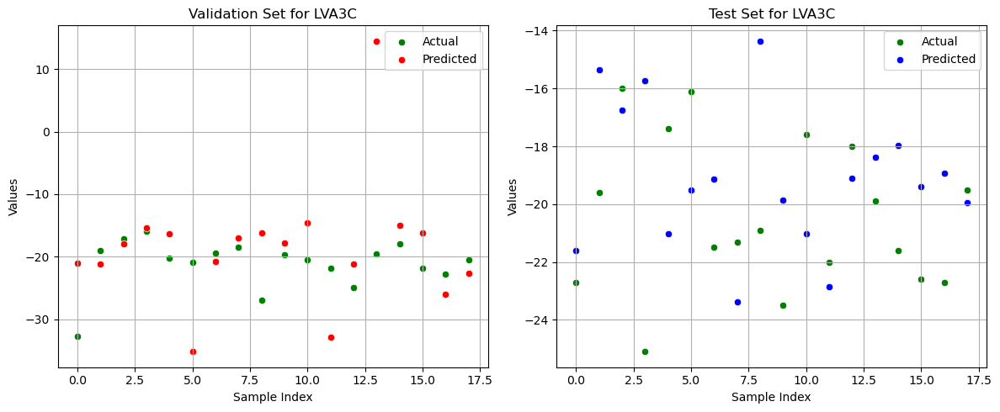

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 6.1777, MAPE: 31.50%
Test - MAE: 3.4401, MAPE: 15.86%



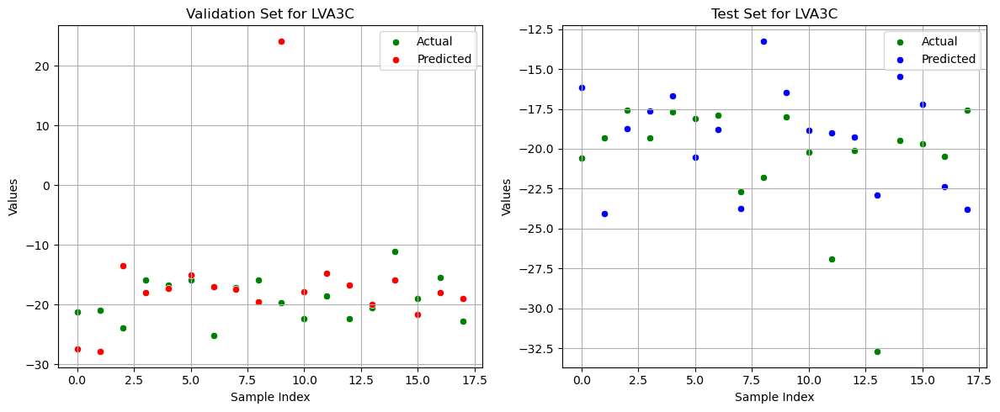

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.0522, MAPE: 24.86%
Test - MAE: 5.1829, MAPE: 27.44%



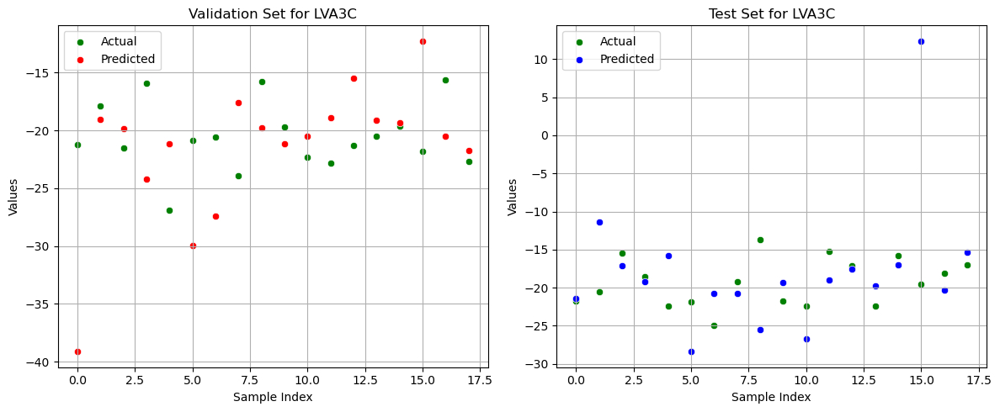

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 3.8050, MAPE: 18.94%
Test - MAE: 5.2357, MAPE: 31.56%



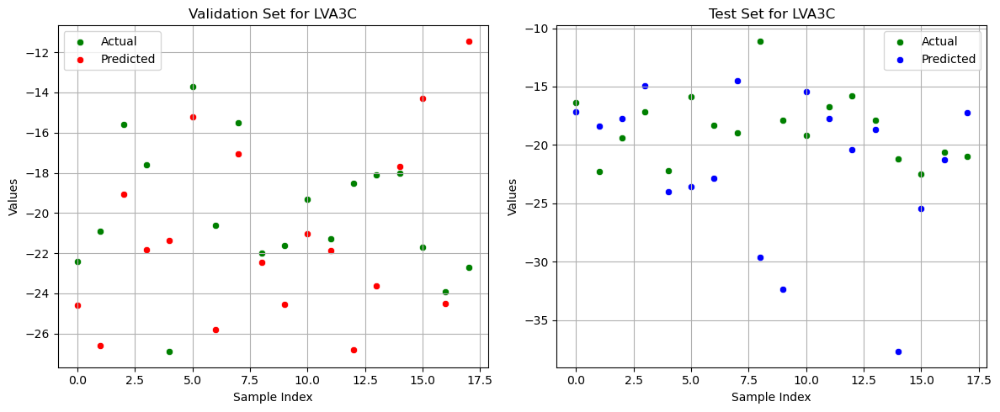

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.5347, MAPE: 37.56%
Test - MAE: 7.7899, MAPE: 43.55%



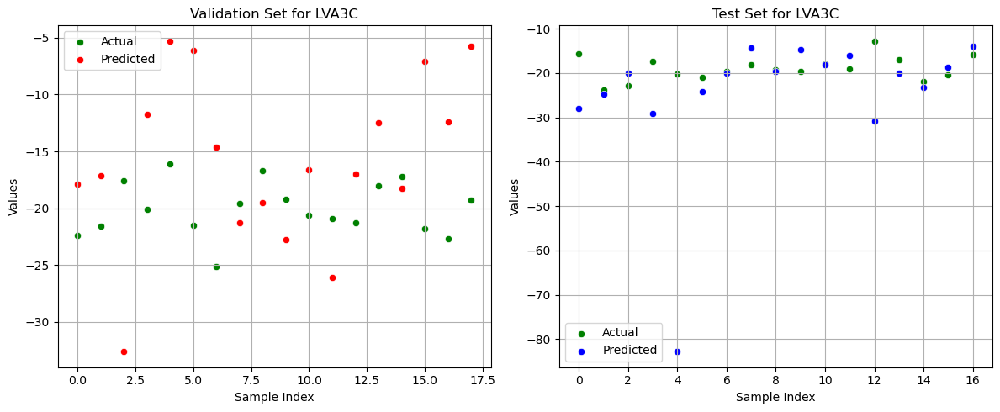

Średnie wyniki dla walidacji:
MAE: 5.8153, MAPE: 28.57%
Średnie wyniki dla testu:
MAE: 4.9415, MAPE: 26.63%
Trenowanie modelu dla kolumny LVA4C
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.4175, MAPE: 35.47%
Test - MAE: 4.5727, MAPE: 22.19%



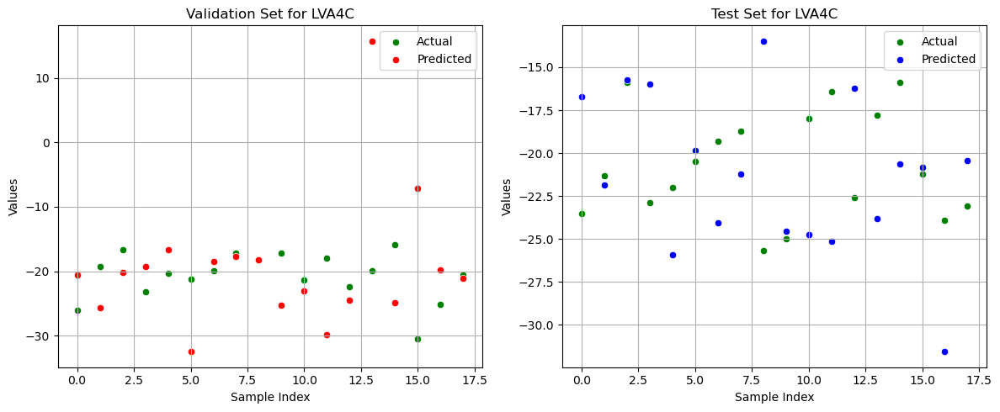

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.5736, MAPE: 26.26%
Test - MAE: 3.7358, MAPE: 19.52%



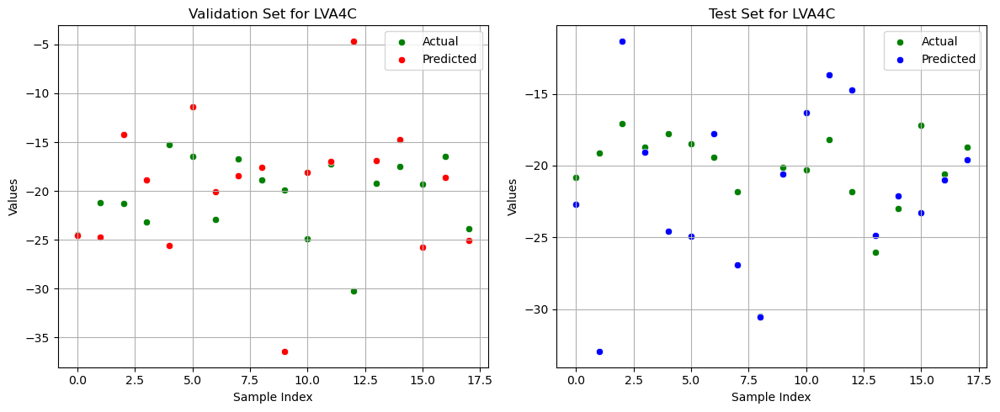

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 4.1951, MAPE: 20.09%
Test - MAE: 5.4951, MAPE: 28.65%



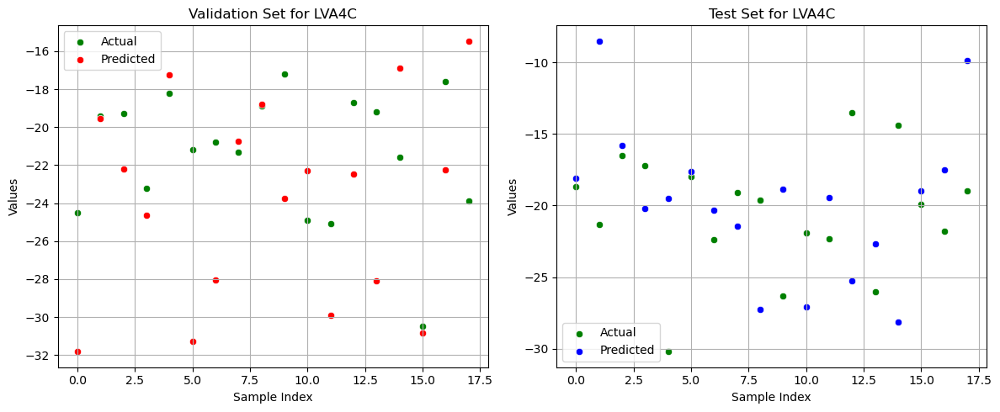

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.1771, MAPE: 26.00%
Test - MAE: 5.1652, MAPE: 27.88%



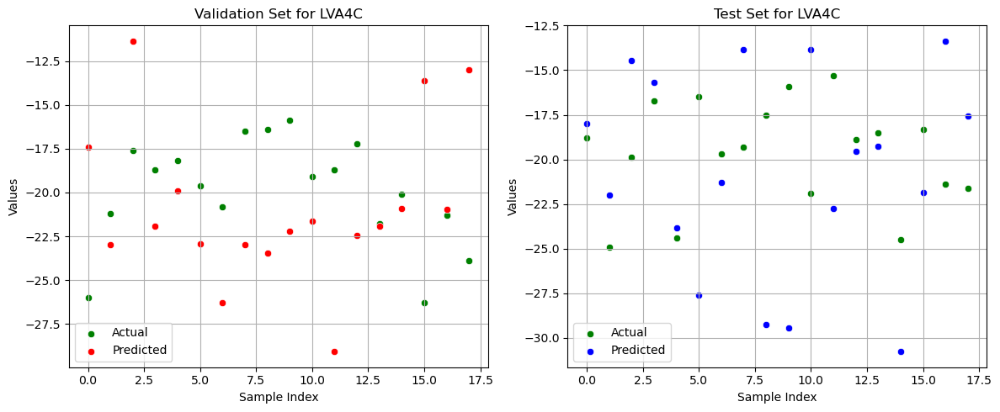

Fold 5/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.9726, MAPE: 27.59%
Test - MAE: 3.2856, MAPE: 17.69%



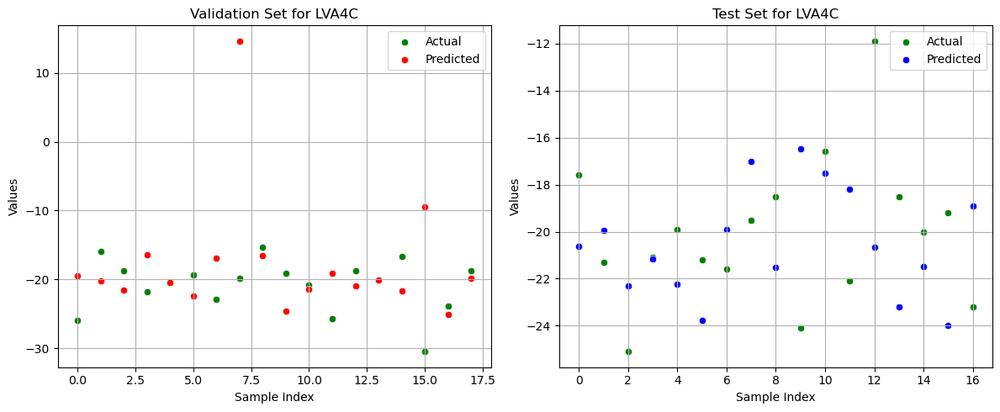

Średnie wyniki dla walidacji:
MAE: 5.6672, MAPE: 27.08%
Średnie wyniki dla testu:
MAE: 4.4509, MAPE: 23.18%
Trenowanie modelu dla kolumny LV GLS
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 6.0117, MAPE: 28.89%
Test - MAE: 3.2727, MAPE: 15.08%



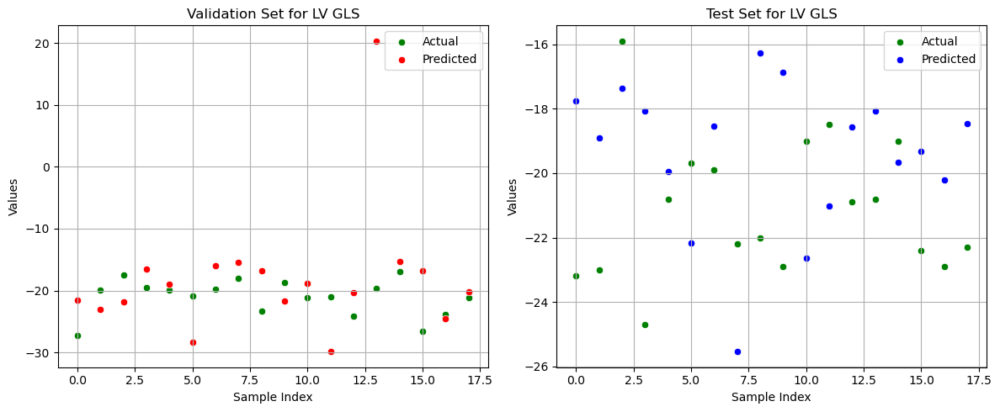

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.4641, MAPE: 27.95%
Test - MAE: 2.5279, MAPE: 12.31%



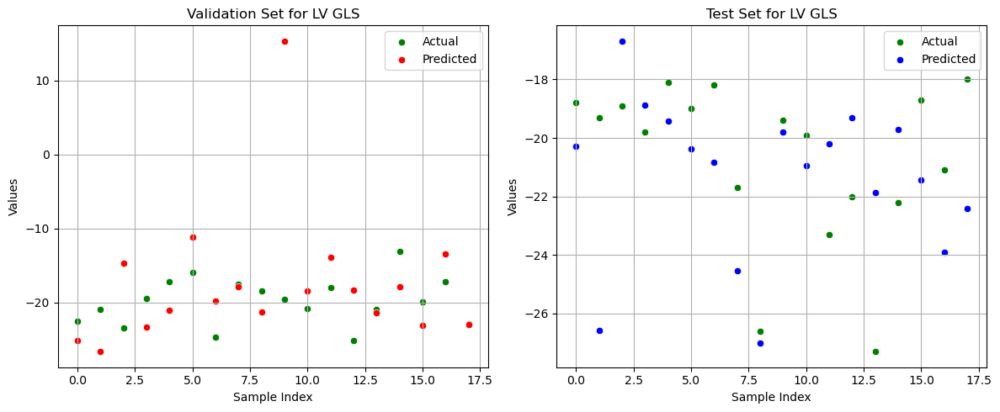

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 3.7274, MAPE: 18.04%
Test - MAE: 4.7813, MAPE: 23.43%



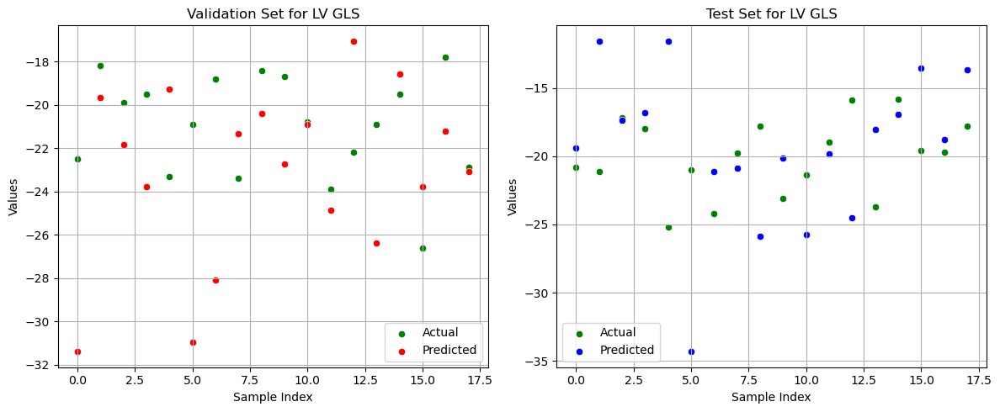

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 4.1318, MAPE: 21.11%
Test - MAE: 3.7515, MAPE: 21.65%



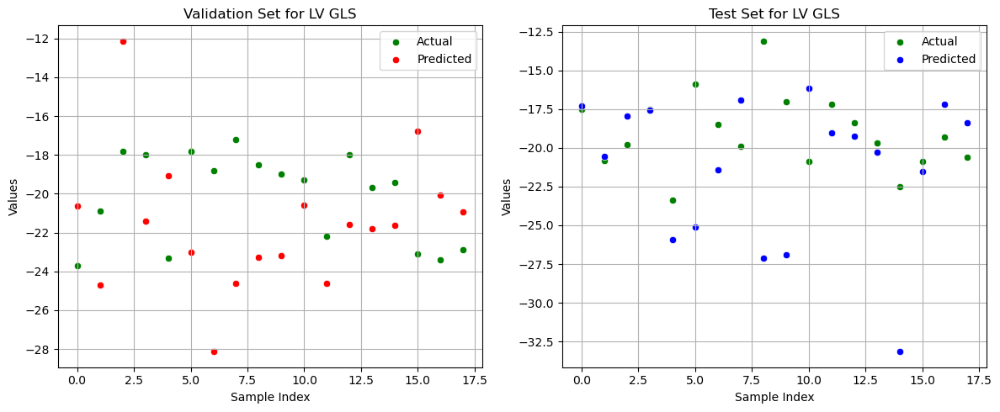

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 8.3717, MAPE: 39.97%
Test - MAE: 3.9764, MAPE: 21.17%



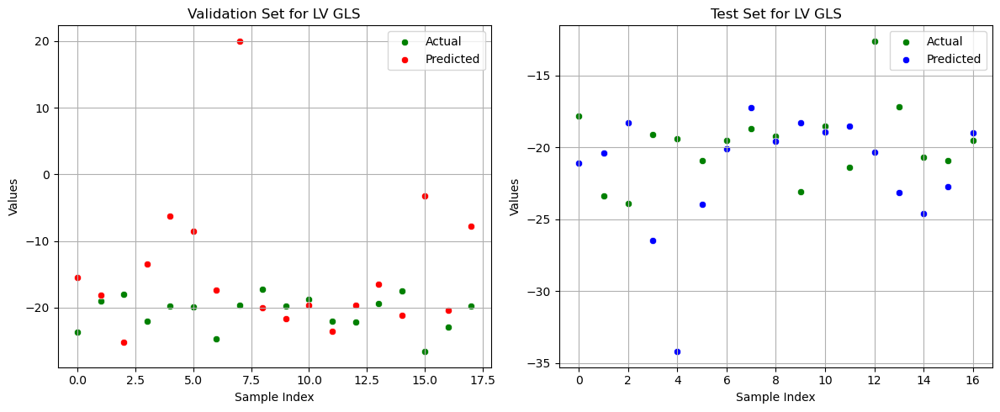

Średnie wyniki dla walidacji:
MAE: 5.5413, MAPE: 27.19%
Średnie wyniki dla testu:
MAE: 3.6620, MAPE: 18.73%
Trenowanie modelu dla kolumny LASr_ED
Fold 1/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 23.4162, MAPE: 57.95%
Test - MAE: 16.0762, MAPE: 39.19%



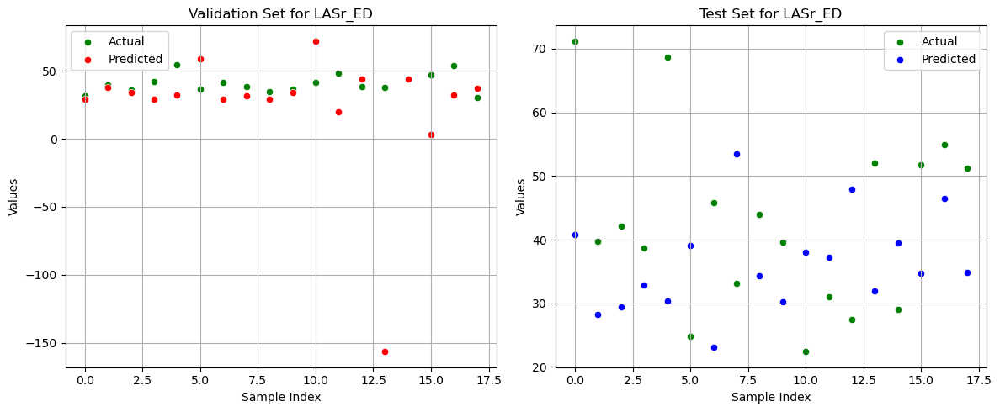

Fold 2/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 21.5991, MAPE: 58.60%
Test - MAE: 10.8407, MAPE: 32.21%



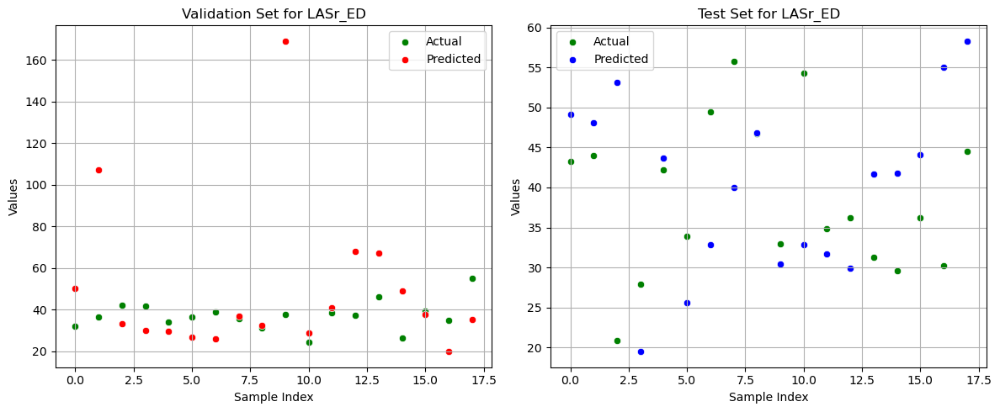

Fold 3/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 11.8111, MAPE: 30.93%
Test - MAE: 21.8168, MAPE: 62.11%



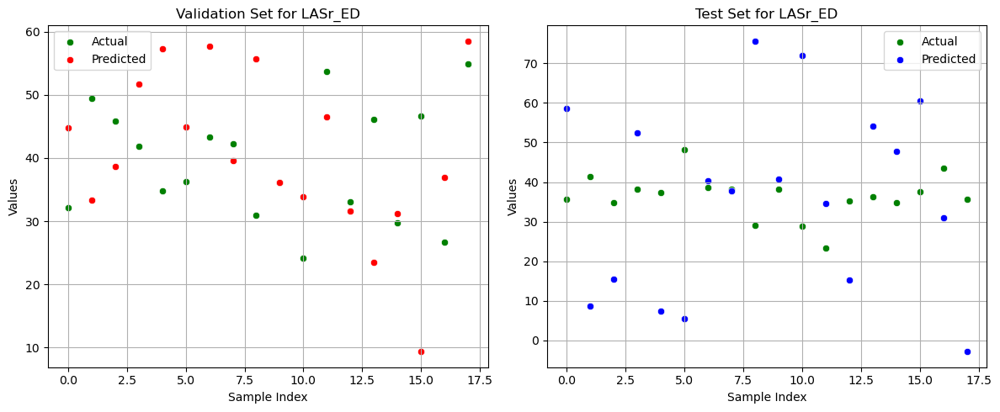

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 13.1090, MAPE: 35.28%
Test - MAE: 11.5489, MAPE: 33.18%



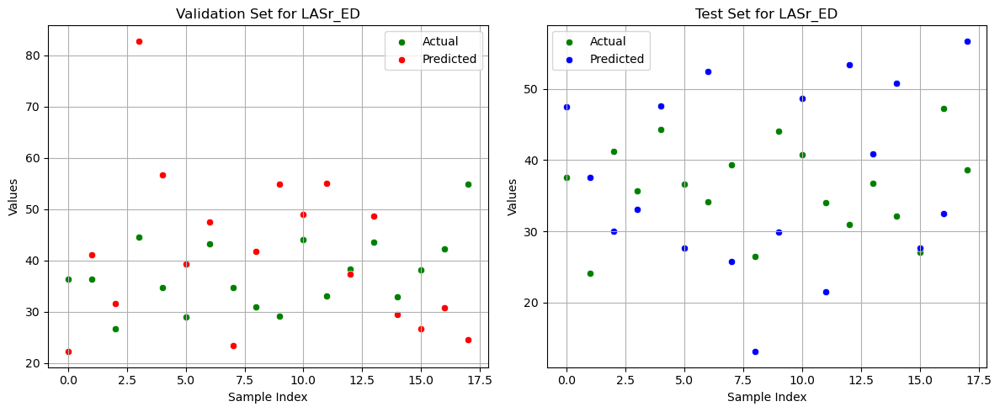

Fold 5/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 19.8940, MAPE: 57.93%
Test - MAE: 29.8968, MAPE: 82.11%



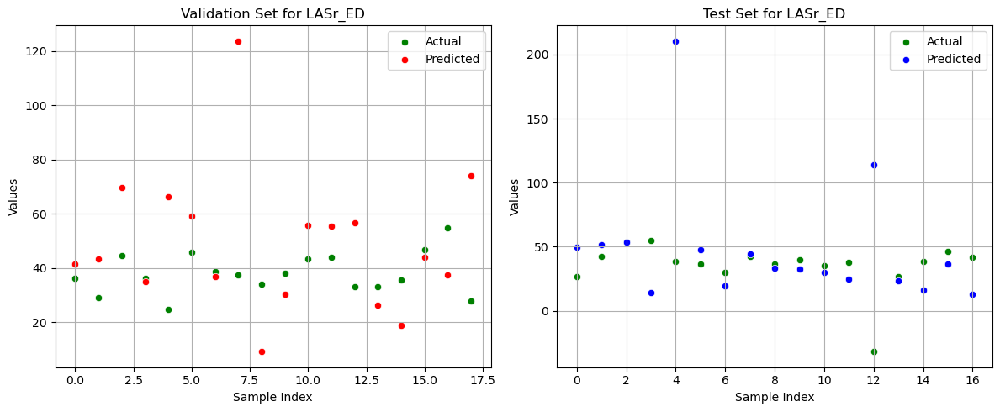

Średnie wyniki dla walidacji:
MAE: 17.9659, MAPE: 48.14%
Średnie wyniki dla testu:
MAE: 18.0359, MAPE: 49.76%
Trenowanie modelu dla kolumny LAScd_ED
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 37.5883, MAPE: 162.40%
Test - MAE: 11.9764, MAPE: 48.00%



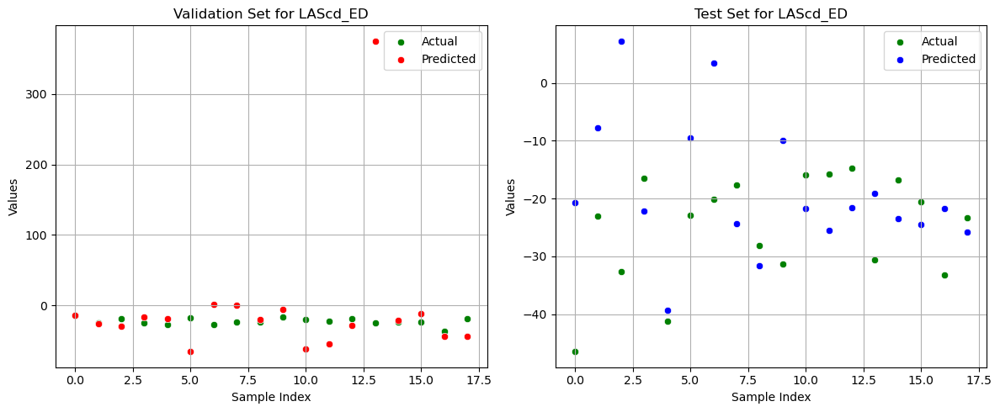

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 16.3606, MAPE: 80.55%
Test - MAE: 13.4276, MAPE: 81.35%



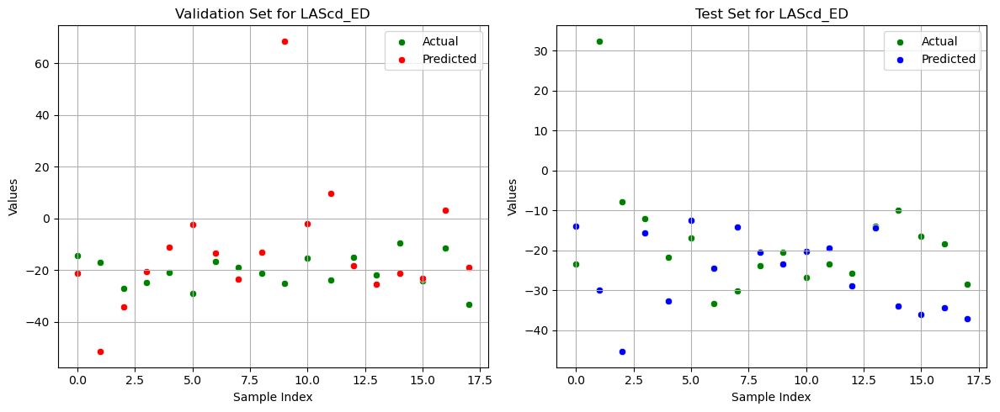

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.3417, MAPE: 45.00%
Test - MAE: 17.6024, MAPE: 91.77%



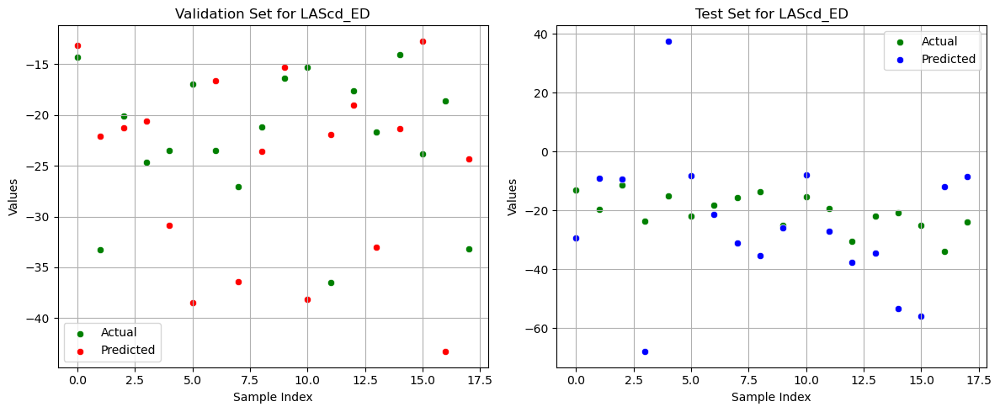

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.9301, MAPE: 44.15%
Test - MAE: 8.0867, MAPE: 43.31%



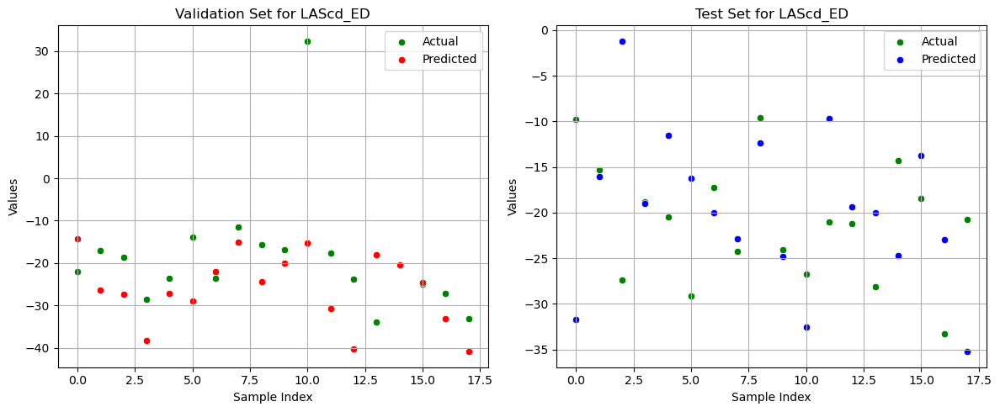

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 29.3091, MAPE: 149.28%
Test - MAE: 23.8188, MAPE: 147.04%



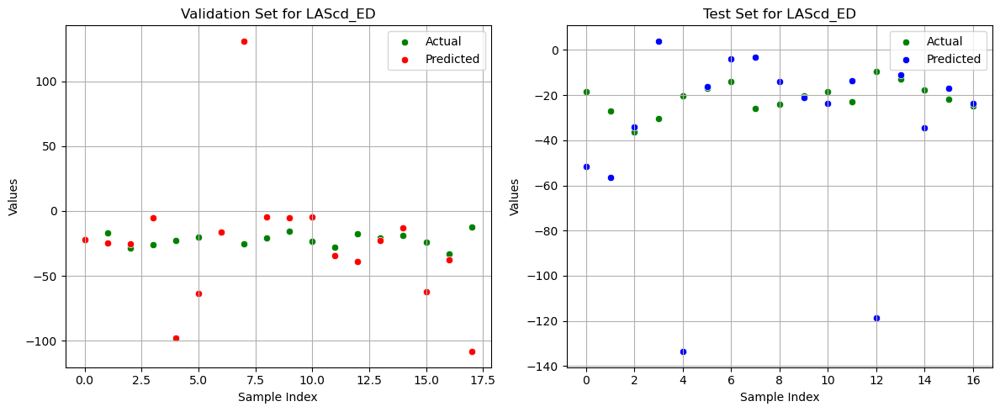

Średnie wyniki dla walidacji:
MAE: 20.5059, MAPE: 96.27%
Średnie wyniki dla testu:
MAE: 14.9824, MAPE: 82.29%
Trenowanie modelu dla kolumny LASct_ED
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.2863, MAPE: 37.27%
Test - MAE: 11.3423, MAPE: 100.70%



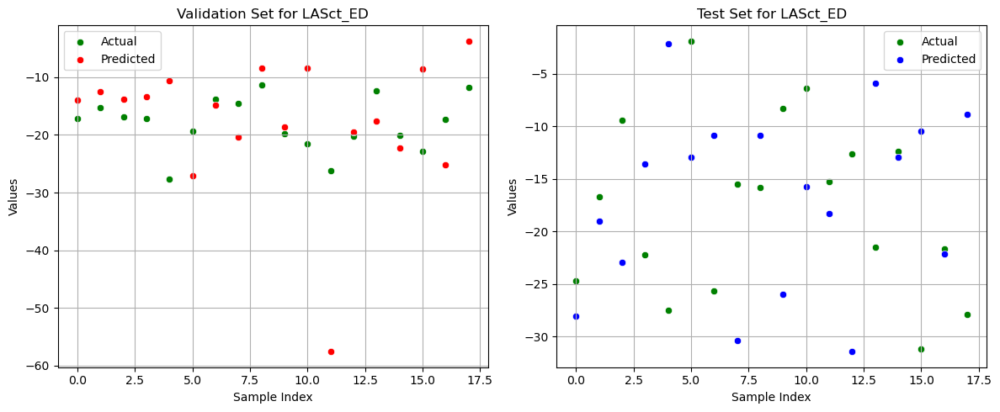

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 11.4735, MAPE: 83.85%
Test - MAE: 7.9032, MAPE: 53.62%



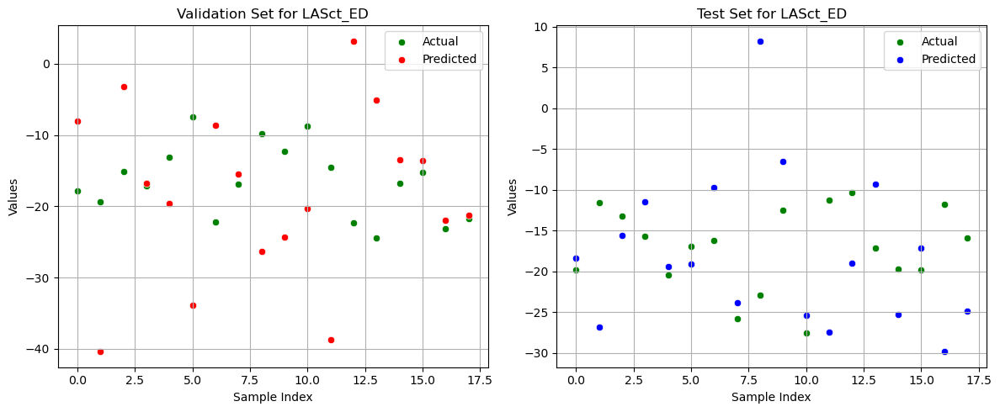

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 13.9365, MAPE: 87.16%
Test - MAE: 19.8623, MAPE: 134.90%



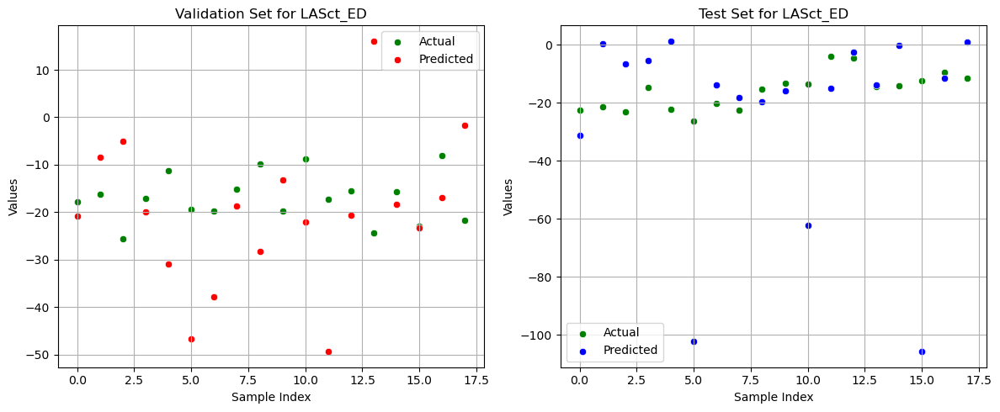

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.9204, MAPE: 78.35%
Test - MAE: 7.4485, MAPE: 59.77%



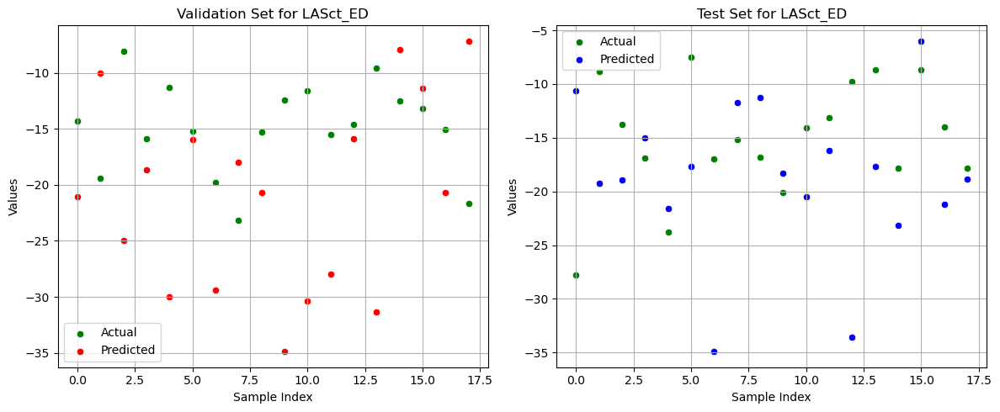

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 13.6794, MAPE: 86.68%
Test - MAE: 15.8722, MAPE: 88.85%



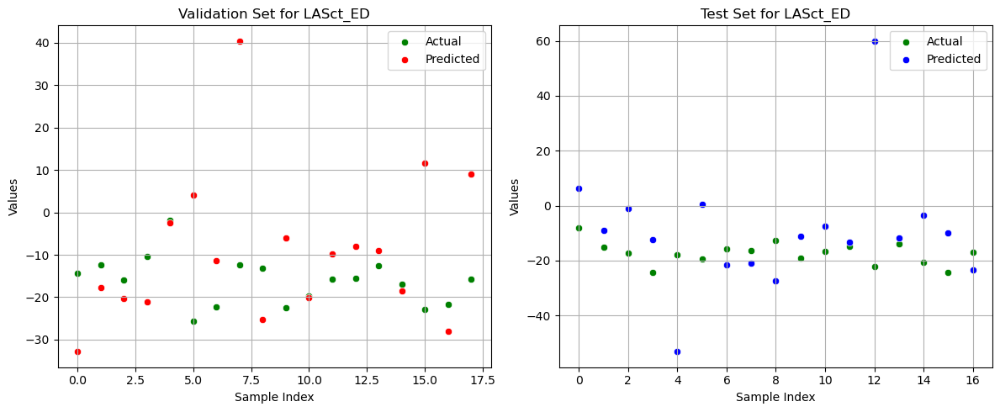

Średnie wyniki dla walidacji:
MAE: 11.2592, MAPE: 74.66%
Średnie wyniki dla testu:
MAE: 12.4857, MAPE: 87.57%
Trenowanie modelu dla kolumny LASr_AC
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 33.1953, MAPE: 95.88%
Test - MAE: 13.4568, MAPE: 39.35%



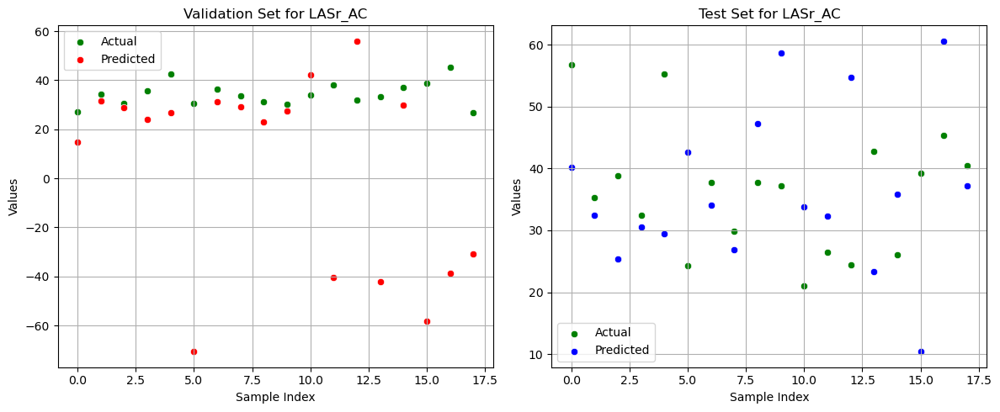

Fold 2/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.6565, MAPE: 25.53%
Test - MAE: 10.8327, MAPE: 36.71%



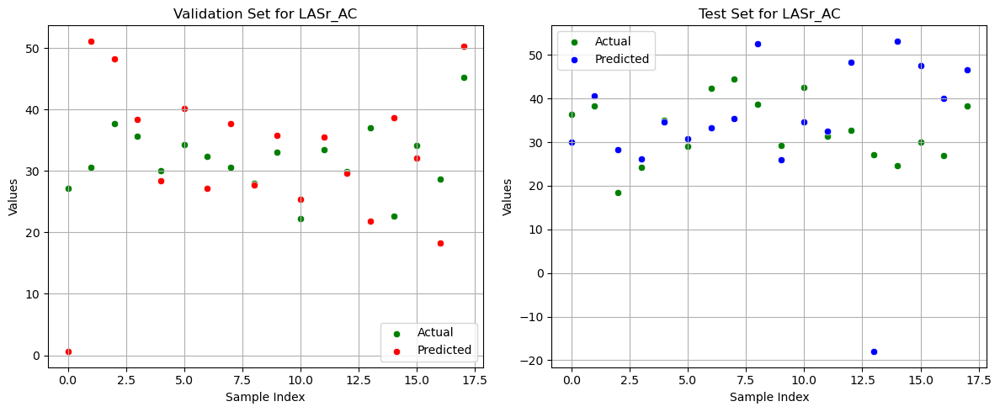

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 13.9585, MAPE: 41.99%
Test - MAE: 28.6604, MAPE: 92.28%



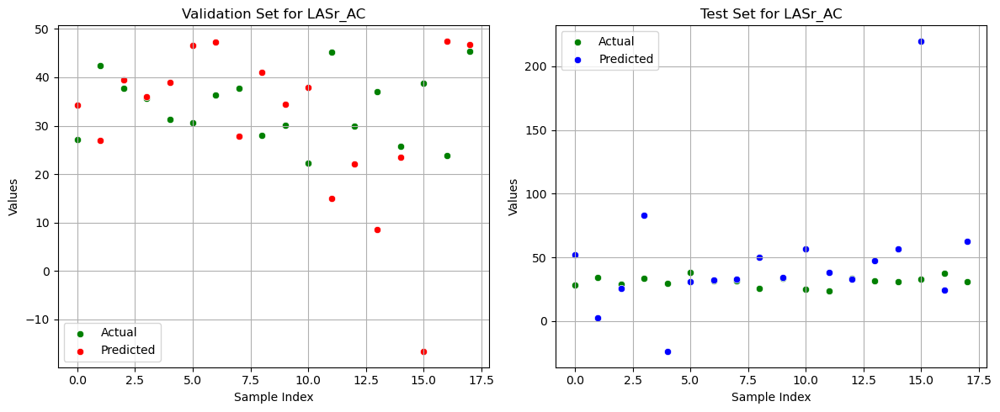

Fold 4/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 10.5784, MAPE: 34.85%
Test - MAE: 10.1420, MAPE: 34.04%



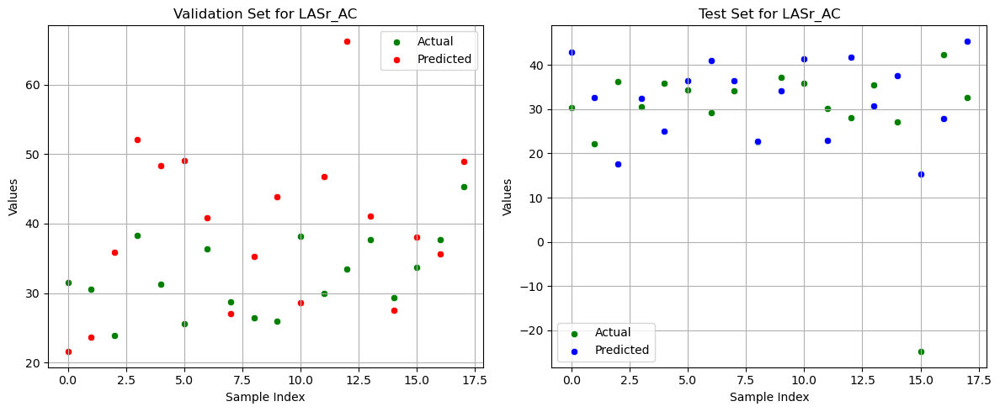

Fold 5/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 14.4741, MAPE: 43.36%
Test - MAE: 18.1806, MAPE: 56.39%



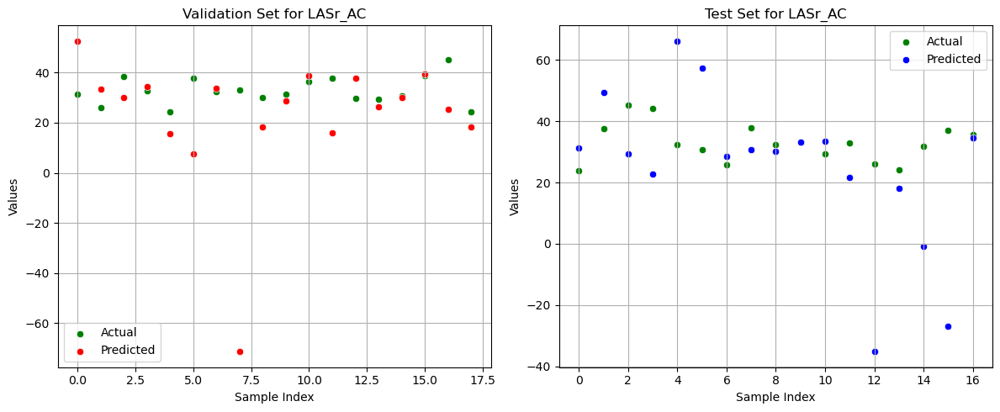

Średnie wyniki dla walidacji:
MAE: 15.9726, MAPE: 48.32%
Średnie wyniki dla testu:
MAE: 16.2545, MAPE: 51.75%
Trenowanie modelu dla kolumny LAScd_AC
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 13.2835, MAPE: 69.95%
Test - MAE: 10.5443, MAPE: 51.87%



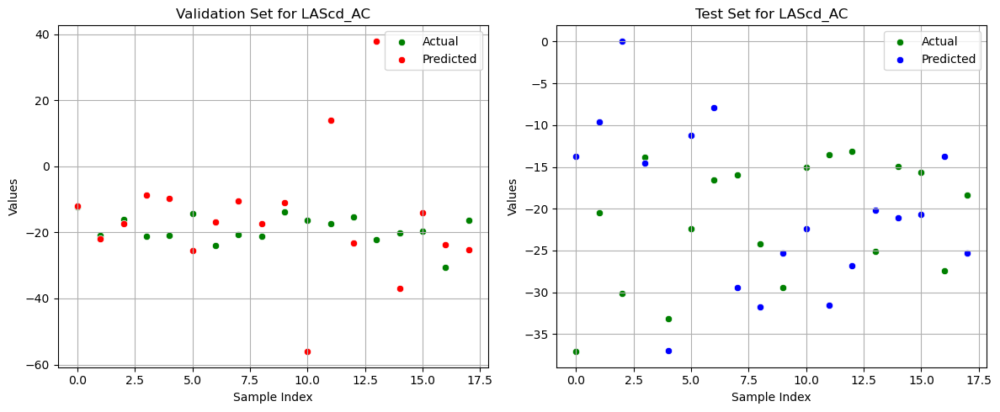

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 13.6701, MAPE: 77.65%
Test - MAE: 9.6254, MAPE: 79.78%



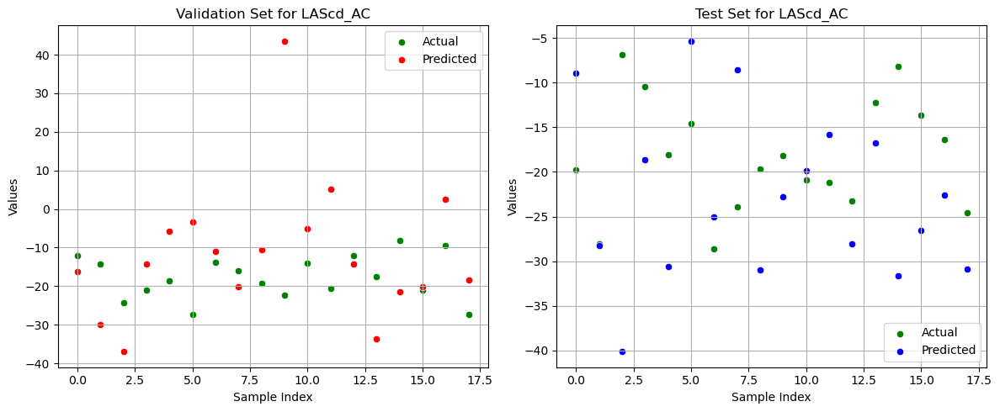

Fold 3/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 10.1920, MAPE: 56.76%
Test - MAE: 17.3297, MAPE: 110.66%



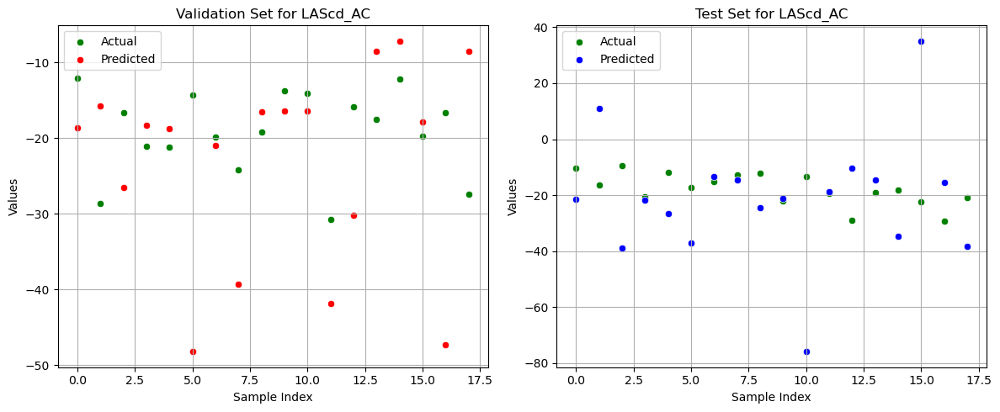

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.2989, MAPE: 38.81%
Test - MAE: 7.7879, MAPE: 49.70%



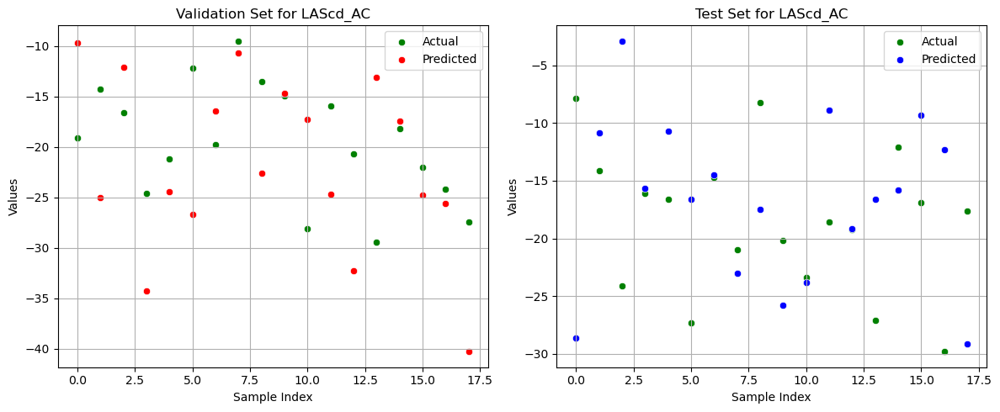

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 18.2649, MAPE: 99.28%
Test - MAE: 18.9706, MAPE: 118.52%



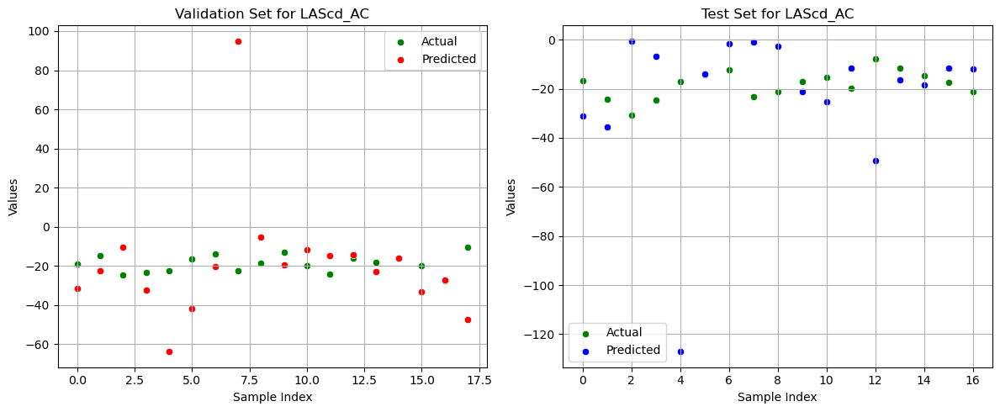

Średnie wyniki dla walidacji:
MAE: 12.5419, MAPE: 68.49%
Średnie wyniki dla testu:
MAE: 12.8516, MAPE: 82.11%
Trenowanie modelu dla kolumny LASct_AC
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.1423, MAPE: 31.71%
Test - MAE: 7.9263, MAPE: 79.74%



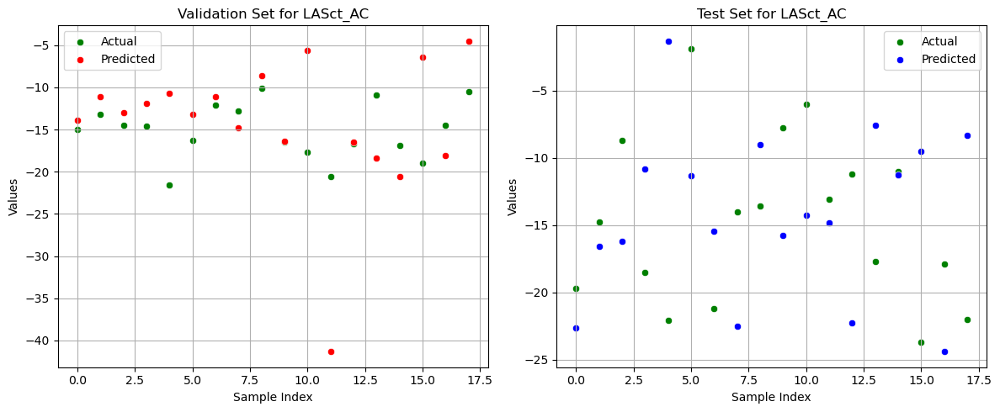

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 8.1582, MAPE: 66.62%
Test - MAE: 6.2882, MAPE: 49.44%



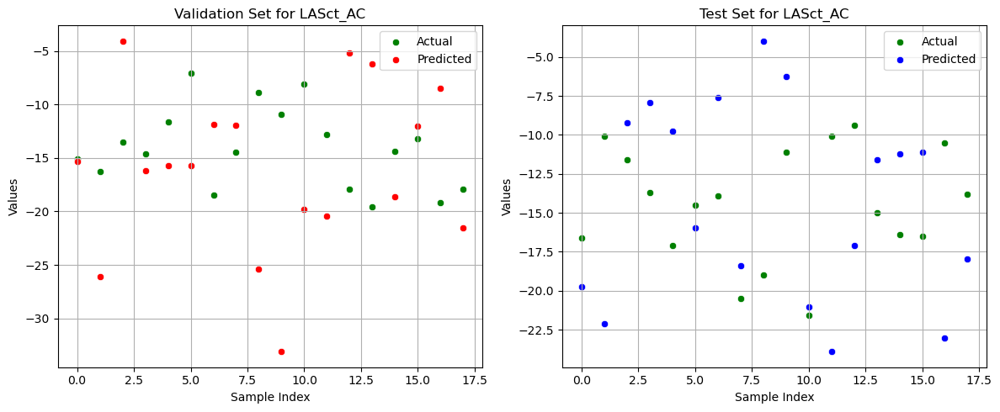

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 11.0528, MAPE: 84.10%
Test - MAE: 11.8495, MAPE: 96.60%



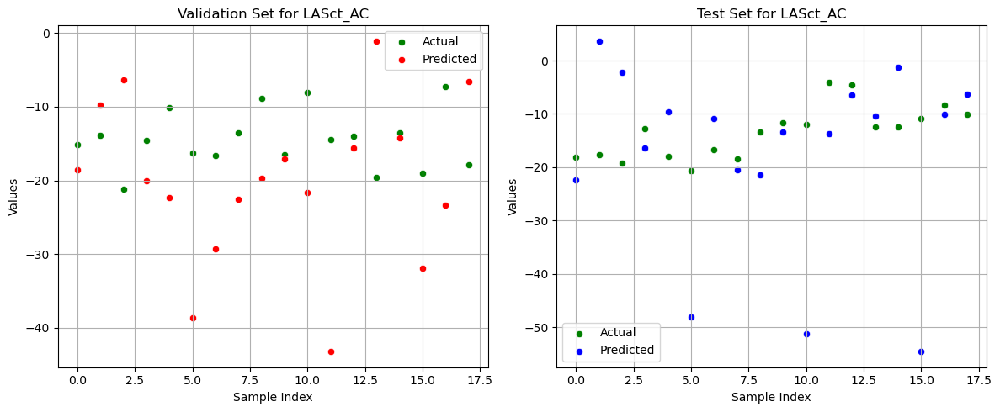

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.8430, MAPE: 90.72%
Test - MAE: 6.2414, MAPE: 50.35%



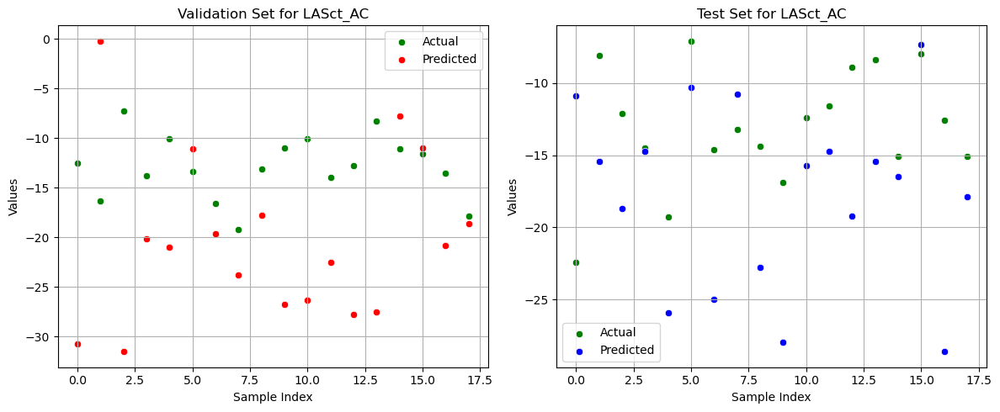

Fold 5/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.4124, MAPE: 74.49%
Test - MAE: 9.2847, MAPE: 64.49%



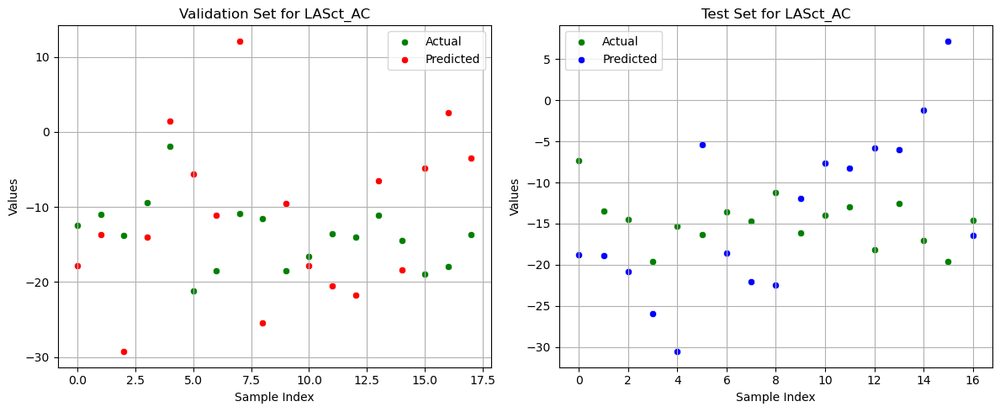

Średnie wyniki dla walidacji:
MAE: 8.7218, MAPE: 69.53%
Średnie wyniki dla testu:
MAE: 8.3180, MAPE: 68.12%
Trenowanie modelu dla kolumny RVFWSL
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 9.6359, MAPE: 39.83%
Test - MAE: 7.0995, MAPE: 31.15%



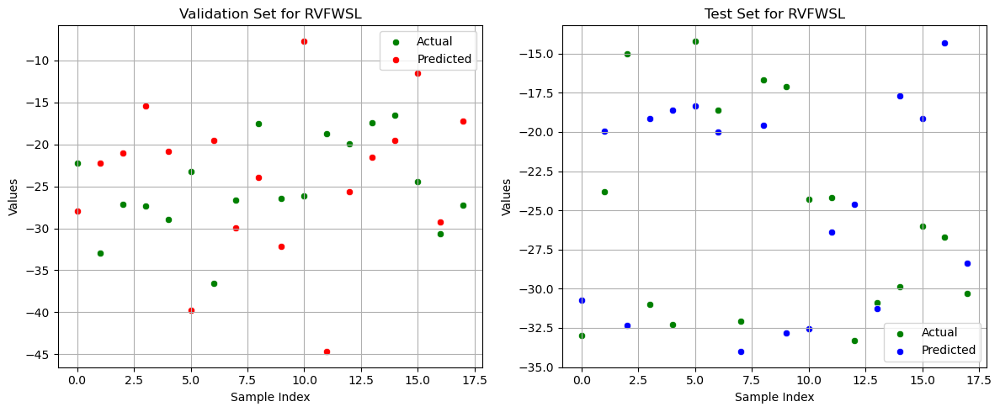

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 12.6768, MAPE: 61.27%
Test - MAE: 7.3142, MAPE: 30.66%



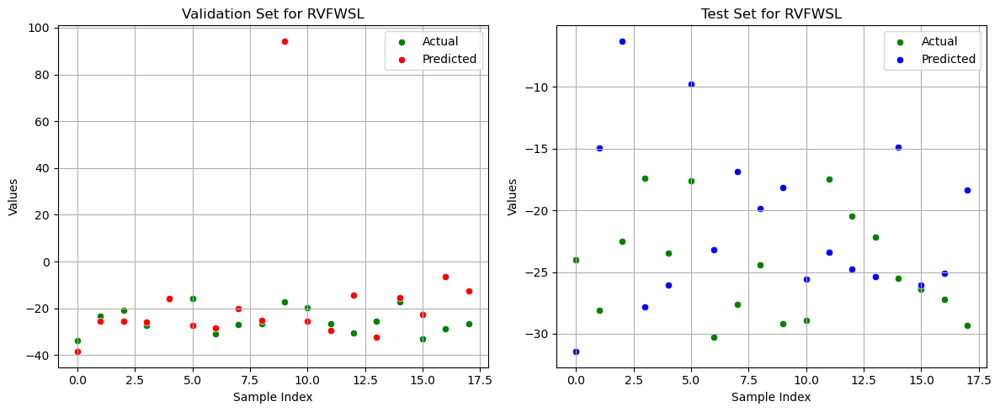

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 5.6430, MAPE: 25.04%
Test - MAE: 17.0152, MAPE: 93.76%



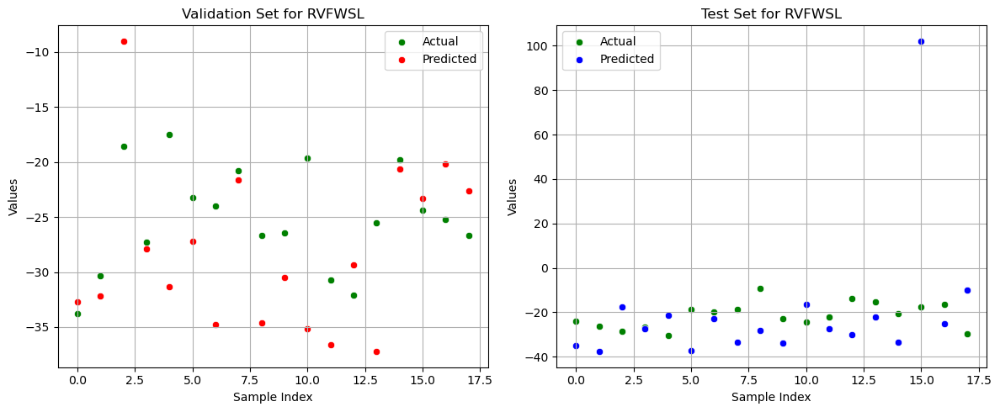

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.7772, MAPE: 35.73%
Test - MAE: 6.0229, MAPE: 24.55%



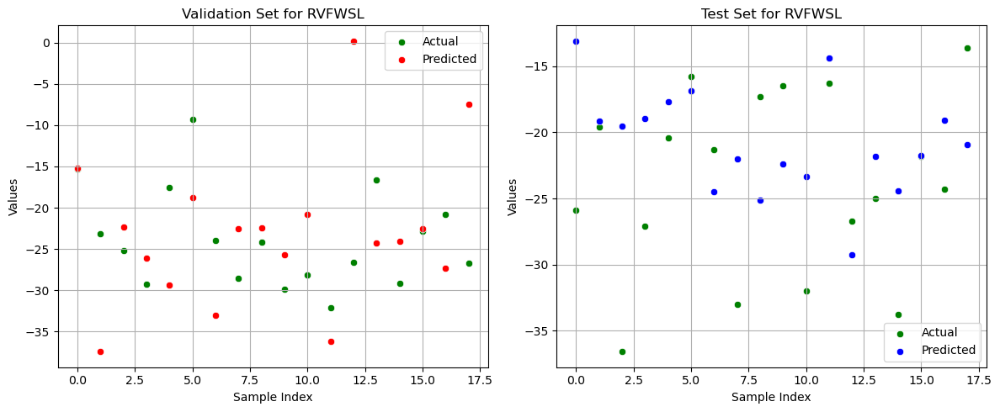

Fold 5/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 11.9458, MAPE: 59.08%
Test - MAE: 11.8303, MAPE: 55.29%



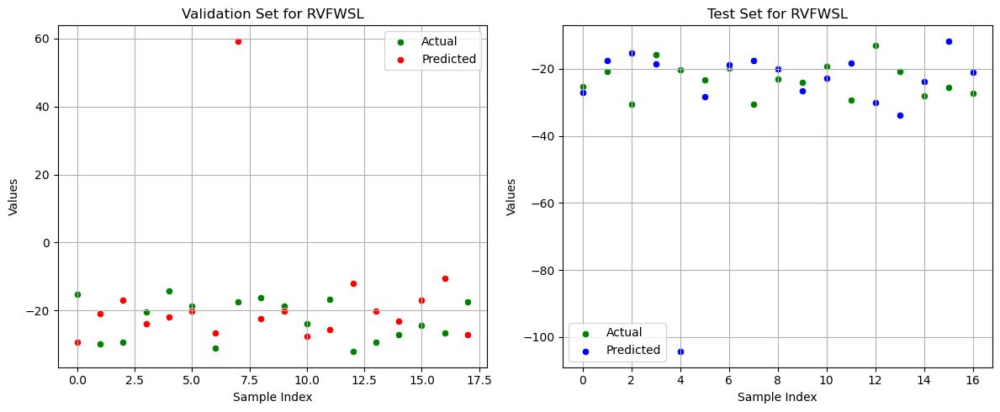

Średnie wyniki dla walidacji:
MAE: 9.5357, MAPE: 44.19%
Średnie wyniki dla testu:
MAE: 9.8564, MAPE: 47.08%
Trenowanie modelu dla kolumny RV4CSL
Fold 1/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 10.8497, MAPE: 53.81%
Test - MAE: 6.2503, MAPE: 30.90%



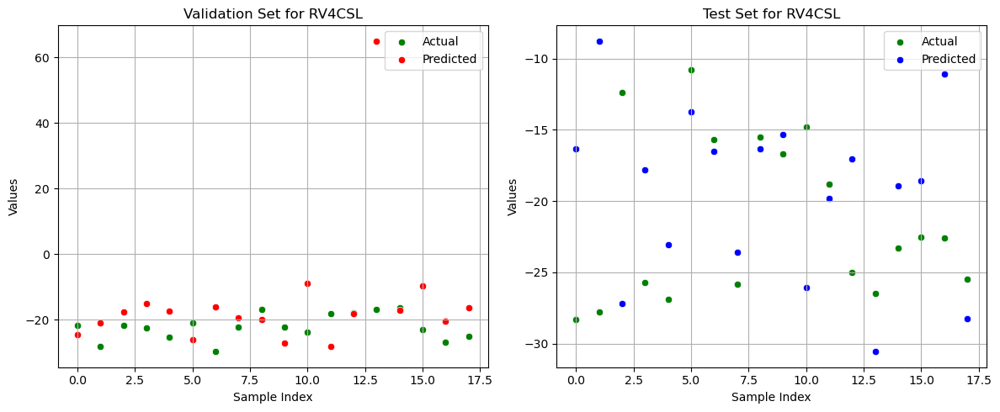

Fold 2/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 10.0571, MAPE: 52.80%
Test - MAE: 6.7432, MAPE: 33.60%



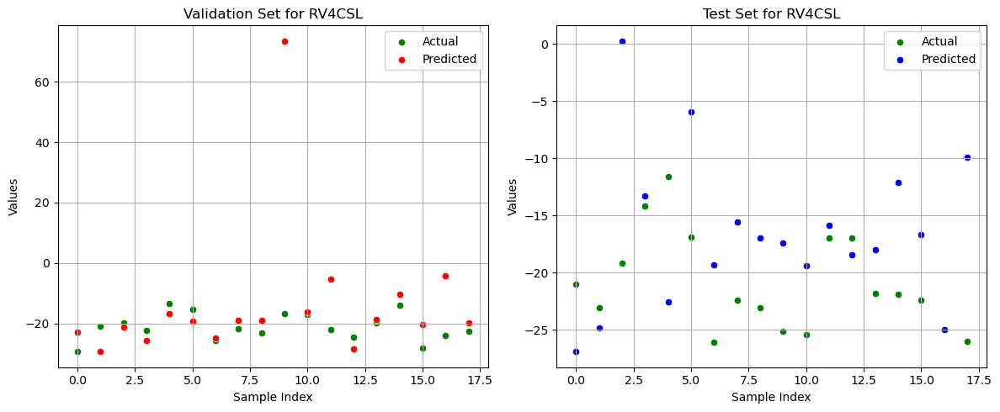

Fold 3/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 7.1687, MAPE: 36.10%
Test - MAE: 15.6828, MAPE: 92.20%



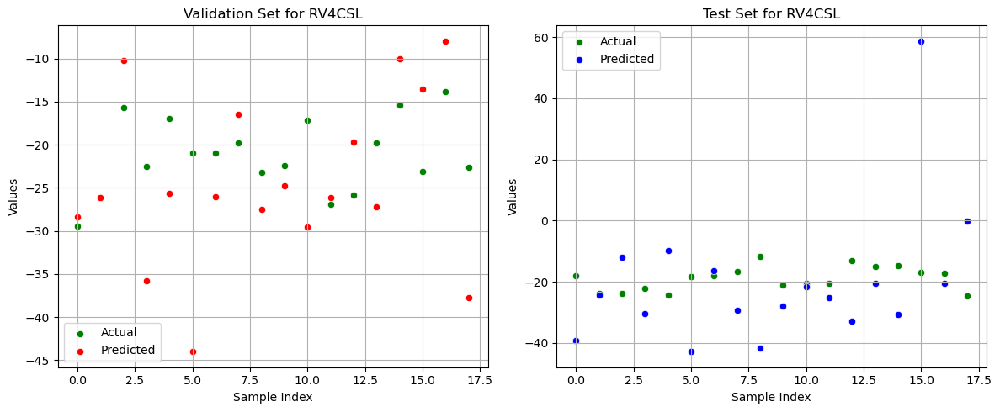

Fold 4/5
Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (64,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 8.9898, MAPE: 50.43%
Test - MAE: 6.5945, MAPE: 31.27%



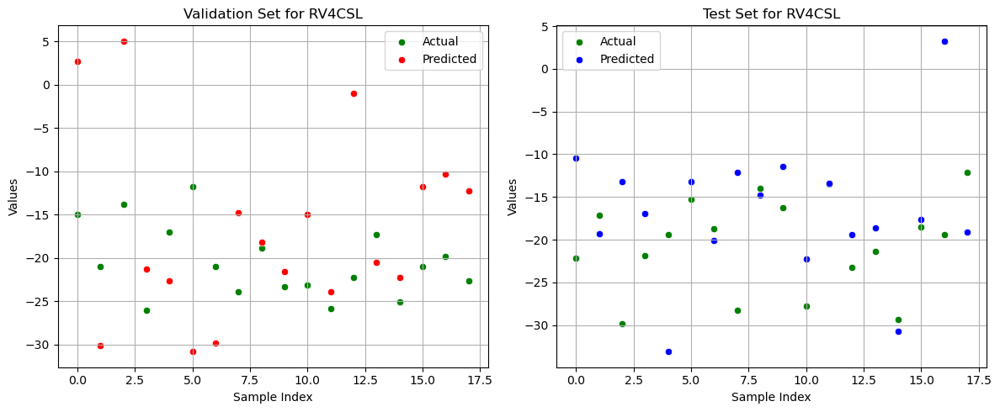

Fold 5/5


/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/michaltajak/anaconda3/envs/tensorplease/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (2000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best Parameters: {'activation': 'relu', 'alpha': 0.0001, 'hidden_layer_sizes': (32,), 'learning_rate_init': 0.01, 'max_iter': 2000}
Validation - MAE: 10.5635, MAPE: 60.03%
Test - MAE: 6.5459, MAPE: 35.18%



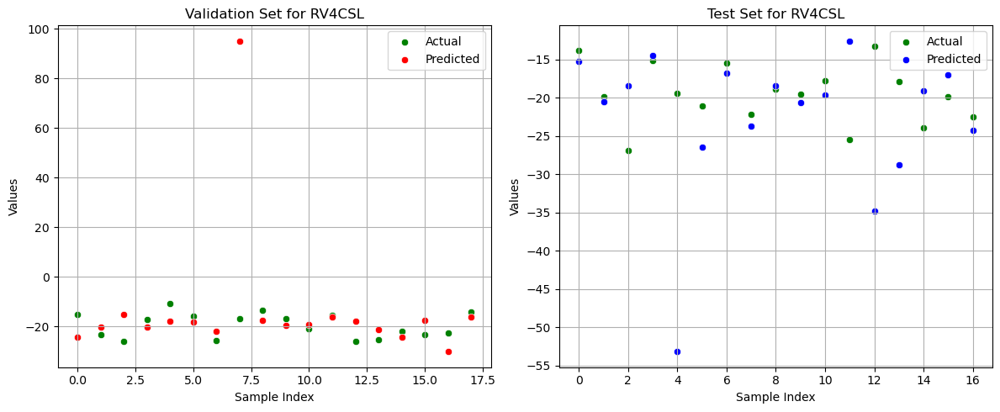

Średnie wyniki dla walidacji:
MAE: 9.5258, MAPE: 50.63%
Średnie wyniki dla testu:
MAE: 8.3633, MAPE: 44.63%


In [45]:
from sklearn.exceptions import ConvergenceWarning
import warnings
warnings.filterwarnings("ignore", category=ConvergenceWarning)

import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import KFold, GridSearchCV, train_test_split
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns

# Funkcja do obliczenia MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Funkcja oceny modelu z użyciem 5-krotnej walidacji
def cross_validate_regression(X, y, model, param_grid, cv=5, y_col_name="Target"):
    kf = KFold(n_splits=cv, shuffle=True, random_state=43)
    
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)  # Skalowanie danych

    fold = 1
    val_results = []
    test_results = []
    
    for train_idx, test_idx in kf.split(X_scaled):
        print(f"Fold {fold}/{cv}")
        X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
        y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
        
        # Dalszy podział zbioru treningowego na train/val (60/20)
        X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=43)
        
        # GridSearchCV dla modelu MLPRegressor
        grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, n_jobs=-1, scoring='neg_mean_absolute_error')
        grid_search.fit(X_train, y_train)
        
        best_model = grid_search.best_estimator_
        
        # Ocena na zbiorze walidacyjnym
        y_val_pred = best_model.predict(X_val)
        mae_val = mean_absolute_error(y_val, y_val_pred)
        mape_val = mean_absolute_percentage_error(y_val, y_val_pred)
        r2_val = r2_score(y_val, y_val_pred)

        # Ocena na zbiorze testowym
        y_test_pred = best_model.predict(X_test)
        mae_test = mean_absolute_error(y_test, y_test_pred)
        mape_test = mean_absolute_percentage_error(y_test, y_test_pred)
        r2_test = r2_score(y_test, y_test_pred)
        
        val_results.append((mae_val, mape_val, r2_val))
        test_results.append((mae_test, mape_test, r2_test))
        
        print(f"Best Parameters: {grid_search.best_params_}")
        print(f"Validation - MAE: {mae_val:.4f}, MAPE: {mape_val:.2f}%")
        print(f"Test - MAE: {mae_test:.4f}, MAPE: {mape_test:.2f}%\n")
        
        # Wykresy predykcji
        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        sns.scatterplot(x=np.arange(len(y_val)), y=y_val, color='green', label='Actual')
        sns.scatterplot(x=np.arange(len(y_val)), y=y_val_pred, color='red', label='Predicted')
        plt.xlabel('Sample Index')
        plt.ylabel('Values')
        plt.title(f'Validation Set for {y_col_name}')
        plt.legend()
        plt.grid()

        plt.subplot(1, 2, 2)
        sns.scatterplot(x=np.arange(len(y_test)), y=y_test, color='green', label='Actual')
        sns.scatterplot(x=np.arange(len(y_test)), y=y_test_pred, color='blue', label='Predicted')
        plt.xlabel('Sample Index')
        plt.ylabel('Values')
        plt.title(f'Test Set for {y_col_name}')
        plt.legend()
        plt.grid()

        plt.tight_layout()
        plt.show()

        fold += 1
    
    # Średnie wyniki z walidacji i testu
    val_mae_mean = np.mean([result[0] for result in val_results])
    val_mape_mean = np.mean([result[1] for result in val_results])
    
    test_mae_mean = np.mean([result[0] for result in test_results])
    test_mape_mean = np.mean([result[1] for result in test_results])
    
    print("Średnie wyniki dla walidacji:")
    print(f"MAE: {val_mae_mean:.4f}, MAPE: {val_mape_mean:.2f}%")
    print("Średnie wyniki dla testu:")
    print(f"MAE: {test_mae_mean:.4f}, MAPE: {test_mape_mean:.2f}%")
    
    return best_model

# Parametry do przeszukania
param_grid = {
    'hidden_layer_sizes': [(32,), (64,)],
    'activation': ['relu'],
    'learning_rate_init': [0.01],
    'alpha': [0.0001],
    'max_iter': [2000]
}

# Trenowanie modelu dla każdej kolumny
for y_col in y.columns:
    print(f"Trenowanie modelu dla kolumny {y_col}")
    model = MLPRegressor(random_state=43)
    best_model = cross_validate_regression(X, y[y_col], model, param_grid, cv=5, y_col_name=y_col)
